In [1]:
import smf_tools
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from astropy.table import Table
import pickle

# Match Catalogs

In [2]:
# create catalogs
data_path = "/Users/marchuertascompany/Documents/data/COSMOS-Web/COSMOS-Web_3.1_morph/"

#COSMOS files
cosmos_f150w_fn='COSMOS-Web_3.0_adversarial_asinh_F150W_Sep-18-2024_4class_shuffle_10_50.csv'
cosmos_f277w_fn='COSMOS-Web_3.0_adversarial_asinh_F277W_Sep-19-2024_4class_shuffle_10_50.csv'
cosmos_f444w_fn='COSMOS-Web_3.0_adversarial_asinh_F444W_Sep-19-2024_4class_shuffle_10_50.csv'

In [3]:

cosmos_f150w=pd.read_csv(os.path.join(data_path,cosmos_f150w_fn))
cosmos_f277w=pd.read_csv(os.path.join(data_path,cosmos_f277w_fn))
cosmos_f444w=pd.read_csv(os.path.join(data_path,cosmos_f444w_fn))

In [4]:
print(len(cosmos_f444w))
print(len(cosmos_f277w))
print(len(cosmos_f150w))

453733
453934
454620


In [5]:
cosmos_phys_ap =Table.read(os.path.join(data_path,'COSMOSWeb_master_v3.1.0-sersic-cgs_err-calib_LePhare.fits'))

In [6]:
names = [name for name in cosmos_phys_ap.colnames if len(cosmos_phys_ap[name].shape) <= 1]
cosmos_phys=cosmos_phys_ap[names].to_pandas()

In [7]:
merge=cosmos_f150w.merge(cosmos_f277w,how='inner',on='fullname',suffixes=(None,'_x'))
print(len(merge))
merge2=merge.merge(cosmos_f444w,how='inner',on='fullname',suffixes=(None,'_y'))
print(len(merge2))
cosmos_cat = merge2.merge(cosmos_phys,left_on='id',right_on='ID_SE++',how='inner')
print(len(cosmos_cat))

453789
453554
453554


# Compute Morphological labels

In [8]:
filters = ['F150W','F277W','F444W']
morph=['sph','disk','irr','bd']

for f in filters:
    for m in morph:
        c = cosmos_cat.filter(regex='^'+m+'_')
        c = c.filter(regex=f+'$')
        cosmos_cat[m+'_'+f+'_mean']=c.mean(axis=1).values
        cosmos_cat[m+'_'+f+'_std']=c.std(axis=1).values

In [9]:



morph_flag=[]
delta_value = []

for sph,dk,irr,bd in zip(cosmos_cat.sph_F277W_mean,cosmos_cat.disk_F277W_mean,cosmos_cat.irr_F277W_mean,cosmos_cat.bd_F277W_mean):
    maxpos = np.argmax([sph,dk,irr,bd])
    delta = np.sort([sph,dk,irr,bd])[3]-np.sort([sph,dk,irr,bd])[2]
    morph_flag.append(maxpos)
    delta_value.append(delta)
#morph_flag=np.array(morph_flag)
#morph_flag[(cosmos_cat.disk_f200>0.3)]=1    
cosmos_cat['morph_flag_f277w']=np.array(morph_flag)
cosmos_cat['delta_f277']=np.array(delta_value)

morph_flag=[]
delta_value = []

for sph,dk,irr,bd in zip(cosmos_cat.sph_F444W_mean,cosmos_cat.disk_F444W_mean,cosmos_cat.irr_F444W_mean,cosmos_cat.bd_F444W_mean):
    maxpos = np.argmax([sph,dk,irr,bd])
    delta = np.sort([sph,dk,irr,bd])[3]-np.sort([sph,dk,irr,bd])[2]
    morph_flag.append(maxpos)
    delta_value.append(delta)
#morph_flag=np.array(morph_flag)
#morph_flag[(cosmos_cat.disk_f200>0.3)]=1    
cosmos_cat['morph_flag_f444w']=np.array(morph_flag)
cosmos_cat['delta_f444']=np.array(delta_value)


morph_flag=[]
delta_value = []

for sph,dk,irr,bd in zip(cosmos_cat.sph_F150W_mean,cosmos_cat.disk_F150W_mean,cosmos_cat.irr_F150W_mean,cosmos_cat.bd_F150W_mean):
    maxpos = np.argmax([sph,dk,irr,bd])
    delta = np.sort([sph,dk,irr,bd])[3]-np.sort([sph,dk,irr,bd])[2]
    morph_flag.append(maxpos)
    delta_value.append(delta)
#morph_flag=np.array(morph_flag)
#morph_flag[(cosmos_cat.disk_f200>0.3)]=1    
cosmos_cat['morph_flag_f150w']=np.array(morph_flag)
cosmos_cat['delta_f150']=np.array(delta_value)


#cosmos_cat.to_csv(data_path+"COSMOSWeb_master_v1.6.0-sersic+BD-em_cgs_LePhare_nodupl_nomulti_morph_F150W_F277W_F444W_morphflag.csv")

In [10]:
cosmos_cat['super_compact_flag'] = (
    ((cosmos_cat['LP_zfinal'] < 1) & (cosmos_cat['RADIUS'] < (0.025 / 3600))) |
    ((cosmos_cat['LP_zfinal'] > 1) & (cosmos_cat['LP_zfinal'] < 3) & (cosmos_cat['RADIUS'] < (0.05 / 3600))) |
    ((cosmos_cat['LP_zfinal'] > 3) & (cosmos_cat['RADIUS'] < (0.07 / 3600)))
)


cosmos_cat['unc_flag'] = (
    (
        (cosmos_cat['delta_f150'] < 0.1) |
        (cosmos_cat['delta_f277'] < 0.1) |
        (cosmos_cat['delta_f444'] < 0.1)
    ) )

num_super_compact = cosmos_cat['super_compact_flag'].sum()
num_unc = cosmos_cat['unc_flag'].sum()

print(f"Number of Super Compact Objects: {num_super_compact}")
print(f"Number of Uncertain Objects: {num_unc}")

Number of Super Compact Objects: 22709
Number of Uncertain Objects: 36237


In [ ]:

from astropy.cosmology import Planck18 as cosmo

# Extract redshift and angular size from cosmos_cat
z = cosmos_cat['LP_zfinal']  # Redshift
mask = (z>0)&(z<10)
# Compute angular diameter distance at each redshift (in Mpc)
scale = cosmo.kpc_proper_per_arcmin(np.array(z))
cosmos_cat['radius_kpc']=cosmos_cat['RADIUS']*60.*scale # Returns Quantity with units Mpc

In [166]:
# Step 1: Define the super_compact_flag as previously corrected
cosmos_cat['super_compact_flag'] = (
    ((cosmos_cat['LP_zfinal'] < 1) & (cosmos_cat['radius_kpc'] < (0.5))) |
    ((cosmos_cat['LP_zfinal'] > 1) & (cosmos_cat['LP_zfinal'] < 3) & (cosmos_cat['radius_kpc'] < (0.5))) |
    ((cosmos_cat['LP_zfinal'] > 3) & (cosmos_cat['radius_kpc'] < (0.5)))
)


cosmos_cat['unc_flag'] = (
    (
        (cosmos_cat['delta_f150'] < 0.1) |
        (cosmos_cat['delta_f277'] < 0.1) |
        (cosmos_cat['delta_f444'] < 0.1)
    ) )

num_super_compact = cosmos_cat['super_compact_flag'].sum()
num_unc = cosmos_cat['unc_flag'].sum()

print(f"Number of Super Compact Objects: {num_super_compact}")
print(f"Number of Uncertain Objects: {num_unc}")

Number of Super Compact Objects: 45060
Number of Uncertain Objects: 36237


# Compute Stellar Mass Functions (files saved)

In [167]:
morph_flag = np.copy(cosmos_cat.morph_flag_f150w.values)
zbest = cosmos_cat['LP_zfinal']

morph_f356 = np.copy(cosmos_cat.morph_flag_f277w.values)
morph_f444 = np.copy(cosmos_cat.morph_flag_f444w.values)
morph_flag[(zbest>1) & (zbest<3)] = np.copy(morph_f356[(zbest>1) & (zbest<3)])
morph_flag[(zbest>3) & (zbest<6)]= np.copy(morph_f444[(zbest>3) & (zbest<6)])
super_compact_flag = cosmos_cat['super_compact_flag']
morph_flag[(super_compact_flag==1)]=-1
cosmos_cat['morph_flag']=np.copy(morph_flag)

In [178]:
clean = cosmos_cat.query('LP_warn_fl==0 and FLAG_STAR_HSC ==0 and MAG_MODEL_F150W>0 and MAG_MODEL_F150W<28 and LP_mass_med_PDF>7 and LP_mass_med_PDF<13 and LP_zfinal>0 and LP_zfinal<7')
print(len(cosmos_cat))
#morph_sel=['morph_flag==0','morph_flag==1','morph_flag==2','morph_flag==3','morph_flag>=-1 and morph_flag<=3','morph_flag>=0 and morph_flag!=2','morph_flag==-1']
morph_class=['late','early','sph','disk','irr','db','all','reg','comp']

morph_sel = [
    '(morph_flag==2 | morph_flag==1)',
    '(morph_flag==-1 | morph_flag==0 | morph_flag==3)',
    '(morph_flag==0)',
    '(morph_flag==1)',
    '(morph_flag==2)',
    '(morph_flag==3)',
    '(morph_flag>=-1 & morph_flag<=3)',
    '(morph_flag>=0 & morph_flag!=2)',
    '(morph_flag==-1)'
]

smf_morph={}

zbins =  [0.2,0.5,0.8,1.1,1.5,2.0,2.5,3.0,3.5,4.5,5.5,6.5]
#zbins =  [4.5,5.5]
#zbins=[0.2,0.5]
for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
    for q,cl in zip(morph_sel,morph_class):
        sel=clean.query(q+' and LP_zfinal>'+str(zlow)+' and LP_zfinal<'+str(zup))
        print(len(sel))
        if len(sel)>0:
        #LogMassbin, Fi, dFi, dFi_cv, dFi_pois=smf_tools.get_smf_cv_poiss_err(0,sel.LP_mass_med_PDF.values,0.3,sel.MAG_MODEL_F150W.values, 27, sel.LP_zPDF.values, zlow, zup, 0.42239)
            LogMassbin, Fi, dFi, dFi_cv, dFi_pois,dFi_SED=smf_tools.get_smf_CW(0,sel.LP_mass_med_PDF.values,0.3,sel.MAG_MODEL_F150W.values, 27, sel.LP_zfinal.values, zlow, zup, 0,'/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/v2.2-SED-Uncertainties','all',0.431)
        #get_smf_cv_poiss_err(lensID, logMass, dLogMass, mag, maglim, z, zmin, zmax, survey_area)
        #get_smf_CW(lensID, logMass, dLogMass, mag, maglim, z, zmin, zmax, zbin, path_sigma_sed, sample, survey_area)
            smf_morph[(zlow,cl,'LogMassbin')]=LogMassbin
            smf_morph[(zlow,cl,'Fi')]=Fi
            smf_morph[(zlow,cl,'dFi')]=dFi
        else:
            smf_morph[(zlow,cl,'LogMassbin')]=LogMassbin
            smf_morph[(zlow,cl,'Fi')]=Fi*0.0
            smf_morph[(zlow,cl,'dFi')]=dFi*0.0
        
# Define the path to save the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444.pkl'

# Use 'with' statement to handle the file open/close
with open(file_path, 'wb') as file:
    pickle.dump(smf_morph, file)

print(f"Dictionary stored successfully at {file_path}")

453554
21500
mass_max 11.77857 maxmassinterp 11.96315999999984
4900
mass_max 11.89377 maxmassinterp 11.96315999999984
509
mass_max 11.8 maxmassinterp 11.96315999999984
2392
mass_max 11.77857 maxmassinterp 11.96315999999984
19108
mass_max 11.440650000000002 maxmassinterp 11.96315999999984
1070
mass_max 11.89377 maxmassinterp 11.96315999999984
26400
mass_max 11.89377 maxmassinterp 11.96315999999984
3971
mass_max 11.89377 maxmassinterp 11.96315999999984
3321
mass_max 10.850000000000001 maxmassinterp 11.96315999999984
45290
mass_max 11.64999 maxmassinterp 11.7757099999999
5447
mass_max 11.94998 maxmassinterp 11.7757099999999
1280
mass_max 11.89999 maxmassinterp 11.7757099999999
2934
mass_max 11.64999 maxmassinterp 11.7757099999999
42356
mass_max 11.51201 maxmassinterp 11.7757099999999
1430
mass_max 11.94998 maxmassinterp 11.7757099999999
50737
mass_max 11.94998 maxmassinterp 11.7757099999999
5644
mass_max 11.94998 maxmassinterp 11.7757099999999
2737
mass_max 10.97793 maxmassinterp 11.77570

In [176]:
#print(cosmos_cat.columns[300:400])

# (cat[‘LP_MNUV_phys’]-cat[‘LP_MR_phys’] > 3*(cat[‘LP_MR_phys’]-cat[‘LP_MJ_phys’]) +1 ) & (cat[‘LP_MNUV_phys’]-cat[‘LP_MR_phys’] > 3.1)




#clean = cosmos_cat.query('(LP_MNUV_phys-LP_MR_phys)>3*(LP_MR_phys-LP_MJ_phys) and (LP_MNUV_phys-LP_MR_phys)>3.1 and LP_warn_fl==0 and FLAG_STAR_HSC ==0 and MAG_MODEL_F150W>0 and MAG_MODEL_F150W<28 and LP_mass_med_PDF>7 and LP_mass_med_PDF<13 and LP_zfinal>0 and LP_zfinal<7')
clean = cosmos_cat.query(
    '((LP_MNUV_phys - LP_MR_phys) > 3 * (LP_MR_phys - LP_MJ_phys)) & '
    '((LP_MNUV_phys - LP_MR_phys) > 3.1) & '
    '(LP_warn_fl == 0) & '
    '(FLAG_STAR_HSC == 0) & '
    '(MAG_MODEL_F150W > 0) & '
    '(MAG_MODEL_F150W < 28) & '
    '(LP_mass_med_PDF > 7) & '
    '(LP_mass_med_PDF < 13) & '
    '(LP_zfinal > 0) & '
    '(LP_zfinal < 7)'
)

print(len(cosmos_cat))
#morph_sel=['morph_flag==2 or morph_flag==1','morph_flag==-1 or morph_flag==0 or morph_flag==3','morph_flag==0','morph_flag==1','morph_flag==2','morph_flag==3','morph_flag>=-1 and morph_flag<=3','morph_flag>=0 and morph_flag!=2','morph_flag==-1']
#morph_sel=['morph_flag==2 or morph_flag==1','morph_flag==-1 or morph_flag==0 or morph_flag==3']
#morph_class=['late','early','sph','disk','irr','db','all','reg','comp']
#morph_class=['late','early']
#morph_sel=['(morph_flag==2 or morph_flag==1)','(morph_flag==-1 or morph_flag==0 or morph_flag==3)','morph_flag==0','morph_flag==1','morph_flag==2','morph_flag==3','morph_flag>=-1 and morph_flag<=3','morph_flag>=0 and morph_flag!=2','morph_flag==-1']
morph_sel = [
    '(morph_flag==2 | morph_flag==1)',
    '(morph_flag==-1 | morph_flag==0 | morph_flag==3)',
    '(morph_flag==0)',
    '(morph_flag==1)',
    '(morph_flag==2)',
    '(morph_flag==3)',
    '(morph_flag>=-1 & morph_flag<=3)',
    '(morph_flag>=0 & morph_flag!=2)',
    '(morph_flag==-1)'
]

morph_class=['late','early','sph','disk','irr','db','all','reg','comp']
smf_morph={}

zbins =  [0.2,0.5,0.8,1.1,1.5,2.0,2.5,3.0,3.5,4.5,5.5,6.5]
#zbins =  [3.0,3.5,4.5,5.5]
#zbins=[0.2,0.5]
for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
    for q,cl in zip(morph_sel,morph_class):
        #sel=clean.query(q+' and LP_zfinal>'+str(zlow)+' and LP_zfinal<'+str(zup))
        query_str = f"{q} & (LP_zfinal > {zlow}) & (LP_zfinal < {zup})"
        sel = clean.query(query_str)
        
        print(zlow,zup)
        if len(sel)>0:
        #LogMassbin, Fi, dFi, dFi_cv, dFi_pois=smf_tools.get_smf_cv_poiss_err(0,sel.LP_mass_med_PDF.values,0.3,sel.MAG_MODEL_F150W.values, 27, sel.LP_zPDF.values, zlow, zup, 0.42239)
            LogMassbin, Fi, dFi, dFi_cv, dFi_pois,dFi_SED=smf_tools.get_smf_CW(0,sel.LP_mass_med_PDF.values,0.3,sel.MAG_MODEL_F150W.values, 27, sel.LP_zfinal.values, zlow, zup, 0,'/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/v2.2-SED-Uncertainties','all',0.431)
        #get_smf_cv_poiss_err(lensID, logMass, dLogMass, mag, maglim, z, zmin, zmax, survey_area)
        #get_smf_CW(lensID, logMass, dLogMass, mag, maglim, z, zmin, zmax, zbin, path_sigma_sed, sample, survey_area)
            smf_morph[(zlow,cl,'LogMassbin')]=LogMassbin
            smf_morph[(zlow,cl,'Fi')]=Fi
            smf_morph[(zlow,cl,'dFi')]=dFi
            print(cl,len(sel),LogMassbin,Fi)
        else:
            print('here')
            smf_morph[(zlow,cl,'LogMassbin')]=LogMassbin
            smf_morph[(zlow,cl,'Fi')]=Fi*0.0
            smf_morph[(zlow,cl,'dFi')]=dFi*0.0
        
# Define the path to save the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444_Q.pkl'

# Use 'with' statement to handle the file open/close
with open(file_path, 'wb') as file:
    pickle.dump(smf_morph, file)

print(f"Dictionary stored successfully at {file_path}")

453554
0.2 0.5
mass_max 11.77857 maxmassinterp 11.96315999999984
late 5372 [ 7.15146  7.45146  7.75146  8.05146  8.35146  8.65146  8.95146  9.25146
  9.55146  9.85146 10.15146 10.45146 10.75146 11.05146 11.35146] [3.91320272e-02 2.94593203e-02 1.50326877e-02 9.20948159e-03
 4.82667907e-03 2.81743018e-03 1.50098900e-03 1.27953161e-03
 1.15649972e-03 1.02116465e-03 7.75100878e-04 7.62797690e-04
 4.06005222e-04 1.47638263e-04 1.23031885e-05]
0.2 0.5
mass_max 11.89377 maxmassinterp 11.96315999999984
early 2230 [ 7.15042  7.45042  7.75042  8.05042  8.35042  8.65042  8.95042  9.25042
  9.55042  9.85042 10.15042 10.45042 10.75042 11.05042 11.35042 11.65042] [4.22445401e-02 1.04200896e-02 2.30866986e-03 7.62949413e-04
 5.29037107e-04 7.13584936e-04 6.88978558e-04 7.01281747e-04
 9.71951895e-04 1.21801567e-03 1.74705277e-03 2.68209510e-03
 2.23918032e-03 9.96558272e-04 2.70670148e-04 1.23031885e-05]
0.2 0.5
mass_max 11.8 maxmassinterp 11.96315999999984
sph 266 [ 7.82537  8.12537  8.42537  8.725

In [181]:
#clean = cosmos_cat.query('(LP_MNUV_phys-LP_MR_phys)>3*(LP_MR_phys-LP_MJ_phys) and (LP_MNUV_phys-LP_MR_phys)>3.1 and LP_warn_fl==0 and FLAG_STAR_HSC ==0 and MAG_MODEL_F150W>0 and MAG_MODEL_F150W<28 and LP_mass_med_PDF>7 and LP_mass_med_PDF<13 and LP_zfinal>0 and LP_zfinal<7')
clean = cosmos_cat.query(
  
    '(LP_warn_fl == 0) & '
    '(FLAG_STAR_HSC == 0) & '
    '(MAG_MODEL_F150W > 0) & '
    '(MAG_MODEL_F150W < 28) & '
    '(LP_mass_med_PDF > 7) & '
    '(LP_mass_med_PDF < 13) & '
    '(LP_zfinal > 0) & '
    '(LP_zfinal < 7)'
)

quiescent = '((LP_MNUV_phys - LP_MR_phys) > 3 * (LP_MR_phys - LP_MJ_phys)) & ((LP_MNUV_phys - LP_MR_phys) > 3.1)'

star_forming = clean.query('~(' + quiescent + ')')

print(len(clean))
print(len(star_forming))
#morph_sel=['morph_flag==2 or morph_flag==1','morph_flag==-1 or morph_flag==0 or morph_flag==3','morph_flag==0','morph_flag==1','morph_flag==2','morph_flag==3','morph_flag>=-1 and morph_flag<=3','morph_flag>=0 and morph_flag!=2','morph_flag==-1']
#morph_sel=['morph_flag==2 or morph_flag==1','morph_flag==-1 or morph_flag==0 or morph_flag==3']
#morph_class=['late','early','sph','disk','irr','db','all','reg','comp']
#morph_class=['late','early']
#morph_sel=['(morph_flag==2 or morph_flag==1)','(morph_flag==-1 or morph_flag==0 or morph_flag==3)','morph_flag==0','morph_flag==1','morph_flag==2','morph_flag==3','morph_flag>=-1 and morph_flag<=3','morph_flag>=0 and morph_flag!=2','morph_flag==-1']
morph_sel = [
    '(morph_flag==2 | morph_flag==1)',
    '(morph_flag==-1 | morph_flag==0 | morph_flag==3)',
    '(morph_flag==0)',
    '(morph_flag==1)',
    '(morph_flag==2)',
    '(morph_flag==3)',
    '(morph_flag>=-1 & morph_flag<=3)',
    '(morph_flag>=0 & morph_flag!=2)',
    '(morph_flag==-1)'
]

morph_class=['late','early','sph','disk','irr','db','all','reg','comp']
smf_morph={}

zbins =  [0.2,0.5,0.8,1.1,1.5,2.0,2.5,3.0,3.5,4.5,5.5,6.5]
#zbins =  [3.0,3.5,4.5,5.5]
#zbins=[0.2,0.5]
for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
    for q,cl in zip(morph_sel,morph_class):
        #sel=clean.query(q+' and LP_zfinal>'+str(zlow)+' and LP_zfinal<'+str(zup))
        query_str = f"{q} & (LP_zfinal > {zlow}) & (LP_zfinal < {zup})"
        sel = star_forming.query(query_str)
        
        print(zlow,zup)
        if len(sel)>0:
        #LogMassbin, Fi, dFi, dFi_cv, dFi_pois=smf_tools.get_smf_cv_poiss_err(0,sel.LP_mass_med_PDF.values,0.3,sel.MAG_MODEL_F150W.values, 27, sel.LP_zPDF.values, zlow, zup, 0.42239)
            LogMassbin, Fi, dFi, dFi_cv, dFi_pois,dFi_SED=smf_tools.get_smf_CW(0,sel.LP_mass_med_PDF.values,0.3,sel.MAG_MODEL_F150W.values, 27, sel.LP_zfinal.values, zlow, zup, 0,'/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/v2.2-SED-Uncertainties','all',0.431)
        #get_smf_cv_poiss_err(lensID, logMass, dLogMass, mag, maglim, z, zmin, zmax, survey_area)
        #get_smf_CW(lensID, logMass, dLogMass, mag, maglim, z, zmin, zmax, zbin, path_sigma_sed, sample, survey_area)
            smf_morph[(zlow,cl,'LogMassbin')]=LogMassbin
            smf_morph[(zlow,cl,'Fi')]=Fi
            smf_morph[(zlow,cl,'dFi')]=dFi
            print(cl,len(sel),LogMassbin,Fi)
        else:
            print('here')
            smf_morph[(zlow,cl,'LogMassbin')]=LogMassbin
            smf_morph[(zlow,cl,'Fi')]=Fi*0.0
            smf_morph[(zlow,cl,'dFi')]=dFi*0.0
        
# Define the path to save the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444_SF.pkl'

# Use 'with' statement to handle the file open/close
with open(file_path, 'wb') as file:
    pickle.dump(smf_morph, file)

print(f"Dictionary stored successfully at {file_path}")

312459
287096
0.2 0.5
mass_max 11.26084 maxmassinterp 11.96315999999984


KeyboardInterrupt: 

# Fraction of compact galaxies

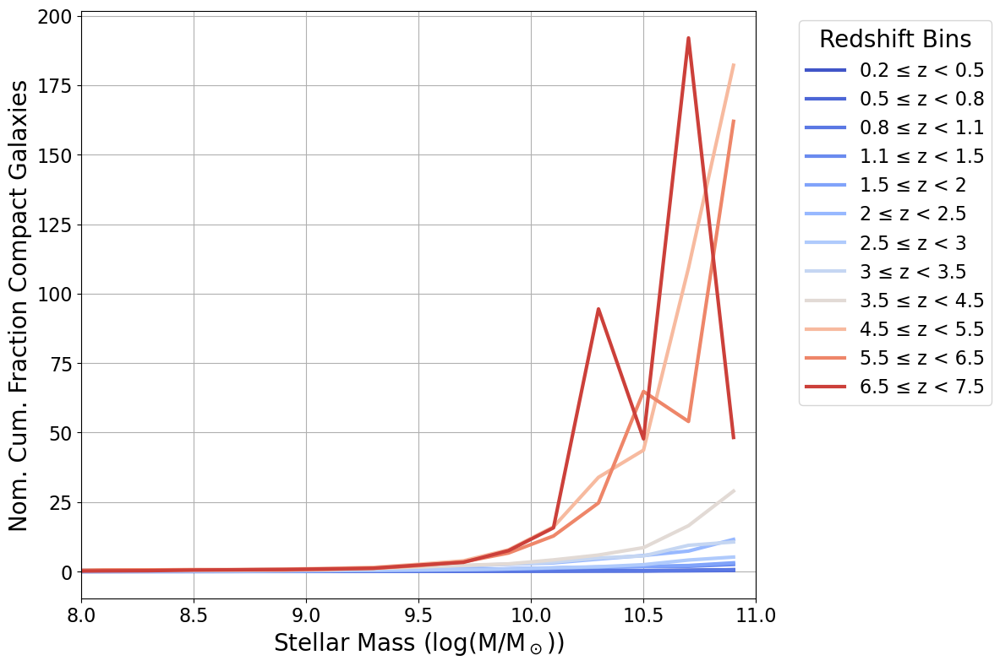

In [153]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import Normalize
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results
from astropy import units as u

# Assuming 'cosmos_cat' is your DataFrame and is already loaded

# Step 1: Define the super_compact_flag as previously corrected
cosmos_cat['super_compact_flag'] = (
    ((cosmos_cat['LP_zfinal'] < 1) & (cosmos_cat['RADIUS'] < (0.025 / 3600))) |
    ((cosmos_cat['LP_zfinal'] > 1) & (cosmos_cat['LP_zfinal'] < 3) & (cosmos_cat['RADIUS'] < (0.05 / 3600))) |
    ((cosmos_cat['LP_zfinal'] > 3) & (cosmos_cat['RADIUS'] < (0.07 / 3600)))
).astype(int)  # Convert boolean to integer (1 or 0)

# Step 2: Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5,7.5]

# Define stellar mass bins (log scale from 7 to 11)
mass_bins = np.linspace(7, 11, 21)  # 20 bins
mass_bin_centers = (mass_bins[:-1] + mass_bins[1:]) / 2

# Prepare the plot
plt.figure(figsize=(12, 8))
colormap = cm.coolwarm
norm = Normalize(vmin=np.min(zbins), vmax=np.max(zbins))

# Iterate over redshift bins and compute cumulative fraction
for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
    # Filter data for the current redshift bin
    z_mask = (cosmos_cat['LP_zfinal'] >= zlow) & (cosmos_cat['LP_zfinal'] < zup)
    subset = cosmos_cat[z_mask]
    
    # Check if subset is empty
    if subset.empty:
        print(f"No data in redshift bin {zlow} ≤ z < {zup}. Skipping.")
        continue
    
    # Bin the stellar mass
    mass = subset['LP_mass_med_PDF']
    mass_binned = pd.cut(mass, bins=mass_bins, include_lowest=True)
    
    # Group by mass bins and calculate counts
    grouped = subset.groupby(mass_binned)
    
    # Total galaxies per mass bin
    total_counts = grouped.size()
    
    # Super compact galaxies per mass bin
    compact_counts = grouped['super_compact_flag'].sum()
    
    # Fill NaN values with 0 (in case some mass bins have no galaxies)
    total_counts = total_counts.fillna(0)
    compact_counts = compact_counts.fillna(0)
    
    # Compute cumulative counts
    cumulative_total = total_counts.cumsum()
    cumulative_compact = compact_counts.cumsum()
    
    # Compute cumulative fraction
    cumulative_fraction = cumulative_compact #/ cumulative_total
    
    # Handle possible division by zero
    cumulative_fraction = cumulative_fraction.replace([np.inf, -np.inf], np.nan).fillna(0)
    
    # Midpoint of the current redshift bin for color mapping
    z_mid = (zlow + zup) / 2
    color = colormap(norm(z_mid))
    
    # Plotting
    plt.plot(mass_bin_centers, cumulative_fraction/total_counts, label=f'{zlow} ≤ z < {zup}', color=color, lw=3)

# Add colorbar
sm = cm.ScalarMappable(cmap=colormap, norm=norm)
sm.set_array([])  # Only needed for older versions of Matplotlib
#cbar = plt.colorbar(sm, ticks=zbins)
#cbar.set_label('Redshift (z)', fontsize=16)
#cbar.ax.tick_params(labelsize=14)

# Customize the plot
plt.xlabel('Stellar Mass (log(M/M$_\odot$))', fontsize=20)
#plt.ylabel('Cumulative Fraction of Super Compact Galaxies', fontsize=20)
plt.ylabel('Nom. Cum. Fraction Compact Galaxies', fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.xlim(8, 11)  # Cumulative fraction ranges from 0 to 1
plt.legend(title='Redshift Bins', fontsize=16, title_fontsize='20', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()


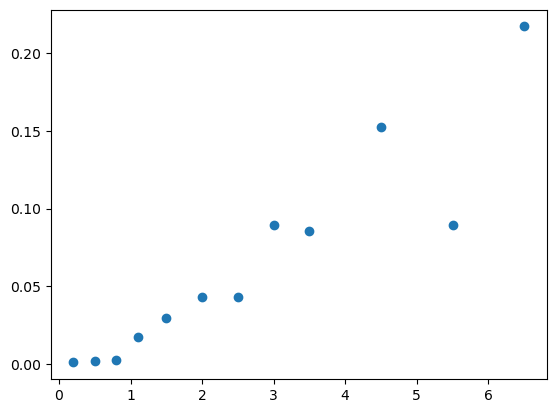

In [24]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import Normalize
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results
from astropy import units as u

# Assuming 'cosmos_cat' is your DataFrame and is already loaded

# Step 1: Define the super_compact_flag as previously corrected
cosmos_cat['super_compact_flag'] = (
    ((cosmos_cat['LP_zfinal'] < 1) & (cosmos_cat['RADIUS'] < (0.025 / 3600))) |
    ((cosmos_cat['LP_zfinal'] > 1) & (cosmos_cat['LP_zfinal'] < 3) & (cosmos_cat['RADIUS'] < (0.05 / 3600))) |
    ((cosmos_cat['LP_zfinal'] > 3) & (cosmos_cat['RADIUS'] < (0.07 / 3600)))
).astype(int)  # Convert boolean to integer (1 or 0)

# Step 2: Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5,7.5]

zvec=[]
comp_frac=[]
# Iterate over redshift bins and compute cumulative fraction
for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
    # Filter data for the current redshift bin
    z_mask = (cosmos_cat['LP_zfinal'] >= zlow) & (cosmos_cat['LP_zfinal'] < zup) & (cosmos_cat['LP_mass_med_PDF']>10)
    subset = cosmos_cat[z_mask]
    zvec.append(zlow)

    
    # Check if subset is empty
    if subset.empty:
        print(f"No data in redshift bin {zlow} ≤ z < {zup}. Skipping.")
        continue
    
    #
    compact_counts = subset['super_compact_flag'].sum()
    comp_frac.append(compact_counts/len(subset))
    

    
cum = {'Redshift_Low': np.array(zvec),'Fraction_Above10': np.array(comp_frac)}
cumulative_fraction_df = pd.DataFrame(data=cum)   


plt.scatter(cumulative_fraction_df.Redshift_Low,cumulative_fraction_df.Fraction_Above10)

# Define Physical Sizes

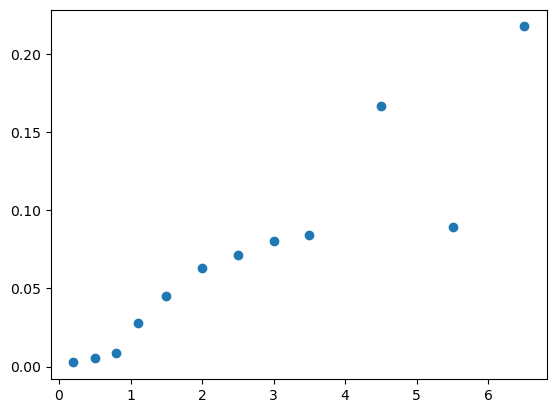

In [265]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import Normalize
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results
from astropy import units as u

# Assuming 'cosmos_cat' is your DataFrame and is already loaded

# Step 1: Define the super_compact_flag as previously corrected
cosmos_cat['super_compact_flag'] = (
    ((cosmos_cat['LP_zfinal'] < 1) & (cosmos_cat['radius_kpc'] < (0.5))) |
    ((cosmos_cat['LP_zfinal'] > 1) & (cosmos_cat['LP_zfinal'] < 3) & (cosmos_cat['radius_kpc'] < (0.5))) |
    ((cosmos_cat['LP_zfinal'] > 3) & (cosmos_cat['radius_kpc'] < (0.5)))
).astype(int)  # Convert boolean to integer (1 or 0)

# Step 2: Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5,7.5]

zvec=[]
comp_frac=[]
# Iterate over redshift bins and compute cumulative fraction
for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
    # Filter data for the current redshift bin
    z_mask = (cosmos_cat['LP_zfinal'] >= zlow) & (cosmos_cat['LP_zfinal'] < zup) & (cosmos_cat['LP_mass_med_PDF']>10)
    subset = cosmos_cat[z_mask]
    zvec.append(zlow)

    
    # Check if subset is empty
    if subset.empty:
        print(f"No data in redshift bin {zlow} ≤ z < {zup}. Skipping.")
        continue
    
    #
    compact_counts = subset['super_compact_flag'].sum()
    comp_frac.append(compact_counts/len(subset))
    

    
cum = {'Redshift_Low': np.array(zvec),'Fraction_Above10': np.array(comp_frac)}
cumulative_fraction_df = pd.DataFrame(data=cum)   


plt.scatter(cumulative_fraction_df.Redshift_Low,cumulative_fraction_df.Fraction_Above10)

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import Normalize
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results
from astropy import units as u



# Assuming 'cosmos_cat' is your DataFrame and is already loaded

# Step 1: Define the super_compact_flag as previously corrected
cosmos_cat['super_compact_flag'] = (
    ((cosmos_cat['LP_zfinal'] < 1) & (cosmos_cat['RADIUS'] < (0.025 / 3600))) |
    ((cosmos_cat['LP_zfinal'] > 1) & (cosmos_cat['LP_zfinal'] < 3) & (cosmos_cat['RADIUS'] < (0.05 / 3600))) |
    ((cosmos_cat['LP_zfinal'] > 3) & (cosmos_cat['RADIUS'] < (0.07 / 3600)))
).astype(int)  # Convert boolean to integer (1 or 0)

# Step 2: Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5,7.5]

zvec=[]
comp_frac=[]
# Iterate over redshift bins and compute cumulative fraction
for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
    # Filter data for the current redshift bin
    z_mask = (cosmos_cat['LP_zfinal'] >= zlow) & (cosmos_cat['LP_zfinal'] < zup) & (cosmos_cat['LP_mass_med_PDF']>10)
    subset = cosmos_cat[z_mask]
    zvec.append(zlow)

    
    # Check if subset is empty
    if subset.empty:
        print(f"No data in redshift bin {zlow} ≤ z < {zup}. Skipping.")
        continue
    
    #
    compact_counts = subset['super_compact_flag'].sum()
    comp_frac.append(compact_counts/len(subset))
    

    
cum = {'Redshift_Low': np.array(zvec),'Fraction_Above10': np.array(comp_frac)}
cumulative_fraction_df = pd.DataFrame(data=cum)   


plt.scatter(cumulative_fraction_df.Redshift_Low,cumulative_fraction_df.Fraction_Above10)

# Quiescent fraction

/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/807078500.py:48: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset_Q=quiescent[z_mask]
/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/807078500.py:48: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset_Q=quiescent[z_mask]
/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/807078500.py:48: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset_Q=quiescent[z_mask]
/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/807078500.py:48: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset_Q=quiescent[z_mask]
/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/807078500.py:48: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  subset_Q=quiescent[z_mask]
/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/807078

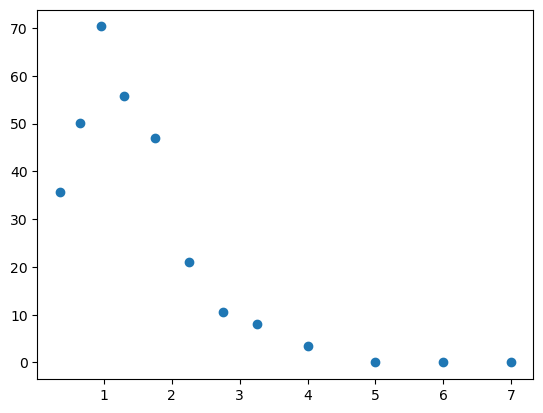

In [79]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import Normalize
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results
from astropy import units as u

# Assuming 'cosmos_cat' is your DataFrame and is already loaded

# Step 1: Define the super_compact_flag as previously corrected

quiescent = cosmos_cat.query(
    '((LP_MNUV_phys - LP_MR_phys) > 3 * (LP_MR_phys - LP_MJ_phys)) & '
    '((LP_MNUV_phys - LP_MR_phys) > 3.1) & '
    '(LP_warn_fl == 0) & '
    '(FLAG_STAR_HSC == 0) & '
    '(MAG_MODEL_F150W > 0) & '
    '(MAG_MODEL_F150W < 28) & '
    '(LP_mass_med_PDF > 10) & '
    '(LP_mass_med_PDF < 12) & '
    '(LP_zfinal > 0) & '
    '(LP_zfinal < 7)'
)

clean = cosmos_cat.query('(LP_warn_fl == 0) & '
    '(FLAG_STAR_HSC == 0) & '
    '(MAG_MODEL_F150W > 0) & '
    '(MAG_MODEL_F150W < 28) & '
    '(LP_mass_med_PDF > 10) & '
    '(LP_mass_med_PDF < 12) & '
    '(LP_zfinal > 0) & '
    '(LP_zfinal < 7)')



# Step 2: Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5,7.5]

zvec=[]
Q_frac=[]

# Iterate over redshift bins and compute cumulative fraction
for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
    # Filter data for the current redshift bin
    z_mask = (cosmos_cat['LP_zfinal'] >= zlow) & (cosmos_cat['LP_zfinal'] < zup) & (cosmos_cat['LP_mass_med_PDF']>10)
    subset_all = cosmos_cat[z_mask]
    subset_Q=quiescent[z_mask]
    zvec.append((zlow+zup)/2)
    Q_frac.append(len(subset_Q)/len(subset))
    

    

 


plt.scatter(zvec,Q_frac)

# Stellar Mass Functions

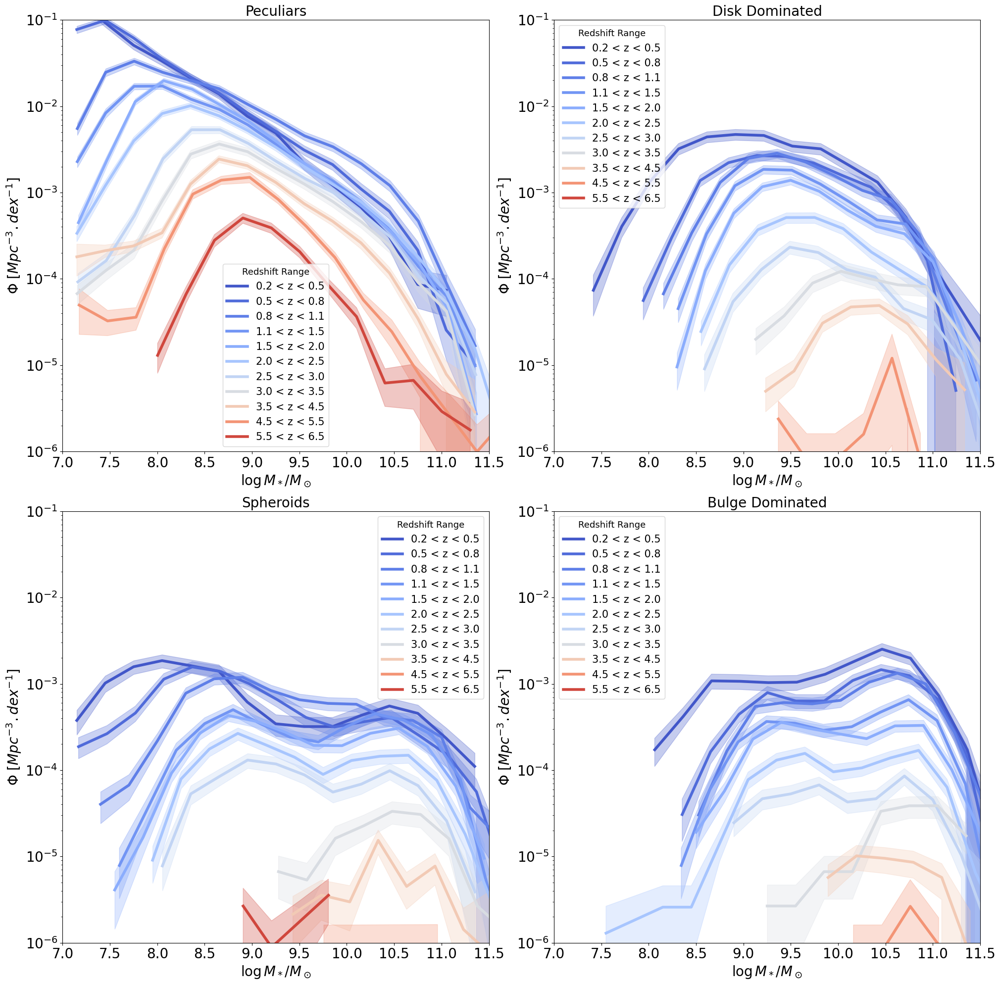

In [31]:
import matplotlib.pyplot as plt
import numpy as np
import pickle
from matplotlib.cm import coolwarm
from matplotlib.colors import Normalize

plots_path='/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures'

# Load smf_morph from the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompact_0.07F444.pkl'
with open(file_path, 'rb') as f:
    smf_morph = pickle.load(f)

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2.0, 2.5, 3.0, 3.5, 4.5, 5.5,6.5]

# Set up a figure with four subplots
plt.figure(figsize=(20, 20))

# Morphological classes and labels
morph_class = ['irr', 'disk', 'sph', 'db']  # Only these four classes
morph_labels = {'comp':'compact','sph': 'Spheroids', 'irr': 'Peculiars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated','all':'All'}

# Prepare colormap, ensure normalization covers actual redshift range used
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)

# Loop over morphological classes
for idx, cl in enumerate(morph_class):
    ax = plt.subplot(2, 2, idx + 1)  # 2x2 grid of subplots
    
    # Loop over the redshift bins for the given morphological class
    for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties
        
            
       

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties
            #Fi_sph=smf_morph[((zlow, 'sph', 'Fi'))]
            #dFi_sph=smf_morph[((zlow, 'sph', 'dFi'))]

            if cl == 'sph':
                #Fi = smf_morph[key_fi]
                #dFi = smf_morph[key_dfi]  # Uncertainties
                LogMassbin_sph = smf_morph[((zlow, 'comp', 'LogMassbin'))]
                Fi_sph=smf_morph[((zlow, 'comp', 'Fi'))]
                dFi_sph=smf_morph[((zlow, 'comp', 'dFi'))]

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values

                if cl=='sph':
                    Fi_pos_sph = Fi_sph[Fi_sph > 0]
                    LogMassbin_pos_sph = LogMassbin_sph[Fi_sph > 0]
                    dFi_pos_sph = dFi_sph[Fi_sph > 0]  # Only positive Fi values


                color = coolwarm(norm((zlow + zup) / 2))  # Color represents midpoint of z range
                
                # Plot the SMF with error bars
                ax.plot(LogMassbin_pos, Fi_pos, color=color, label=f'{zlow:.1f} < z < {zup:.1f}', lw=4)
                ax.fill_between(LogMassbin_pos, Fi_pos - dFi_pos, Fi_pos + dFi_pos, color=color, alpha=0.3)
                #if cl=='sph':
                #    ax.plot(LogMassbin_pos_sph, Fi_pos_sph, color=color, lw=2,ls='--')
    ax.set_ylim(1e-6, 1e-1)  # Adjust according to your data  
    ax.set_xlim(7, 11.5)          
    ax.tick_params(axis='both', labelsize=20)
    ax.set_title(morph_labels.get(cl, cl), fontsize=20)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=20)
    ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=20)
    ax.set_yscale('log')
    
    
    ax.legend(fontsize=15, title="Redshift Range", title_fontsize='13')

plt.tight_layout()
#plt.savefig(os.path.join(plots_path,'smf_4types_v3.1.jpg'))
plt.show()


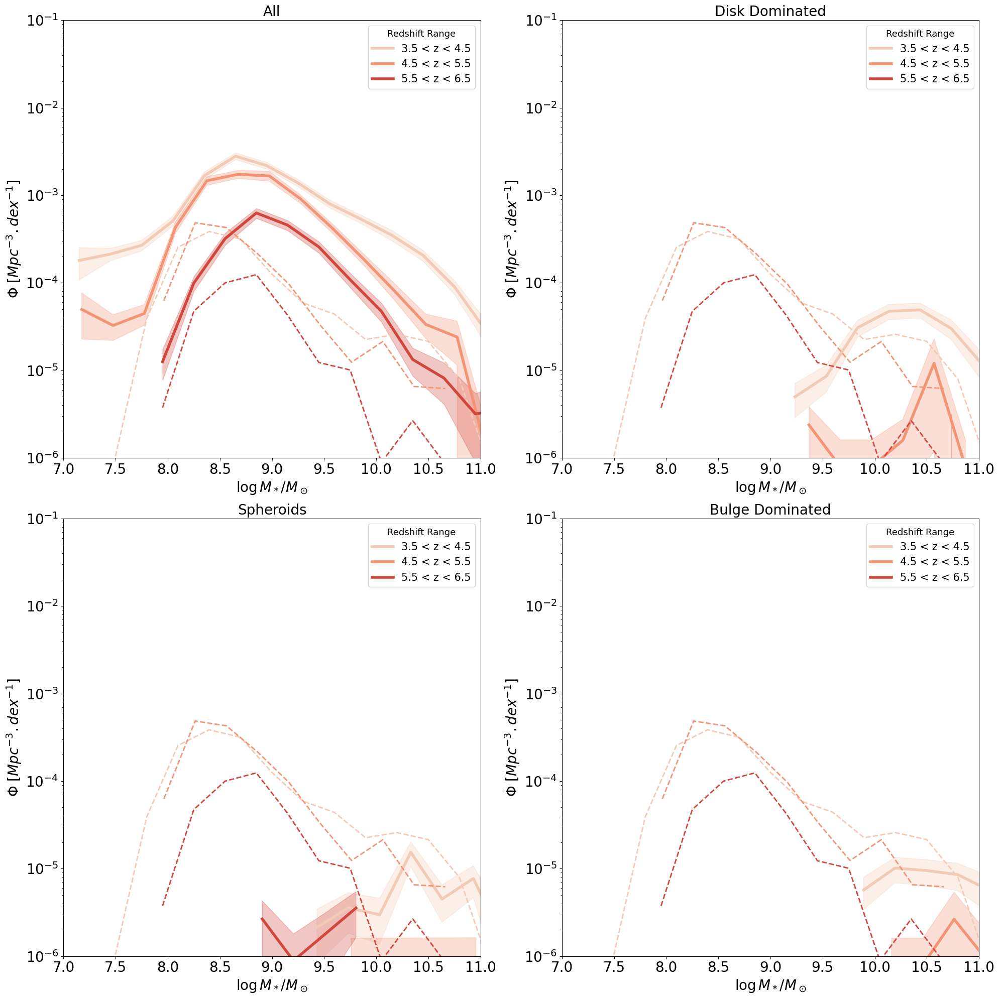

In [98]:
import matplotlib.pyplot as plt
import numpy as np
import pickle
from matplotlib.cm import coolwarm
from matplotlib.colors import Normalize

plots_path='/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures'

# Load smf_morph from the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompact_0.07F444.pkl'
with open(file_path, 'rb') as f:
    smf_morph = pickle.load(f)

# Define redshift bins
zbins = [3.5, 4.5, 5.5,6.5]
#zbins =[0.2,0.5,1.0,1.5,2.0]
# Set up a figure with four subplots
plt.figure(figsize=(20, 20))

# Morphological classes and labels
morph_class = ['all', 'disk', 'sph', 'db']  # Only these four classes
morph_labels = {'comp':'compact','sph': 'Spheroids', 'irr': 'Peculiars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated','all':'All'}

# Prepare colormap, ensure normalization covers actual redshift range used
zmin = 0.2
zmax = 6.5
norm = Normalize(vmin=zmin, vmax=zmax)

# Loop over morphological classes
for idx, cl in enumerate(morph_class):
    ax = plt.subplot(2, 2, idx + 1)  # 2x2 grid of subplots
    
    # Loop over the redshift bins for the given morphological class
    for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties
        
            
       

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties
            #Fi_sph=smf_morph[((zlow, 'sph', 'Fi'))]
            #dFi_sph=smf_morph[((zlow, 'sph', 'dFi'))]

            #if cl == 'sph':
                #Fi = smf_morph[key_fi]
                #dFi = smf_morph[key_dfi]  # Uncertainties
            LogMassbin_sph = smf_morph[((zlow, 'comp', 'LogMassbin'))]
            Fi_sph=smf_morph[((zlow, 'comp', 'Fi'))]
            dFi_sph=smf_morph[((zlow, 'comp', 'dFi'))]

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values

                #if cl=='sph':
                Fi_pos_sph = Fi_sph[Fi_sph > 0]
                LogMassbin_pos_sph = LogMassbin_sph[Fi_sph > 0]
                dFi_pos_sph = dFi_sph[Fi_sph > 0]  # Only positive Fi values


                color = coolwarm(norm((zlow + zup) / 2))  # Color represents midpoint of z range
                
                # Plot the SMF with error bars
                ax.plot(LogMassbin_pos, Fi_pos, color=color, label=f'{zlow:.1f} < z < {zup:.1f}', lw=4)
                ax.fill_between(LogMassbin_pos, Fi_pos - dFi_pos, Fi_pos + dFi_pos, color=color, alpha=0.3)
                #if cl=='sph':
                ax.plot(LogMassbin_pos_sph, Fi_pos_sph, color=color, lw=2,ls='--')
    ax.set_ylim(1e-6, 1e-1)  # Adjust according to your data   
    ax.set_xlim(7, 11)          
    ax.tick_params(axis='both', labelsize=20)
    ax.set_title(morph_labels.get(cl, cl), fontsize=20)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=20)
    ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=20)
    ax.set_yscale('log')
    
    
    ax.legend(fontsize=15, title="Redshift Range", title_fontsize='13')

plt.tight_layout()
#plt.savefig(os.path.join(plots_path,'smf_4types_v3.1.jpg'))
plt.show()


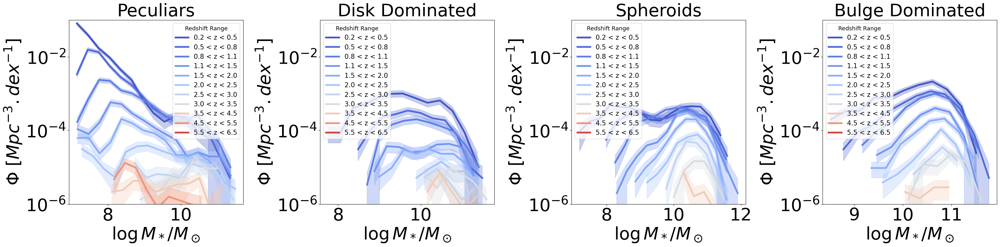

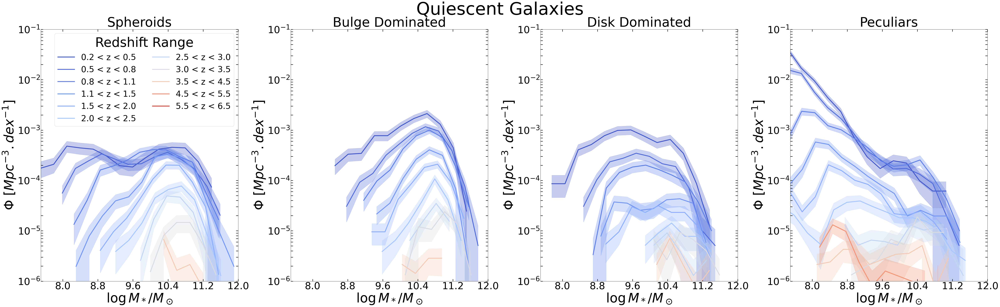

In [189]:
import matplotlib.pyplot as plt
import numpy as np
import pickle
from matplotlib.cm import coolwarm
from matplotlib.colors import Normalize
import os  # Added to use os.path.join

plots_path = '/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures'

# Load smf_morph from the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompact_0.07F444_Q.pkl'
with open(file_path, 'rb') as f:
    smf_morph = pickle.load(f)

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2.0, 2.5, 3.0, 3.5, 4.5, 5.5, 6.5]

# Set up a figure with four subplots
plt.figure(figsize=(64, 20))

# Morphological classes and labels
morph_class = ['sph', 'db', 'disk', 'irr']  # Only these four classes
morph_labels = {'sph': 'Spheroids', 'irr': 'Peculiars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated'}

# Prepare colormap, ensure normalization covers actual redshift range used
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)

# Loop over morphological classes
for idx, cl in enumerate(morph_class):
    ax = plt.subplot(1, 4, idx + 1)  # 1x4 grid of subplots

    # Loop over the redshift bins for the given morphological class
    for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values

                color = coolwarm(norm((zlow + zup) / 2))  # Color represents midpoint of z range

                # Plot the SMF with error bars
                ax.plot(LogMassbin_pos, Fi_pos, color=color, label=f'{zlow:.1f} < z < {zup:.1f}', lw=4)
                ax.fill_between(LogMassbin_pos, Fi_pos - dFi_pos, Fi_pos + dFi_pos, color=color, alpha=0.3)

    ax.set_ylim(1e-6, 1e-1)  # Adjust according to your data
    ax.set_xlim(7.5, 12)
    # Add ticks on both axes (both sides)
    ax.tick_params(axis='both', which='both', labelsize=45, direction='in', top=True, right=True,length=10, width=2)
    ax.xaxis.set_major_locator(ticker.MaxNLocator(nbins=7))

    ax.set_title(morph_labels.get(cl, cl), fontsize=60)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=60)
    ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=60)
    ax.set_yscale('log')

    # Put the legend in two columns
    if idx==0:
        ax.legend(fontsize=38, title="Redshift Range", title_fontsize='60', ncol=2)

plt.suptitle('Quiescent Galaxies', fontsize=80)
plt.tight_layout()
plt.savefig(os.path.join(plots_path,'smf_4types_v3.1_Q.jpg'))
plt.show()


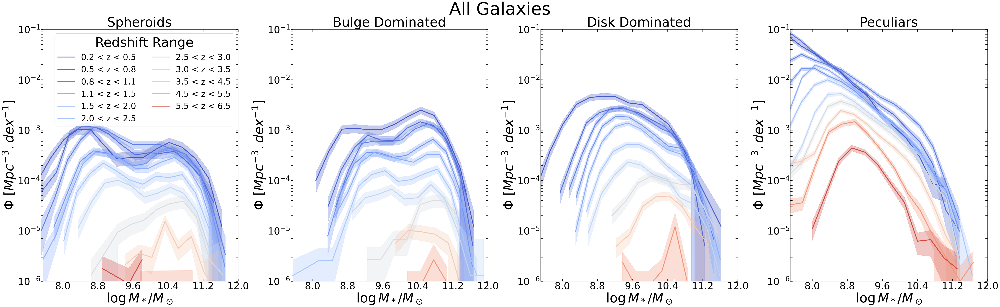

In [187]:
import matplotlib.pyplot as plt
import numpy as np
import pickle
from matplotlib.cm import coolwarm
from matplotlib.colors import Normalize
import os  # Added to use os.path.join
import matplotlib.ticker as ticker

plots_path = '/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures'

# Load smf_morph from the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444.pkl'
with open(file_path, 'rb') as f:
    smf_morph = pickle.load(f)

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2.0, 2.5, 3.0, 3.5, 4.5, 5.5, 6.5]

# Set up a figure with four subplots
plt.figure(figsize=(64, 20))

# Morphological classes and labels
morph_class = ['sph', 'db', 'disk', 'irr']  # Only these four classes
morph_labels = {'sph': 'Spheroids', 'irr': 'Peculiars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated'}

# Prepare colormap, ensure normalization covers actual redshift range used
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)

# Loop over morphological classes
for idx, cl in enumerate(morph_class):
    ax = plt.subplot(1, 4, idx + 1)  # 1x4 grid of subplots

    # Loop over the redshift bins for the given morphological class
    for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values

                color = coolwarm(norm((zlow + zup) / 2))  # Color represents midpoint of z range

                # Plot the SMF with error bars
                ax.plot(LogMassbin_pos, Fi_pos, color=color, label=f'{zlow:.1f} < z < {zup:.1f}', lw=4)
                ax.fill_between(LogMassbin_pos, Fi_pos - dFi_pos, Fi_pos + dFi_pos, color=color, alpha=0.3)

    ax.set_ylim(1e-6, 1e-1)  # Adjust according to your data
    ax.set_xlim(7.5, 12)
    # Add ticks on both axes (both sides)
    ax.tick_params(axis='both', which='both', labelsize=45, direction='in', top=True, right=True,length=10, width=2)
    ax.xaxis.set_major_locator(ticker.MaxNLocator(nbins=7))

    ax.set_title(morph_labels.get(cl, cl), fontsize=60)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=60)
    ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=60)
    ax.set_yscale('log')

    # Put the legend in two columns
    if idx==0:
        ax.legend(fontsize=38, title="Redshift Range", title_fontsize='60', ncol=2)

plt.suptitle('All Galaxies', fontsize=80)
plt.tight_layout()
plt.savefig(os.path.join(plots_path,'smf_4types_v3.1_A.jpg'))
plt.show()


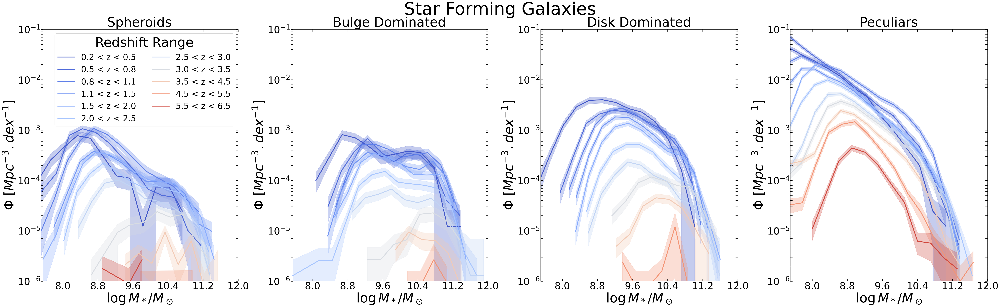

In [188]:
import matplotlib.pyplot as plt
import numpy as np
import pickle
from matplotlib.cm import coolwarm
from matplotlib.colors import Normalize
import os  # Added to use os.path.join

plots_path = '/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures'

# Load smf_morph from the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444_SF.pkl'
with open(file_path, 'rb') as f:
    smf_morph = pickle.load(f)

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2.0, 2.5, 3.0, 3.5, 4.5, 5.5, 6.5]

# Set up a figure with four subplots
plt.figure(figsize=(64, 20))

# Morphological classes and labels
morph_class = ['sph', 'db', 'disk', 'irr']  # Only these four classes
morph_labels = {'sph': 'Spheroids', 'irr': 'Peculiars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated'}

# Prepare colormap, ensure normalization covers actual redshift range used
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)

# Loop over morphological classes
for idx, cl in enumerate(morph_class):
    ax = plt.subplot(1, 4, idx + 1)  # 1x4 grid of subplots

    # Loop over the redshift bins for the given morphological class
    for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values

                color = coolwarm(norm((zlow + zup) / 2))  # Color represents midpoint of z range

                # Plot the SMF with error bars
                ax.plot(LogMassbin_pos, Fi_pos, color=color, label=f'{zlow:.1f} < z < {zup:.1f}', lw=4)
                ax.fill_between(LogMassbin_pos, Fi_pos - dFi_pos, Fi_pos + dFi_pos, color=color, alpha=0.3)

    ax.set_ylim(1e-6, 1e-1)  # Adjust according to your data

    ax.set_xlim(7.5, 12)
    # Add ticks on both axes (both sides)
    ax.tick_params(axis='both', which='both', labelsize=45, direction='in', top=True, right=True,length=10, width=2)
    ax.xaxis.set_major_locator(ticker.MaxNLocator(nbins=7))

    ax.set_title(morph_labels.get(cl, cl), fontsize=60)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=60)
    ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=60)
    ax.set_yscale('log')

    # Put the legend in two columns
    if idx==0:
        ax.legend(fontsize=38, title="Redshift Range", title_fontsize='60', ncol=2)

plt.suptitle('Star Forming Galaxies', fontsize=80)
plt.tight_layout()
plt.savefig(os.path.join(plots_path,'smf_4types_v3.1_SF.jpg'))
plt.show()


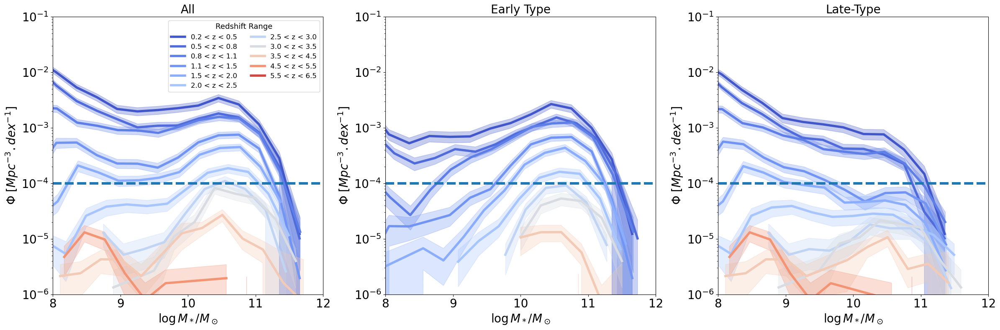

In [332]:
import matplotlib.pyplot as plt
import numpy as np
import pickle
from matplotlib.cm import coolwarm
from matplotlib.colors import Normalize

plots_path='/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures'

# Load smf_morph from the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444_Q.pkl'
with open(file_path, 'rb') as f:
    smf_morph = pickle.load(f)

# Define redshift bins
#zbins = [3.0, 3.5, 4.5, 5.5]
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2.0, 2.5, 3.0, 3.5, 4.5, 5.5,6.5]

# Set up a figure with four subplots
plt.figure(figsize=(24, 8))

# Morphological classes and labels
morph_class = ['all', 'early','late']  # Only these four classes
morph_labels = {'all':'All','sph': 'Spheroids', 'irr': 'Peculiars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated','late':'Late-Type','early':'Early Type'}

# Prepare colormap, ensure normalization covers actual redshift range used
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)

# Loop over morphological classes
for idx, cl in enumerate(morph_class):
    ax = plt.subplot(1, 3, idx + 1)  # 2x2 grid of subplots
    
    # Loop over the redshift bins for the given morphological class
    for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values

                color = coolwarm(norm((zlow + zup) / 2))  # Color represents midpoint of z range
                
                # Plot the SMF with error bars
                ax.plot(LogMassbin_pos, Fi_pos, color=color, label=f'{zlow:.1f} < z < {zup:.1f}', lw=4)
                ax.fill_between(LogMassbin_pos, Fi_pos - dFi_pos, Fi_pos + dFi_pos, color=color, alpha=0.3)
                plt.axhline(y=1e-4,ls='--',lw=4)
    ax.set_ylim(1e-6, 1e-1)  # Adjust according to your data    
    ax.set_xlim(7, 13)         
    ax.tick_params(axis='both', labelsize=20)
    ax.set_title(morph_labels.get(cl, cl), fontsize=20)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=20)
    ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=20)
    ax.set_yscale('log')
    
    if idx==0:
        ax.legend(fontsize=12, title="Redshift Range", title_fontsize='13',ncol=2)


plt.tight_layout()
plt.savefig(os.path.join(plots_path,'smf_early_late_Q.jpg'))
plt.show()


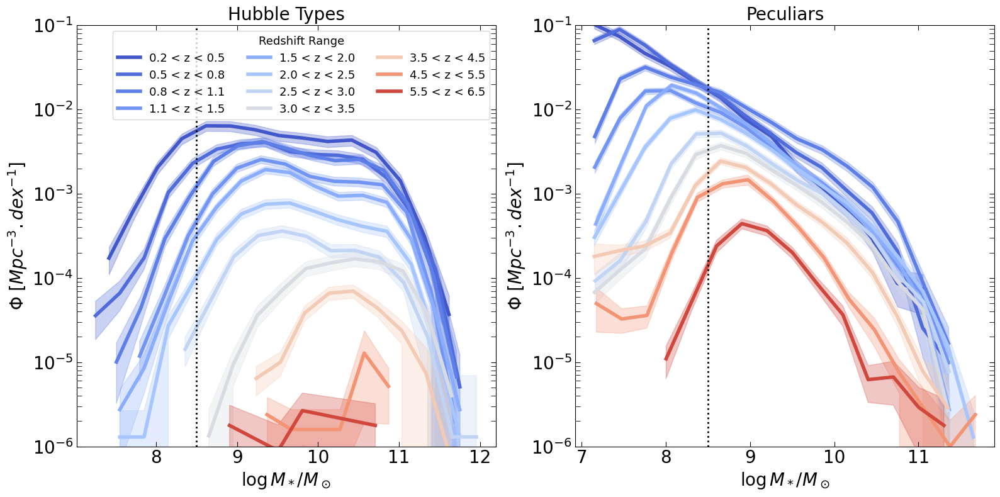

In [175]:
import matplotlib.pyplot as plt
import numpy as np
import pickle
import os
from matplotlib.cm import coolwarm
from matplotlib.colors import Normalize

plots_path = '/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures'

# Load smf_morph from the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444.pkl'
with open(file_path, 'rb') as f:
    smf_morph = pickle.load(f)

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2.0, 2.5, 3.0, 3.5, 4.5, 5.5,6.5]

# Set up a figure with four subplots
plt.figure(figsize=(16, 8))

# Morphological classes and labels
morph_class = ['reg','irr']
morph_labels = {'comp':'Compact','sph': 'Spheroids', 'irr': 'Peculiars', 'disk': 'Disk Dominated', 'reg': 'Hubble Types'}

# Prepare colormap, ensure normalization covers actual redshift range used
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)

# Loop over morphological classes
for idx, cl in enumerate(morph_class):
    ax = plt.subplot(1, 2, idx + 1)  # 2x2 grid of subplots
    
    # Loop over the redshift bins for the given morphological class
    for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values

                color = coolwarm(norm((zlow + zup) / 2))  # Color represents midpoint of z range
                
                # Plot the SMF with error bars
                ax.plot(LogMassbin_pos, Fi_pos, color=color, label=f'{zlow:.1f} < z < {zup:.1f}', lw=4)
                ax.fill_between(LogMassbin_pos, Fi_pos - dFi_pos, Fi_pos + dFi_pos, color=color, alpha=0.3)

    ax.set_title(morph_labels.get(cl, cl), fontsize=20)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=20)
    ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=20)
    ax.set_yscale('log')
    ax.set_ylim(1e-6, 1e-1)

    # Set ticks on both sides of the y-axis
    ax.yaxis.set_ticks_position('both')
    ax.xaxis.set_ticks_position('both')

    ax.axvline(x=8.5,ls=':',color='black',lw=2)

    # Ensure tick marks are visible on all sides
    ax.tick_params(axis='both', which='both', labelsize=20, direction='in', length=6)
    if idx==0:
        ax.legend(fontsize=13, title="Redshift Range", title_fontsize='13',ncol=3,loc='upper right')

plt.tight_layout()
plt.savefig(os.path.join(plots_path, 'SMF_peculiar_hubble.png'))
plt.show()


(60000, 24)
/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/samplers/smf_morph_3.1_allerrors_nocompact_4.5_reg_DPL_8.5_sampler.h5
(60000, 40)
(60000, 32)
8.59200595369256 -3.9263724153141535 -0.10157363309622033 -4.992934936544177
(60000, 24)
/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/samplers/smf_morph_3.1_allerrors_nocompact_4.5_irr_DPL_8.5_sampler.h5
(60000, 40)
(60000, 32)
9.88053078973087 -1.5235345125711088 1.9149473510357113 -3.6841170158376597
(60000, 24)
/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/samplers/smf_morph_3.1_allerrors_nocompact_4.5_all_DPL_8.5_sampler.h5
(60000, 40)
(60000, 32)
9.67343399522309 -1.3524805102457846 2.6079429247566828 -3.394513722694241


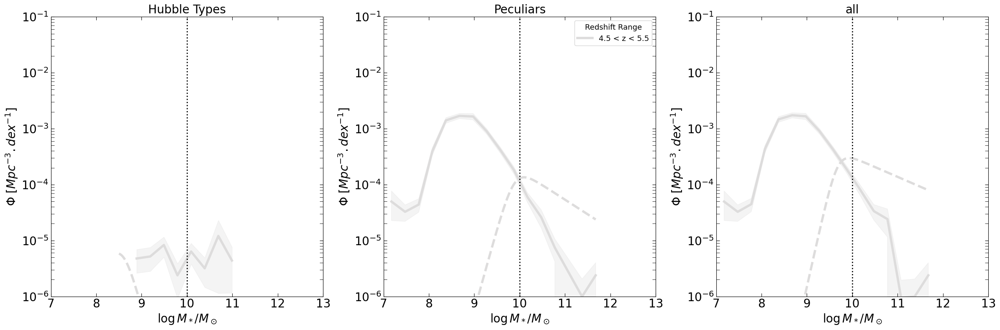

In [17]:
import matplotlib.pyplot as plt
import numpy as np
import pickle
from matplotlib.cm import coolwarm
from matplotlib.colors import Normalize
import h5py
import os

def schechter_function(logM, logphi_star, logM_star, alpha):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**logphi_star
    return np.log(10) * phi_star * (M / M_star)**(alpha+1) * np.exp(-M / M_star)

def double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2):
    M_over_M_star = logM - logM_star
    return np.log(10) * np.exp(-10**M_over_M_star) * 10**M_over_M_star * (10**logphi1 * 10**(M_over_M_star * alpha1) + 10**logphi2 * 10**(M_over_M_star * alpha2))

def DPL(logM, logM_star, alpha1, alpha2, phi_star):
    term1 = 10 ** (-(logM - logM_star) * (alpha1 + 1))
    term2 = 10 ** (-(logM - logM_star) * (alpha2 + 1))
    phi_logM_star = 10**phi_star / (term1 + term2)
    return phi_logM_star


def load_mcmc_results(file_path):
    with h5py.File(file_path, 'r') as f:
        samples = f['chain'][:]  # Shape: (n_steps, n_walkers, n_params)
        log_prob = f['log_prob'][:]  # Shape: (n_steps, n_walkers)
    
    print(log_prob.shape)
    best_log_prob_index = np.argmax(np.max(log_prob, axis=1))
    best_walker_index = np.argmax(log_prob[best_log_prob_index])
    
    best_params = samples[best_log_prob_index, best_walker_index]
    best_log_prob = log_prob[best_log_prob_index, best_walker_index]

    #print(best_params)
    
    return best_params, best_log_prob

def calculate_bic(log_prob, num_params, num_data_points):
    """ Calculate BIC using log likelihood, number of parameters, and number of data points. """
    return -2 * log_prob + num_params * np.log(num_data_points)

# Load smf_morph from the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompact.pkl'
with open(file_path, 'rb') as f:
    smf_morph = pickle.load(f)

# Define redshift bins
#zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5]
zbins=[4.5, 5.5]
# Set up a figure with four subplots
plt.figure(figsize=(24, 8))

# Morphological classes and labels
morph_class = ['reg', 'irr','all']  # Only these classes
morph_labels = {'All':'all','reg': 'Hubble Types', 'irr': 'Peculiars','comp': 'Compacts','disk':'Disks'}

# Prepare colormap, ensure normalization covers actual redshift range used
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)

# Base path for samplers
base_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/samplers'

# Loop over morphological classes
for idx, cl in enumerate(morph_class):
    ax = plt.subplot(1, 3, idx + 1)  # 2x2 grid of subplots
    
    # Loop over the redshift bins for the given morphological class
    for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            #print(zlow)
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values

                color = coolwarm(norm((zlow + zup) / 2))  # Color represents midpoint of z range
                
                # Plot the observed SMF with error bars
                ax.plot(LogMassbin_pos, Fi_pos, color=color, label=f'{zlow:.1f} < z < {zup:.1f}', lw=4)
                ax.fill_between(LogMassbin_pos, Fi_pos - dFi_pos, Fi_pos + dFi_pos, color=color, alpha=0.3)
                
                # Load best-fit model parameters and calculate BIC
                single_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompact_{zlow}_{cl}_single_8.5_sampler.h5')
                double_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompact_{zlow}_{cl}_double_8.5_sampler.h5')
                DPL_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompact_{zlow}_{cl}_DPL_8.5_sampler.h5')

                best_model = None
                best_bic = np.inf

                # Evaluate Single Schechter model
                if os.path.exists(single_file):
                    params_single, log_prob_single = load_mcmc_results(single_file)
                    bic_single = calculate_bic(log_prob_single, len(params_single), len(LogMassbin_pos))
                    #print(zlow,bic_single)
                    if bic_single < best_bic:
                        best_bic = bic_single
                        best_model = ('Single', params_single)
                print((DPL_file))
                # Evaluate Double Schechter model
                if os.path.exists(double_file):
                    params_double, log_prob_double = load_mcmc_results(double_file)
                    bic_double = calculate_bic(log_prob_double, len(params_double), len(LogMassbin_pos))
                    if bic_double < best_bic:
                        best_bic = bic_double
                        best_model = ('Double', params_double)

                # Evaluate DPL model
                if os.path.exists(DPL_file):
                    params_DPL, log_prob_DPL = load_mcmc_results(DPL_file)
                    #print(params_DPL.shape)
                    bic_DPL = calculate_bic(log_prob_DPL, len(params_DPL), len(LogMassbin_pos))
                    if bic_DPL < best_bic:
                        best_bic = bic_DPL
                        best_model = ('DPL', params_DPL)

                # Generate the model curves for the best model
                #
                best_model = ('DPL', params_double)
                #print(best_model[0])
                print(*best_model[1][:4])
                
                if best_model is not None:
                    log_mass_range = np.linspace(8.5, max(LogMassbin_pos), 500)
                    
                    if best_model[0] == 'Single':
                        model_fit = schechter_function(log_mass_range, *best_model[1][:3])
                    elif best_model[0] == 'Double':
                        model_fit = double_schechter_function(log_mass_range, *best_model[1][:5])
                    elif best_model[0] == 'DPL':
                        model_fit = DPL(log_mass_range, *best_model[1][:4])

                    # Plot the best-fit model
                    ax.plot(log_mass_range, model_fit, color=color, linestyle='--', lw=4)
                    #print(model_fit)
                
    ax.set_title(morph_labels.get(cl, cl), fontsize=20)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=20)
    ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=20)
    ax.set_yscale('log')
    ax.set_ylim(1e-6, 1e-1)
    ax.set_xlim(7, 13)

    # Set ticks on both sides of the y-axis
    ax.yaxis.set_ticks_position('both')
    ax.xaxis.set_ticks_position('both')

    ax.axvline(x=10,ls=':',color='black',lw=2)

    # Ensure tick marks are visible on all sides
    ax.tick_params(axis='both', which='both', labelsize=20, direction='in', length=6)
    if idx==1:
        ax.legend(fontsize=13, title="Redshift Range", title_fontsize='13',ncol=2,loc='upper right')

plt.tight_layout()
#plt.savefig(os.path.join(plots_path, 'SMF_peculiar_hubble_schechter.png'))

plt.show()


0.2 Single irr 1662609.010108466


ValueError: operands could not be broadcast together with shapes (500,) (3,) 

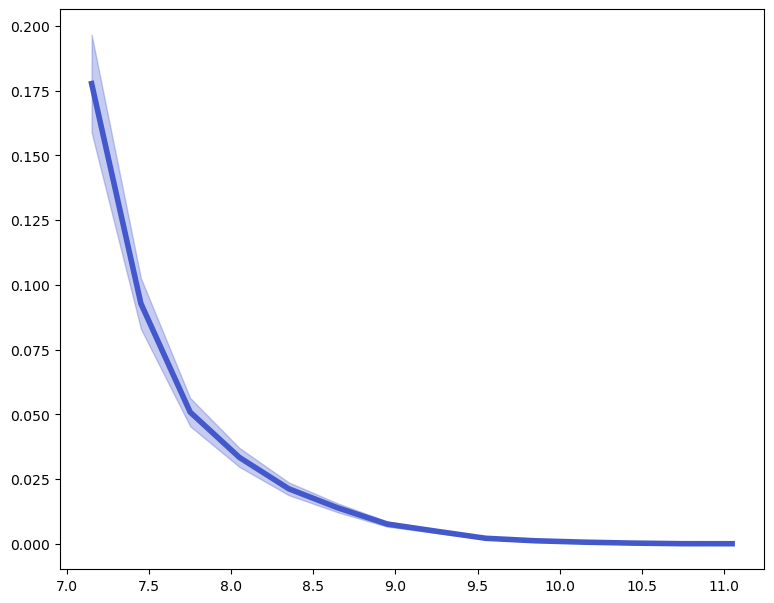

In [374]:





import matplotlib.pyplot as plt
import numpy as np
import pickle
from matplotlib.cm import coolwarm
from matplotlib.colors import Normalize
import h5py
import os





# Load smf_morph from the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompact.pkl'
with open(file_path, 'rb') as f:
    smf_morph = pickle.load(f)

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5]

# Set up a figure with four subplots
plt.figure(figsize=(20, 16))

# Morphological classes and labels
morph_class = ['irr', 'disk', 'sph', 'all']
morph_labels = {'all':'All','comp':'Compact','sph': 'Spheroids', 'irr': 'Peculiars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated'}

# Prepare colormap, ensure normalization covers actual redshift range used
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)

# Base path for samplers
base_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/samplers'

# Loop over morphological classes
for idx, cl in enumerate(morph_class):
    ax = plt.subplot(2, 2, idx + 1)  # 2x2 grid of subplots
    
    # Loop over the redshift bins for the given morphological class
    for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            #print(zlow)
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values

                color = coolwarm(norm((zlow + zup) / 2))  # Color represents midpoint of z range
                
                # Plot the observed SMF with error bars
                ax.plot(LogMassbin_pos, Fi_pos, color=color, label=f'{zlow:.1f} < z < {zup:.1f}', lw=4)
                ax.fill_between(LogMassbin_pos, Fi_pos - dFi_pos, Fi_pos + dFi_pos, color=color, alpha=0.3)
                
                # Load best-fit model parameters and calculate BIC
                single_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompact_{zlow}_{cl}_single_8.5_sampler.h5')
                double_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompact_{zlow}_{cl}_double_8.5_sampler.h5')
                DPL_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompact_{zlow}_{cl}_DPL_8.5_sampler.h5')

                best_model = None
                best_bic = np.inf

                # Evaluate Single Schechter model
                if os.path.exists(single_file):
                    params_single, log_prob_single = load_mcmc_results(single_file)
                    bic_single = calculate_bic(log_prob_single, len(params_single), len(LogMassbin_pos))
                    
                    if bic_single < best_bic:
                        best_bic = bic_single
                        best_model = ('Single', params_single)

                # Evaluate Double Schechter model
                if os.path.exists(double_file):
                    params_double, log_prob_double = load_mcmc_results(double_file)
                    bic_double = calculate_bic(log_prob_double, len(params_double), len(LogMassbin_pos))
                    if bic_double < best_bic:
                        best_bic = bic_double
                        best_model = ('Double', params_double)

                # Evaluate DPL model
                if os.path.exists(DPL_file):
                    params_DPL, log_prob_DPL = load_mcmc_results(DPL_file)
                    bic_DPL = calculate_bic(log_prob_DPL, len(params_DPL), len(LogMassbin_pos))
                    if bic_DPL < best_bic:
                        best_bic = bic_DPL
                        best_model = ('Double', params_double)

                # Generate the model curves for the best model
                print(zlow,best_model[0],cl,best_bic)
                #best_model = ('Double', params_double)
                if best_model is not None:
                    log_mass_range = np.linspace(8.5, 11.5, 500)
                    
                    if best_model[0] == 'Single':
                        model_fit = schechter_function(log_mass_range, *best_model[1][:3])
                    elif best_model[0] == 'Double':
                        model_fit = double_schechter_function(log_mass_range, *best_model[1][:5])
                    elif best_model[0] == 'DPL':
                        model_fit = DPL(log_mass_range, *best_model[1][:4])

                    # Plot the best-fit model
                    ax.plot(log_mass_range, model_fit, color=color, linestyle='--', lw=4)
                
    ax.set_title(morph_labels.get(cl, cl), fontsize=20)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=20)
    ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=20)
    ax.set_yscale('log')
    ax.set_ylim(1e-6, 1e-1)
    ax.set_xlim(7, 12)

    # Set ticks on both sides of the y-axis
    ax.yaxis.set_ticks_position('both')
    ax.xaxis.set_ticks_position('both')

    ax.axvline(x=8.5,ls=':',color='black',lw=2)

    # Ensure tick marks are visible on all sides
    ax.tick_params(axis='both', which='both', labelsize=20, direction='in', length=6)
    if idx==1:
        ax.legend(fontsize=13, title="Redshift Range", title_fontsize='13',ncol=2,loc='upper right')

plt.tight_layout()
plt.show()
#plt.savefig(os.path.join(plots_path, 'SMF_4types_schechter.png'))


# SMF fits

In [18]:
import numpy as np
import pickle
import os

# Initialize the fit_results_best dictionary
fit_results_best = {}

# Define morphological classes and labels
morph_class = ['reg', 'irr', 'disk', 'db', 'sph', 'comp','all']
morph_labels = {
    'comp': 'Compact',
    'sph': 'Spheroids',
    'irr': 'Peculiars',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'reg': 'Hubble Types',
    'all': 'All'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5]

# Base path for sampler files
base_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/samplers_12'

# Define a mapping between model names and their corresponding functions and parameter counts
model_definitions = {
    'Single': {
        'function': schechter_function,
        'num_params': 3  # logphi_star, logM_star, alpha
    },
    'Double': {
        'function': double_schechter_function,
        'num_params': 5  # logM_star, alpha1, alpha2, logphi1, logphi2
    },
    'DPL': {
        'function': DPL,
        'num_params': 4  # logM_star, alpha1, alpha2, logphi_star
    }
}

def load_mcmc_results(file_path):
    """
    Load MCMC samples and log probabilities from an HDF5 file.

    Parameters:
    - file_path (str): Path to the HDF5 file containing MCMC results.

    Returns:
    - samples (np.ndarray): Flattened array of all MCMC samples with shape (n_samples, n_params).
    - log_prob (np.ndarray): Array of log-probabilities corresponding to each sample with shape (n_samples,).
    """
    with h5py.File(file_path, 'r') as f:
        nburn = 30000
        # Assuming 'chain' has shape (n_steps, n_walkers, n_params)
        
        chain = f['chain'][nburn::,:]  # Shape: (n_steps, n_walkers, n_params)
        print(chain.shape)
        log_prob = f['log_prob'][nburn::,:]  # Shape: (n_steps, n_walkers)
        
   
    
    best_log_prob_index = np.argmax(np.max(log_prob, axis=1))
    best_walker_index = np.argmax(log_prob[best_log_prob_index])
    
    #best_params = chain[best_log_prob_index, best_walker_index]
    #best_log_prob = log_prob[best_log_prob_index, best_walker_index]
    # Flatten the chain to shape (n_steps * n_walkers, n_params)
    
    n_steps, n_walkers, n_params = chain.shape
    #print(n_steps,n_walkers,n_params)
    samples = chain.reshape(((n_steps) * n_walkers, n_params))
    log_prob = log_prob.reshape(((n_steps) * n_walkers,))
    #print(best_log_prob,np.max(log_prob))
    return samples, log_prob

def calculate_bic(log_prob, num_params, num_data):
    """
    Calculate the Bayesian Information Criterion (BIC).

    Parameters:
    - log_prob (np.ndarray): Array of log-likelihoods from the MCMC sampler
    - num_params (int): Number of parameters in the model
    - num_data (int): Number of data points

    Returns:
    - bic (float): Bayesian Information Criterion value
    """
    max_log_likelihood = np.max(log_prob)
    #-2 * log_prob + num_params * np.log(num_data_points)
    bic = num_params * np.log(num_data) - 2 * max_log_likelihood
    return bic


# Load smf_morph from the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompact_0.07F444.pkl'
with open(file_path, 'rb') as f:
    smf_morph = pickle.load(f)
    
# Iterate over morphological classes and redshift bins to populate fit_results_best
for morph in morph_class:
    for zbin in zbins[:-1]:
        zlow, zup = zbin, zbins[zbins.index(zbin)+1]
        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            #print(zlow)
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values
        
        # Define file paths for each model
        single_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompact_0.07F444_{zbin}_{morph}_single_8.5_sampler.h5')
        double_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompact_0.07F444_{zbin}_{morph}_double_8.5_sampler.h5')
        DPL_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompact_0.07F444_{zbin}_{morph}_DPL_8.5_sampler.h5')
        
        best_model = None
        best_bic = np.inf
        best_samples = None
        best_log_prob = None
        
        # Evaluate Single Schechter model
        if os.path.exists(single_file):
            samples_single, log_prob_single = load_mcmc_results(single_file)
            bic_single = calculate_bic(log_prob_single, model_definitions['Single']['num_params'], len(LogMassbin_pos))
            print(f"z={zbin}, morph={morph}, Model=Single, BIC={bic_single}")
            if bic_single < best_bic:
                best_bic = bic_single
                best_model = 'Single'
                best_samples = samples_single
                best_log_prob = log_prob_single
        
        # Evaluate Double Schechter model
        if os.path.exists(double_file):
            samples_double, log_prob_double = load_mcmc_results(double_file)
            bic_double = calculate_bic(log_prob_double, model_definitions['Double']['num_params'], len(LogMassbin_pos))
            print(f"z={zbin}, morph={morph}, Model=Double, BIC={bic_double}")
            if bic_double < best_bic:
                best_bic = bic_double
                best_model = 'Double'
                best_samples = samples_double
                best_log_prob = log_prob_double
        
        # Evaluate DPL model
        if os.path.exists(DPL_file):
            samples_DPL, log_prob_DPL = load_mcmc_results(DPL_file)
            bic_DPL = calculate_bic(log_prob_DPL, model_definitions['DPL']['num_params'], len(LogMassbin_pos))
            print(f"z={zbin}, morph={morph}, Model=DPL, BIC={bic_DPL}")
            if bic_DPL < best_bic:
                best_bic = bic_DPL
                best_model = 'DPL'
                best_samples = samples_DPL
                best_log_prob = log_prob_DPL
        
        # If a best model was found, store the samples and log_prob
        if best_model is not None and best_samples is not None and best_log_prob is not None:
            fit_results_best[(zbin, morph)] = {
                'model': best_model,
                'samples': best_samples,
                'log_prob': best_log_prob
            }
            print(f"Best model for z={zbin}, morph={morph}: {best_model} with BIC={best_bic}")
        else:
            print(f"No valid models found for z={zbin}, morph={morph}.")
            continue

# Save the fit_results_best dictionary to a pickle file
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best.pkl'
with open(fit_results_best_path, 'wb') as file:
    pickle.dump(fit_results_best, file)

print(f"fit_results_best successfully saved to {fit_results_best_path}")


(30000, 24, 3)
z=0.2, morph=reg, Model=Single, BIC=13.055778052021479
(30000, 40, 5)
z=0.2, morph=reg, Model=Double, BIC=16.264653915024805
(30000, 32, 4)
z=0.2, morph=reg, Model=DPL, BIC=14.6118347397773
Best model for z=0.2, morph=reg: Single with BIC=13.055778052021479
(30000, 24, 3)
z=0.5, morph=reg, Model=Single, BIC=13.348892646038845
(30000, 40, 5)
z=0.5, morph=reg, Model=Double, BIC=18.84421280341526
(30000, 32, 4)
z=0.5, morph=reg, Model=DPL, BIC=19.475807901092075
Best model for z=0.5, morph=reg: Single with BIC=13.348892646038845
(30000, 24, 3)
z=0.8, morph=reg, Model=Single, BIC=34.0764463694554
(30000, 40, 5)
z=0.8, morph=reg, Model=Double, BIC=39.62608737211996
(30000, 32, 4)
z=0.8, morph=reg, Model=DPL, BIC=40.23181205079159
Best model for z=0.8, morph=reg: Single with BIC=34.0764463694554
(30000, 24, 3)
z=1.1, morph=reg, Model=Single, BIC=83.70173251452495
(30000, 40, 5)
z=1.1, morph=reg, Model=Double, BIC=89.25831322992312
(30000, 32, 4)
z=1.1, morph=reg, Model=DPL, BI

In [259]:
import numpy as np
import pickle
import os
import pdb

# Initialize the fit_results_best dictionary
fit_results_best = {}

# Define morphological classes and labels
morph_class = ['reg', 'irr', 'disk', 'db', 'sph', 'comp','all']
morph_labels = {
    'comp': 'Compact',
    'sph': 'Spheroids',
    'irr': 'Peculiars',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'reg': 'Hubble Types',
    'all': 'All'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5]

# Base path for sampler files
base_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/samplers_compphys'

# Define a mapping between model names and their corresponding functions and parameter counts
model_definitions = {
    'Single': {
        'function': schechter_function,
        'num_params': 3  # logphi_star, logM_star, alpha
    },
    'Double': {
        'function': double_schechter_function,
        'num_params': 5  # logM_star, alpha1, alpha2, logphi1, logphi2
    },
    'DPL': {
        'function': DPL,
        'num_params': 4  # logM_star, alpha1, alpha2, logphi_star
    }
}

def load_mcmc_results(file_path):
    """
    Load MCMC samples and log probabilities from an HDF5 file.

    Parameters:
    - file_path (str): Path to the HDF5 file containing MCMC results.

    Returns:
    - samples (np.ndarray): Flattened array of all MCMC samples with shape (n_samples, n_params).
    - log_prob (np.ndarray): Array of log-probabilities corresponding to each sample with shape (n_samples,).
    """
    with h5py.File(file_path, 'r') as f:
        nburn = 30000
        # Assuming 'chain' has shape (n_steps, n_walkers, n_params)
        
        chain = f['chain'][nburn::,:]  # Shape: (n_steps, n_walkers, n_params)
        print(chain.shape)
        log_prob = f['log_prob'][nburn::,:]  # Shape: (n_steps, n_walkers)
        
   
    
    best_log_prob_index = np.argmax(np.max(log_prob, axis=1))
    best_walker_index = np.argmax(log_prob[best_log_prob_index])
    
    #best_params = chain[best_log_prob_index, best_walker_index]
    #best_log_prob = log_prob[best_log_prob_index, best_walker_index]
    # Flatten the chain to shape (n_steps * n_walkers, n_params)
    
    n_steps, n_walkers, n_params = chain.shape
    #print(n_steps,n_walkers,n_params)
    samples = chain.reshape(((n_steps) * n_walkers, n_params))
    log_prob = log_prob.reshape(((n_steps) * n_walkers,))
    #print(best_log_prob,np.max(log_prob))
    return samples, log_prob

def calculate_bic(log_prob, num_params, num_data):
    """
    Calculate the Bayesian Information Criterion (BIC).

    Parameters:
    - log_prob (np.ndarray): Array of log-likelihoods from the MCMC sampler
    - num_params (int): Number of parameters in the model
    - num_data (int): Number of data points

    Returns:
    - bic (float): Bayesian Information Criterion value
    """
    max_log_likelihood = np.max(log_prob)
    #-2 * log_prob + num_params * np.log(num_data_points)
    print('ratio',num_data/num_params,num_data,num_params)
    #bic = num_params * np.log(num_data) - 2 * max_log_likelihood
    if num_data > num_params+1:
        bic = 2*num_params-2*max_log_likelihood+(2*num_params*(num_params+1))/(num_data-num_params-1)
    else:
        bic = 0
    return bic


# Load smf_morph from the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444.pkl'
with open(file_path, 'rb') as f:
    smf_morph = pickle.load(f)
    
# Iterate over morphological classes and redshift bins to populate fit_results_best
for morph in morph_class:
    for zbin in zbins[:-1]:
        zlow, zup = zbin, zbins[zbins.index(zbin)+1]
        key_logmass = (zlow, morph, 'LogMassbin')
        key_fi = (zlow, morph, 'Fi')
        key_dfi = (zlow, morph, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            #print(zlow)
            LogMassbin = smf_morph[key_logmass]
            
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[(Fi > 0)&(LogMassbin>8.5)]
                LogMassbin_pos = LogMassbin[(Fi > 0)&(LogMassbin>8.5)]
                if morph=='disk':
                    #pdb.set_trace()
                    print(zlow,Fi_pos,LogMassbin_pos)
                dFi_pos = dFi[(Fi > 0)&(LogMassbin>8.5)]  # Only positive Fi values
        
        # Define file paths for each model
        single_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompactphys_0.07F444_{zbin}_{morph}_single_8.5_sampler.h5')
        double_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompactphys_0.07F444_{zbin}_{morph}_double_8.5_sampler.h5')
        DPL_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompactphys_0.07F444_{zbin}_{morph}_DPL_8.5_sampler.h5')
        
        best_model = None
        best_bic = np.inf
        best_samples = None
        best_log_prob = None
        
        # Evaluate Single Schechter model
        if os.path.exists(single_file):
            samples_single, log_prob_single = load_mcmc_results(single_file)
            bic_single = calculate_bic(log_prob_single, model_definitions['Single']['num_params'], len(LogMassbin_pos))
            print(f"z={zbin}, morph={morph}, Model=Single, BIC={bic_single}")
            if bic_single < best_bic:
                best_bic = bic_single
                best_model = 'Single'
                best_samples = samples_single
                best_log_prob = log_prob_single
        
        # Evaluate Double Schechter model
        if os.path.exists(double_file):
            samples_double, log_prob_double = load_mcmc_results(double_file)
            bic_double = calculate_bic(log_prob_double, model_definitions['Double']['num_params'], len(LogMassbin_pos))
            print(f"z={zbin}, morph={morph}, Model=Double, BIC={bic_double}")
            if bic_double < best_bic:
                best_bic = bic_double
                best_model = 'Double'
                best_samples = samples_double
                best_log_prob = log_prob_double
        
        # Evaluate DPL model
        if os.path.exists(DPL_file):
            samples_DPL, log_prob_DPL = load_mcmc_results(DPL_file)
            bic_DPL = calculate_bic(log_prob_DPL, model_definitions['DPL']['num_params'], len(LogMassbin_pos))
            print(f"z={zbin}, morph={morph}, Model=DPL, BIC={bic_DPL}")
            if bic_DPL < best_bic:
                best_bic = bic_DPL
                best_model = 'DPL'
                best_samples = samples_DPL
                best_log_prob = log_prob_DPL
        
        # If a best model was found, store the samples and log_prob
        if best_model is not None and best_samples is not None and best_log_prob is not None and best_bic>0:
            fit_results_best[(zbin, morph)] = {
                'model': best_model,
                'samples': best_samples,
                'log_prob': best_log_prob,
                'bic': best_bic
            }
            print(f"Best model for z={zbin}, morph={morph}: {best_model} with BIC={best_bic}")
        else:
            print(f"No valid models found for z={zbin}, morph={morph}.")
            continue

# Save the fit_results_best dictionary to a pickle file
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best_nocompphys.pkl'
with open(fit_results_best_path, 'wb') as file:
    pickle.dump(fit_results_best, file)

print(f"fit_results_best successfully saved to {fit_results_best_path}")


(30000, 24, 3)
ratio 3.6666666666666665 11 3
z=0.2, morph=reg, Model=Single, BIC=13.647635421819855
(30000, 40, 5)
ratio 2.2 11 5
z=0.2, morph=reg, Model=Double, BIC=24.372344585314462
(30000, 32, 4)
ratio 2.75 11 4
z=0.2, morph=reg, Model=DPL, BIC=15.636557724462296
Best model for z=0.2, morph=reg: Single with BIC=13.647635421819855
(30000, 24, 3)
ratio 3.6666666666666665 11 3
z=0.5, morph=reg, Model=Single, BIC=13.258086512388347
(30000, 40, 5)
ratio 2.2 11 5
z=0.5, morph=reg, Model=Double, BIC=25.799728852400207
(30000, 32, 4)
ratio 2.75 11 4
z=0.5, morph=reg, Model=DPL, BIC=20.80609613398501
Best model for z=0.5, morph=reg: Single with BIC=13.258086512388347
(30000, 24, 3)
ratio 3.6666666666666665 11 3
z=0.8, morph=reg, Model=Single, BIC=24.258370930473287
(30000, 40, 5)
ratio 2.2 11 5
z=0.8, morph=reg, Model=Double, BIC=36.83390471787341
(30000, 32, 4)
ratio 2.75 11 4
z=0.8, morph=reg, Model=DPL, BIC=32.92719200938771
Best model for z=0.8, morph=reg: Single with BIC=24.25837093047

In [222]:
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444.pkl'
with open(file_path, 'rb') as f:
    smf_morph = pickle.load(f)

print(smf_morph[(5.5, 'disk', 'Fi')])

[1.77622992e-06]


In [290]:
import numpy as np
import pickle
import os

# Initialize the fit_results_best dictionary
fit_results_best = {}

# Define morphological classes and labels
morph_class = ['reg', 'irr', 'disk', 'db', 'sph', 'comp','all']
morph_labels = {
    'comp': 'Compact',
    'sph': 'Spheroids',
    'irr': 'Peculiars',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'reg': 'Hubble Types',
    'all': 'All'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5]

# Base path for sampler files
base_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/samplers_compphys'

# Define a mapping between model names and their corresponding functions and parameter counts
model_definitions = {
    'Single': {
        'function': schechter_function,
        'num_params': 3  # logphi_star, logM_star, alpha
    },
    'Double': {
        'function': double_schechter_function,
        'num_params': 5  # logM_star, alpha1, alpha2, logphi1, logphi2
    },
    'DPL': {
        'function': DPL,
        'num_params': 4  # logM_star, alpha1, alpha2, logphi_star
    }
}

def load_mcmc_results(file_path):
    """
    Load MCMC samples and log probabilities from an HDF5 file.

    Parameters:
    - file_path (str): Path to the HDF5 file containing MCMC results.

    Returns:
    - samples (np.ndarray): Flattened array of all MCMC samples with shape (n_samples, n_params).
    - log_prob (np.ndarray): Array of log-probabilities corresponding to each sample with shape (n_samples,).
    """
    with h5py.File(file_path, 'r') as f:
        nburn = 30000
        # Assuming 'chain' has shape (n_steps, n_walkers, n_params)
        
        chain = f['chain'][nburn::,:]  # Shape: (n_steps, n_walkers, n_params)
        print(chain.shape)
        log_prob = f['log_prob'][nburn::,:]  # Shape: (n_steps, n_walkers)
        
   
    
    best_log_prob_index = np.argmax(np.max(log_prob, axis=1))
    best_walker_index = np.argmax(log_prob[best_log_prob_index])
    
    #best_params = chain[best_log_prob_index, best_walker_index]
    #best_log_prob = log_prob[best_log_prob_index, best_walker_index]
    # Flatten the chain to shape (n_steps * n_walkers, n_params)
    
    n_steps, n_walkers, n_params = chain.shape
    #print(n_steps,n_walkers,n_params)
    samples = chain.reshape(((n_steps) * n_walkers, n_params))
    log_prob = log_prob.reshape(((n_steps) * n_walkers,))
    #print(best_log_prob,np.max(log_prob))
    return samples, log_prob

def calculate_bic(log_prob, num_params, num_data):
    """
    Calculate the Bayesian Information Criterion (BIC).

    Parameters:
    - log_prob (np.ndarray): Array of log-likelihoods from the MCMC sampler
    - num_params (int): Number of parameters in the model
    - num_data (int): Number of data points

    Returns:
    - bic (float): Bayesian Information Criterion value
    """
    max_log_likelihood = np.max(log_prob)
    #-2 * log_prob + num_params * np.log(num_data_points)
    #bic = num_params * np.log(num_data) - 2 * max_log_likelihood
    print(num_data,num_params)
    if num_data > num_params+1:
        bic = 2*num_params-2*max_log_likelihood+(2*num_params*(num_params+1))/(num_data-num_params-1)
    else:
        bic = 0
    
    return bic


# Load smf_morph from the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444_Q.pkl'
with open(file_path, 'rb') as f:
    smf_morph = pickle.load(f)
    
# Iterate over morphological classes and redshift bins to populate fit_results_best
for morph in morph_class:
    for zbin in zbins[:-1]:
        zlow, zup = zbin, zbins[zbins.index(zbin)+1]
        key_logmass = (zlow, morph, 'LogMassbin')
        key_fi = (zlow, morph, 'Fi')
        key_dfi = (zlow, morph, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            #print(zlow)
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values
        
        # Define file paths for each model
        single_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompactphys_0.07F444_Q_{zbin}_{morph}_single_8.5_sampler.h5')
        double_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompactphys_0.07F444_Q_{zbin}_{morph}_double_8.5_sampler.h5')
        DPL_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompactphys_0.07F444_Q_{zbin}_{morph}_DPL_8.5_sampler.h5')
        
        best_model = None
        best_bic = np.inf
        best_samples = None
        best_log_prob = None
        
        # Evaluate Single Schechter model
        if os.path.exists(single_file):
            samples_single, log_prob_single = load_mcmc_results(single_file)
            bic_single = calculate_bic(log_prob_single, model_definitions['Single']['num_params'], len(LogMassbin_pos))
            print(f"z={zbin}, morph={morph}, Model=Single, BIC={bic_single}")
            if bic_single < best_bic and bic_single>0:
                best_bic = bic_single
                best_model = 'Single'
                best_samples = samples_single
                best_log_prob = log_prob_single
        
        # Evaluate Double Schechter model
        if os.path.exists(double_file):
            samples_double, log_prob_double = load_mcmc_results(double_file)
            bic_double = calculate_bic(log_prob_double, model_definitions['Double']['num_params'], len(LogMassbin_pos))
            print(f"z={zbin}, morph={morph}, Model=Double, BIC={bic_double}")
            if bic_double < best_bic and bic_double>0:
                best_bic = bic_double
                best_model = 'Double'
                best_samples = samples_double
                best_log_prob = log_prob_double
        
        # Evaluate DPL model
        if os.path.exists(DPL_file):
            samples_DPL, log_prob_DPL = load_mcmc_results(DPL_file)
            bic_DPL = calculate_bic(log_prob_DPL, model_definitions['DPL']['num_params'], len(LogMassbin_pos))
            print(f"z={zbin}, morph={morph}, Model=DPL, BIC={bic_DPL}")
            if bic_DPL < best_bic and bic_DPL>0:
                best_bic = bic_DPL
                best_model = 'DPL'
                best_samples = samples_DPL
                best_log_prob = log_prob_DPL
        
        # If a best model was found, store the samples and log_prob
        if best_model is not None and best_samples is not None and best_log_prob is not None and best_bic>0:
            fit_results_best[(zbin, morph)] = {
                'model': best_model,
                'samples': best_samples,
                'log_prob': best_log_prob
            }
            print(f"Best model for z={zbin}, morph={morph}: {best_model} with BIC={best_bic}")
        else:
            print(f"No valid models found for z={zbin}, morph={morph}.")
            continue

# Save the fit_results_best dictionary to a pickle file
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best_nocompphys_Q.pkl'
with open(fit_results_best_path, 'wb') as file:
    pickle.dump(fit_results_best, file)

print(f"fit_results_best successfully saved to {fit_results_best_path}")


(30000, 24, 3)
14 3
z=0.2, morph=reg, Model=Single, BIC=13.252558624060837
(30000, 40, 5)
14 5
z=0.2, morph=reg, Model=Double, BIC=21.466796888596765
(30000, 32, 4)
14 4
z=0.2, morph=reg, Model=DPL, BIC=15.884682350979132
Best model for z=0.2, morph=reg: Single with BIC=13.252558624060837
(30000, 24, 3)
13 3
z=0.5, morph=reg, Model=Single, BIC=13.256804487070983
(30000, 40, 5)
13 5
z=0.5, morph=reg, Model=Double, BIC=23.026807862544686
(30000, 32, 4)
13 4
z=0.5, morph=reg, Model=DPL, BIC=16.070986255286623
Best model for z=0.5, morph=reg: Single with BIC=13.256804487070983
(30000, 24, 3)
12 3
z=0.8, morph=reg, Model=Single, BIC=24.874486252959283
(30000, 40, 5)
12 5
z=0.8, morph=reg, Model=Double, BIC=35.92435713822171
(30000, 32, 4)
12 4
z=0.8, morph=reg, Model=DPL, BIC=31.7334525691108
Best model for z=0.8, morph=reg: Single with BIC=24.874486252959283
(30000, 24, 3)
11 3
z=1.1, morph=reg, Model=Single, BIC=14.390743220289245
(30000, 40, 5)
11 5
z=1.1, morph=reg, Model=Double, BIC=25

In [292]:
import numpy as np
import pickle
import os

# Initialize the fit_results_best dictionary
fit_results_best = {}

# Define morphological classes and labels
morph_class = ['reg', 'irr', 'disk', 'db', 'sph', 'comp','all']
morph_labels = {
    'comp': 'Compact',
    'sph': 'Spheroids',
    'irr': 'Peculiars',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'reg': 'Hubble Types',
    'all': 'All'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5]

# Base path for sampler files
base_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/samplers_compphys'

# Define a mapping between model names and their corresponding functions and parameter counts
model_definitions = {
    'Single': {
        'function': schechter_function,
        'num_params': 3  # logphi_star, logM_star, alpha
    },
    'Double': {
        'function': double_schechter_function,
        'num_params': 5  # logM_star, alpha1, alpha2, logphi1, logphi2
    },
    'DPL': {
        'function': DPL,
        'num_params': 4  # logM_star, alpha1, alpha2, logphi_star
    }
}

def load_mcmc_results(file_path):
    """
    Load MCMC samples and log probabilities from an HDF5 file.

    Parameters:
    - file_path (str): Path to the HDF5 file containing MCMC results.

    Returns:
    - samples (np.ndarray): Flattened array of all MCMC samples with shape (n_samples, n_params).
    - log_prob (np.ndarray): Array of log-probabilities corresponding to each sample with shape (n_samples,).
    """
    with h5py.File(file_path, 'r') as f:
        nburn = 30000
        # Assuming 'chain' has shape (n_steps, n_walkers, n_params)
        
        chain = f['chain'][nburn::,:]  # Shape: (n_steps, n_walkers, n_params)
        print(chain.shape)
        log_prob = f['log_prob'][nburn::,:]  # Shape: (n_steps, n_walkers)
        
   
    
    best_log_prob_index = np.argmax(np.max(log_prob, axis=1))
    best_walker_index = np.argmax(log_prob[best_log_prob_index])
    
    #best_params = chain[best_log_prob_index, best_walker_index]
    #best_log_prob = log_prob[best_log_prob_index, best_walker_index]
    # Flatten the chain to shape (n_steps * n_walkers, n_params)
    
    n_steps, n_walkers, n_params = chain.shape
    #print(n_steps,n_walkers,n_params)
    samples = chain.reshape(((n_steps) * n_walkers, n_params))
    log_prob = log_prob.reshape(((n_steps) * n_walkers,))
    #print(best_log_prob,np.max(log_prob))
    return samples, log_prob

def calculate_bic(log_prob, num_params, num_data):
    """
    Calculate the Bayesian Information Criterion (BIC).

    Parameters:
    - log_prob (np.ndarray): Array of log-likelihoods from the MCMC sampler
    - num_params (int): Number of parameters in the model
    - num_data (int): Number of data points

    Returns:
    - bic (float): Bayesian Information Criterion value
    """
    max_log_likelihood = np.max(log_prob)
    #-2 * log_prob + num_params * np.log(num_data_points)
    #bic = num_params * np.log(num_data) - 2 * max_log_likelihood
    print(num_data,num_params)
    if num_data > num_params+1:
        bic = 2*num_params-2*max_log_likelihood+(2*num_params*(num_params+1))/(num_data-num_params-1)
    else:
        bic = 0
    
    return bic


# Load smf_morph from the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444_SF.pkl'
with open(file_path, 'rb') as f:
    smf_morph = pickle.load(f)
    
# Iterate over morphological classes and redshift bins to populate fit_results_best
for morph in morph_class:
    for zbin in zbins[:-1]:
        zlow, zup = zbin, zbins[zbins.index(zbin)+1]
        key_logmass = (zlow, morph, 'LogMassbin')
        key_fi = (zlow, morph, 'Fi')
        key_dfi = (zlow, morph, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            #print(zlow)
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values
        
        # Define file paths for each model
        single_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompactphys_0.07F444_SF_{zbin}_{morph}_single_8.5_sampler.h5')
        double_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompactphys_0.07F444_SF_{zbin}_{morph}_double_8.5_sampler.h5')
        DPL_file = os.path.join(base_path, f'smf_morph_3.1_allerrors_nocompactphys_0.07F444_SF_{zbin}_{morph}_DPL_8.5_sampler.h5')
        
        best_model = None
        best_bic = np.inf
        best_samples = None
        best_log_prob = None
        
        # Evaluate Single Schechter model
        if os.path.exists(single_file):
            samples_single, log_prob_single = load_mcmc_results(single_file)
            bic_single = calculate_bic(log_prob_single, model_definitions['Single']['num_params'], len(LogMassbin_pos))
            print(f"z={zbin}, morph={morph}, Model=Single, BIC={bic_single}")
            if bic_single < best_bic and bic_single>0:
                best_bic = bic_single
                best_model = 'Single'
                best_samples = samples_single
                best_log_prob = log_prob_single
        
        # Evaluate Double Schechter model
        if os.path.exists(double_file):
            samples_double, log_prob_double = load_mcmc_results(double_file)
            bic_double = calculate_bic(log_prob_double, model_definitions['Double']['num_params'], len(LogMassbin_pos))
            print(f"z={zbin}, morph={morph}, Model=Double, BIC={bic_double}")
            if bic_double < best_bic and bic_double>0:
                best_bic = bic_double
                best_model = 'Double'
                best_samples = samples_double
                best_log_prob = log_prob_double
        
        # Evaluate DPL model
        if os.path.exists(DPL_file):
            samples_DPL, log_prob_DPL = load_mcmc_results(DPL_file)
            bic_DPL = calculate_bic(log_prob_DPL, model_definitions['DPL']['num_params'], len(LogMassbin_pos))
            print(f"z={zbin}, morph={morph}, Model=DPL, BIC={bic_DPL}")
            if bic_DPL < best_bic and bic_DPL>0:
                best_bic = bic_DPL
                best_model = 'DPL'
                best_samples = samples_DPL
                best_log_prob = log_prob_DPL
        
        # If a best model was found, store the samples and log_prob
        if best_model is not None and best_samples is not None and best_log_prob is not None and best_bic>0:
            fit_results_best[(zbin, morph)] = {
                'model': best_model,
                'samples': best_samples,
                'log_prob': best_log_prob
            }
            print(f"Best model for z={zbin}, morph={morph}: {best_model} with BIC={best_bic}")
        else:
            print(f"No valid models found for z={zbin}, morph={morph}.")
            continue

# Save the fit_results_best dictionary to a pickle file
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best_nocompphys_SF.pkl'
with open(fit_results_best_path, 'wb') as file:
    pickle.dump(fit_results_best, file)

print(f"fit_results_best successfully saved to {fit_results_best_path}")


(30000, 24, 3)
14 3
z=0.2, morph=reg, Model=Single, BIC=9.525489528297488
(30000, 40, 5)
14 5
z=0.2, morph=reg, Model=Double, BIC=18.599924336198555
(30000, 32, 4)
14 4
z=0.2, morph=reg, Model=DPL, BIC=13.588499979356405
Best model for z=0.2, morph=reg: Single with BIC=9.525489528297488
(30000, 24, 3)
14 3
z=0.5, morph=reg, Model=Single, BIC=12.63168921392084
(30000, 40, 5)
14 5
z=0.5, morph=reg, Model=Double, BIC=21.200502629784417
(30000, 32, 4)
14 4
z=0.5, morph=reg, Model=DPL, BIC=17.55536851025336
Best model for z=0.5, morph=reg: Single with BIC=12.63168921392084
(30000, 24, 3)
14 3
z=0.8, morph=reg, Model=Single, BIC=29.70384753155073
(30000, 40, 5)
14 5
z=0.8, morph=reg, Model=Double, BIC=33.40698990232201
(30000, 32, 4)
14 4
z=0.8, morph=reg, Model=DPL, BIC=43.87153461969004
Best model for z=0.8, morph=reg: Single with BIC=29.70384753155073
(30000, 24, 3)
13 3
z=1.1, morph=reg, Model=Single, BIC=63.90372293663127
(30000, 40, 5)
13 5
z=1.1, morph=reg, Model=Double, BIC=70.668389

0.2 Single reg [-2.66759659 10.90485016 -1.04097398]
0.5 Single reg [-2.81328291 10.91746915 -1.00988183]
0.8 Single reg [-2.75102973 10.86190745 -0.93631623]
1.1 Single reg [-2.92665283 10.82348362 -0.85600351]
1.5 Single reg [-3.08261843 10.84085406 -0.86221051]
2 Single reg [-3.38656114 10.81968228 -0.82430154]
2.5 DPL reg [ 9.57064438 -1.84384509  0.15140557 -3.11177947]
3 DPL reg [10.09560639 -1.74949388  0.41942882 -3.44751505]
3.5 Single reg [-4.10218185 10.35166886  0.29149303]
No fit results found for zbin 4.5, morph reg.
No fit results found for zbin 5.5, morph reg.
0.2 Single irr [-4.38471818 11.10263983 -1.88585161]
0.5 Single irr [-3.53218367 10.67072809 -1.64478763]
0.8 Single irr [-3.22974805 10.72155976 -1.51218753]
1.1 Single irr [-3.97753903 10.92312519 -1.69636377]
1.5 Single irr [-3.90733313 10.83699221 -1.72558087]
2 Single irr [-3.95788319 10.97859599 -1.64375443]
2.5 Single irr [-3.9696658  10.87263544 -1.60744891]
3 Single irr [-3.91476556 10.75913316 -1.5562962

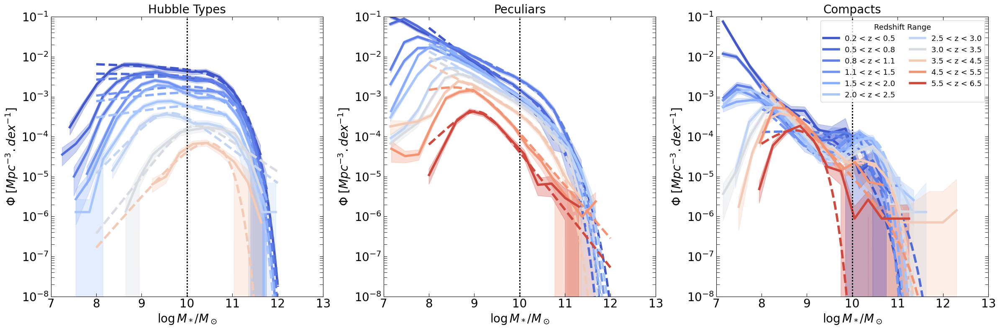

In [324]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad
from matplotlib.colors import Normalize
from matplotlib import cm

# --- Define the Schechter Functions ---

def schechter_function(logM, logphi_star, logM_star, alpha):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**logphi_star
    return np.log(10) * phi_star * (M / M_star)**(alpha+1) * np.exp(-M / M_star)

def double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2):
    M_over_M_star = logM - logM_star
    return np.log(10) * np.exp(-10**M_over_M_star) * 10**M_over_M_star * (10**logphi1 * 10**(M_over_M_star * alpha1) + 10**logphi2 * 10**(M_over_M_star * alpha2))

def DPL(logM, logM_star, alpha1, alpha2, phi_star):
    term1 = 10 ** (-(logM - logM_star) * (alpha1 + 1))
    term2 = 10 ** (-(logM - logM_star) * (alpha2 + 1))
    phi_logM_star = 10**phi_star / (term1 + term2)
    return phi_logM_star

# --- Load Observational Data and Fit Results ---

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)  # Suppress warnings for clean output

# Load the observation dictionary
smf_morph_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444.pkl'
with open(smf_morph_path, 'rb') as file:
    smf_morph = pickle.load(file)

# Load the fit results
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best_nocompphys.pkl'
with open(fit_results_best_path, 'rb') as file:
    fit_results_best = pickle.load(file)

# Define morphological classes and labels
morph_class = ['reg', 'irr','comp']
morph_labels = {
    'comp': 'Compacts',
    'sph': 'Spheroids',
    'irr': 'Peculiars',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'reg': 'Hubble Types',
    'all': 'All'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5]
#zbins = [4.5,5.5]

# Prepare colormap
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)
colormap = cm.coolwarm

# Load LRDs_hollis
#LRDs_hollis = pd.read_csv('/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/COSMOS-Web_LRDs_SMF.dat', sep=' ')
#print(LRDs_hollis.columns)

# Initialize the number_densities dictionary
#number_densities = {morph: [] for morph in morph_class}

# --- Compute Number Densities Based on Best-Fit Models ---

plt.figure(figsize=(24, 8))
   
logM_min = 8  # log10(M/M_sun)
logM_max = 12  # log10(M/M_sun)

log_mass_range=np.linspace(logM_min,logM_max,100)

for idx,morph in enumerate(morph_class):
    cl=morph
    ax = plt.subplot(1, 3, idx + 1)  # 2x2 grid of subplots
    
    for zbin,zup in zip(zbins[:-1],zbins[1:]):
        zlow=zbin
        zmed = (zbin+zup)/2
        key = (zbin, morph)
        color = coolwarm(norm((zbin + zup) / 2))  
        if key in fit_results_best:
            fit_info = fit_results_best[key]
            model = fit_info.get('model', None)
            samples = fit_info.get('samples', None)
            log_prob = fit_info.get('log_prob', None)
            
            if model is None or samples is None or log_prob is None:
                print(f"Missing information for zbin {zbin}, morph {morph}. Skipping.")
                continue
            
            # Compute percentiles
            params_50 = np.percentile(samples, 50, axis=0)
            params_16 = np.percentile(samples, 16, axis=0)
            params_84 = np.percentile(samples, 84, axis=0)
            
            # Depending on the model, unpack parameters accordingly
            
            try:
                if model == 'Single':
                    # Expected parameters: logphi_star, logM_star, alpha
                    logphi_star, logM_star, alpha = params_50
                    model_fit = schechter_function(log_mass_range, logphi_star, logM_star, alpha)
                    # Define the integrand for the Single Schechter Function
                    #integrand = lambda logM: schechter_function(
                    #    logM, logphi_star, logM_star, alpha
                    #)
                    
                elif model == 'Double':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi1, logphi2
                    logM_star, alpha1, alpha2, logphi1, logphi2 = params_50
                    model_fit = double_schechter_function(log_mass_range,logM_star, alpha1, alpha2, logphi1, logphi2)
                    #integrand = lambda logM: double_schechter_function(
                    #    logM, logM_star, alpha1, alpha2, logphi1, logphi2
                    #)
                    
                elif model == 'DPL':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi_star
                    logM_star, alpha1, alpha2, logphi_star = params_50
                    model_fit = DPL(log_mass_range, logM_star, alpha1, alpha2, logphi_star)
                    
                   
                        
                    #integrand = lambda logM: DPL(
                    #    logM, logM_star, alpha1, alpha2, logphi_star
                    #)
                    
                else:
                    print(f"Unknown model '{model}' for zbin {zbin}, morph {morph}. Skipping.")
                    continue
                
             
                print(zbin,model,cl,params_50)
                # Perform numerical integration
                #integral, integral_error = quad(
                #    integrand, logM_min, logM_max, limit=1000
                #)
                
                # Append the result to number_densities
                #if morph=='all':
                #    number_densities[morph].append((zmed, integral))
                #    na=integral
                #if morph=='comp':
                #    nc = na*cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values
                #    number_densities[morph].append((zmed, nc))
                #else:
                #    number_densities[morph].append((zmed, integral))
                
                
                #print(f"Computed number density for zbin {zbin}, morph {morph}, model {model}: {integral:.3e}")
                
            except Exception as e:
                print(f"Error computing number density for zbin {zbin}, morph {morph}: {e}")
                continue
        else:
            print(f"No fit results found for zbin {zbin}, morph {morph}.")
            continue

# --- Save the Number Densities to a Pickle File ---

                # Plot the best-fit model
        #print(model_fit)
        ax.plot(log_mass_range, model_fit, color=color, linestyle='--', lw=4)
                    #print(model_fit)

        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values

                color = coolwarm(norm((zlow + zup) / 2))  # Color represents midpoint of z range
                
                # Plot the SMF with error bars
                ax.plot(LogMassbin_pos, Fi_pos, color=color, label=f'{zlow:.1f} < z < {zup:.1f}', lw=4)
                ax.fill_between(LogMassbin_pos, Fi_pos - dFi_pos, Fi_pos + dFi_pos, color=color, alpha=0.3)

                # Plot the LRDs_hollis data for comparison
            #    ax.plot(
            # LRDs_hollis.logMstar,
            #    10**LRDs_hollis['logphi_z5-7_med'],
            # color=combined_color,
            # #label='LRDs',
            ## lw=4,
             #ls=':' 
            #)
                
        ax.set_title(morph_labels[morph], fontsize=20)
        ax.set_xlabel('$\log M_*/M_\odot$', fontsize=20)
        ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=20)
        ax.set_yscale('log')
        ax.set_ylim(1e-8, 1e-1)
        ax.set_xlim(7, 13)

        # Set ticks on both sides of the y-axis
        ax.yaxis.set_ticks_position('both')
        ax.xaxis.set_ticks_position('both')

        ax.axvline(x=10,ls=':',color='black',lw=2)

        # Ensure tick marks are visible on all sides
        ax.tick_params(axis='both', which='both', labelsize=20, direction='in', length=6)
        if idx==2:
            ax.legend(fontsize=13, title="Redshift Range", title_fontsize='13',ncol=2,loc='upper right')

plt.tight_layout()
plt.savefig(os.path.join(plots_path, 'SMF_peculiar_hubble_schechter.png'))

plt.show()



Index(['logMstar', 'logphi_z5-7_med', 'logphi_z5-7_l68', 'logphi_z5-7_u68',
       'logphi_z5-7_miri_med', 'logphi_z5-7_miri_l68', 'logphi_z5-7_miri_u68',
       'logphi_z7-9_med', 'logphi_z7-9_l68', 'logphi_z7-9_u68',
       'logphi_z7-9_miri_med', 'logphi_z7-9_miri_l68', 'logphi_z7-9_miri_u68'],
      dtype='object')
0.2 Single reg [-2.64044251 10.84955555 -0.69612824]
0.5 Single reg [-2.83555113 10.82875992 -0.53850273]
0.8 Single reg [-2.75614484 10.67222586 -0.20223187]
1.1 Single reg [-3.06151126 10.61233219  0.10788454]
1.5 Single reg [-3.31499703 10.62182515  0.1917437 ]
2 Single reg [-3.76853122 10.55878757  0.52112125]
2.5 DPL reg [10.50878159 -2.20209116  1.00466474 -3.73877879]
3 Single reg [-4.37249234 10.73615587  0.50144539]
3.5 DPL reg [10.31690844 -0.99839877 -1.05971561 -4.81836534]
No fit results found for zbin 4.5, morph reg.
No fit results found for zbin 5.5, morph reg.
0.2 Double irr [10.33836361 -2.61296633 -0.41673248 -5.87520359 -3.83219178]
0.5 Double irr [10.

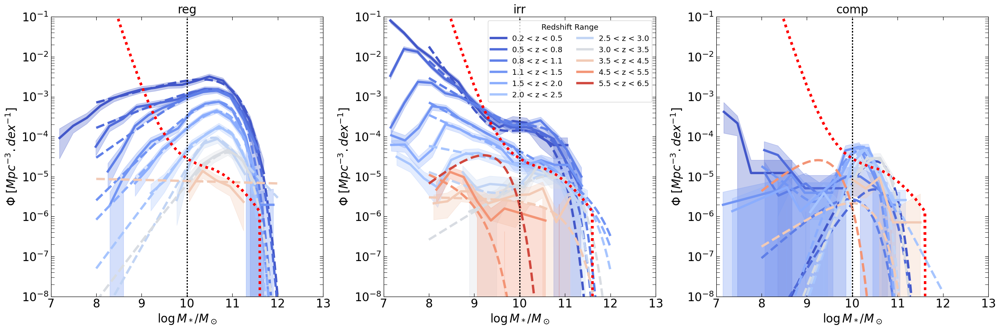

In [658]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad
from matplotlib.colors import Normalize
from matplotlib import cm

# --- Define the Schechter Functions ---

def schechter_function(logM, logphi_star, logM_star, alpha):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**logphi_star
    return np.log(10) * phi_star * (M / M_star)**(alpha+1) * np.exp(-M / M_star)

def double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2):
    M_over_M_star = logM - logM_star
    return np.log(10) * np.exp(-10**M_over_M_star) * 10**M_over_M_star * (10**logphi1 * 10**(M_over_M_star * alpha1) + 10**logphi2 * 10**(M_over_M_star * alpha2))

def DPL(logM, logM_star, alpha1, alpha2, phi_star):
    term1 = 10 ** (-(logM - logM_star) * (alpha1 + 1))
    term2 = 10 ** (-(logM - logM_star) * (alpha2 + 1))
    phi_logM_star = 10**phi_star / (term1 + term2)
    return phi_logM_star

# --- Load Observational Data and Fit Results ---

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)  # Suppress warnings for clean output

# Load the observation dictionary
smf_morph_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompact_0.07F444_Q.pkl'
with open(smf_morph_path, 'rb') as file:
    smf_morph = pickle.load(file)

# Load the fit results
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best_Q.pkl'
with open(fit_results_best_path, 'rb') as file:
    fit_results_best = pickle.load(file)

# Define morphological classes and labels
morph_class = ['reg', 'irr','comp']
morph_labels = {
    'comp': 'Compact',
    'sph': 'Spheroids',
    'irr': 'Peculiars',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'reg': 'Hubble Types',
    'all': 'All'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5]
#zbins = [4.5,5.5]

# Prepare colormap
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)
colormap = cm.coolwarm

# Load LRDs_hollis
LRDs_hollis = pd.read_csv('/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/COSMOS-Web_LRDs_SMF.dat', sep=' ')
print(LRDs_hollis.columns)

# Initialize the number_densities dictionary
#number_densities = {morph: [] for morph in morph_class}

# --- Compute Number Densities Based on Best-Fit Models ---

plt.figure(figsize=(24, 8))
   
logM_min = 8  # log10(M/M_sun)
logM_max = 12  # log10(M/M_sun)

log_mass_range=np.linspace(logM_min,logM_max,100)

for idx,morph in enumerate(morph_class):
    cl=morph
    ax = plt.subplot(1, 3, idx + 1)  # 2x2 grid of subplots
    
    for zbin,zup in zip(zbins[:-1],zbins[1:]):
        zlow=zbin
        zmed = (zbin+zup)/2
        key = (zbin, morph)
        color = coolwarm(norm((zbin + zup) / 2))  
        if key in fit_results_best:
            fit_info = fit_results_best[key]
            model = fit_info.get('model', None)
            samples = fit_info.get('samples', None)
            log_prob = fit_info.get('log_prob', None)
            
            if model is None or samples is None or log_prob is None:
                print(f"Missing information for zbin {zbin}, morph {morph}. Skipping.")
                continue
            
            # Compute percentiles
            params_50 = np.percentile(samples, 50, axis=0)
            params_16 = np.percentile(samples, 16, axis=0)
            params_84 = np.percentile(samples, 84, axis=0)
            
            # Depending on the model, unpack parameters accordingly
            
            try:
                if model == 'Single':
                    # Expected parameters: logphi_star, logM_star, alpha
                    logphi_star, logM_star, alpha = params_50
                    model_fit = schechter_function(log_mass_range, logphi_star, logM_star, alpha)
                    # Define the integrand for the Single Schechter Function
                    #integrand = lambda logM: schechter_function(
                    #    logM, logphi_star, logM_star, alpha
                    #)
                    
                elif model == 'Double':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi1, logphi2
                    logM_star, alpha1, alpha2, logphi1, logphi2 = params_50
                    model_fit = double_schechter_function(log_mass_range,logM_star, alpha1, alpha2, logphi1, logphi2)
                    #integrand = lambda logM: double_schechter_function(
                    #    logM, logM_star, alpha1, alpha2, logphi1, logphi2
                    #)
                    
                elif model == 'DPL':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi_star
                    logM_star, alpha1, alpha2, logphi_star = params_50
                    model_fit = DPL(log_mass_range, logM_star, alpha1, alpha2, logphi_star)
                    
                   
                        
                    #integrand = lambda logM: DPL(
                    #    logM, logM_star, alpha1, alpha2, logphi_star
                    #)
                    
                else:
                    print(f"Unknown model '{model}' for zbin {zbin}, morph {morph}. Skipping.")
                    continue
                
             
                print(zbin,model,cl,params_50)
                # Perform numerical integration
                #integral, integral_error = quad(
                #    integrand, logM_min, logM_max, limit=1000
                #)
                
                # Append the result to number_densities
                #if morph=='all':
                #    number_densities[morph].append((zmed, integral))
                #    na=integral
                #if morph=='comp':
                #    nc = na*cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values
                #    number_densities[morph].append((zmed, nc))
                #else:
                #    number_densities[morph].append((zmed, integral))
                
                
                #print(f"Computed number density for zbin {zbin}, morph {morph}, model {model}: {integral:.3e}")
                
            except Exception as e:
                print(f"Error computing number density for zbin {zbin}, morph {morph}: {e}")
                continue
        else:
            print(f"No fit results found for zbin {zbin}, morph {morph}.")
            continue

# --- Save the Number Densities to a Pickle File ---

                # Plot the best-fit model
        #print(model_fit)
        ax.plot(log_mass_range, model_fit, color=color, linestyle='--', lw=4)
                    #print(model_fit)

        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values

                color = coolwarm(norm((zlow + zup) / 2))  # Color represents midpoint of z range
                
                # Plot the SMF with error bars
                ax.plot(LogMassbin_pos, Fi_pos, color=color, label=f'{zlow:.1f} < z < {zup:.1f}', lw=4)
                ax.fill_between(LogMassbin_pos, Fi_pos - dFi_pos, Fi_pos + dFi_pos, color=color, alpha=0.3)

                # Plot the LRDs_hollis data for comparison
                ax.plot(
             LRDs_hollis.logMstar,
                10**LRDs_hollis['logphi_z5-7_med'],
             color=combined_color,
             #label='LRDs',
             lw=4,
             ls=':' 
            )
                
        ax.set_title(morph, fontsize=20)
        ax.set_xlabel('$\log M_*/M_\odot$', fontsize=20)
        ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=20)
        ax.set_yscale('log')
        ax.set_ylim(1e-8, 1e-1)
        ax.set_xlim(7, 13)

        # Set ticks on both sides of the y-axis
        ax.yaxis.set_ticks_position('both')
        ax.xaxis.set_ticks_position('both')

        ax.axvline(x=10,ls=':',color='black',lw=2)

        # Ensure tick marks are visible on all sides
        ax.tick_params(axis='both', which='both', labelsize=20, direction='in', length=6)
        if idx==1:
            ax.legend(fontsize=13, title="Redshift Range", title_fontsize='13',ncol=2,loc='upper right')

plt.tight_layout()
#plt.savefig(os.path.join(plots_path, 'SMF_peculiar_hubble_schechter.png'))

plt.show()



[5.29629586e-02 4.87967651e-02 4.49579403e-02 4.14207564e-02
 3.81615076e-02 3.51583511e-02 3.23911607e-02 2.98413918e-02
 2.74919573e-02 2.53271128e-02 2.33323513e-02 2.14943059e-02
 1.98006602e-02 1.82400656e-02 1.68020655e-02 1.54770250e-02
 1.42560665e-02 1.31310098e-02 1.20943180e-02 1.11390462e-02
 1.02587954e-02 9.44766948e-03 8.70023581e-03 8.01148863e-03
 7.37681561e-03 6.79196695e-03 6.25302684e-03 5.75638728e-03
 5.29872384e-03 4.87697341e-03 4.48831366e-03 4.13014412e-03
 3.80006878e-03 3.49587997e-03 3.21554365e-03 2.95718571e-03
 2.71907942e-03 2.49963390e-03 2.29738341e-03 2.11097757e-03
 1.93917227e-03 1.78082138e-03 1.63486901e-03 1.50034252e-03
 1.37634591e-03 1.26205389e-03 1.15670631e-03 1.05960309e-03
 9.70099522e-04 8.87601930e-04 8.11563722e-04 7.41481707e-04
 6.76892721e-04 6.17370524e-04 5.62522927e-04 5.11989159e-04
 4.65437433e-04 4.22562699e-04 3.83084580e-04 3.46745459e-04
 3.13308711e-04 2.82557071e-04 2.54291113e-04 2.28327848e-04
 2.04499403e-04 1.826517

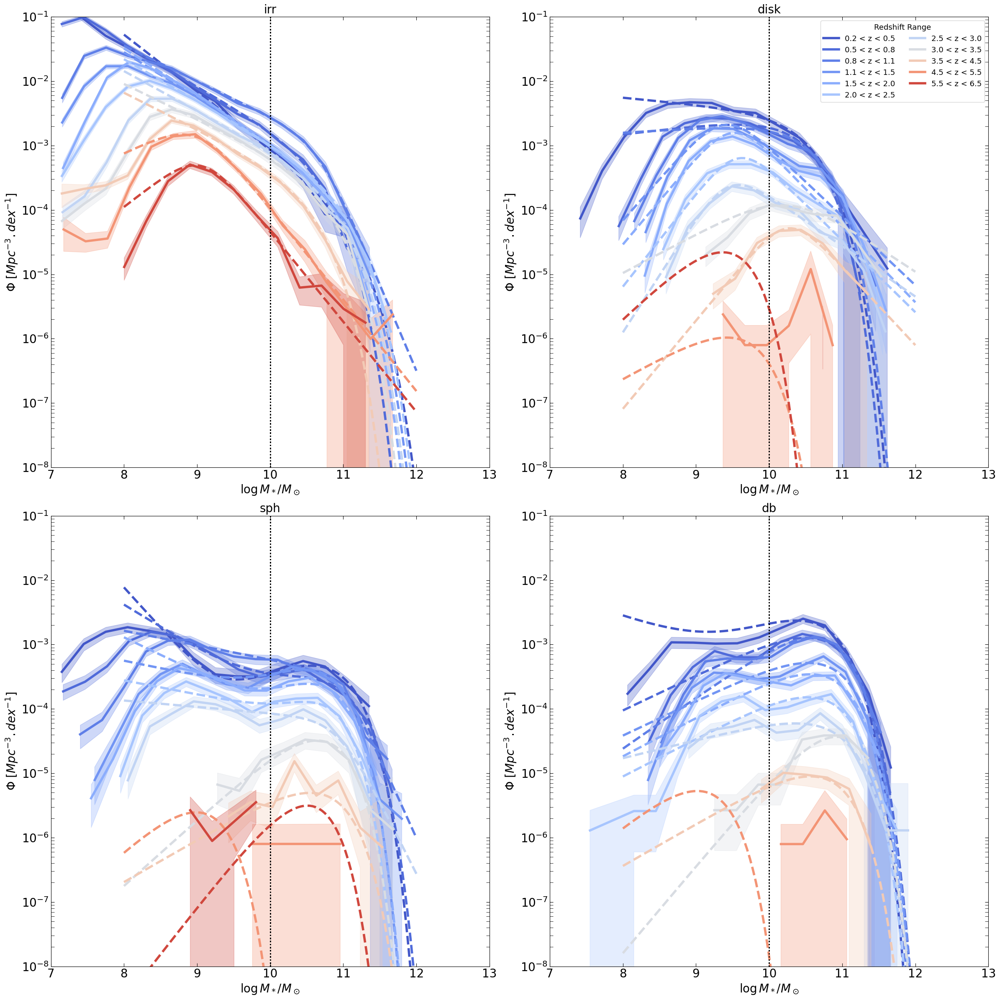

In [648]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad
from matplotlib.colors import Normalize
from matplotlib import cm

# --- Define the Schechter Functions ---

def schechter_function(logM, logphi_star, logM_star, alpha):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**logphi_star
    return np.log(10) * phi_star * (M / M_star)**(alpha+1) * np.exp(-M / M_star)

def double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2):
    M_over_M_star = logM - logM_star
    return np.log(10) * np.exp(-10**M_over_M_star) * 10**M_over_M_star * (10**logphi1 * 10**(M_over_M_star * alpha1) + 10**logphi2 * 10**(M_over_M_star * alpha2))

def DPL(logM, logM_star, alpha1, alpha2, phi_star):
    term1 = 10 ** (-(logM - logM_star) * (alpha1 + 1))
    term2 = 10 ** (-(logM - logM_star) * (alpha2 + 1))
    phi_logM_star = 10**phi_star / (term1 + term2)
    return phi_logM_star

# --- Load Observational Data and Fit Results ---

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)  # Suppress warnings for clean output

# Load the observation dictionary
smf_morph_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompact_0.07F444.pkl'
with open(smf_morph_path, 'rb') as file:
    smf_morph = pickle.load(file)

# Load the fit results
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best.pkl'
with open(fit_results_best_path, 'rb') as file:
    fit_results_best = pickle.load(file)

# Define morphological classes and labels
morph_class = ['irr', 'disk','sph','db']
morph_labels = {
    'comp': 'Compact',
    'sph': 'Spheroids',
    'irr': 'Peculiars',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'reg': 'Hubble Types',
    'all': 'All'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5]
#zbins = [4.5,5.5]

# Prepare colormap
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)
colormap = cm.coolwarm

# Initialize the number_densities dictionary
#number_densities = {morph: [] for morph in morph_class}

# --- Compute Number Densities Based on Best-Fit Models ---

plt.figure(figsize=(24, 24))
   
logM_min = 8  # log10(M/M_sun)
logM_max = 12  # log10(M/M_sun)

log_mass_range=np.linspace(logM_min,logM_max,100)

for idx,morph in enumerate(morph_class):
    cl=morph
    ax = plt.subplot(2, 2, idx + 1)  # 2x2 grid of subplots
    
    for zbin,zup in zip(zbins[:-1],zbins[1:]):
        zlow=zbin
        zmed = (zbin+zup)/2
        key = (zbin, morph)
        color = coolwarm(norm((zbin + zup) / 2))  
        if key in fit_results_best:
            fit_info = fit_results_best[key]
            model = fit_info.get('model', None)
            samples = fit_info.get('samples', None)
            log_prob = fit_info.get('log_prob', None)
            
            if model is None or samples is None or log_prob is None:
                print(f"Missing information for zbin {zbin}, morph {morph}. Skipping.")
                continue
            
            # Compute percentiles
            params_50 = np.percentile(samples, 50, axis=0)
            params_16 = np.percentile(samples, 16, axis=0)
            params_84 = np.percentile(samples, 84, axis=0)
            
            # Depending on the model, unpack parameters accordingly
            try:
                if model == 'Single':
                    # Expected parameters: logphi_star, logM_star, alpha
                    logphi_star, logM_star, alpha = params_50
                    model_fit = schechter_function(log_mass_range, logphi_star, logM_star, alpha)
                    # Define the integrand for the Single Schechter Function
                    #integrand = lambda logM: schechter_function(
                    #    logM, logphi_star, logM_star, alpha
                    #)
                    
                elif model == 'Double':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi1, logphi2
                    logM_star, alpha1, alpha2, logphi1, logphi2 = params_50
                    model_fit = double_schechter_function(log_mass_range,logM_star, alpha1, alpha2, logphi1, logphi2)
                    #integrand = lambda logM: double_schechter_function(
                    #    logM, logM_star, alpha1, alpha2, logphi1, logphi2
                    #)
                    
                elif model == 'DPL':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi_star
                    logM_star, alpha1, alpha2, logphi_star = params_50
                    model_fit = DPL(log_mass_range, logM_star, alpha1, alpha2, logphi_star)
                    
                   
                        
                    #integrand = lambda logM: DPL(
                    #    logM, logM_star, alpha1, alpha2, logphi_star
                    #)
                    
                else:
                    print(f"Unknown model '{model}' for zbin {zbin}, morph {morph}. Skipping.")
                    continue
                
             
                
                # Perform numerical integration
                #integral, integral_error = quad(
                #    integrand, logM_min, logM_max, limit=1000
                #)
                
                # Append the result to number_densities
                #if morph=='all':
                #    number_densities[morph].append((zmed, integral))
                #    na=integral
                #if morph=='comp':
                #    nc = na*cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values
                #    number_densities[morph].append((zmed, nc))
                #else:
                #    number_densities[morph].append((zmed, integral))
                
                
                #print(f"Computed number density for zbin {zbin}, morph {morph}, model {model}: {integral:.3e}")
                
            except Exception as e:
                print(f"Error computing number density for zbin {zbin}, morph {morph}: {e}")
                continue
        else:
            print(f"No fit results found for zbin {zbin}, morph {morph}.")
            continue

# --- Save the Number Densities to a Pickle File ---

                # Plot the best-fit model
        print(model_fit)
        ax.plot(log_mass_range, model_fit, color=color, linestyle='--', lw=4)
                    #print(model_fit)

        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values

                color = coolwarm(norm((zlow + zup) / 2))  # Color represents midpoint of z range
                
                # Plot the SMF with error bars
                ax.plot(LogMassbin_pos, Fi_pos, color=color, label=f'{zlow:.1f} < z < {zup:.1f}', lw=4)
                ax.fill_between(LogMassbin_pos, Fi_pos - dFi_pos, Fi_pos + dFi_pos, color=color, alpha=0.3)
                
        ax.set_title(morph, fontsize=20)
        ax.set_xlabel('$\log M_*/M_\odot$', fontsize=20)
        ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=20)
        ax.set_yscale('log')
        ax.set_ylim(1e-8, 1e-1)
        ax.set_xlim(7, 13)

        # Set ticks on both sides of the y-axis
        ax.yaxis.set_ticks_position('both')
        ax.xaxis.set_ticks_position('both')

        ax.axvline(x=10,ls=':',color='black',lw=2)

        # Ensure tick marks are visible on all sides
        ax.tick_params(axis='both', which='both', labelsize=20, direction='in', length=6)
        if idx==1:
            ax.legend(fontsize=13, title="Redshift Range", title_fontsize='13',ncol=2,loc='upper right')

plt.tight_layout()
#plt.savefig(os.path.join(plots_path, 'SMF_peculiar_hubble_schechter.png'))

plt.show()



[7.38191313e-05 3.81398845e-04 1.32874436e-03 3.21113221e-03
 4.41684469e-03 4.71212121e-03 4.58908933e-03 3.45719598e-03
 3.21113221e-03 2.06693568e-03 1.31644117e-03 5.16733919e-04
 1.35335074e-04 1.23031885e-05] [ 7.41645  7.71645  8.01645  8.31645  8.61645  8.91645  9.21645  9.51645
  9.81645 10.11645 10.41645 10.71645 11.01645 11.61645]
[5.61447963e-05 3.01140271e-04 1.37809955e-03 2.22027149e-03
 2.68984615e-03 2.61838914e-03 2.19475113e-03 1.58226244e-03
 1.15862443e-03 6.07384615e-04 1.63330317e-04 5.10407239e-06] [ 7.94325  8.24325  8.54325  8.84325  9.14325  9.44325  9.74325 10.04325
 10.34325 10.64325 10.94325 11.24325]
[6.71165601e-05 3.42294456e-04 1.31212875e-03 2.49338021e-03
 2.85916546e-03 2.26182807e-03 1.58059499e-03 1.06044165e-03
 8.28889517e-04 3.28871144e-04 4.36257641e-05 6.71165601e-06] [ 8.1556  8.4556  8.7556  9.0556  9.3556  9.6556  9.9556 10.2556 10.5556
 10.8556 11.1556 11.4556]
[4.52510891e-05 3.32497133e-04 1.20013758e-03 1.85922953e-03
 1.81791332e-03 1

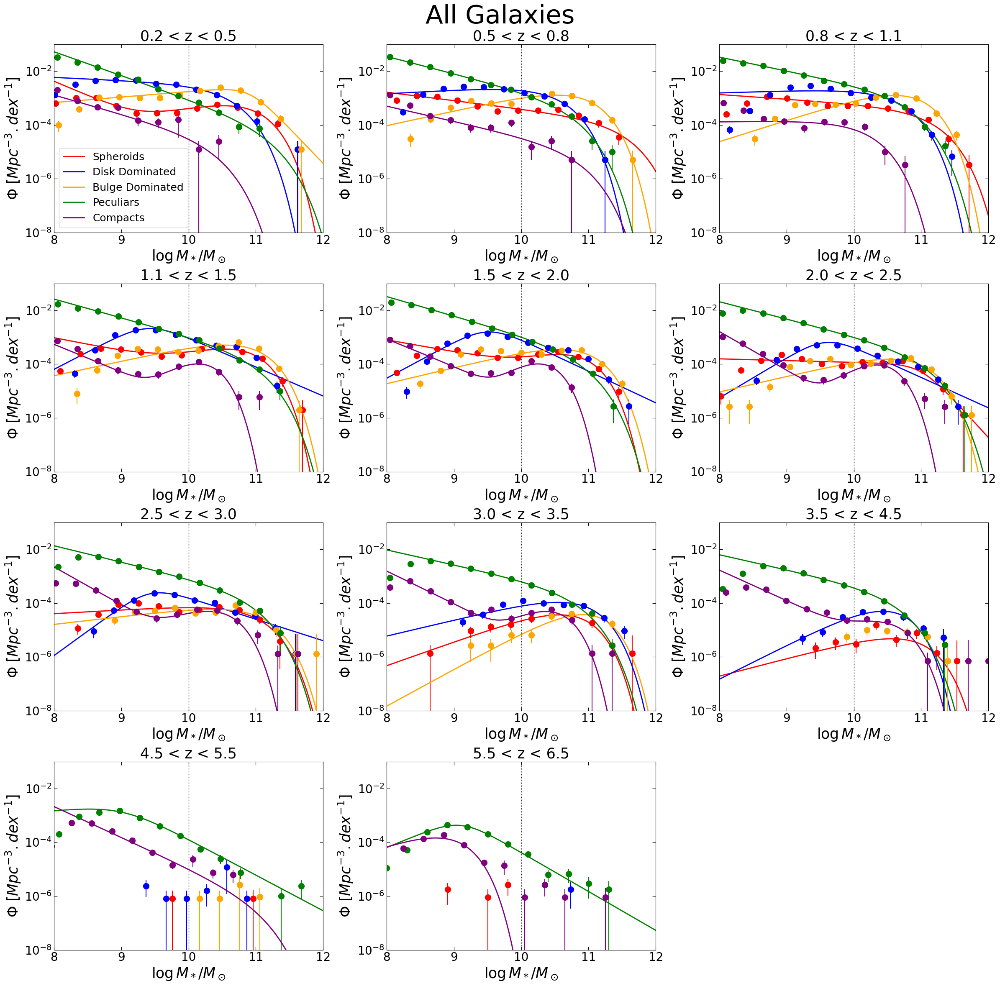

In [315]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib import cm
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)  # Suppress warnings for clean output

# --- Define the Schechter Functions ---

def schechter_function(logM, logphi_star, logM_star, alpha):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**logphi_star
    return np.log(10) * phi_star * (M / M_star)**(alpha+1) * np.exp(-M / M_star)

def double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2):
    M_over_M_star = logM - logM_star
    return np.log(10) * np.exp(-10**M_over_M_star) * 10**M_over_M_star * (
        10**logphi1 * 10**(M_over_M_star * alpha1) +
        10**logphi2 * 10**(M_over_M_star * alpha2)
    )


def DPL(logM, logM_star, alpha1, alpha2, logphi_star):
    term1 = 10 ** (-(logM - logM_star) * (alpha1 + 1))
    term2 = 10 ** (-(logM - logM_star) * (alpha2 + 1))
    phi_logM_star = 10**logphi_star / (term1 + term2)
    return phi_logM_star

# --- Load Observational Data and Fit Results ---

# Load the observation dictionary
smf_morph_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444.pkl'
with open(smf_morph_path, 'rb') as file:
    smf_morph = pickle.load(file)

# Load the fit results
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best_nocompphys.pkl'
with open(fit_results_best_path, 'rb') as file:
    fit_results_best = pickle.load(file)

# Define morphological classes and labels
morph_class = ['sph', 'disk', 'db', 'irr','comp']
#morph_class = ['comp']
morph_labels = {
    'sph': 'Spheroids',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'irr': 'Peculiars',
    'comp': 'Compacts'
}

# Define colors for morphologies
morph_colors = {
    'sph': 'red',
    'disk': 'blue',
    'db': 'orange',
    'irr': 'green',
    'comp': 'purple'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5, 6.5]

# Initialize figure
plt.figure(figsize=(24, 24))

logM_min = 8  # log10(M/M_sun)
logM_max = 12  # log10(M/M_sun)
log_mass_range = np.linspace(logM_min, logM_max, 100)

# Determine subplot grid size
n_zbins = len(zbins) - 1
ncols = 3  # Adjust the number of columns as needed
nrows = (n_zbins + ncols - 1) // ncols  # Compute the number of rows

# Loop over redshift bins
for idx, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
    zmed = (zlow + zup) / 2
    ax = plt.subplot(nrows, ncols, idx + 1)
    
    # Loop over morphologies
    for morph in morph_class:
        cl = morph
        color = morph_colors.get(morph, 'black')
        key = (zlow, morph)
        # Plot the data with error bars and solid circles
        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                        
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values
                if morph=='disk':
                    print(Fi_pos,LogMassbin_pos)
                        
                # Plot the data with error bars and solid circles
                ax.errorbar(LogMassbin_pos, Fi_pos, yerr=dFi_pos, fmt='o', color=color, label=None,markersize=10)
        else:
            print(f"No data found for zbin {zlow}, morph {morph}.")
            continue
        
        if key in fit_results_best:
            fit_info = fit_results_best[key]
            model = fit_info.get('model', None)
            samples = fit_info.get('samples', None)
            log_prob = fit_info.get('log_prob', None)
            
            if model is None or samples is None or log_prob is None:
                print(f"Missing information for zbin {zlow}, morph {morph}. Skipping.")
                continue
            
            # Compute percentiles
            params_50 = np.percentile(samples, 50, axis=0)
            
            # Depending on the model, unpack parameters accordingly
            try:
                if model == 'Single':
                    # Expected parameters: logphi_star, logM_star, alpha
                    logphi_star, logM_star, alpha = params_50
                    model_fit = schechter_function(log_mass_range, logphi_star, logM_star, alpha)
                elif model == 'Double':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi1, logphi2
                    logM_star, alpha1, alpha2, logphi1, logphi2 = params_50
                    model_fit = double_schechter_function(log_mass_range, logM_star, alpha1, alpha2, logphi1, logphi2)
                elif model == 'DPL':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi_star
                    logM_star, alpha1, alpha2, logphi_star = params_50
                    model_fit = DPL(log_mass_range, logM_star, alpha1, alpha2, logphi_star)
                else:
                    print(f"Unknown model '{model}' for zbin {zlow}, morph {morph}. Skipping.")
                    continue
                
                # Plot the best-fit model with a solid line
                #if morph != 'comp':
                ax.plot(log_mass_range, model_fit, color=color, linestyle='-', lw=2, label=morph_labels.get(morph, morph))
                
                
                
                
            except Exception as e:
                print(f"Error computing or plotting for zbin {zlow}, morph {morph}: {e}")
                continue
        else:
            print(f"No fit results found for zbin {zlow}, morph {morph}.")
            continue
    
    # Set plot properties
    ax.set_title(f'{zlow:.1f} < z < {zup:.1f}', fontsize=25)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=25)
    ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=25)
    ax.set_yscale('log')
    ax.set_ylim(1e-8, 1e-1)
    ax.set_xlim(logM_min, logM_max)
    
    # Set ticks on both sides of the axes
    ax.yaxis.set_ticks_position('both')
    ax.xaxis.set_ticks_position('both')
    ax.tick_params(axis='both', which='both', labelsize=20, direction='in', length=6)
    ax.axvline(x=10, ls=':', color='black', lw=1)
    
    # Add legend only to the first subplot
    if idx == 0:
        handles, labels = ax.get_legend_handles_labels()
        # Remove duplicate labels
        unique = dict(zip(labels, handles))
        ax.legend(unique.values(), unique.keys(), fontsize=18)
    else:
        ax.legend().remove()

plt.tight_layout()
plt.subplots_adjust(top=0.94)
plt.suptitle('All Galaxies', fontsize=44)
plt.savefig(os.path.join(plots_path,'SMF_fits_All.jpg'))
plt.show()



[8.61223198e-05 7.38191313e-05 4.06005222e-04 5.16733919e-04
 7.75100878e-04 9.84255084e-04 1.00886146e-03 7.62797690e-04
 5.65946673e-04 6.52068993e-04 3.44489279e-04 8.61223198e-05
 1.23031885e-05] [ 7.7598  8.0598  8.3598  8.6598  8.9598  9.2598  9.5598  9.8598 10.1598
 10.4598 10.7598 11.0598 11.3598]
[3.06244344e-05 1.02081448e-04 2.34787330e-04 2.75619909e-04
 3.47076923e-04 3.01140271e-04 2.14371040e-04 1.88850679e-04
 7.14570135e-05 1.02081448e-05 5.10407239e-06] [ 8.48221  8.78221  9.08221  9.38221  9.68221  9.98221 10.28221 10.58221
 10.88221 11.18221 11.48221]
[3.35582800e-06 7.04723881e-05 1.44300604e-04 1.84570540e-04
 2.01349680e-04 1.64435572e-04 1.27521464e-04 9.39631841e-05
 3.69141080e-05 1.00674840e-05] [ 8.70005  9.00005  9.30005  9.60005  9.90005 10.20005 10.50005 10.80005
 11.10005 11.40005]
[7.86975462e-06 3.73813344e-05 3.54138958e-05 2.55767025e-05
 2.75441412e-05 4.13162117e-05 4.32836504e-05 3.54138958e-05
 5.90231596e-06] [ 8.8769  9.1769  9.4769  9.7769 10.

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


No fit results found for zbin 3, morph comp.
No fit results found for zbin 3.5, morph sph.
[2.14146336e-06 7.05160959e-06 2.14146336e-06 7.13821121e-07
 1.62490902e-06] [10.15 10.45 10.75 11.05 11.35]
No fit results found for zbin 3.5, morph db.
No fit results found for zbin 4.5, morph sph.
[] []
No fit results found for zbin 4.5, morph disk.
No fit results found for zbin 4.5, morph db.
No fit results found for zbin 4.5, morph comp.
No fit results found for zbin 5.5, morph sph.
[] []
No fit results found for zbin 5.5, morph disk.
No fit results found for zbin 5.5, morph db.
No fit results found for zbin 5.5, morph irr.
No fit results found for zbin 5.5, morph comp.


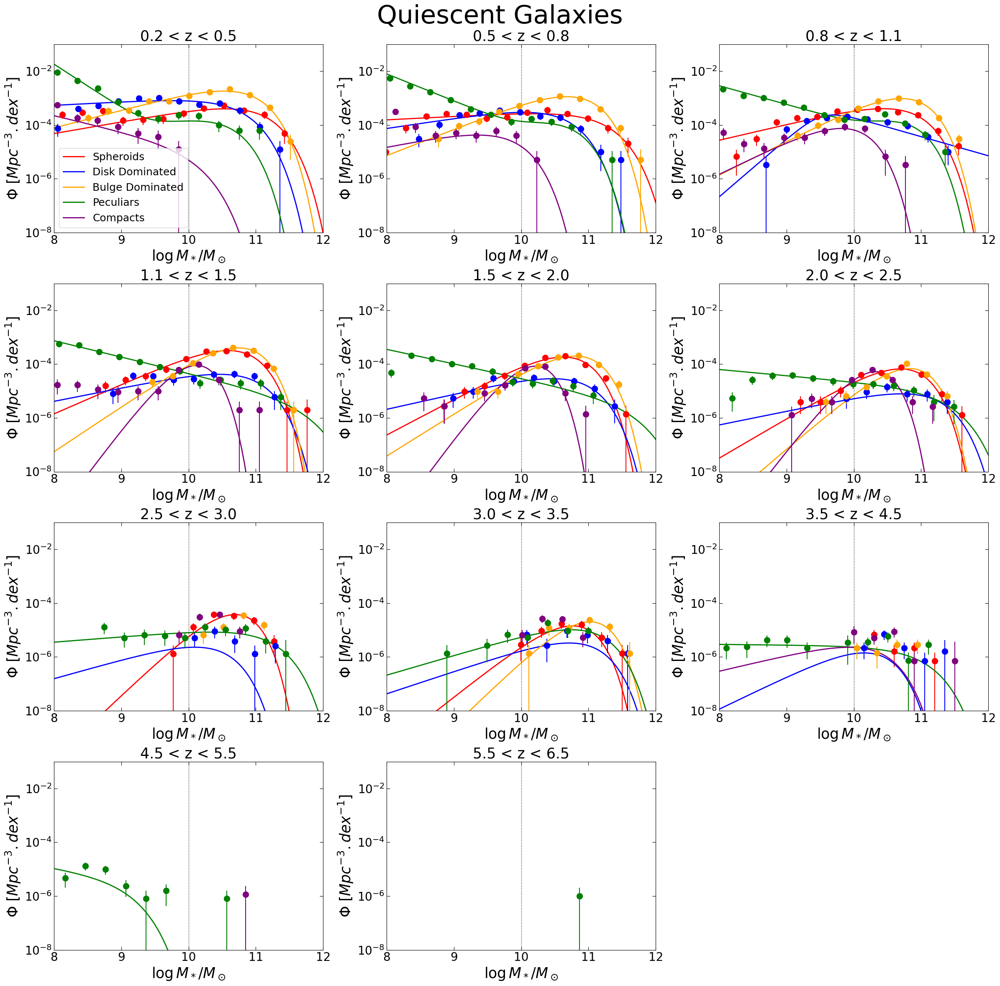

In [312]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib import cm
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)  # Suppress warnings for clean output

# --- Define the Schechter Functions ---

def schechter_function(logM, logphi_star, logM_star, alpha):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**logphi_star
    return np.log(10) * phi_star * (M / M_star)**(alpha+1) * np.exp(-M / M_star)

def double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2):
    M_over_M_star = logM - logM_star
    return np.log(10) * np.exp(-10**M_over_M_star) * 10**M_over_M_star * (
        10**logphi1 * 10**(M_over_M_star * alpha1) +
        10**logphi2 * 10**(M_over_M_star * alpha2)
    )


def DPL(logM, logM_star, alpha1, alpha2, logphi_star):
    term1 = 10 ** (-(logM - logM_star) * (alpha1 + 1))
    term2 = 10 ** (-(logM - logM_star) * (alpha2 + 1))
    phi_logM_star = 10**logphi_star / (term1 + term2)
    return phi_logM_star

# --- Load Observational Data and Fit Results ---

# Load the observation dictionary
smf_morph_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444_Q.pkl'
with open(smf_morph_path, 'rb') as file:
    smf_morph = pickle.load(file)

# Load the fit results
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best_nocompphys_Q.pkl'
with open(fit_results_best_path, 'rb') as file:
    fit_results_best = pickle.load(file)

# Define morphological classes and labels
morph_class = ['sph', 'disk', 'db', 'irr','comp']
#morph_class = ['comp']
morph_labels = {
    'sph': 'Spheroids',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'irr': 'Peculiars',
    'comp': 'Compacts'
}

# Define colors for morphologies
morph_colors = {
    'sph': 'red',
    'disk': 'blue',
    'db': 'orange',
    'irr': 'green',
    'comp': 'purple'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5, 6.5]

# Initialize figure
plt.figure(figsize=(24, 24))

logM_min = 8  # log10(M/M_sun)
logM_max = 12  # log10(M/M_sun)
log_mass_range = np.linspace(logM_min, logM_max, 100)

# Determine subplot grid size
n_zbins = len(zbins) - 1
ncols = 3  # Adjust the number of columns as needed
nrows = (n_zbins + ncols - 1) // ncols  # Compute the number of rows

# Loop over redshift bins
for idx, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
    zmed = (zlow + zup) / 2
    ax = plt.subplot(nrows, ncols, idx + 1)
    
    # Loop over morphologies
    for morph in morph_class:
        cl = morph
        color = morph_colors.get(morph, 'black')
        key = (zlow, morph)
        # Plot the data with error bars and solid circles
        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                        
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values
                if morph=='disk':
                    print(Fi_pos,LogMassbin_pos)
                        
                # Plot the data with error bars and solid circles
                ax.errorbar(LogMassbin_pos, Fi_pos, yerr=dFi_pos, fmt='o', color=color, label=None,markersize=10)
        else:
            print(f"No data found for zbin {zlow}, morph {morph}.")
            continue
        
        if key in fit_results_best:
            fit_info = fit_results_best[key]
            model = fit_info.get('model', None)
            samples = fit_info.get('samples', None)
            log_prob = fit_info.get('log_prob', None)
            
            if model is None or samples is None or log_prob is None:
                print(f"Missing information for zbin {zlow}, morph {morph}. Skipping.")
                continue
            
            # Compute percentiles
            params_50 = np.percentile(samples, 50, axis=0)
            
            # Depending on the model, unpack parameters accordingly
            try:
                if model == 'Single':
                    # Expected parameters: logphi_star, logM_star, alpha
                    logphi_star, logM_star, alpha = params_50
                    model_fit = schechter_function(log_mass_range, logphi_star, logM_star, alpha)
                elif model == 'Double':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi1, logphi2
                    logM_star, alpha1, alpha2, logphi1, logphi2 = params_50
                    model_fit = double_schechter_function(log_mass_range, logM_star, alpha1, alpha2, logphi1, logphi2)
                elif model == 'DPL':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi_star
                    logM_star, alpha1, alpha2, logphi_star = params_50
                    model_fit = DPL(log_mass_range, logM_star, alpha1, alpha2, logphi_star)
                else:
                    print(f"Unknown model '{model}' for zbin {zlow}, morph {morph}. Skipping.")
                    continue
                
                # Plot the best-fit model with a solid line
                #if morph != 'comp':
                ax.plot(log_mass_range, model_fit, color=color, linestyle='-', lw=2, label=morph_labels.get(morph, morph))
                
                
                
                
            except Exception as e:
                print(f"Error computing or plotting for zbin {zlow}, morph {morph}: {e}")
                continue
        else:
            print(f"No fit results found for zbin {zlow}, morph {morph}.")
            continue
    
    # Set plot properties
    ax.set_title(f'{zlow:.1f} < z < {zup:.1f}', fontsize=25)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=25)
    ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=25)
    ax.set_yscale('log')
    ax.set_ylim(1e-8, 1e-1)
    ax.set_xlim(logM_min, logM_max)
    
    # Set ticks on both sides of the axes
    ax.yaxis.set_ticks_position('both')
    ax.xaxis.set_ticks_position('both')
    ax.tick_params(axis='both', which='both', labelsize=20, direction='in', length=6)
    ax.axvline(x=10, ls=':', color='black', lw=1)
    
    # Add legend only to the first subplot
    if idx == 0:
        handles, labels = ax.get_legend_handles_labels()
        # Remove duplicate labels
        unique = dict(zip(labels, handles))
        ax.legend(unique.values(), unique.keys(), fontsize=18)
    else:
        ax.legend().remove()
plt.tight_layout()
plt.subplots_adjust(top=0.94)
plt.suptitle('Quiescent Galaxies', fontsize=44)
plt.savefig(os.path.join(plots_path,'SMF_fits_Q.jpg'))
plt.show()



[7.38191313e-05 3.19882902e-04 1.23031885e-03 2.86664293e-03
 3.90011077e-03 3.99853628e-03 3.54331830e-03 2.66979191e-03
 2.26378669e-03 1.46407944e-03 6.52068993e-04 1.59941451e-04
 1.23031885e-05] [ 7.41645  7.71645  8.01645  8.31645  8.61645  8.91645  9.21645  9.51645
  9.81645 10.11645 10.41645 10.71645 11.01645]
[5.61447963e-05 2.90932126e-04 1.34747511e-03 2.08246154e-03
 2.44995475e-03 2.33766516e-03 1.85277828e-03 1.30153846e-03
 9.39149320e-04 4.44054298e-04 9.18733031e-05] [ 7.94325  8.24325  8.54325  8.84325  9.14325  9.44325  9.74325 10.04325
 10.34325 10.64325 10.94325]
[6.71165601e-05 3.38938628e-04 1.30877292e-03 2.39270537e-03
 2.72493234e-03 2.08061336e-03 1.35911034e-03 9.19496873e-04
 6.77877257e-04 2.65110412e-04 1.34233120e-05] [ 8.1556  8.4556  8.7556  9.0556  9.3556  9.6556  9.9556 10.2556 10.5556
 10.8556 11.1556]
[4.52510891e-05 3.28562255e-04 1.19226782e-03 1.82578307e-03
 1.77856454e-03 1.22964916e-03 7.67301075e-04 4.36771381e-04
 3.87585415e-04 1.41655583e

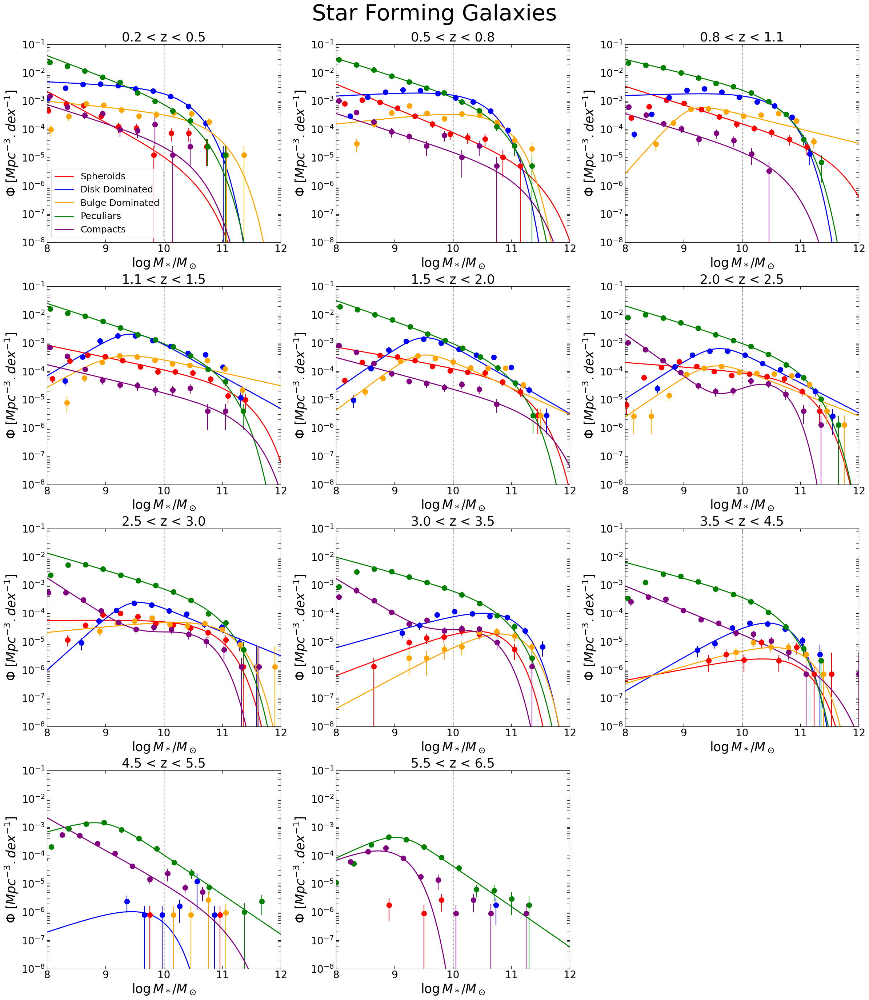

In [313]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib import cm
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)  # Suppress warnings for clean output

# --- Define the Schechter Functions ---

def schechter_function(logM, logphi_star, logM_star, alpha):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**logphi_star
    return np.log(10) * phi_star * (M / M_star)**(alpha+1) * np.exp(-M / M_star)

def double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2):
    M_over_M_star = logM - logM_star
    return np.log(10) * np.exp(-10**M_over_M_star) * 10**M_over_M_star * (
        10**logphi1 * 10**(M_over_M_star * alpha1) +
        10**logphi2 * 10**(M_over_M_star * alpha2)
    )


def DPL(logM, logM_star, alpha1, alpha2, logphi_star):
    term1 = 10 ** (-(logM - logM_star) * (alpha1 + 1))
    term2 = 10 ** (-(logM - logM_star) * (alpha2 + 1))
    phi_logM_star = 10**logphi_star / (term1 + term2)
    return phi_logM_star

# --- Load Observational Data and Fit Results ---

# Load the observation dictionary
smf_morph_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444_SF.pkl'
with open(smf_morph_path, 'rb') as file:
    smf_morph = pickle.load(file)

# Load the fit results
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best_nocompphys_SF.pkl'
with open(fit_results_best_path, 'rb') as file:
    fit_results_best = pickle.load(file)

# Define morphological classes and labels
morph_class = ['sph', 'disk', 'db', 'irr','comp']
#morph_class = ['comp']
morph_labels = {
    'sph': 'Spheroids',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'irr': 'Peculiars',
    'comp': 'Compacts'
}

# Define colors for morphologies
morph_colors = {
    'sph': 'red',
    'disk': 'blue',
    'db': 'orange',
    'irr': 'green',
    'comp': 'purple'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5, 6.5]

# Initialize figure
plt.figure(figsize=(24, 28))

logM_min = 8  # log10(M/M_sun)
logM_max = 12  # log10(M/M_sun)
log_mass_range = np.linspace(logM_min, logM_max, 100)

# Determine subplot grid size
n_zbins = len(zbins) - 1
ncols = 3  # Adjust the number of columns as needed
nrows = (n_zbins + ncols - 1) // ncols  # Compute the number of rows

# Loop over redshift bins
for idx, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
    zmed = (zlow + zup) / 2
    ax = plt.subplot(nrows, ncols, idx + 1)
    
    # Loop over morphologies
    for morph in morph_class:
        cl = morph
        color = morph_colors.get(morph, 'black')
        key = (zlow, morph)
        # Plot the data with error bars and solid circles
        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                        
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values
                if morph=='disk':
                    print(Fi_pos,LogMassbin_pos)
                        
                # Plot the data with error bars and solid circles
                ax.errorbar(LogMassbin_pos, Fi_pos, yerr=dFi_pos, fmt='o', color=color, label=None,markersize=10)
        else:
            print(f"No data found for zbin {zlow}, morph {morph}.")
            continue
        
        if key in fit_results_best:
            fit_info = fit_results_best[key]
            model = fit_info.get('model', None)
            samples = fit_info.get('samples', None)
            log_prob = fit_info.get('log_prob', None)
            
            if model is None or samples is None or log_prob is None:
                print(f"Missing information for zbin {zlow}, morph {morph}. Skipping.")
                continue
            
            # Compute percentiles
            params_50 = np.percentile(samples, 50, axis=0)
            
            # Depending on the model, unpack parameters accordingly
            try:
                if model == 'Single':
                    # Expected parameters: logphi_star, logM_star, alpha
                    logphi_star, logM_star, alpha = params_50
                    model_fit = schechter_function(log_mass_range, logphi_star, logM_star, alpha)
                elif model == 'Double':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi1, logphi2
                    logM_star, alpha1, alpha2, logphi1, logphi2 = params_50
                    model_fit = double_schechter_function(log_mass_range, logM_star, alpha1, alpha2, logphi1, logphi2)
                elif model == 'DPL':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi_star
                    logM_star, alpha1, alpha2, logphi_star = params_50
                    model_fit = DPL(log_mass_range, logM_star, alpha1, alpha2, logphi_star)
                else:
                    print(f"Unknown model '{model}' for zbin {zlow}, morph {morph}. Skipping.")
                    continue
                
                # Plot the best-fit model with a solid line
                #if morph != 'comp':
                ax.plot(log_mass_range, model_fit, color=color, linestyle='-', lw=2, label=morph_labels.get(morph, morph))
                
                
                
                
            except Exception as e:
                print(f"Error computing or plotting for zbin {zlow}, morph {morph}: {e}")
                continue
        else:
            print(f"No fit results found for zbin {zlow}, morph {morph}.")
            continue
    
    # Set plot properties
    ax.set_title(f'{zlow:.1f} < z < {zup:.1f}', fontsize=25)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=25)
    ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=25)
    ax.set_yscale('log')
    ax.set_ylim(1e-8, 1e-1)
    ax.set_xlim(logM_min, logM_max)
    
    # Set ticks on both sides of the axes
    ax.yaxis.set_ticks_position('both')
    ax.xaxis.set_ticks_position('both')
    ax.tick_params(axis='both', which='both', labelsize=20, direction='in', length=6)
    ax.axvline(x=10, ls=':', color='black', lw=1)
    
    # Add legend only to the first subplot
    if idx == 0:
        handles, labels = ax.get_legend_handles_labels()
        # Remove duplicate labels
        unique = dict(zip(labels, handles))
        ax.legend(unique.values(), unique.keys(), fontsize=18)
    else:
        ax.legend().remove()
plt.tight_layout()
plt.subplots_adjust(top=0.94)
plt.suptitle('Star Forming Galaxies', fontsize=44)
plt.savefig(os.path.join(plots_path,'SMF_fits_SF.jpg'))

#
plt.show()



No fit results found for zbin 4.5, morph sph.
No fit results found for zbin 4.5, morph disk.
No fit results found for zbin 4.5, morph db.
No fit results found for zbin 5.5, morph sph.
No fit results found for zbin 5.5, morph disk.
No fit results found for zbin 5.5, morph db.
No fit results found for zbin 5.5, morph comp.


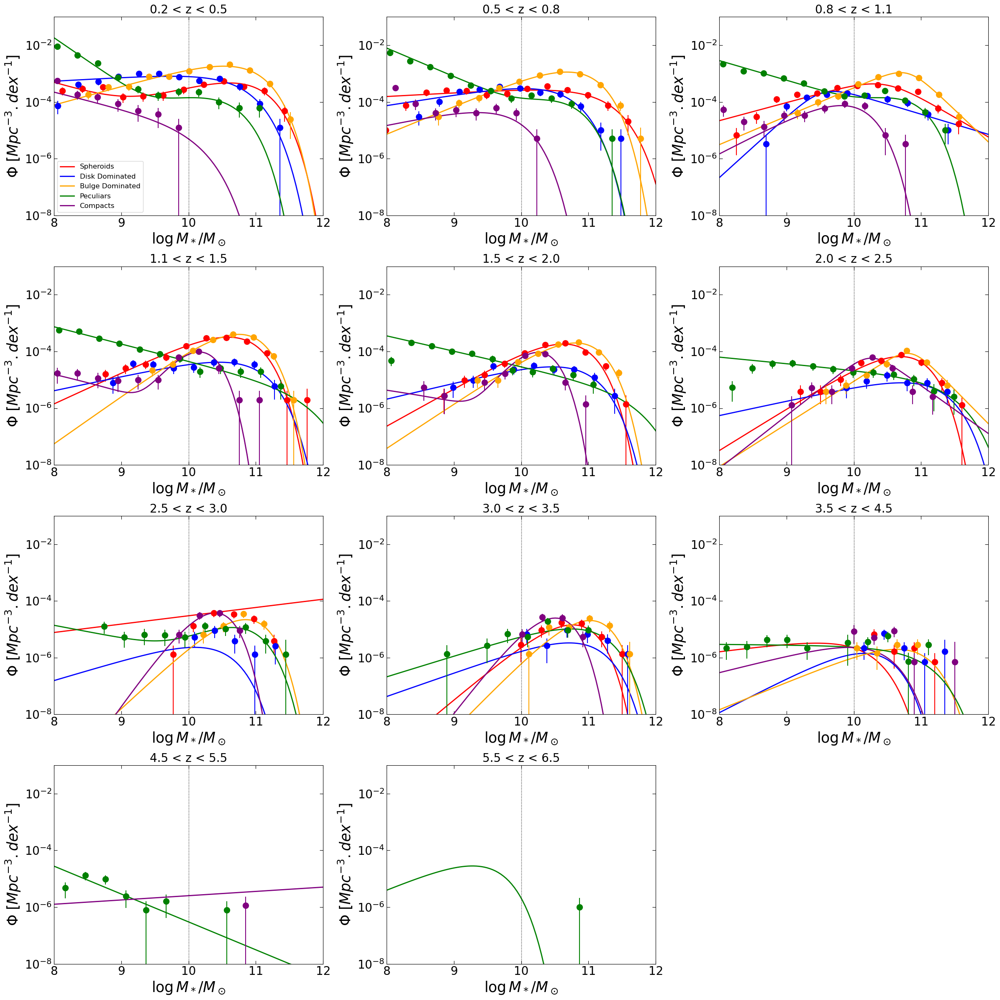

In [204]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib import cm
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)  # Suppress warnings for clean output

# --- Define the Schechter Functions ---

def schechter_function(logM, logphi_star, logM_star, alpha):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**logphi_star
    return np.log(10) * phi_star * (M / M_star)**(alpha+1) * np.exp(-M / M_star)

def double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2):
    M_over_M_star = logM - logM_star
    return np.log(10) * np.exp(-10**M_over_M_star) * 10**M_over_M_star * (
        10**logphi1 * 10**(M_over_M_star * alpha1) +
        10**logphi2 * 10**(M_over_M_star * alpha2)
    )

def DPL(logM, logM_star, alpha1, alpha2, logphi_star):
    term1 = 10 ** (-(logM - logM_star) * (alpha1 + 1))
    term2 = 10 ** (-(logM - logM_star) * (alpha2 + 1))
    phi_logM_star = 10**logphi_star / (term1 + term2)
    return phi_logM_star

# --- Load Observational Data and Fit Results ---

# Load the observation dictionary
smf_morph_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444_Q.pkl'
with open(smf_morph_path, 'rb') as file:
    smf_morph = pickle.load(file)

# Load the fit results
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best_nocompphys_Q.pkl'
with open(fit_results_best_path, 'rb') as file:
    fit_results_best = pickle.load(file)

# Define morphological classes and labels
morph_class = ['sph', 'disk', 'db', 'irr','comp']
morph_labels = {
    'sph': 'Spheroids',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'irr': 'Peculiars',
    'comp': 'Compacts'
}

# Define colors for morphologies
morph_colors = {
    'sph': 'red',
    'disk': 'blue',
    'db': 'orange',
    'irr': 'green',
    'comp': 'purple'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5, 6.5]

# Initialize figure
plt.figure(figsize=(24, 24))

logM_min = 8  # log10(M/M_sun)
logM_max = 12  # log10(M/M_sun)
log_mass_range = np.linspace(logM_min, logM_max, 100)

# Determine subplot grid size
n_zbins = len(zbins) - 1
ncols = 3  # Adjust the number of columns as needed
nrows = (n_zbins + ncols - 1) // ncols  # Compute the number of rows

# Loop over redshift bins
for idx, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
    zmed = (zlow + zup) / 2
    ax = plt.subplot(nrows, ncols, idx + 1)
    
    # Loop over morphologies
    for morph in morph_class:
        cl = morph
        color = morph_colors.get(morph, 'black')
        key = (zlow, morph)
        
        if key in fit_results_best:
            fit_info = fit_results_best[key]
            model = fit_info.get('model', None)
            samples = fit_info.get('samples', None)
            log_prob = fit_info.get('log_prob', None)
            
            if model is None or samples is None or log_prob is None:
                print(f"Missing information for zbin {zlow}, morph {morph}. Skipping.")
                continue
            
            # Compute percentiles
            params_50 = np.percentile(samples, 50, axis=0)
            
            # Depending on the model, unpack parameters accordingly
            try:
                if model == 'Single':
                    # Expected parameters: logphi_star, logM_star, alpha
                    logphi_star, logM_star, alpha = params_50
                    model_fit = schechter_function(log_mass_range, logphi_star, logM_star, alpha)
                elif model == 'Double':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi1, logphi2
                    logM_star, alpha1, alpha2, logphi1, logphi2 = params_50
                    model_fit = double_schechter_function(log_mass_range, logM_star, alpha1, alpha2, logphi1, logphi2)
                elif model == 'DPL':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi_star
                    logM_star, alpha1, alpha2, logphi_star = params_50
                    model_fit = DPL(log_mass_range, logM_star, alpha1, alpha2, logphi_star)
                else:
                    print(f"Unknown model '{model}' for zbin {zlow}, morph {morph}. Skipping.")
                    continue
                
                # Plot the best-fit model with a solid line
                #if morph != 'comp':
                ax.plot(log_mass_range, model_fit, color=color, linestyle='-', lw=2, label=morph_labels.get(morph, morph))
                
                # Plot the data with error bars and solid circles
                key_logmass = (zlow, cl, 'LogMassbin')
                key_fi = (zlow, cl, 'Fi')
                key_dfi = (zlow, cl, 'dFi')  # Uncertainties
                
                if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
                    LogMassbin = smf_morph[key_logmass]
                    Fi = smf_morph[key_fi]
                    dFi = smf_morph[key_dfi]  # Uncertainties

                    if len(Fi) > 0:
                        Fi_pos = Fi[Fi > 0]
                        LogMassbin_pos = LogMassbin[Fi > 0]
                        dFi_pos = dFi[Fi > 0]  # Only positive Fi values
                        
                        # Plot the data with error bars and solid circles
                        ax.errorbar(LogMassbin_pos, Fi_pos, yerr=dFi_pos, fmt='o', color=color, label=None,markersize=10)
                else:
                    print(f"No data found for zbin {zlow}, morph {morph}.")
                    continue
            except Exception as e:
                print(f"Error computing or plotting for zbin {zlow}, morph {morph}: {e}")
                continue
        else:
            print(f"No fit results found for zbin {zlow}, morph {morph}.")
            continue
    
    # Set plot properties
    ax.set_title(f'{zlow:.1f} < z < {zup:.1f}', fontsize=20)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=25)
    ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=25)
    ax.set_yscale('log')
    ax.set_ylim(1e-8, 1e-1)
    ax.set_xlim(logM_min, logM_max)
    
    # Set ticks on both sides of the axes
    ax.yaxis.set_ticks_position('both')
    ax.xaxis.set_ticks_position('both')
    ax.tick_params(axis='both', which='both', labelsize=20, direction='in', length=6)
    ax.axvline(x=10, ls=':', color='black', lw=1)
    
    # Add legend only to the first subplot
    if idx == 0:
        handles, labels = ax.get_legend_handles_labels()
        # Remove duplicate labels
        unique = dict(zip(labels, handles))
        ax.legend(unique.values(), unique.keys(), fontsize=12)
    else:
        ax.legend().remove()

plt.tight_layout()
plt.show()


# Latex tables

In [251]:
import numpy as np
import pickle

# Load the fit results
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best_nocompphys.pkl'
with open(fit_results_best_path, 'rb') as file:
    fit_results_best = pickle.load(file)

# Define morphological classes and labels
morph_class = ['sph', 'disk', 'db', 'irr', 'reg']
morph_labels = {
    'sph': 'Spheroids',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'irr': 'Peculiars',
    'reg': 'Hubble Types'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5, 6.5]

# Define the models and their parameters
model_parameters = {
    'Single': ['logphi_star', 'logM_star', 'alpha'],
    'Double': ['logM_star', 'alpha1', 'alpha2', 'logphi1', 'logphi2'],
    'DPL': ['logM_star', 'alpha1', 'alpha2', 'logphi_star']
}

# Function to format parameter with uncertainties
def format_param(median, low, high):
    return f"${median:.2f}_{{-{low:.2f}}}^{{+{high:.2f}}}$"

# Loop over morphological classes
for morph in morph_class:
    table_lines = []
    table_lines.append(r'\begin{table}[ht]')
    table_lines.append(r'\centering')

    # Collect all parameters across models to create consistent columns
    all_params = set()
    for params in model_parameters.values():
        all_params.update(params)
    all_params = sorted(all_params)

    # Escape underscores in parameter names for LaTeX
    escaped_params = [param.replace('_', r'\_') for param in all_params]

    # Add 'Model' and 'BIC' to columns
    col_headers = ['Redshift', 'Model'] + [f"${param}$" for param in escaped_params] + ['BIC']
    num_cols = len(col_headers)
    col_format = 'c' * num_cols
    header_line = ' & '.join(col_headers) + r' \\'

    table_lines.append(r'\begin{tabular}{' + col_format + '}')
    table_lines.append(r'\hline')
    table_lines.append(header_line)
    table_lines.append(r'\hline')

    # Loop over redshift bins
    for idx, zbin in enumerate(zbins[:-1]):
        zlow = zbin
        zup = zbins[idx + 1]
        key = (zbin, morph)

        if key in fit_results_best:
            fit_info = fit_results_best[key]
            model = fit_info['model']
            samples = fit_info['samples']
            bic = fit_info['bic']
            # Calculate percentiles
            params_median = np.percentile(samples, 50, axis=0)
            params_16 = np.percentile(samples, 16, axis=0)
            params_84 = np.percentile(samples, 84, axis=0)
            # Calculate uncertainties
            params_low = params_median - params_16
            params_high = params_84 - params_median
            # Get parameter names for the model
            model_params = model_parameters[model]
            # Create a dictionary of parameter values
            param_dict = {}
            for name, median, low, high in zip(model_params, params_median, params_low, params_high):
                param_str = format_param(median, low, high)
                param_dict[name] = param_str
            # For parameters not in this model, add placeholders
            for param in all_params:
                if param not in param_dict:
                    param_dict[param] = '--'
            # Construct the row
            redshift_str = f"${zlow} \\leq z < {zup}$"
            bic_str = f"${bic:.2f}$"
            row = [redshift_str, model]
            # Add parameters in the order of all_params
            row.extend([param_dict[param] for param in all_params])
            # Add BIC value
            row.append(bic_str)
            row_line = ' & '.join(row) + r' \\[.3cm]'
            table_lines.append(row_line)
        else:
            # If no fit results, fill with placeholders
            redshift_str = f"${zlow} \\leq z < {zup}$"
            row = [redshift_str, '--'] + ['--' for _ in all_params] + ['--']
            row_line = ' & '.join(row) + r' \\[.3cm]'
            table_lines.append(row_line)
            print(f"No fit results for z={zlow}, morph={morph}.")

    table_lines.append(r'\hline')
    table_lines.append(r'\end{tabular}')
    table_lines.append(rf'\caption{{Fit results for {morph_labels.get(morph, morph)}}}')
    table_lines.append(rf'\label{{tab:{morph}}}')
    table_lines.append(r'\end{table}')

    # Combine lines into a single string
    table_latex = '\n'.join(table_lines)

    # Output the LaTeX table
    print(f"\nLaTeX table for morphology '{morph}':\n")
    print(table_latex)
    print("\n" + "="*80 + "\n")


No fit results for z=4.5, morph=sph.
No fit results for z=5.5, morph=sph.

LaTeX table for morphology 'sph':

\begin{table}[ht]
\centering
\begin{tabular}{cccccccccc}
\hline
Redshift & Model & $alpha$ & $alpha1$ & $alpha2$ & $logM\_star$ & $logphi1$ & $logphi2$ & $logphi\_star$ & BIC \\
\hline
$0.2 \leq z < 0.5$ & Double & -- & $-2.08_{-0.36}^{+1.07}$ & $-0.42_{-1.00}^{+0.29}$ & $10.76_{-0.21}^{+0.14}$ & $-5.70_{-0.85}^{+3.68}$ & $-3.26_{-0.13}^{+0.18}$ & -- & $23.40$ \\[.3cm]
$0.5 \leq z < 0.8$ & Single & $-1.31_{-0.09}^{+0.08}$ & -- & -- & $11.41_{-0.23}^{+0.27}$ & -- & -- & $-4.20_{-0.24}^{+0.23}$ & $23.65$ \\[.3cm]
$0.8 \leq z < 1.1$ & Single & $-1.17_{-0.07}^{+0.06}$ & -- & -- & $11.06_{-0.10}^{+0.08}$ & -- & -- & $-3.76_{-0.11}^{+0.12}$ & $17.47$ \\[.3cm]
$1.1 \leq z < 1.5$ & Double & -- & $-1.50_{-0.34}^{+0.31}$ & $-0.19_{-0.36}^{+0.37}$ & $10.67_{-0.13}^{+0.10}$ & $-4.71_{-0.69}^{+0.66}$ & $-3.41_{-0.08}^{+0.09}$ & -- & $27.25$ \\[.3cm]
$1.5 \leq z < 2$ & Double & -- & $-1.45_{

# Number densities

In [659]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad
from matplotlib.colors import Normalize
from matplotlib import cm

# --- Define the Schechter Functions ---

def schechter_function(logM, logphi_star, logM_star, alpha):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**logphi_star
    return np.log(10) * phi_star * (M / M_star)**(alpha+1) * np.exp(-M / M_star)

def double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2):
    M_over_M_star = logM - logM_star
    return np.log(10) * np.exp(-10**M_over_M_star) * 10**M_over_M_star * (10**logphi1 * 10**(M_over_M_star * alpha1) + 10**logphi2 * 10**(M_over_M_star * alpha2))

def DPL(logM, logM_star, alpha1, alpha2, phi_star):
    term1 = 10 ** (-(logM - logM_star) * (alpha1 + 1))
    term2 = 10 ** (-(logM - logM_star) * (alpha2 + 1))
    phi_logM_star = 10**phi_star / (term1 + term2)
    return phi_logM_star

# --- Load Observational Data and Fit Results ---

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)  # Suppress warnings for clean output

# Load the observation dictionary
smf_morph_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompact_0.07F444_Q.pkl'
with open(smf_morph_path, 'rb') as file:
    smf_morph = pickle.load(file)

# Load the fit results
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best_Q.pkl'
with open(fit_results_best_path, 'rb') as file:
    fit_results_best = pickle.load(file)

# Define morphological classes and labels
morph_class = ['irr', 'disk','sph','db']
morph_labels = {
    'comp': 'Compact',
    'sph': 'Spheroids',
    'irr': 'Peculiars',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'reg': 'Hubble Types',
    'all': 'All'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5]
#zbins = [4.5,5.5]

# Prepare colormap
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)
colormap = cm.coolwarm

# Initialize the number_densities dictionary
#number_densities = {morph: [] for morph in morph_class}

# --- Compute Number Densities Based on Best-Fit Models ---

plt.figure(figsize=(24, 24))
   
logM_min = 8  # log10(M/M_sun)
logM_max = 12  # log10(M/M_sun)

log_mass_range=np.linspace(logM_min,logM_max,100)

for idx,morph in enumerate(morph_class):
    cl=morph
    ax = plt.subplot(2, 2, idx + 1)  # 2x2 grid of subplots
    
    for zbin,zup in zip(zbins[:-1],zbins[1:]):
        zlow=zbin
        zmed = (zbin+zup)/2
        key = (zbin, morph)
        color = coolwarm(norm((zbin + zup) / 2))  
        if key in fit_results_best:
            fit_info = fit_results_best[key]
            model = fit_info.get('model', None)
            samples = fit_info.get('samples', None)
            log_prob = fit_info.get('log_prob', None)
            
            if model is None or samples is None or log_prob is None:
                print(f"Missing information for zbin {zbin}, morph {morph}. Skipping.")
                continue
            
            # Compute percentiles
            params_50 = np.percentile(samples, 50, axis=0)
            params_16 = np.percentile(samples, 16, axis=0)
            params_84 = np.percentile(samples, 84, axis=0)
            
            # Depending on the model, unpack parameters accordingly
            try:
                if model == 'Single':
                    # Expected parameters: logphi_star, logM_star, alpha
                    logphi_star, logM_star, alpha = params_50
                    model_fit = schechter_function(log_mass_range, logphi_star, logM_star, alpha)
                    # Define the integrand for the Single Schechter Function
                    #integrand = lambda logM: schechter_function(
                    #    logM, logphi_star, logM_star, alpha
                    #)
                    
                elif model == 'Double':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi1, logphi2
                    logM_star, alpha1, alpha2, logphi1, logphi2 = params_50
                    model_fit = double_schechter_function(log_mass_range,logM_star, alpha1, alpha2, logphi1, logphi2)
                    #integrand = lambda logM: double_schechter_function(
                    #    logM, logM_star, alpha1, alpha2, logphi1, logphi2
                    #)
                    
                elif model == 'DPL':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi_star
                    logM_star, alpha1, alpha2, logphi_star = params_50
                    model_fit = DPL(log_mass_range, logM_star, alpha1, alpha2, logphi_star)
                    
                   
                        
                    #integrand = lambda logM: DPL(
                    #    logM, logM_star, alpha1, alpha2, logphi_star
                    #)
                    
                else:
                    print(f"Unknown model '{model}' for zbin {zbin}, morph {morph}. Skipping.")
                    continue
                
             
                
                # Perform numerical integration
                #integral, integral_error = quad(
                #    integrand, logM_min, logM_max, limit=1000
                #)
                
                # Append the result to number_densities
                #if morph=='all':
                #    number_densities[morph].append((zmed, integral))
                #    na=integral
                #if morph=='comp':
                #    nc = na*cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values
                #    number_densities[morph].append((zmed, nc))
                #else:
                #    number_densities[morph].append((zmed, integral))
                
                
                #print(f"Computed number density for zbin {zbin}, morph {morph}, model {model}: {integral:.3e}")
                
            except Exception as e:
                print(f"Error computing number density for zbin {zbin}, morph {morph}: {e}")
                continue
        else:
            print(f"No fit results found for zbin {zbin}, morph {morph}.")
            continue

# --- Save the Number Densities to a Pickle File ---

                # Plot the best-fit model
        print(model_fit)
        ax.plot(log_mass_range, model_fit, color=color, linestyle='--', lw=4)
                    #print(model_fit)

        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')  # Uncertainties

        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]  # Uncertainties

            if len(Fi) > 0:
                Fi_pos = Fi[Fi > 0]
                LogMassbin_pos = LogMassbin[Fi > 0]
                dFi_pos = dFi[Fi > 0]  # Only positive Fi values

                color = coolwarm(norm((zlow + zup) / 2))  # Color represents midpoint of z range
                
                # Plot the SMF with error bars
                ax.plot(LogMassbin_pos, Fi_pos, color=color, label=f'{zlow:.1f} < z < {zup:.1f}', lw=4)
                ax.fill_between(LogMassbin_pos, Fi_pos - dFi_pos, Fi_pos + dFi_pos, color=color, alpha=0.3)
                
        ax.set_title(morph, fontsize=20)
        ax.set_xlabel('$\log M_*/M_\odot$', fontsize=20)
        ax.set_ylabel('$\Phi$ $[Mpc^{-3}.dex^{-1}]$', fontsize=20)
        ax.set_yscale('log')
        ax.set_ylim(1e-8, 1e-1)
        ax.set_xlim(7, 13)

        # Set ticks on both sides of the y-axis
        ax.yaxis.set_ticks_position('both')
        ax.xaxis.set_ticks_position('both')

        ax.axvline(x=10,ls=':',color='black',lw=2)

        # Ensure tick marks are visible on all sides
        ax.tick_params(axis='both', which='both', labelsize=20, direction='in', length=6)
        if idx==1:
            ax.legend(fontsize=13, title="Redshift Range", title_fontsize='13',ncol=2,loc='upper right')

plt.tight_layout()
#plt.savefig(os.path.join(plots_path, 'SMF_peculiar_hubble_schechter.png'))

plt.show()



Computed number density for zbin 0.2, morph reg, model Single: 3.572e-03
Computed number density for zbin 0.2, morph irr, model Single: 3.322e-04
Computed number density for zbin 0.2, morph disk, model Single: 1.192e-03
Computed number density for zbin 0.2, morph db, model Double: 2.034e-03
Computed number density for zbin 0.2, morph sph, model Double: 4.556e-04
Computed number density for zbin 0.2, morph all, model Double: 4.377e-03
Computed number density for zbin 0.2, morph comp, model Single: 1.248e-07
Computed number density for zbin 0.5, morph reg, model Single: 2.586e-03
Computed number density for zbin 0.5, morph irr, model Single: 5.656e-04
Computed number density for zbin 0.5, morph disk, model Single: 9.738e-04
Computed number density for zbin 0.5, morph db, model Single: 1.290e-03
Computed number density for zbin 0.5, morph sph, model Double: 3.172e-04
Computed number density for zbin 0.5, morph all, model Single: 3.035e-03
Computed number density for zbin 0.5, morph comp, 

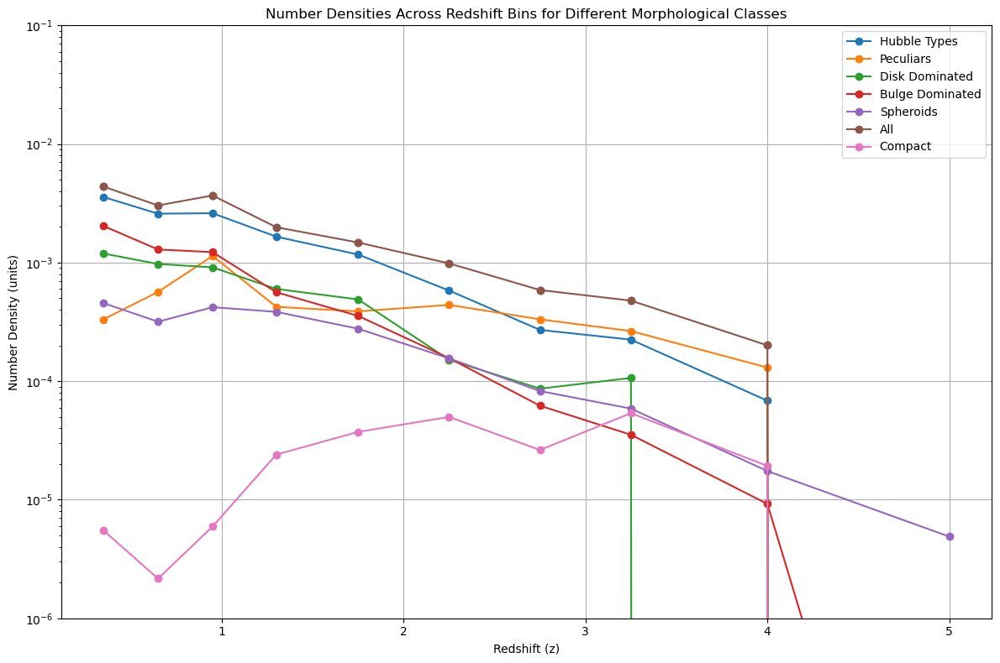

In [523]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad
from matplotlib.colors import Normalize
from matplotlib import cm

# --- Define the Schechter Functions ---

def schechter_function(logM, logphi_star, logM_star, alpha):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**logphi_star
    return np.log(10) * phi_star * (M / M_star)**(alpha+1) * np.exp(-M / M_star)

def double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2):
    M_over_M_star = logM - logM_star
    return np.log(10) * np.exp(-10**M_over_M_star) * 10**M_over_M_star * (10**logphi1 * 10**(M_over_M_star * alpha1) + 10**logphi2 * 10**(M_over_M_star * alpha2))

def DPL(logM, logM_star, alpha1, alpha2, phi_star):
    term1 = 10 ** (-(logM - logM_star) * (alpha1 + 1))
    term2 = 10 ** (-(logM - logM_star) * (alpha2 + 1))
    phi_logM_star = phi_star / (term1 + term2)
    return phi_logM_star

# --- Load Observational Data and Fit Results ---

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)  # Suppress warnings for clean output

# Load the observation dictionary
smf_morph_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompact.pkl'
with open(smf_morph_path, 'rb') as file:
    smf_morph = pickle.load(file)

# Load the fit results
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best.pkl'
with open(fit_results_best_path, 'rb') as file:
    fit_results_best = pickle.load(file)

# Define morphological classes and labels
morph_class = ['reg', 'irr', 'disk', 'db', 'sph', 'all','comp']
morph_labels = {
    'comp': 'Compact',
    'sph': 'Spheroids',
    'irr': 'Peculiars',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'reg': 'Hubble Types',
    'all': 'All'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5]

# Prepare colormap
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)
colormap = cm.coolwarm

# Initialize the number_densities dictionary
number_densities = {morph: [] for morph in morph_class}

# --- Compute Number Densities Based on Best-Fit Models ---

for zbin,zup in zip(zbins[:-1],zbins[1:]):
    zmed = (zbin+zup)/2
    for morph in morph_class:
        key = (zbin, morph)
        if key in fit_results_best:
            fit_info = fit_results_best[key]
            model = fit_info.get('model', None)
            samples = fit_info.get('samples', None)
            log_prob = fit_info.get('log_prob', None)
            
            if model is None or samples is None or log_prob is None:
                print(f"Missing information for zbin {zbin}, morph {morph}. Skipping.")
                continue
            
            # Compute percentiles
            params_50 = np.percentile(samples, 50, axis=0)
            params_16 = np.percentile(samples, 16, axis=0)
            params_84 = np.percentile(samples, 84, axis=0)
            
            # Depending on the model, unpack parameters accordingly
            try:
                if model == 'Single':
                    # Expected parameters: logphi_star, logM_star, alpha
                    logphi_star, logM_star, alpha = params_50
                    # Define the integrand for the Single Schechter Function
                    integrand = lambda logM: schechter_function(
                        logM, logphi_star, logM_star, alpha
                    )
                    
                elif model == 'Double':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi1, logphi2
                    logM_star, alpha1, alpha2, logphi1, logphi2 = params_50
                    integrand = lambda logM: double_schechter_function(
                        logM, logM_star, alpha1, alpha2, logphi1, logphi2
                    )
                    
                elif model == 'DPL':
                    # Expected parameters: logM_star, alpha1, alpha2, logphi_star
                    logM_star, alpha1, alpha2, logphi_star = params_50
                    integrand = lambda logM: DPL(
                        logM, logM_star, alpha1, alpha2, logphi_star
                    )
                    
                else:
                    print(f"Unknown model '{model}' for zbin {zbin}, morph {morph}. Skipping.")
                    continue
                
                # Define integration limits in logM (ensure they are within your data range)
                logM_min = 10  # log10(M/M_sun)
                logM_max = 11.5  # log10(M/M_sun)
                
                # Perform numerical integration
                integral, integral_error = quad(
                    integrand, logM_min, logM_max, limit=1000
                )
                
                # Append the result to number_densities
                if morph=='all':
                    number_densities[morph].append((zmed, integral))
                    na=integral
                if morph=='comp':
                    nc = na*cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values
                    number_densities[morph].append((zmed, nc))
                else:
                    number_densities[morph].append((zmed, integral))
                
                
                print(f"Computed number density for zbin {zbin}, morph {morph}, model {model}: {integral:.3e}")
                
            except Exception as e:
                print(f"Error computing number density for zbin {zbin}, morph {morph}: {e}")
                continue
        else:
            print(f"No fit results found for zbin {zbin}, morph {morph}.")
            continue

# --- Save the Number Densities to a Pickle File ---

number_densities_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/number_densities.pkl'
with open(number_densities_path, 'wb') as file:
    pickle.dump(number_densities, file)

print(f"Number densities successfully saved to {number_densities_path}")

# --- (Optional) Visualize the Number Densities ---

plt.figure(figsize=(12, 8))
for morph in morph_class:
    if number_densities[morph]:
        z_vals, densities = zip(*number_densities[morph])
        plt.plot(z_vals, densities, marker='o', label=morph_labels.get(morph, morph))
    else:
        print(f"No number densities computed for morph {morph}.")

plt.xlabel('Redshift (z)')
plt.ylabel('Number Density (units)')
plt.ylim((10e-7,10e-2))
plt.yscale('log')
plt.title('Number Densities Across Redshift Bins for Different Morphological Classes')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


zbin: 0.2 ≤ z < 0.5, morph: reg, model: Single, median density: 3.618e-03, +2.454e-04, -1.962e-04
zbin: 0.2 ≤ z < 0.5, morph: irr, model: Single, median density: 3.308e-04, +3.938e-05, -4.113e-05
zbin: 0.2 ≤ z < 0.5, morph: disk, model: Single, median density: 1.181e-03, +1.244e-04, -1.121e-04
zbin: 0.2 ≤ z < 0.5, morph: db, model: DPL, median density: 2.005e-03, +1.843e-04, -1.745e-04
zbin: 0.2 ≤ z < 0.5, morph: sph, model: Double, median density: 5.164e-04, +2.316e-01, -1.150e-04
zbin: 0.2 ≤ z < 0.5, morph: all, model: Single, median density: 3.728e-03, +2.711e-04, -2.328e-04
zbin: 0.2 ≤ z < 0.5, morph: comp, model: Single, median density: 7.390e-06, +6.776e-06, -6.146e-06
zbin: 0.5 ≤ z < 0.8, morph: reg, model: Single, median density: 2.528e-03, +1.340e-04, -1.626e-04
zbin: 0.5 ≤ z < 0.8, morph: irr, model: Single, median density: 5.515e-04, +5.179e-05, -4.352e-05
zbin: 0.5 ≤ z < 0.8, morph: disk, model: Single, median density: 9.437e-04, +8.483e-05, -9.116e-05
zbin: 0.5 ≤ z < 0.8, 

ValueError: array([[0.25723398, 0.33966055, 0.7896614 , 1.        ],
       [0.31394635, 0.42005166, 0.85499254, 1.        ],
       [0.37355243, 0.49749871, 0.90946737, 1.        ],
       [0.44643064, 0.58235643, 0.95737331, 1.        ],
       [0.54344019, 0.68000259, 0.99305052, 1.        ],
       [0.65668287, 0.77180648, 0.99491384, 1.        ],
       [0.75853883, 0.83278659, 0.95840785, 1.        ],
       [0.84736491, 0.86247248, 0.88554047, 1.        ],
       [0.94915051, 0.79078527, 0.71087559, 1.        ]]) is not a valid value for color

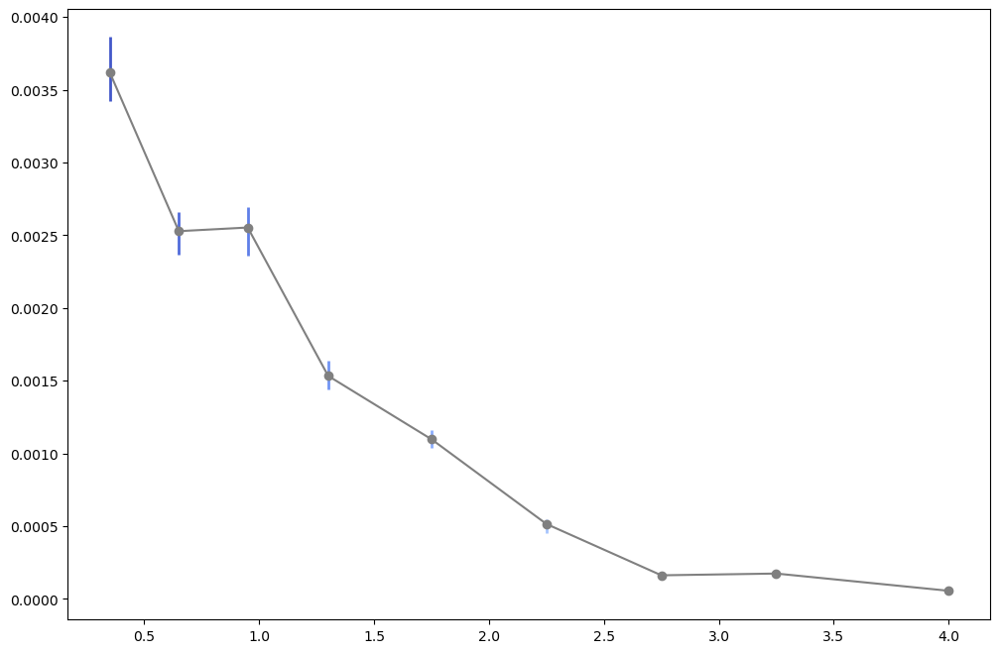

In [266]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad
from matplotlib.colors import Normalize
from matplotlib import cm

# --- Define the Schechter Functions ---

def schechter_function(logM, logphi_star, logM_star, alpha):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**logphi_star
    return np.log(10) * phi_star * (M / M_star)**(alpha+1) * np.exp(-M / M_star)

def double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2):
    M_over_M_star = logM - logM_star
    return np.log(10) * np.exp(-10**M_over_M_star) * 10**M_over_M_star * (
        10**logphi1 * 10**(M_over_M_star * alpha1) + 
        10**logphi2 * 10**(M_over_M_star * alpha2)
    )

def DPL(logM, logM_star, alpha1, alpha2, phi_star):
    term1 = 10 ** (-(logM - logM_star) * (alpha1 + 1))
    term2 = 10 ** (-(logM - logM_star) * (alpha2 + 1))
    phi_logM_star = 10**phi_star / (term1 + term2)
    return phi_logM_star

# --- Load Observational Data and Fit Results ---

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)  # Suppress warnings for clean output

# Load the observation dictionary
smf_morph_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompactphys_0.07F444.pkl'
with open(smf_morph_path, 'rb') as file:
    smf_morph = pickle.load(file)

# Load the fit results
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best_nocompphys.pkl'
with open(fit_results_best_path, 'rb') as file:
    fit_results_best = pickle.load(file)

# Define morphological classes and labels
morph_class = ['reg', 'irr', 'disk', 'db', 'sph', 'all', 'comp']
morph_labels = {
    'comp': 'Compact',
    'sph': 'Spheroids',
    'irr': 'Peculiars',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'reg': 'Hubble Types',
    'all': 'All',
    'late': 'Late Type'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5]

# Prepare colormap
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)
colormap = cm.coolwarm

# Define integration limits in logM (ensure they are within your data range)
logM_min = 10  # log10(M/M_sun)
logM_max = 11.5  # log10(M/M_sun)

# Initialize the number_densities dictionary
# Each entry will be a list of tuples: (zmed, median_density, error_up, error_down)
number_densities = {morph: [] for morph in morph_class}

# --- Compute Number Densities Based on Best-Fit Models and Sampled Uncertainties ---

for zbin, zup in zip(zbins[:-1], zbins[1:]):
    zmed = (zbin + zup) / 2
    for morph in morph_class:
        key = (zbin, morph)
        if key in fit_results_best:
            fit_info = fit_results_best[key]
            model = fit_info.get('model', None)
            samples = fit_info.get('samples', None)  # Shape: (n_samples, n_params)
            log_prob = fit_info.get('log_prob', None)
            
            if model is None or samples is None or log_prob is None:
                print(f"Missing information for zbin {zbin}, morph {morph}. Skipping.")
                continue
            
            # Number of samples to draw
            n_total_samples = samples.shape[0]
            n_samp = min(100, n_total_samples)  # Limit to 100 samples or available samples
            
            # Randomly sample indices without replacement
            sampled_indices = np.random.choice(n_total_samples, size=n_samp, replace=False)
            sampled_params = samples[sampled_indices]
            
            # Initialize list to store number densities for each sampled parameter set
            sampled_densities = []
            
            # Compute number densities for each sampled parameter set
            for params in sampled_params:
                try:
                    if model == 'Single':
                        # Expected parameters: logphi_star, logM_star, alpha
                        logphi_star, logM_star, alpha = params
                        integrand = lambda logM: schechter_function(
                            logM, logphi_star, logM_star, alpha
                        )
                        
                    elif model == 'Double':
                        # Expected parameters: logM_star, alpha1, alpha2, logphi1, logphi2
                        logM_star, alpha1, alpha2, logphi1, logphi2 = params
                        integrand = lambda logM: double_schechter_function(
                            logM, logM_star, alpha1, alpha2, logphi1, logphi2
                        )
                        
                    elif model == 'DPL':
                        # Expected parameters: logM_star, alpha1, alpha2, phi_star
                        logM_star, alpha1, alpha2, phi_star = params
                        integrand = lambda logM: DPL(
                            logM, logM_star, alpha1, alpha2, phi_star
                        )
                        
                    else:
                        print(f"Unknown model '{model}' for zbin {zbin}, morph {morph}. Skipping.")
                        continue
                    
                    # Perform numerical integration
                    integral, integral_error = quad(
                        integrand, logM_min, logM_max, limit=1000
                    )
                    
                    sampled_densities.append(integral)
                    
                except Exception as e:
                    print(f"Error computing number density for zbin {zbin}, morph {morph}: {e}")
                    sampled_densities.append(np.nan)
            
            # Convert list to NumPy array for statistical computations
            sampled_densities = np.array(sampled_densities)
            
            # Remove NaN values
            sampled_densities = sampled_densities[~np.isnan(sampled_densities)]
            
            if len(sampled_densities) == 0:
                print(f"No valid number densities computed for zbin {zbin}, morph {morph}.")
                continue
            
            # Compute median and uncertainties
            median_density = np.median(sampled_densities)
            lower_percentile = np.percentile(sampled_densities, 16)
            upper_percentile = np.percentile(sampled_densities, 84)
            error_down = median_density - lower_percentile
            error_up = upper_percentile - median_density
            # Append the result to number_densities
            if morph=='all' and zbin==5.5:
                na=median_density
                eda = error_down
                eua = error_up
            if morph=='comp' and zbin==5.5:
                median_density = na*cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values[0]
                print('fraction of compact',cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values[0])
                error_down = eda*cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values[0]
                error_up = eua*cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values[0]
              
            
            # Store the results
            number_densities[morph].append((zmed, median_density, error_up, error_down))
            
            print(f"zbin: {zbin} ≤ z < {zup}, morph: {morph}, model: {model}, "
                  f"median density: {median_density:.3e}, "
                  f"+{error_up:.3e}, -{error_down:.3e}")
            
        else:
            print(f"No fit results found for zbin {zbin}, morph {morph}. Skipping.")
            continue

# --- Save the Number Densities with Uncertainties to a Pickle File ---

number_densities_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/number_densities_with_errors_nocompphys.pkl'
with open(number_densities_path, 'wb') as file:
    pickle.dump(number_densities, file)

print(f"\nNumber densities with uncertainties successfully saved to {number_densities_path}")

# --- (Optional) Visualize the Number Densities with Error Bars ---

plt.figure(figsize=(12, 8))
for morph in morph_class:
    if number_densities[morph]:
        z_vals, medians, error_ups, error_downs = zip(*number_densities[morph])
        medians = np.array(medians)
        error_ups = np.array(error_ups)
        error_downs = np.array(error_downs)
        
        # Define color based on redshift
        colors = cm.coolwarm(norm(z_vals))
        
        # Plot with error bars
        plt.errorbar(
            z_vals,
            medians,
            yerr=[error_downs, error_ups],
            fmt='o-',
            color='grey',  # Using a neutral color; can be customized
            ecolor=colors,
            elinewidth=2,
            capsize=4,
            label=morph_labels.get(morph, morph)
        )
    else:
        print(f"No number densities computed for morph {morph}.")
        
# Add colorbar representing redshift bins
sm = cm.ScalarMappable(cmap=colormap, norm=norm)
sm.set_array([])  # Only needed for older versions of Matplotlib
cbar = plt.colorbar(sm, ticks=zbins)
cbar.set_label('Redshift (z)', fontsize=16)
cbar.ax.tick_params(labelsize=14)

# Customize the plot
plt.xlabel('Redshift (z)', fontsize=20)
plt.ylabel('Number Density (Mpc$^{-3}$)', fontsize=20)
plt.title('Number Densities Across Redshift Bins for Different Morphological Classes', fontsize=20)
plt.yscale('log')  # Logarithmic scale for number density
plt.legend(title='Morphology', fontsize=16, title_fontsize='20', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, which="both", ls="--", linewidth=0.5)
plt.tight_layout()

# Show the plot
plt.show()


zbin: 0.2 ≤ z < 0.5, morph: reg, model: Single, median density: 2.643e-03, +2.038e-04, -3.103e-04
zbin: 0.2 ≤ z < 0.5, morph: irr, model: Double, median density: 1.077e-04, +2.704e-05, -2.692e-05
zbin: 0.2 ≤ z < 0.5, morph: disk, model: Single, median density: 5.259e-04, +5.847e-05, -8.125e-05
zbin: 0.2 ≤ z < 0.5, morph: db, model: Single, median density: 1.780e-03, +1.486e-04, -1.635e-04
zbin: 0.2 ≤ z < 0.5, morph: sph, model: Double, median density: 4.598e-04, +6.756e-05, -8.015e-05
zbin: 0.2 ≤ z < 0.5, morph: all, model: Double, median density: 2.886e-03, +1.835e-04, -2.832e-04
fraction of compact 0.0026292725679228747
zbin: 0.2 ≤ z < 0.5, morph: comp, model: Single, median density: 7.588e-06, +4.824e-07, -7.446e-07
zbin: 0.5 ≤ z < 0.8, morph: reg, model: Single, median density: 1.528e-03, +1.346e-04, -1.494e-04
zbin: 0.5 ≤ z < 0.8, morph: irr, model: Double, median density: 1.166e-04, +1.924e-05, -1.783e-05
zbin: 0.5 ≤ z < 0.8, morph: disk, model: Single, median density: 1.919e-04,

ValueError: array([[0.25723398, 0.33966055, 0.7896614 , 1.        ],
       [0.31394635, 0.42005166, 0.85499254, 1.        ],
       [0.37355243, 0.49749871, 0.90946737, 1.        ],
       [0.44643064, 0.58235643, 0.95737331, 1.        ],
       [0.54344019, 0.68000259, 0.99305052, 1.        ],
       [0.65668287, 0.77180648, 0.99491384, 1.        ],
       [0.75853883, 0.83278659, 0.95840785, 1.        ],
       [0.84736491, 0.86247248, 0.88554047, 1.        ],
       [0.94915051, 0.79078527, 0.71087559, 1.        ]]) is not a valid value for color

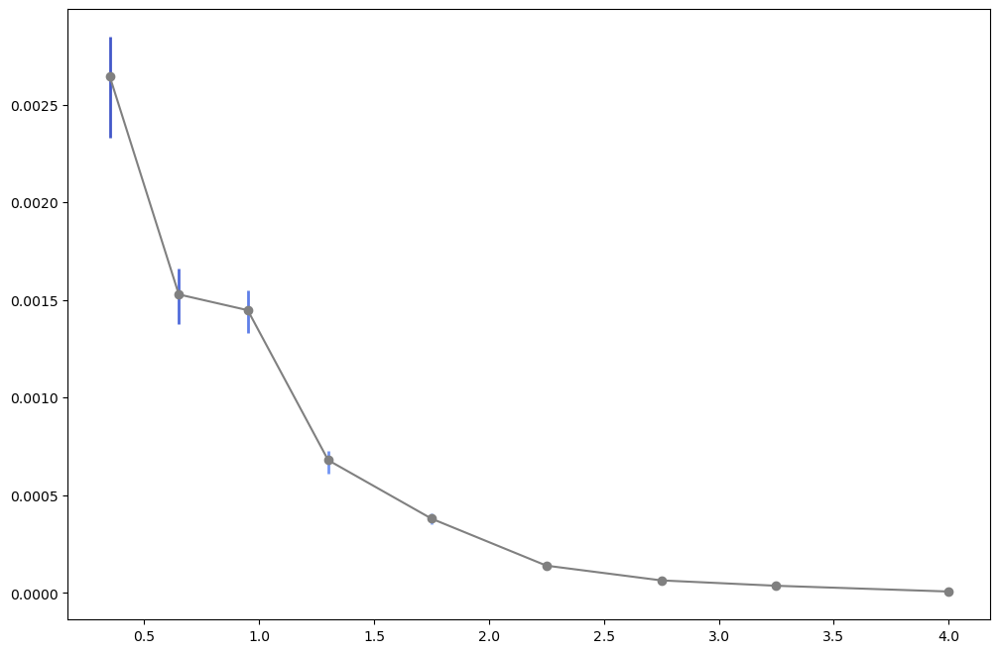

In [318]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad
from matplotlib.colors import Normalize
from matplotlib import cm

# --- Define the Schechter Functions ---

def schechter_function(logM, logphi_star, logM_star, alpha):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**logphi_star
    return np.log(10) * phi_star * (M / M_star)**(alpha+1) * np.exp(-M / M_star)

def double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2):
    M_over_M_star = logM - logM_star
    return np.log(10) * np.exp(-10**M_over_M_star) * 10**M_over_M_star * (
        10**logphi1 * 10**(M_over_M_star * alpha1) + 
        10**logphi2 * 10**(M_over_M_star * alpha2)
    )

def DPL(logM, logM_star, alpha1, alpha2, phi_star):
    term1 = 10 ** (-(logM - logM_star) * (alpha1 + 1))
    term2 = 10 ** (-(logM - logM_star) * (alpha2 + 1))
    phi_logM_star = 10**phi_star / (term1 + term2)
    return phi_logM_star

# --- Load Observational Data and Fit Results ---

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)  # Suppress warnings for clean output

# Load the observation dictionary
smf_morph_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompact_0.07F444_Q.pkl'
with open(smf_morph_path, 'rb') as file:
    smf_morph = pickle.load(file)

# Load the fit results
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best_Q.pkl'
with open(fit_results_best_path, 'rb') as file:
    fit_results_best = pickle.load(file)

# Define morphological classes and labels
morph_class = ['reg', 'irr', 'disk', 'db', 'sph', 'all', 'comp']
morph_labels = {
    'comp': 'Compact',
    'sph': 'Spheroids',
    'irr': 'Peculiars',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'reg': 'Hubble Types',
    'all': 'All',
    'late': 'Late Type'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5]

# Prepare colormap
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)
colormap = cm.coolwarm

# Define integration limits in logM (ensure they are within your data range)
logM_min = 10  # log10(M/M_sun)
logM_max = 11.5  # log10(M/M_sun)

# Initialize the number_densities dictionary
# Each entry will be a list of tuples: (zmed, median_density, error_up, error_down)
number_densities = {morph: [] for morph in morph_class}

# --- Compute Number Densities Based on Best-Fit Models and Sampled Uncertainties ---

for zbin, zup in zip(zbins[:-1], zbins[1:]):
    zmed = (zbin + zup) / 2
    for morph in morph_class:
        key = (zbin, morph)
        if key in fit_results_best:
            fit_info = fit_results_best[key]
            model = fit_info.get('model', None)
            samples = fit_info.get('samples', None)  # Shape: (n_samples, n_params)
            log_prob = fit_info.get('log_prob', None)
            
            if model is None or samples is None or log_prob is None:
                print(f"Missing information for zbin {zbin}, morph {morph}. Skipping.")
                continue
            
            # Number of samples to draw
            n_total_samples = samples.shape[0]
            n_samp = min(100, n_total_samples)  # Limit to 100 samples or available samples
            
            # Randomly sample indices without replacement
            sampled_indices = np.random.choice(n_total_samples, size=n_samp, replace=False)
            sampled_params = samples[sampled_indices]
            
            # Initialize list to store number densities for each sampled parameter set
            sampled_densities = []
            
            # Compute number densities for each sampled parameter set
            for params in sampled_params:
                try:
                    if model == 'Single':
                        # Expected parameters: logphi_star, logM_star, alpha
                        logphi_star, logM_star, alpha = params
                        integrand = lambda logM: schechter_function(
                            logM, logphi_star, logM_star, alpha
                        )
                        
                    elif model == 'Double':
                        # Expected parameters: logM_star, alpha1, alpha2, logphi1, logphi2
                        logM_star, alpha1, alpha2, logphi1, logphi2 = params
                        integrand = lambda logM: double_schechter_function(
                            logM, logM_star, alpha1, alpha2, logphi1, logphi2
                        )
                        
                    elif model == 'DPL':
                        # Expected parameters: logM_star, alpha1, alpha2, phi_star
                        logM_star, alpha1, alpha2, phi_star = params
                        integrand = lambda logM: DPL(
                            logM, logM_star, alpha1, alpha2, phi_star
                        )
                        
                    else:
                        print(f"Unknown model '{model}' for zbin {zbin}, morph {morph}. Skipping.")
                        continue
                    
                    # Perform numerical integration
                    integral, integral_error = quad(
                        integrand, logM_min, logM_max, limit=1000
                    )
                    
                    sampled_densities.append(integral)
                    
                except Exception as e:
                    print(f"Error computing number density for zbin {zbin}, morph {morph}: {e}")
                    sampled_densities.append(np.nan)
            
            # Convert list to NumPy array for statistical computations
            sampled_densities = np.array(sampled_densities)
            
            # Remove NaN values
            sampled_densities = sampled_densities[~np.isnan(sampled_densities)]
            
            if len(sampled_densities) == 0:
                print(f"No valid number densities computed for zbin {zbin}, morph {morph}.")
                continue
            
            # Compute median and uncertainties
            median_density = np.median(sampled_densities)
            lower_percentile = np.percentile(sampled_densities, 16)
            upper_percentile = np.percentile(sampled_densities, 84)
            error_down = median_density - lower_percentile
            error_up = upper_percentile - median_density
            # Append the result to number_densities
            if morph=='all':
                na=median_density
                eda = error_down
                eua = error_up
            if morph=='comp':
                median_density = na*cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values[0]
                print('fraction of compact',cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values[0])
                error_down = eda*cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values[0]
                error_up = eua*cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values[0]
              
            
            # Store the results
            number_densities[morph].append((zmed, median_density, error_up, error_down))
            
            print(f"zbin: {zbin} ≤ z < {zup}, morph: {morph}, model: {model}, "
                  f"median density: {median_density:.3e}, "
                  f"+{error_up:.3e}, -{error_down:.3e}")
            
        else:
            print(f"No fit results found for zbin {zbin}, morph {morph}. Skipping.")
            continue

# --- Save the Number Densities with Uncertainties to a Pickle File ---

number_densities_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/number_densities_with_errors_Q.pkl'
with open(number_densities_path, 'wb') as file:
    pickle.dump(number_densities, file)

print(f"\nNumber densities with uncertainties successfully saved to {number_densities_path}")

# --- (Optional) Visualize the Number Densities with Error Bars ---

plt.figure(figsize=(12, 8))
for morph in morph_class:
    if number_densities[morph]:
        z_vals, medians, error_ups, error_downs = zip(*number_densities[morph])
        medians = np.array(medians)
        error_ups = np.array(error_ups)
        error_downs = np.array(error_downs)
        
        # Define color based on redshift
        colors = cm.coolwarm(norm(z_vals))
        
        # Plot with error bars
        plt.errorbar(
            z_vals,
            medians,
            yerr=[error_downs, error_ups],
            fmt='o-',
            color='grey',  # Using a neutral color; can be customized
            ecolor=colors,
            elinewidth=2,
            capsize=4,
            label=morph_labels.get(morph, morph)
        )
    else:
        print(f"No number densities computed for morph {morph}.")
        
# Add colorbar representing redshift bins
sm = cm.ScalarMappable(cmap=colormap, norm=norm)
sm.set_array([])  # Only needed for older versions of Matplotlib
cbar = plt.colorbar(sm, ticks=zbins)
cbar.set_label('Redshift (z)', fontsize=16)
cbar.ax.tick_params(labelsize=14)

# Customize the plot
plt.xlabel('Redshift (z)', fontsize=20)
plt.ylabel('Number Density (Mpc$^{-3}$)', fontsize=20)
plt.title('Number Densities Across Redshift Bins for Different Morphological Classes', fontsize=20)
plt.yscale('log')  # Logarithmic scale for number density
plt.legend(title='Morphology', fontsize=16, title_fontsize='20', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, which="both", ls="--", linewidth=0.5)
plt.tight_layout()

# Show the plot
plt.show()


zbin: 0.2 ≤ z < 0.5, morph: reg, model: Single, median density: 2.461e-03, +2.317e-04, -1.722e-04
zbin: 0.2 ≤ z < 0.5, morph: irr, model: Double, median density: 1.124e-03, +1.298e-04, -1.103e-04
zbin: 0.2 ≤ z < 0.5, morph: disk, model: Single, median density: 1.075e-03, +1.042e-04, -1.865e-04
zbin: 0.2 ≤ z < 0.5, morph: db, model: Single, median density: 8.505e-04, +7.131e-05, -1.172e-04
zbin: 0.2 ≤ z < 0.5, morph: sph, model: Double, median density: 4.082e-04, +7.203e-05, -6.151e-05
zbin: 0.2 ≤ z < 0.5, morph: all, model: Double, median density: 3.672e-03, +2.485e-04, -3.417e-04
fraction of compact 0.0008764241893076249
zbin: 0.2 ≤ z < 0.5, morph: comp, model: Single, median density: 3.218e-06, +2.178e-07, -2.995e-07
zbin: 0.5 ≤ z < 0.8, morph: reg, model: Single, median density: 9.645e-04, +8.886e-05, -1.109e-04
zbin: 0.5 ≤ z < 0.8, morph: irr, model: Double, median density: 1.014e-03, +1.000e-04, -9.213e-05
zbin: 0.5 ≤ z < 0.8, morph: disk, model: Single, median density: 3.014e-04,

ValueError: array([[0.25723398, 0.33966055, 0.7896614 , 1.        ],
       [0.31394635, 0.42005166, 0.85499254, 1.        ],
       [0.37355243, 0.49749871, 0.90946737, 1.        ],
       [0.44643064, 0.58235643, 0.95737331, 1.        ],
       [0.54344019, 0.68000259, 0.99305052, 1.        ],
       [0.65668287, 0.77180648, 0.99491384, 1.        ],
       [0.75853883, 0.83278659, 0.95840785, 1.        ],
       [0.84736491, 0.86247248, 0.88554047, 1.        ],
       [0.94915051, 0.79078527, 0.71087559, 1.        ]]) is not a valid value for color

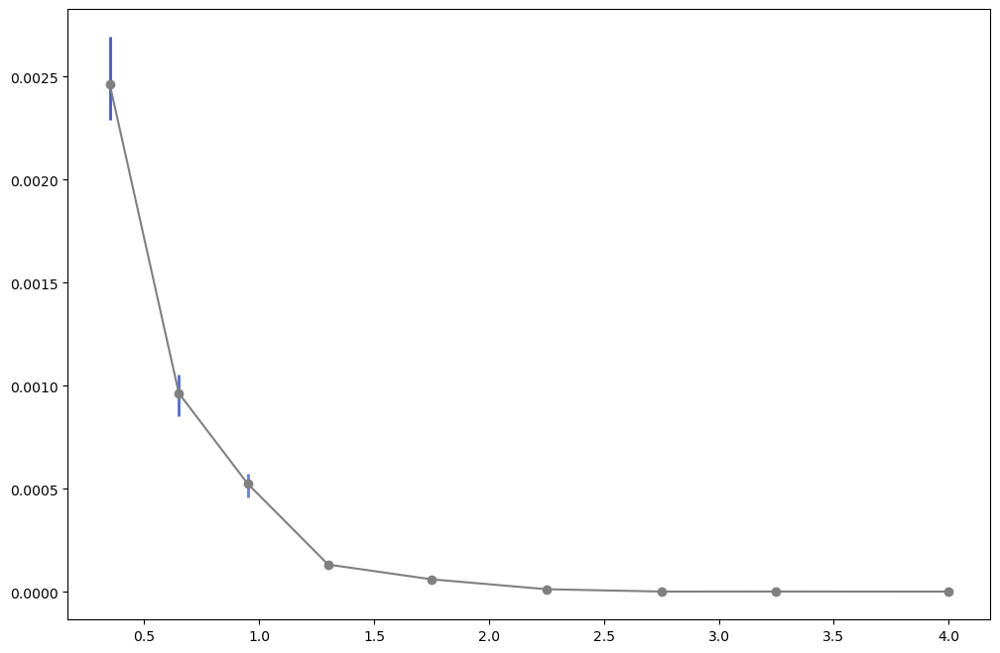

In [103]:
import os
import pickle
import numpy as np
import matplotlib.pyplot as plt
from scipy.integrate import quad
from matplotlib.colors import Normalize
from matplotlib import cm

# --- Define the Schechter Functions ---

def schechter_function(logM, logphi_star, logM_star, alpha):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**logphi_star
    return np.log(10) * phi_star * (M / M_star)**(alpha+1) * np.exp(-M / M_star)

def double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2):
    M_over_M_star = logM - logM_star
    return np.log(10) * np.exp(-10**M_over_M_star) * 10**M_over_M_star * (
        10**logphi1 * 10**(M_over_M_star * alpha1) + 
        10**logphi2 * 10**(M_over_M_star * alpha2)
    )

def DPL(logM, logM_star, alpha1, alpha2, phi_star):
    term1 = 10 ** (-(logM - logM_star) * (alpha1 + 1))
    term2 = 10 ** (-(logM - logM_star) * (alpha2 + 1))
    phi_logM_star = 10**phi_star / (term1 + term2)
    return phi_logM_star

# --- Load Observational Data and Fit Results ---

import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)  # Suppress warnings for clean output

# Load the observation dictionary
smf_morph_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompact_0.07F444_Q.pkl'
with open(smf_morph_path, 'rb') as file:
    smf_morph = pickle.load(file)

# Load the fit results
fit_results_best_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results_best_Q.pkl'
with open(fit_results_best_path, 'rb') as file:
    fit_results_best = pickle.load(file)

# Define morphological classes and labels
morph_class = ['reg', 'irr', 'disk', 'db', 'sph', 'all', 'comp']
morph_labels = {
    'comp': 'Compact',
    'sph': 'Spheroids',
    'irr': 'Peculiars',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'reg': 'Hubble Types',
    'all': 'All',
    'late': 'Late Type'
}

# Define redshift bins
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5,6.5]

# Prepare colormap
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)
colormap = cm.coolwarm

# Define integration limits in logM (ensure they are within your data range)
logM_min = 8.5  # log10(M/M_sun)
logM_max = 10  # log10(M/M_sun)

# Initialize the number_densities dictionary
# Each entry will be a list of tuples: (zmed, median_density, error_up, error_down)
number_densities = {morph: [] for morph in morph_class}

# --- Compute Number Densities Based on Best-Fit Models and Sampled Uncertainties ---

for zbin, zup in zip(zbins[:-1], zbins[1:]):
    zmed = (zbin + zup) / 2
    for morph in morph_class:
        key = (zbin, morph)
        if key in fit_results_best:
            fit_info = fit_results_best[key]
            model = fit_info.get('model', None)
            samples = fit_info.get('samples', None)  # Shape: (n_samples, n_params)
            log_prob = fit_info.get('log_prob', None)
            
            if model is None or samples is None or log_prob is None:
                print(f"Missing information for zbin {zbin}, morph {morph}. Skipping.")
                continue
            
            # Number of samples to draw
            n_total_samples = samples.shape[0]
            n_samp = min(100, n_total_samples)  # Limit to 100 samples or available samples
            
            # Randomly sample indices without replacement
            sampled_indices = np.random.choice(n_total_samples, size=n_samp, replace=False)
            sampled_params = samples[sampled_indices]
            
            # Initialize list to store number densities for each sampled parameter set
            sampled_densities = []
            
            # Compute number densities for each sampled parameter set
            for params in sampled_params:
                try:
                    if model == 'Single':
                        # Expected parameters: logphi_star, logM_star, alpha
                        logphi_star, logM_star, alpha = params
                        integrand = lambda logM: schechter_function(
                            logM, logphi_star, logM_star, alpha
                        )
                        
                    elif model == 'Double':
                        # Expected parameters: logM_star, alpha1, alpha2, logphi1, logphi2
                        logM_star, alpha1, alpha2, logphi1, logphi2 = params
                        integrand = lambda logM: double_schechter_function(
                            logM, logM_star, alpha1, alpha2, logphi1, logphi2
                        )
                        
                    elif model == 'DPL':
                        # Expected parameters: logM_star, alpha1, alpha2, phi_star
                        logM_star, alpha1, alpha2, phi_star = params
                        integrand = lambda logM: DPL(
                            logM, logM_star, alpha1, alpha2, phi_star
                        )
                        
                    else:
                        print(f"Unknown model '{model}' for zbin {zbin}, morph {morph}. Skipping.")
                        continue
                    
                    # Perform numerical integration
                    integral, integral_error = quad(
                        integrand, logM_min, logM_max, limit=1000
                    )
                    
                    sampled_densities.append(integral)
                    
                except Exception as e:
                    print(f"Error computing number density for zbin {zbin}, morph {morph}: {e}")
                    sampled_densities.append(np.nan)
            
            # Convert list to NumPy array for statistical computations
            sampled_densities = np.array(sampled_densities)
            
            # Remove NaN values
            sampled_densities = sampled_densities[~np.isnan(sampled_densities)]
            
            if len(sampled_densities) == 0:
                print(f"No valid number densities computed for zbin {zbin}, morph {morph}.")
                continue
            
            # Compute median and uncertainties
            median_density = np.median(sampled_densities)
            lower_percentile = np.percentile(sampled_densities, 16)
            upper_percentile = np.percentile(sampled_densities, 84)
            error_down = median_density - lower_percentile
            error_up = upper_percentile - median_density
            # Append the result to number_densities
            if morph=='all':
                na=median_density
                eda = error_down
                eua = error_up
            if morph=='comp':
                median_density = na*cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values[0]
                print('fraction of compact',cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values[0])
                error_down = eda*cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values[0]
                error_up = eua*cumulative_fraction_df.query('Redshift_Low=='+str(zbin)).Fraction_Above10.values[0]
              
            
            # Store the results
            number_densities[morph].append((zmed, median_density, error_up, error_down))
            
            print(f"zbin: {zbin} ≤ z < {zup}, morph: {morph}, model: {model}, "
                  f"median density: {median_density:.3e}, "
                  f"+{error_up:.3e}, -{error_down:.3e}")
            
        else:
            print(f"No fit results found for zbin {zbin}, morph {morph}. Skipping.")
            continue

# --- Save the Number Densities with Uncertainties to a Pickle File ---

number_densities_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/number_densities_with_errors_Q_lowmass.pkl'
with open(number_densities_path, 'wb') as file:
    pickle.dump(number_densities, file)

print(f"\nNumber densities with uncertainties successfully saved to {number_densities_path}")

# --- (Optional) Visualize the Number Densities with Error Bars ---

plt.figure(figsize=(12, 8))
for morph in morph_class:
    if number_densities[morph]:
        z_vals, medians, error_ups, error_downs = zip(*number_densities[morph])
        medians = np.array(medians)
        error_ups = np.array(error_ups)
        error_downs = np.array(error_downs)
        
        # Define color based on redshift
        colors = cm.coolwarm(norm(z_vals))
        
        # Plot with error bars
        plt.errorbar(
            z_vals,
            medians,
            yerr=[error_downs, error_ups],
            fmt='o-',
            color='grey',  # Using a neutral color; can be customized
            ecolor=colors,
            elinewidth=2,
            capsize=4,
            label=morph_labels.get(morph, morph)
        )
    else:
        print(f"No number densities computed for morph {morph}.")
        
# Add colorbar representing redshift bins
sm = cm.ScalarMappable(cmap=colormap, norm=norm)
sm.set_array([])  # Only needed for older versions of Matplotlib
cbar = plt.colorbar(sm, ticks=zbins)
cbar.set_label('Redshift (z)', fontsize=16)
cbar.ax.tick_params(labelsize=14)

# Customize the plot
plt.xlabel('Redshift (z)', fontsize=20)
plt.ylabel('Number Density (Mpc$^{-3}$)', fontsize=20)
plt.title('Number Densities Across Redshift Bins for Different Morphological Classes', fontsize=20)
plt.yscale('log')  # Logarithmic scale for number density
plt.legend(title='Morphology', fontsize=16, title_fontsize='20', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, which="both", ls="--", linewidth=0.5)
plt.tight_layout()

# Show the plot
plt.show()


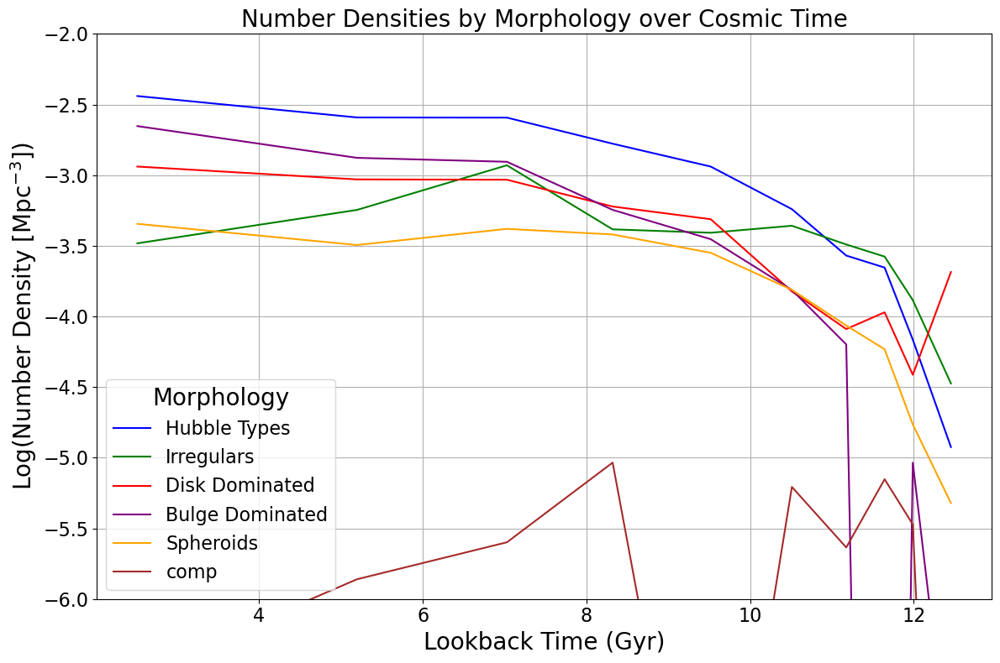

In [372]:
import matplotlib.pyplot as plt
import numpy as np
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results
from astropy import units as u

# Define a color scheme for morphological classes
colors = {
    'reg': 'blue',
    'irr': 'green',
    'disk': 'red',
    'db': 'purple',
    'sph': 'orange',
    'comp': 'brown'
}

# Define morphological labels
morph_labels = {
    'reg': 'Hubble Types',
    'sph': 'Spheroids',
    'irr': 'Irregulars',
    'disk': 'Disk Dominated',
    'db': 'Bulge Dominated',
    'all': 'All',
    'early': 'Early-Type'
}

plt.figure(figsize=(12, 8))

# Plot number densities without error bars
for morph, data in number_densities.items():
    if not data:
        print(f"No data available for morphology '{morph}'. Skipping.")
        continue
    
    redshifts = np.array([item[0] for item in data])
    lookback_times = cosmo.lookback_time(redshifts).value  # Convert redshift to lookback time in Gyr
    
    densities = np.array([item[1] for item in data])
    
    # To avoid log10 of zero or negative numbers, filter out non-positive densities
    positive_mask = densities > 0
    lookback_times = lookback_times[positive_mask]
    densities = densities[positive_mask]
    
    # Plotting
    plt.plot(lookback_times, np.log10(densities), color=colors.get(morph, 'black'),
             label=morph_labels.get(morph, morph))

# Plot settings
plt.xlabel('Lookback Time (Gyr)', fontsize=20)
plt.ylabel('Log(Number Density [Mpc$^{-3}$])', fontsize=20)
plt.title('Number Densities by Morphology over Cosmic Time', fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-6, -2)
plt.legend(fontsize=16, title='Morphology', title_fontsize='20')
plt.grid(True)
plt.tight_layout()

plt.show()


In [1]:
import numpy as np
import matplotlib.pyplot as plt
import emcee
import corner
from scipy.optimize import curve_fit

# Extract the data from the dictionary for spheroid class and lowest redshift bin
logM = smf_morph_Q[(0.2, 'sph', 'LogMassbin')]
Phi = smf_morph_Q[(0.2, 'sph', 'Fi')]

# Define the double Schechter function
def double_schechter_function(logM, phi_star1, phi_star2, logM_star, alpha1, alpha2):
    M = 10**logM
    M_star = 10**logM_star
    term1 = phi_star1 * (M / M_star)**alpha1 * np.exp(-M / M_star)
    term2 = phi_star2 * (M / M_star)**alpha2 * np.exp(-M / M_star)
    return np.log(10) * (term1 + term2)

# Log-likelihood function
def log_likelihood(theta, logM, Phi):
    phi_star1, phi_star2, logM_star, alpha1, alpha2 = theta
    model = double_schechter_function(logM, phi_star1, phi_star2, logM_star, alpha1, alpha2)
    sigma = np.sqrt(Phi)  # Assuming Poisson errors for demonstration
    return -0.5 * np.sum((Phi - model)**2 / sigma**2)

# Define the priors
def log_prior(theta):
    phi_star1, phi_star2, logM_star, alpha1, alpha2 = theta
    if 0.0 < phi_star1 < 0.01 and 0.0 < phi_star2 < 0.01 and 10.0 < logM_star < 12.0 and -2.0 < alpha1 < 0.0 and -2.0 < alpha2 < 0.0:
        return 0.0
    return -np.inf

# Combined log-probability function
def log_probability(theta, logM, Phi):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, logM, Phi)

# Set up the MCMC
nwalkers, ndim = 1000, 5
pos = [np.array([0.05, 0.005, 11, -1.2, -1.2]) + 1e-4 * np.random.randn(ndim) for i in range(nwalkers)]

sampler = emcee.EnsembleSampler(nwalkers, ndim, log_probability, args=(logM, Phi))
sampler.run_mcmc(pos, 2000, progress=True)

# Analyze the results
samples = sampler.get_chain(discard=100, thin=15, flat=True)
phi_star1_mcmc, phi_star2_mcmc, logM_star_mcmc, alpha1_mcmc, alpha2_mcmc = np.percentile(samples, 50, axis=0)

# Plotting the fitted function and the data
plt.figure(figsize=(10, 5))
plt.plot(logM, Phi, 'o', label='Data')
plt.plot(logM, double_schechter_function(logM, phi_star1_mcmc, phi_star2_mcmc, logM_star_mcmc, alpha1_mcmc, alpha2_mcmc),
         label='Fit', color='red')
plt.xlabel('Log(Mass)')
plt.ylabel('Phi')
plt.legend()
plt.title('Fit to Double Schechter Function')
plt.show()

# Plot the corner plot
fig = corner.corner(samples, labels=['phi_star1', 'phi_star2', 'logM_star', 'alpha1', 'alpha2'], truths=[phi_star1_mcmc, phi_star2_mcmc, logM_star_mcmc, alpha1_mcmc, alpha2_mcmc])
plt.show()

print(f"Fitted parameters: Phi1*={phi_star1_mcmc}, Phi2*={phi_star2_mcmc}, logM*={logM_star_mcmc}, alpha1={alpha1_mcmc}, alpha2={alpha2_mcmc}")


NameError: name 'smf_morph_Q' is not defined

In [234]:
import numpy as np
import emcee
import pickle
import os
import h5py

morph_class=['sph','disk','irr','db','early','all','reg','late']
zbins =  [0.2,0.5,0.8,1.1,1.5,2,2.5,3,3.5,4.5,5.5]

def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))

def log_likelihood(theta, logM, Phi, dPhi):
    logM_star, alpha1, alpha2, logphi1, logphi2 = theta
    model = double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2)
    return -0.5 * np.sum((Phi - model)**2 / dPhi**2)

def log_prior(theta):
    logM_star, alpha1, alpha2, logphi1, logphi2 = theta
    if -5 < logphi1 < 0 and -5 < logphi2 < 0 and 8.0 < logM_star < 12.0 and -4 < alpha1 < -1 and -1 < alpha2 < 4:
        return 0.0
    return -np.inf

def log_probability(theta, logM, Phi, dPhi):
    lp = log_prior(theta)
    if not np.isfinite(lp):
        return -np.inf
    return lp + log_likelihood(theta, logM, Phi, dPhi)

# Results dictionary
fit_results = {}

# Set up the MCMC parameters
nwalkers, ndim = 500, 5
pos_func = lambda g: [g + 1*np.random.randn(ndim) for i in range(nwalkers)]

# Main loop over redshift and morphology bins
for zbin in zbins[:-1]:
    for morph in morph_class:
        #key = (zbin, morph)
        if len(smf_morph[(zbin,morph,'LogMassbin')]) > 0:
            logM = smf_morph[(zbin,morph,'LogMassbin')]
            Phi = smf_morph[(zbin,morph,'Fi')]
            dPhi = smf_morph[(zbin,morph,'dFi')]

            # Filter out zero or negative values in Phi or dPhi
            valid = (Phi > 0) & (dPhi > 0) 
            if not np.any(valid):
                print(f"Skipping {morph} at z={zbin} entirely, no valid data points after filtering.")
                continue
            logM = logM[valid]
            Phi = Phi[valid]
            dPhi = dPhi[valid]

            initial_guess = [10.5, -0.6, -1.7, -2, -2]
            pos = pos_func(initial_guess)
            sampler = emcee.EnsembleSampler(nwalkers, ndim, log_probability, args=(logM, Phi, dPhi))
            sampler.run_mcmc(pos, 10000, progress=True)

            # Store the sampler chain and best-fit parameters
            samples = sampler.get_chain(discard=2000, thin=15, flat=True)
            logM_star_50, alpha1_50, alpha2_50, logphi1_50, logphi2_50 = np.percentile(samples, 50, axis=0)
            logM_star_16, alpha1_16, alpha2_16, logphi1_16, logphi2_16 = np.percentile(samples, 16, axis=0)
            logM_star_84, alpha1_84, alpha2_84, logphi1_84, logphi2_84 = np.percentile(samples, 84, axis=0)
            fit_results[(zbin,morph)] = {'sampler': sampler, 'params_50': (logM_star_50, alpha1_50, alpha2_50, logphi1_50, logphi2_50),'params_16': (logM_star_16, alpha1_16, alpha2_16, logphi1_16, logphi2_16),'params_84': (logM_star_84, alpha1_84, alpha2_84, logphi1_84, logphi2_84)}
            print('done fit ',zbin,morph)
        else:
            print(f"Skipping {morph} at z={zbin} due to empty data.")


# Assume fit_results is loaded or available from prior code
params_only_results = {}

# Extract only the parameters from the original results
for (zbin, morph), results in fit_results.items():
    params_only_results[(zbin, morph)] = {
        'params_50': results['params_50'],
        'params_16': results['params_16'],
        'params_84': results['params_84']
    }

# Save the results to a pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results.pkl'
os.makedirs(os.path.dirname(file_path), exist_ok=True)  # Ensure the directory exists

# Serialize the parameters-only dictionary
with open(file_path, 'wb') as file:
    pickle.dump(params_only_results, file)

print(f"Parameters-only fit results stored successfully at {file_path}")



def save_sampler_to_hdf5(sampler, filename):
    with h5py.File(filename, 'w') as f:
        f.create_dataset('chain', data=sampler.get_chain(), compression='gzip')
        f.create_dataset('log_prob', data=sampler.get_log_prob(), compression='gzip')

for (zbin, morph), results in fit_results.items():
    filename = f'/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/{zbin}_{morph}_sampler.h5'
    save_sampler_to_hdf5(results['sampler'], filename)

print("Sampler data saved in HDF5 format with compression.")



\begin{table}[ht]
\centering
\begin{tabular}{cccccc}
\hline
Redshift & $\log M^*$ & $\log \phi_1^*$ & $\alpha_1$ & $\log \phi_2^*$ & $\alpha_2$ \\
\hline
$0.2 \leq z < 0.5$ & $10.82_{-0.16}^{+0.15}$ & $-1.31_{-0.63}^{+0.30}$ & $-0.57_{-0.40}^{+0.75}$ & $-3.02_{-1.19}^{+0.45}$ & $-2.47_{-0.68}^{+0.15}$ \\[.3cm]
$0.5 \leq z < 0.8$ & $11.02_{-0.14}^{+0.11}$ & $-1.17_{-0.32}^{+0.09}$ & $-0.17_{-0.67}^{+1.69}$ & $-2.85_{-0.63}^{+0.13}$ & $-3.53_{-1.12}^{+0.88}$ \\[.3cm]
$0.8 \leq z < 1.1$ & $10.98_{-0.14}^{+0.10}$ & $-1.17_{-0.34}^{+0.08}$ & $-0.25_{-0.60}^{+1.40}$ & $-2.80_{-0.66}^{+0.12}$ & $-3.25_{-1.37}^{+0.64}$ \\[.3cm]
$1.1 \leq z < 1.5$ & $10.80_{-0.17}^{+0.22}$ & $-1.25_{-0.25}^{+0.12}$ & $0.02_{-0.72}^{+0.81}$ & $-3.22_{-0.43}^{+0.17}$ & $-3.04_{-0.43}^{+0.15}$ \\[.3cm]
$1.5 \leq z < 2$ & $10.81_{-0.21}^{+0.12}$ & $-1.14_{-0.17}^{+0.08}$ & $-0.02_{-0.77}^{+0.90}$ & $-3.18_{-0.30}^{+0.12}$ & $-3.36_{-0.97}^{+0.26}$ \\[.3cm]
$2 \leq z < 2.5$ & $10.91_{-0.18}^{+0.09}$ & $-1.16_{-0.11}

In [ ]:
def format_value_with_error(value, error_minus, error_plus):
    """Creates a LaTeX-formatted string with errors."""
    return f"${value:.2f}_{{-{error_minus:.2f}}}^{{+{error_plus:.2f}}}$"

def create_latex_table(morph, params_dict, zbins, morph_labels):
    """Generates a LaTeX table for the given morphology."""
    # Start the table and add the header
    latex_table = r"""\begin{table}[ht]
\centering
\begin{tabular}{cccccc}
\hline
Redshift & $\log M^*$ & $\log \phi_1^*$ & $\alpha_1$ & $\log \phi_2^*$ & $\alpha_2$ \\
\hline
"""
    # Iterate over the zbins to create the redshift ranges and the table rows
    for i in range(len(zbins)-1):
        zlow, zup = zbins[i], zbins[i+1]
        key = (zlow, morph)  # Adjust the key as per your dictionary structure
        if key in params_dict:
            # Extract parameters and their percentiles
            params_50 = params_dict[key]['params_50']
            params_16 = params_dict[key]['params_16']
            params_84 = params_dict[key]['params_84']
            
            # Format the table row
            row = " & ".join(format_value_with_error(p50, p50-p16, p84-p50) for p50, p16, p84 in zip(params_50, params_16, params_84))
            # Add the row to the table
            #latex_table += f"${zlow} \leq z < {zup}$ & {row} \\\\\n"
            latex_table += f"${zlow} \leq z < {zup}$ & {row} \\\[.3cm]\n"  # 1ex extra space added

    # Finish the table
    latex_table += r"""\hline
\end{tabular}
\caption{Fit results for """ + morph_labels[morph] + r"""}
\label{tab:""" + morph + r"""}
\end{table}
"""
    return latex_table

# Load your fit results from the pickle file
file_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results.pkl'
with open(file_path, 'rb') as file:
    params_dict = pickle.load(file)

# Generate the LaTeX table for each morphology and print it
for morph in morph_class:
    print(create_latex_table(morph, params_dict, zbins, morph_labels))

In [70]:
import os
import h5py
import pickle
import numpy as np

# Define zbins and functions
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5]

def calculate_bic(logL, num_params, num_data_points):
    return num_params * np.log(num_data_points) - 2 * logL

def load_mcmc_results(file_path):
    with h5py.File(file_path, 'r') as f:
        samples = f['chain'][:]  # Shape: (n_steps, n_walkers, n_params)
        log_prob = f['log_prob'][:]  # Shape: (n_steps, n_walkers)
    
    best_log_prob_index = np.argmax(np.max(log_prob, axis=1))
    best_walker_index = np.argmax(log_prob[best_log_prob_index])
    
    best_params = samples[best_log_prob_index, best_walker_index]
    best_logL = log_prob[best_log_prob_index, best_walker_index]
    
    num_params = samples.shape[2]  # Number of parameters
    
    # Calculate uncertainties using the 16th and 84th percentiles
    param_uncertainties = np.percentile(samples[:, best_walker_index, :], [16, 50, 84], axis=0)
    param_errors = np.array([
        param_uncertainties[1] - param_uncertainties[0],  # Lower uncertainties
        param_uncertainties[2] - param_uncertainties[1]   # Upper uncertainties
    ]).T
    
    return best_params, best_logL, num_params, param_errors

# Load observation data
with open('/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_allerrors.pkl', 'rb') as file:
    smf_morph = pickle.load(file)

# Morphological classes and labels
morph_class = ['reg', 'irr']
morph_labels = {'reg': 'Hubble Types', 'irr': 'Peculiars'}

# Base path for samplers
base_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/samplers'

# Loop over morphological classes and redshift bins
for cl in morph_class:
    label = morph_labels[cl]
    latex_table = "\\begin{table}[ht]\n\\centering\n\\begin{tabular}{ccccccc}\n\\hline\n"
    latex_table += "Redshift & $\\log M^*$ & $\\log \\phi_1^*$ & $\\alpha_1$ & $\\log \\phi_2^*$ & $\\alpha_2$ & Best Model (BIC) \\\\\n\\hline\n"
    
    for zlow, zup in zip(zbins[:-1], zbins[1:]):
        best_bic = np.inf
        best_fit_params = None
        best_param_errors = None
        best_model = None

        # File paths to MCMC results
        single_file = os.path.join(base_path, f'smf_morph_allerrors_{zlow}_{cl}_single_8.5_sampler.h5')
        double_file = os.path.join(base_path, f'smf_morph_allerrors_{zlow}_{cl}_double_8.5_sampler.h5')
        DPL_file = os.path.join(base_path, f'smf_morph_allerrors_{zlow}_{cl}_DPL_8.5_sampler.h5')

        # Check and calculate BIC for each model
        if os.path.exists(single_file):
            params_single, logL_single, num_params_single, errors_single = load_mcmc_results(single_file)
            bic_single = calculate_bic(logL_single, num_params_single, len(smf_morph[(zlow, cl, 'LogMassbin')]))
            if bic_single < best_bic:
                best_bic = bic_single
                best_fit_params = params_single
                best_param_errors = errors_single
                best_model = 'Single'

        if os.path.exists(double_file):
            params_double, logL_double, num_params_double, errors_double = load_mcmc_results(double_file)
            bic_double = calculate_bic(logL_double, num_params_double, len(smf_morph[(zlow, cl, 'LogMassbin')]))
            if bic_double < best_bic:
                best_bic = bic_double
                best_fit_params = params_double
                best_param_errors = errors_double
                best_model = 'Double'

        if os.path.exists(DPL_file):
            params_DPL, logL_DPL, num_params_DPL, errors_DPL = load_mcmc_results(DPL_file)
            bic_DPL = calculate_bic(logL_DPL, num_params_DPL, len(smf_morph[(zlow, cl, 'LogMassbin')]))
            if bic_DPL < best_bic:
                best_bic = bic_DPL
                best_fit_params = params_DPL
                best_param_errors = errors_DPL
                best_model = 'DPL'

        # Prepare the LaTeX row
        if best_model == 'Single':
            logM_star = f"{best_fit_params[1]:.2f}_{{-{best_param_errors[1][0]:.2f}}}^{{+{best_param_errors[1][1]:.2f}}}"
            logphi_star = f"{best_fit_params[0]:.2f}_{{-{best_param_errors[0][0]:.2f}}}^{{+{best_param_errors[0][1]:.2f}}}"
            alpha = f"{best_fit_params[2]:.2f}_{{-{best_param_errors[2][0]:.2f}}}^{{+{best_param_errors[2][1]:.2f}}}"
            latex_row = f"${zlow} \\leq z < {zup}$ & ${logM_star}$ & ${logphi_star}$ & ${alpha}$ & -- & -- & {best_model} (BIC={best_bic:.2f}) \\\\\n"
        
        elif best_model == 'Double':
            logM_star = f"{best_fit_params[0]:.2f}_{{-{best_param_errors[0][0]:.2f}}}^{{+{best_param_errors[0][1]:.2f}}}"
            logphi1_star = f"{best_fit_params[3]:.2f}_{{-{best_param_errors[3][0]:.2f}}}^{{+{best_param_errors[3][1]:.2f}}}"
            alpha1 = f"{best_fit_params[1]:.2f}_{{-{best_param_errors[1][0]:.2f}}}^{{+{best_param_errors[1][1]:.2f}}}"
            logphi2_star = f"{best_fit_params[4]:.2f}_{{-{best_param_errors[4][0]:.2f}}}^{{+{best_param_errors[4][1]:.2f}}}"
            alpha2 = f"{best_fit_params[2]:.2f}_{{-{best_param_errors[2][0]:.2f}}}^{{+{best_param_errors[2][1]:.2f}}}"
            latex_row = f"${zlow} \\leq z < {zup}$ & ${logM_star}$ & ${logphi1_star}$ & ${alpha1}$ & ${logphi2_star}$ & ${alpha2}$ & {best_model} (BIC={best_bic:.2f}) \\\\\n"
        
        elif best_model == 'DPL':
            logM_star = f"{best_fit_params[0]:.2f}_{{-{best_param_errors[0][0]:.2f}}}^{{+{best_param_errors[0][1]:.2f}}}"
            logphi_star = f"{best_fit_params[1]:.2f}_{{-{best_param_errors[1][0]:.2f}}}^{{+{best_param_errors[1][1]:.2f}}}"
            alpha1 = f"{best_fit_params[2]:.2f}_{{-{best_param_errors[2][0]:.2f}}}^{{+{best_param_errors[2][1]:.2f}}}"
            alpha2 = f"{best_fit_params[3]:.2f}_{{-{best_param_errors[3][0]:.2f}}}^{{+{best_param_errors[3][1]:.2f}}}"
            latex_row = f"${zlow} \\leq z < {zup}$ & ${logM_star}$ & ${logphi_star}$ & ${alpha1}$ & -- & ${alpha2}$ & {best_model} (BIC={best_bic:.2f}) \\\\\n"
        
        latex_table += latex_row

    latex_table += "\\hline\n\\end{tabular}\n\\caption{Fit results for " + label + "}\n\\label{tab:" + cl + "}\n\\end{table}\n"
    
    # Print the LaTeX table
    print(latex_table)


\begin{table}[ht]
\centering
\begin{tabular}{ccccccc}
\hline
Redshift & $\log M^*$ & $\log \phi_1^*$ & $\alpha_1$ & $\log \phi_2^*$ & $\alpha_2$ & Best Model (BIC) \\
\hline
$0.2 \leq z < 0.5$ & $10.72_{-0.19}^{+0.16}$ & $-2.86_{-0.44}^{+0.14}$ & $-1.26_{-0.20}^{+0.09}$ & $-2.45_{-1.87}^{+0.21}$ & $-0.06_{-0.56}^{+0.84}$ & Double (BIC=15.14) \\
$0.5 \leq z < 0.8$ & $11.12_{-0.06}^{+0.07}$ & $-2.80_{-0.07}^{+0.06}$ & $-1.13_{-0.04}^{+0.03}$ & -- & -- & Single (BIC=11.12) \\
$0.8 \leq z < 1.1$ & $11.03_{-0.05}^{+0.05}$ & $-2.69_{-0.05}^{+0.05}$ & $-1.08_{-0.03}^{+0.03}$ & -- & -- & Single (BIC=13.00) \\
$1.1 \leq z < 1.5$ & $10.58_{-0.29}^{+0.11}$ & $-2.92_{-0.07}^{+0.06}$ & $-1.00_{-0.04}^{+0.02}$ & $-3.27_{-1.15}^{+0.32}$ & $1.32_{-1.11}^{+0.70}$ & Double (BIC=24.87) \\
$1.5 \leq z < 2$ & $10.90_{-0.04}^{+0.04}$ & $-3.06_{-0.04}^{+0.04}$ & $-1.01_{-0.03}^{+0.03}$ & -- & -- & Single (BIC=21.71) \\
$2 \leq z < 2.5$ & $10.94_{-0.05}^{+0.05}$ & $-3.33_{-0.06}^{+0.05}$ & $-1.05_{-0.03}^{+0.

In [47]:
import matplotlib.pyplot as plt
import numpy as np
import h5py
from matplotlib.cm import coolwarm
from matplotlib.colors import Normalize
import os
import pickle
from emcee import autocorr

# Define zbins and the functions for different models
zbins = [0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5, 5.5]

def schechter_function(logM, logphi_star, logM_star, alpha):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**logphi_star
    return np.log(10) * phi_star * (M / M_star)**(alpha+1) * np.exp(-M / M_star)

def double_schechter_function(logM, logM_star, alpha1, alpha2, logphi1, logphi2):
    M_over_M_star = logM - logM_star
    return np.log(10) * np.exp(-10 ** M_over_M_star) * 10 ** M_over_M_star * (10 ** logphi1 * 10 ** (M_over_M_star * alpha1) + 10 ** logphi2 * 10 ** (M_over_M_star * alpha2))

def DPL_function(logM, logM_star, alpha1, alpha2, logphi_star):
    term1 = 10 ** (-(logM - logM_star) * (alpha1 + 1))
    term2 = 10 ** (-(logM - logM_star) * (alpha2 + 1))
    phi_logM_star = 10**logphi_star / (term1 + term2)
    return phi_logM_star

def calculate_bic(logL, num_params, num_data_points):
    return num_params * np.log(num_data_points) - 2 * logL

def calculate_logL(observed, predicted, sigma):
    return -0.5 * len(observed) * np.log(2 * np.pi * sigma**2) - 0.5 * np.sum((observed - predicted)**2 / sigma**2)

def load_mcmc_results(file_path, model_type):
    with h5py.File(file_path, 'r') as f:
        samples = f['chain'][:]  # Shape: (10000, 18, 3)
        log_prob = f['log_prob'][:]  # Shape: (10000, 18)
    
    num_steps, num_walkers, num_params = samples.shape
    autocorr_times = np.zeros(num_params)
    
    print(log_prob.shape)

    #for param_index in range(num_params):
    #flattened_chain = samples[:, :, param_index].flatten()
    autocorr_times = autocorr.integrated_time(samples, tol=0)
    #autocorr_times = autocorr_time
    
    burn_in = int(2 * np.max(autocorr_times))
    thinning = int(0.5 * np.min(autocorr_times))
    burn_in = min(burn_in, num_steps)
    thinning = min(thinning, num_steps)
    
    valid_indices = np.arange(burn_in, num_steps, thinning)
    valid_samples = samples[valid_indices, :, :]
    
    means = np.mean(valid_samples, axis=1)
    mean_params = np.mean(means, axis=0)

    mean_logL 
    
    LogMassbin = np.array([])  # Placeholder, replace with actual LogMassbin data
    observed_Fi = np.array([])  # Placeholder, replace with actual observed data
    dFi = np.array([])  # Placeholder, replace with actual uncertainties
    
    # Assumed variance (for simplicity, let's assume a constant variance)
    sigma = np.mean(dFi)  # Or any reasonable estimate based on your data

    if model_type == 'single':
        logphi_star, logM_star, alpha = mean_params
        predicted_Fi = schechter_function(LogMassbin, logphi_star, logM_star, alpha)
        # Convert to log10 scale if needed
        logL = calculate_logL(np.log10(observed_Fi), np.log10(predicted_Fi), sigma)
    elif model_type == 'double':
        logM_star_mcmc, alpha1_mcmc, alpha2_mcmc, logphi1_mcmc, logphi2_mcmc = mean_params
        predicted_Fi = double_schechter_function(LogMassbin, logM_star_mcmc, alpha1_mcmc, alpha2_mcmc, logphi1_mcmc, logphi2_mcmc)
        logL = calculate_logL(np.log10(observed_Fi), np.log10(predicted_Fi), sigma)
    elif model_type == 'DPL':
        logM_star, alpha1, alpha2, logphi_star = mean_params
        predicted_Fi = DPL_function(LogMassbin, logM_star, alpha1, alpha2, logphi_star)
        logL = calculate_logL(np.log10(observed_Fi), np.log10(predicted_Fi), sigma)
    
    num_data_points = len(observed_Fi)
    num_params = len(mean_params)
    bic = calculate_bic(logL, num_params, num_data_points)
    
    return mean_params, float(bic), num_params


# Load the observation dictionary
with open('/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph.pkl', 'rb') as file:
    smf_morph = pickle.load(file)

# Morphological classes and labels
morph_class = ['irr', 'disk', 'sph', 'db']
morph_labels = {'sph': 'Spheroids', 'irr': 'Peculiars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated', 'all': 'All', 'early': 'Early-Type'}

# Print headers
print(f"{'Morph Class':<15} {'z Low':<10} {'z Up':<10} {'Model':<10} {'BIC':<15}")

# Loop over morphological classes and plot
for cl in morph_class:
    for zlow, zup in zip(zbins[:-1], zbins[1:]):
        best_bic = np.inf
        best_fit_params = None
        best_model = None

        # File paths to MCMC results
        base_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/samplers'
        single_file = os.path.join(base_path, f'smf_morph_{zlow}_{cl}_single_8.5_sampler.h5')
        double_file = os.path.join(base_path, f'smf_morph_{zlow}_{cl}_double_8.5_sampler.h5')
        DPL_file = os.path.join(base_path, f'smf_morph_{zlow}_{cl}_DPL_8.5_sampler.h5')

        # Check and calculate BIC for each model
        if os.path.exists(single_file):
            params_single, bic_single, num_params_single = load_mcmc_results(single_file, 'single')
            print('bic single:', bic_single)
            num_data_points = len(smf_morph[(zlow, cl, 'LogMassbin')])
            bic_single = calculate_bic(params_single, num_params_single, num_data_points)
            print('bic single:', bic_single)
            print(f"{cl:<15} {zlow:<10.1f} {zup:<10.1f} {'single':<10} {bic_single:<15.2f}")
            if bic_single < best_bic:
                best_bic = bic_single
                best_fit_params = params_single
                best_model = 'single'

        if os.path.exists(double_file):
            params_double, bic_double, num_params_double = load_mcmc_results(double_file, 'double')
            num_data_points = len(smf_morph[(zlow, cl, 'LogMassbin')])
            bic_double = calculate_bic(params_double, num_params_double, num_data_points)
            print(f"{cl:<15} {zlow:<10.1f} {zup:<10.1f} {'double':<10} {bic_double:<15.2f}")
            if bic_double < best_bic:
                best_bic = bic_double
                best_fit_params = params_double
                best_model = 'double'

        if os.path.exists(DPL_file):
            params_DPL, bic_DPL, num_params_DPL = load_mcmc_results(DPL_file, 'DPL')
            num_data_points = len(smf_morph[(zlow, cl, 'LogMassbin')])
            bic_DPL = calculate_bic(params_DPL, num_params_DPL, num_data_points)
            print(f"{cl:<15} {zlow:<10.1f} {zup:<10.1f} {'DPL':<10} {bic_DPL:<15.2f}")
            if bic_DPL < best_bic:
                best_bic = bic_DPL
                best_fit_params = params_DPL
                best_model = 'DPL'

        # Print the selected model for each bin
        print(f"Best model for {cl} in z-bin {zlow}-{zup}: {best_model} with BIC = {best_bic:.2f}")

# Plotting code
plt.figure(figsize=(25, 45))  # Adjust as needed

# Prepare colormap
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)
sm = plt.cm.ScalarMappable(cmap=coolwarm, norm=norm)
sm.set_array([])

# Loop over morphological classes and plot
for idx, cl in enumerate(morph_class):
    ax = plt.subplot(5, 2, idx + 1)
    
    for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
        zmid = (zlow + zup) / 2
        color = coolwarm(norm(zmid))

        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')

        # Plot observational data if it exists
        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]
            upper_errors = np.log10(Fi + dFi) - np.log10(Fi)
            lower_errors = np.log10(Fi) - np.log10(Fi - dFi)

            # Prepare error array for plotting in matplotlib
            errors = [lower_errors, upper_errors]
            valid = (Fi > 0) & (dFi > 0) & (LogMassbin < 11.5) & (LogMassbin > 8.5)

            ax.errorbar(LogMassbin, np.log10(Fi), yerr=errors, fmt='o', color=color, label=f'{zlow:.1f} < z < {zup:.1f}')

        # Determine the best-fit model using BIC
        best_bic = np.inf
        best_fit_params = None
        best_model = None

        # File paths to MCMC results
        base_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/samplers'
        single_file = os.path.join(base_path, f'smf_morph_{zlow}_{cl}_single_8.5_sampler.h5')
        double_file = os.path.join(base_path, f'smf_morph_{zlow}_{cl}_double_8.5_sampler.h5')
        DPL_file = os.path.join(base_path, f'smf_morph_{zlow}_{cl}_DPL_8.5_sampler.h5')

        # Check and calculate BIC for each model
        if os.path.exists(single_file):
            params_single, bic_single, num_params_single = load_mcmc_results(single_file, 'single')
            bic_single = calculate_bic(params_single, num_params_single, len(LogMassbin[valid]))
            if bic_single < best_bic:
                best_bic = bic_single
                best_fit_params = params_single
                best_model = 'single'

        if os.path.exists(double_file):
            params_double, bic_double, num_params_double = load_mcmc_results(double_file, 'double')
            bic_double = calculate_bic(params_double, num_params_double, len(LogMassbin[valid]))
            if bic_double < best_bic:
                best_bic = bic_double
                best_fit_params = params_double
                best_model = 'double'

        if os.path.exists(DPL_file):
            params_DPL, bic_DPL, num_params_DPL = load_mcmc_results(DPL_file, 'DPL')
            bic_DPL = calculate_bic(params_DPL, num_params_DPL, len(LogMassbin[valid]))
            if bic_DPL < best_bic:
                best_bic = bic_DPL
                best_fit_params = params_DPL
                best_model = 'DPL'

        # Plot the best-fit model
        if best_fit_params is not None and best_model is not None:
            if best_model == 'single':
                logphi_star, logM_star, alpha = best_fit_params
                fitted_line = np.log10(schechter_function(LogMassbin[valid], logphi_star, logM_star, alpha))
            elif best_model == 'double':
                logM_star_mcmc, alpha1_mcmc, alpha2_mcmc, logphi1_mcmc, logphi2_mcmc = best_fit_params
                fitted_line = np.log10(double_schechter_function(LogMassbin[valid], logM_star_mcmc, alpha1_mcmc, alpha2_mcmc, logphi1_mcmc, logphi2_mcmc))
            elif best_model == 'DPL':
                logM_star, alpha1, alpha2, logphi_star = best_fit_params
                fitted_line = np.log10(DPL_function(LogMassbin[valid], logM_star, alpha1, alpha2, logphi_star))
            ax.plot(LogMassbin[valid], fitted_line, color=color, lw=2)

    ax.set_title(morph_labels.get(cl, cl), fontsize=20)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=20)
    ax.set_ylabel('$\log \Phi$', fontsize=20)
    ax.set_ylim(-5, 0.5)
    ax.set_xlim(7, 11.5)
    ax.tick_params(axis='both', which='major', labelsize=20, top=True, bottom=True, left=True, right=True)  # Enable ticks on all sides

    # Add colorbar to each subplot
    cbar = plt.colorbar(sm, ax=ax)
    cbar.set_label('Redshift', fontsize=20)
    cbar.ax.tick_params(labelsize=15)

plt.savefig('/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures/smf_4types_best_fit.jpg', bbox_inches='tight')
plt.tight_layout()
plt.show()


Morph Class     z Low      z Up       Model      BIC            
(10000, 18)
bic single: nan
bic single: [ 16.59000509 -13.56204422  12.14428524]


/Users/marchuertascompany/soft/miniforge3/envs/tfenv23/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3474: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/Users/marchuertascompany/soft/miniforge3/envs/tfenv23/lib/python3.8/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_15044/3492419692.py:30: RuntimeWarning: divide by zero encountered in log
  return num_params * np.log(num_data_points) - 2 * logL


TypeError: unsupported format string passed to numpy.ndarray.__format__

In [33]:
import h5py
import numpy as np
from emcee import autocorr
import os

def load_mcmc_results(file_path):
    with h5py.File(file_path, 'r') as f:
        samples = f['chain'][:]  # Shape: (10000, 18, 3)
        log_prob = f['log_prob'][:]  # Shape: (10000, 18)
    return samples, log_prob

# Define paths and model types
zlow, zup = 0.2, 0.5  # Example redshift bin
morph_class = 'disk'  # Example morphological class
base_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/samplers'
single_file = os.path.join(base_path, f'smf_morph_{zlow}_{morph_class}_single_8.5_sampler.h5')

# Load the results
samples, _ = load_mcmc_results(single_file)

# Number of parameters
num_params = samples.shape[2]
num_steps = samples.shape[0]  # Number of iterations
num_walkers = samples.shape[1]

# Initialize an array to store autocorrelation times
autocorr_times = np.zeros(num_params)

for param_index in range(num_params):
    # Flatten the chain for the parameter
    flattened_chain = samples[:, :, param_index].flatten()
    
    # Compute the autocorrelation time
    autocorr_time = autocorr.integrated_time(flattened_chain, tol=0)
    autocorr_times[param_index] = autocorr_time

# Print the autocorrelation times
print("Autocorrelation times:")
for param_index in range(num_params):
    print(f"Parameter {param_index}: {autocorr_times[param_index]:.2f}")


Autocorrelation times:
Parameter 0: 0.64
Parameter 1: 0.65
Parameter 2: 0.55


In [36]:
autocorr_times = autocorr.integrated_time(samples, tol=0)
mean_tau = np.mean(autocorr_times)
std_tau = np.std(autocorr_times)

# Calculate the coefficient of variation (CV)
cv = std_tau / mean_tau

print(cv)

0.03788975139316195


/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1121/2511654920.py:57: RuntimeWarning: invalid value encountered in log10
  lower_errors = np.log10(Fi) - np.log10(Fi - dFi)
/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1121/2511654920.py:56: RuntimeWarning: divide by zero encountered in log10
  upper_errors = np.log10(Fi + dFi) - np.log10(Fi)
/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1121/2511654920.py:57: RuntimeWarning: divide by zero encountered in log10
  lower_errors = np.log10(Fi) - np.log10(Fi - dFi)
/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1121/2511654920.py:63: RuntimeWarning: divide by zero encountered in log10
  ax.errorbar(LogMassbin, np.log10(Fi), yerr=errors, fmt='o', color=color, label=f'{zlow:.1f} < z < {zup:.1f}')
/Users/marchuertascompany/soft/miniforge3/envs/tfenv23/lib/python3.8/site-packages/matplotlib/axes/_axes.py:3642: RuntimeWarning: invalid value encountered in add
  low, high = dep + np.row_stack([-(1

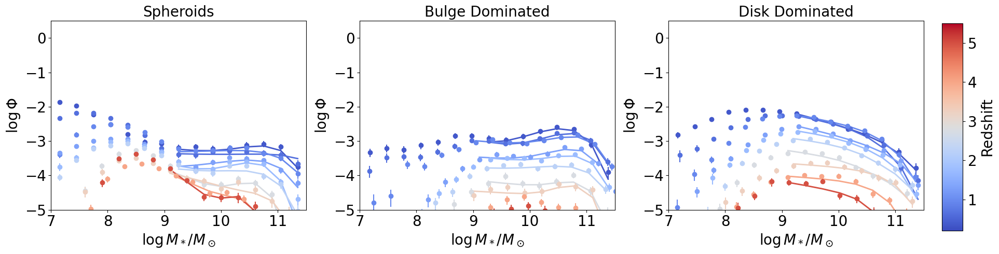

In [16]:
import matplotlib.pyplot as plt
import numpy as np
import pickle
from matplotlib.cm import coolwarm
from matplotlib.colors import Normalize
zbins =  [0.2,0.5,0.8,1.1,1.5,2,2.5,3,3.5,4.5,5.5]


def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))


# Load the observation dictionary
with open('/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph.pkl', 'rb') as file:
    smf_morph = pickle.load(file)

# Load the fit results
with open('/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results.pkl', 'rb') as file:
    fit_results = pickle.load(file)


# Morphological classes and labels
morph_class = ['sph', 'db', 'disk']
morph_labels = {'sph': 'Spheroids', 'irr': 'Peculiars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated', 'all': 'All', 'early': 'Early-Type'}


# Setup the figure
plt.figure(figsize=(20, 5))  # Adjust as needed

# Prepare colormap
zmin = min(zbins)
zmax = max(zbins)
norm = Normalize(vmin=zmin, vmax=zmax)
sm = plt.cm.ScalarMappable(cmap=coolwarm, norm=norm)
sm.set_array([])

# Loop over morphological classes and plot
for idx, cl in enumerate(morph_class):
    ax = plt.subplot(1, 3, idx + 1)
    
    for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
        zmid = (zlow + zup) / 2
        color = coolwarm(norm(zmid))

        key_logmass = (zlow, cl, 'LogMassbin')
        key_fi = (zlow, cl, 'Fi')
        key_dfi = (zlow, cl, 'dFi')

        # Plot observational data if it exists
        if key_logmass in smf_morph and key_fi in smf_morph and key_dfi in smf_morph:
            LogMassbin = smf_morph[key_logmass]
            Fi = smf_morph[key_fi]
            dFi = smf_morph[key_dfi]
            upper_errors = np.log10(Fi + dFi) - np.log10(Fi)
            lower_errors = np.log10(Fi) - np.log10(Fi - dFi)

            # Prepare error array for plotting in matplotlib
            errors = [lower_errors, upper_errors]
            valid = (Fi > 0) & (dFi > 0) & (LogMassbin<11.5) & (LogMassbin>9)

            ax.errorbar(LogMassbin, np.log10(Fi), yerr=errors, fmt='o', color=color, label=f'{zlow:.1f} < z < {zup:.1f}')

        # Plot MCMC fitted line if it exists
        if (zlow, cl) in fit_results:
            params = fit_results[(zlow, cl)]['params_50']
            logM_star_mcmc, alpha1_mcmc, alpha2_mcmc, logphi1_mcmc, logphi2_mcmc = params
            # Assuming LogMassbin is sorted and available for fitting lines
            #print(LogMassbin)
            fitted_line = np.log10(double_schechter_function(LogMassbin[valid], logM_star_mcmc, alpha1_mcmc, alpha2_mcmc, logphi1_mcmc, logphi2_mcmc))
            ax.plot(LogMassbin[valid], fitted_line, color=color, lw=2)

    ax.set_title(morph_labels.get(cl, cl), fontsize=20)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=20)
    ax.set_ylabel('$\log \Phi$', fontsize=20)
    ax.set_ylim(-5,0.5)
    ax.set_xlim(7,11.5)
    #ax.set_yscale('log')
    ax.tick_params(axis='both', which='major', labelsize=20)
    #ax.legend(fontsize=15, title="Redshift Range", title_fontsize='13')

# Adjust layout and add colorbar
plt.tight_layout(rect=[0, 0, 0.9, 1])
cbar_ax = plt.gcf().add_axes([0.91, 0.1, 0.02, 0.8])
cbar = plt.colorbar(sm, cax=cbar_ax)
cbar.set_label('Redshift', fontsize=20)
cbar.ax.tick_params(labelsize=20)

plt.savefig('/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures/SMF_hubble_types.png')
plt.show()


In [219]:
# LaTeX function to format the table entry with errors
def format_value_with_error(value, error_minus, error_plus):
    return f"${value:.2f}_{{-{error_minus:.2f}}}^{{+{error_plus:.2f}}}$"

# Function to create the LaTeX table for a given morphology
def create_latex_table(morph, params_dict, morph_labels):
    # LaTeX table header
    latex_table = r"""\begin{table}[ht]
\centering
\begin{tabular}{cccccc}
\hline
Redshift & $\log M^*$ & $\log \phi_1^*$ & $\alpha_1$ & $\log \phi_2^*$ & $\alpha_2$ \\ 
\hline
"""
    # Iterate over each redshift bin and add a row to the LaTeX table
    for zbin in sorted(params_dict.keys()):
        if morph in zbin:  # Check if the current morphology matches the bin
            # Retrieve parameters and their percentiles
            params_50 = params_dict[zbin]['params_50']
            params_16 = params_dict[zbin]['params_16']
            params_84 = params_dict[zbin]['params_84']

            # Format each parameter with the 16th and 84th percentile errors
            m_star_str = format_value_with_error(params_50[0], params_50[0] - params_16[0], params_84[0] - params_50[0])
            phi1_str = format_value_with_error(params_50[3], params_50[3] - params_16[3], params_84[3] - params_50[3])
            alpha1_str = format_value_with_error(params_50[1], params_50[1] - params_16[1], params_84[1] - params_50[1])
            phi2_str = format_value_with_error(params_50[4], params_50[4] - params_16[4], params_84[4] - params_50[4])
            alpha2_str = format_value_with_error(params_50[2], params_50[2] - params_16[2], params_84[2] - params_50[2])

            # Add the full redshift bin range instead of just the lower limit
            zrange_str = f"${zbin[0]:.2f} \leq z < {zbin[1]:.2f}$"

            # Add a row to the LaTeX table for the current redshift bin
            latex_table += f"{zrange_str} & {m_star_str} & {phi1_str} & {alpha1_str} & {phi2_str} & {alpha2_str} \\\\[0.5ex] \n"  # Extra space after the row

    # LaTeX table footer
    latex_table += r"""\hline
\end{tabular}
\caption{Fit results for """ + morph_labels[morph] + r"""}
\label{tab:""" + morph + r"""}
\end{table}
"""

    return latex_table

# Assume the params_dict and morph_labels are already defined
for morph in morph_class:
    latex_table = create_latex_table(morph, params_only_results, morph_labels)
    print(latex_table)


ValueError: Unknown format code 'f' for object of type 'str'

In [235]:
import numpy as np
from scipy.integrate import quad


morph_class=['reg','irr','disk','db','sph']
# Load the observation dictionary
with open('/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_morph_3.1_allerrors_nocompact.pkl', 'rb') as file:
    smf_morph = pickle.load(file)

# Load the fit results
with open('/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/smf_fit_results.pkl', 'rb') as file:
    fit_results = pickle.load(file)

number_densities = {morph: [] for morph in morph_class}

for zbin in zbins[:-1]:
    for morph in morph_class:
        key = (zbin, morph)
        if key in fit_results:
            params = fit_results[key]['params_50']
            logM_star, alpha1, alpha2, logphi1, logphi2 = params

            # Perform numerical integration over the mass range
            mass_min = 10  # M_sun
            mass_max = 11.5  # M_sun
            integral, _ = quad(double_schechter_function, mass_min, mass_max, args=(logM_star, alpha1, alpha2, logphi1, logphi2))
            number_densities[morph].append((zbin, integral))


In [198]:
print(number_densities['reg'])

[(0.2, 0.0054284817020754635), (0.5, 0.00348508271960308), (0.8, 0.003924032802908381), (1.1, 0.0018344638954021887), (1.5, 0.0014293027179380889), (2, 0.0007688764366393804), (2.5, 0.0003007145408711456), (3, 0.0002384434112291051), (3.5, 7.3050211274912e-05), (4.5, 3.14760648583832e-05)]


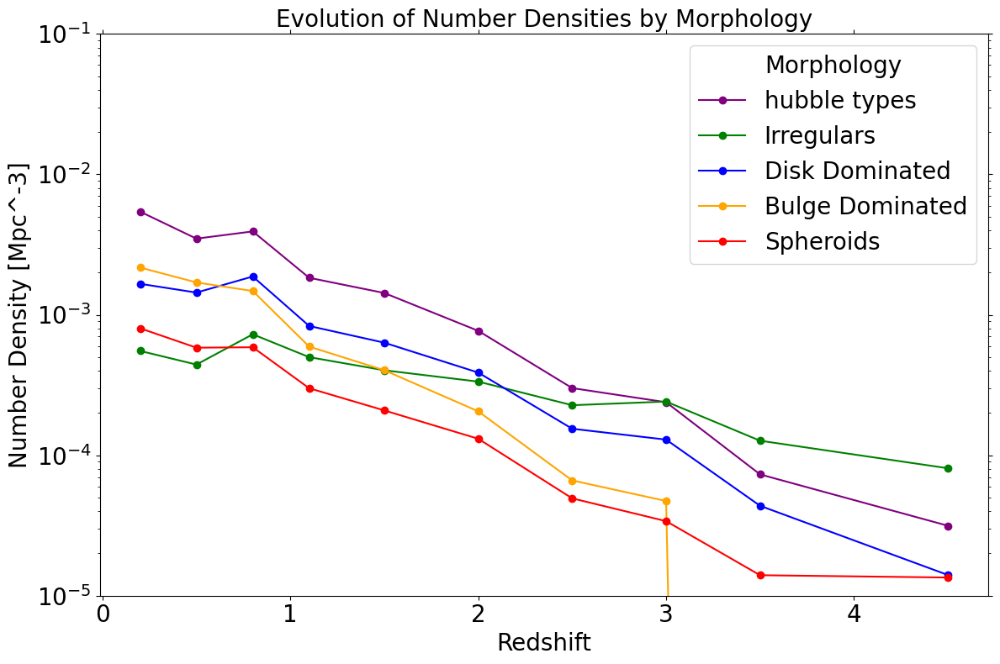

In [236]:
import matplotlib.pyplot as plt

# Setup the figure
plt.figure(figsize=(12, 8))

# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'irr': 'green',
    'disk': 'blue',
    'db': 'orange',
    'all': 'black',
    'early': 'orange',
    'sph':'red'
}

morph_labels = {'reg':'hubble types','sph': 'Spheroids', 'irr': 'Irregulars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated', 'all': 'All', 'early': 'Early-Type'}

# Loop over each morphology and plot the data
for morph, data in number_densities.items():
    if data:  # Check if there is data to plot
        redshifts, densities = zip(*data)
        plt.plot(redshifts, densities, label=morph_labels[morph], marker='o', linestyle='-', color=colors[morph])

# Set y-axis to log scale
plt.yscale('log')

# Remove grid
# plt.grid(False) is implied by absence of plt.grid()

# Set axes ticks on all sides
plt.tick_params(axis='both', which='both', labelsize=20, labeltop=False, labelright=False, top=True, right=True)

# Add labels and legend
plt.xlabel('Redshift', fontsize=20)
plt.ylabel('Number Density [Mpc^-3]', fontsize=20)
plt.title('Evolution of Number Densities by Morphology', fontsize=20)
plt.legend(title='Morphology', title_fontsize='20', fontsize=20)
plt.ylim((10e-6,10e-2))

# Show the plot
plt.tight_layout()
plt.show()




In [26]:
import h5py
import numpy as np
from scipy.integrate import quad
from scipy.stats import median_abs_deviation

morph_class=['reg','irr','all']
# Initialize a dictionary to store the results
number_densities = {morph: [] for morph in morph_class}

def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))


zbins =  [0.2,0.5,0.8,1.1,1.5,2,2.5,3,3.5,4.5,5.5]
# Process each saved HDF5 file
for zlow,zup in zip(zbins[:-1],zbins[1:]):
    for morph in morph_class:
        filename = f'/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/{zlow}_{morph}_sampler.h5'
        with h5py.File(filename, 'r') as f:
            # Load the chain and remove the burn-in period
            chain = f['chain'][7000:, :, :]  # Discard the first 3000 samples
            flat_chain = chain.reshape(-1, chain.shape[-1])  # Flatten the chain

            # Randomly select a subset of samples if the full set is too large
            indices = np.random.choice(flat_chain.shape[0], size=1000, replace=False)
            sample_subset = flat_chain[indices]

            # Compute the integrals for each sample
            integrals = []
            for sample in sample_subset:
                logM_star, alpha1, alpha2, logphi1, logphi2 = sample
                integral, _ = quad(double_schechter_function, 10, 12, args=(logM_star, alpha1, alpha2, logphi1, logphi2))
                integrals.append(integral)

            # Store the mean and standard deviation of the integrals
            mean_integral = np.median(integrals)
            #print(mean_integral)
            std_integral = median_abs_deviation(integrals, scale='normal')
            #print(std_integral)
            number_densities[morph].append(((zlow+zup)*0.5, mean_integral, std_integral))

# Here, you can now use number_densities for further analysis or plotting


/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1071/3249693418.py:7: RuntimeWarning: invalid value encountered in log10
  lower_log_error = np.log10(V) - np.log10(V - delta_down)


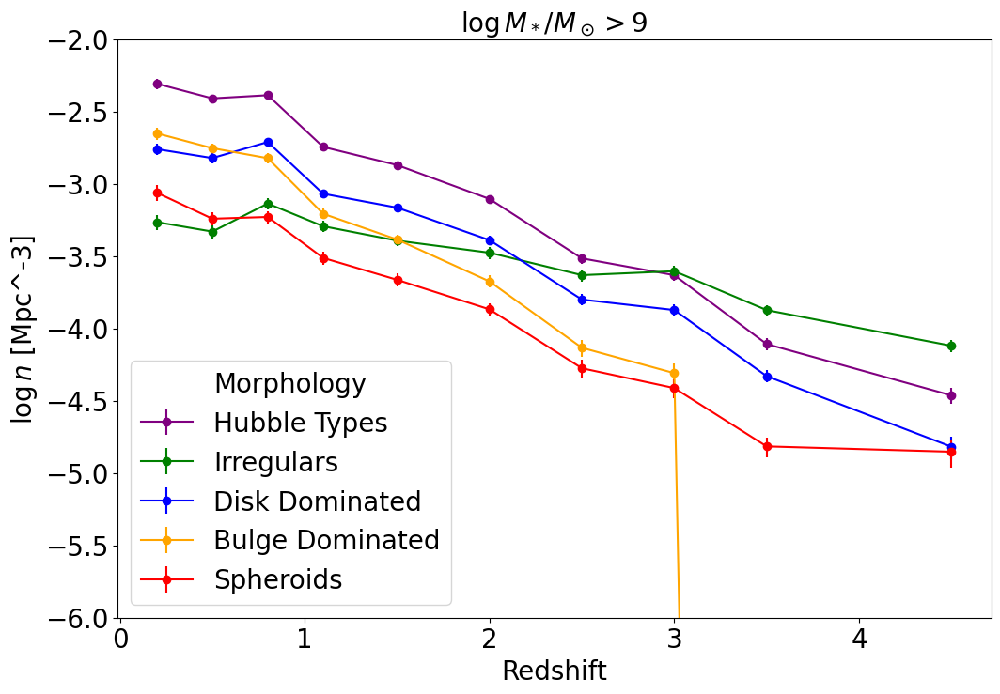

In [245]:
import matplotlib.pyplot as plt
import numpy as np

def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

plt.figure(figsize=(12, 8))

# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'irr': 'green',
    'disk': 'blue',
    'db': 'orange',
    'all': 'black',
    'early': 'orange',
    'sph':'red'
}

morph_labels = {'reg': 'Hubble Types', 'sph': 'Spheroids', 'irr': 'Irregulars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated', 'all': 'All', 'early': 'Early-Type'}

# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    redshifts = [item[0] for item in data]
    densities = [item[1] for item in data]
    errors = [item[2] for item in data]

    # Calculate log-scale errors
    log_upper_errors = []
    log_lower_errors = []
    for d, e in zip(densities, errors):
        ue, le = log_errors(d, e, e)  # symmetric errors assumed
        log_upper_errors.append(ue)
        log_lower_errors.append(le)
    
    # Asymmetric error format for errorbar()
    errors = [log_lower_errors, log_upper_errors]

    plt.errorbar(redshifts, np.log10(densities), yerr=errors, label=morph_labels.get(morph, morph), fmt='o-', color=colors[morph])

# Customize font sizes
plt.xlabel('Redshift', fontsize=20)
plt.ylabel('$\log n$ [Mpc^-3]', fontsize=20)
plt.title('$\log M_*/M_\odot>9$', fontsize=20)
plt.ylim(-6,-2)
#plt.text(.2,-3.25,'$\log M_*/M_\odot>9$',fontsize=20)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(fontsize=20, title='Morphology', title_fontsize='20')

plt.show()


/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1071/2811954077.py:7: RuntimeWarning: invalid value encountered in log10
  lower_log_error = np.log10(V) - np.log10(V - delta_down)


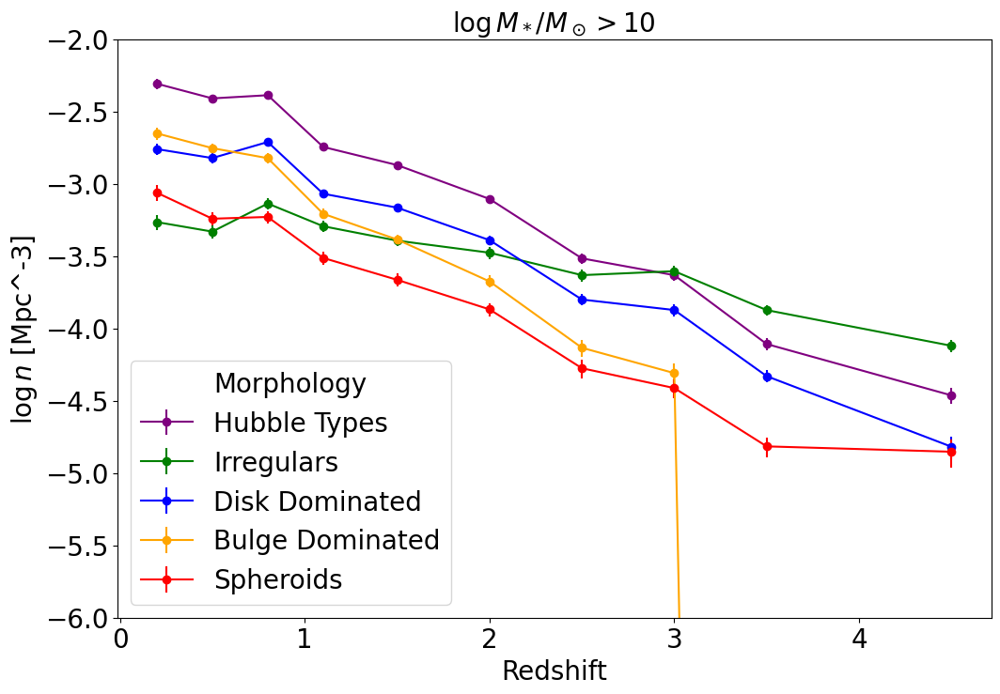

In [247]:
import matplotlib.pyplot as plt
import numpy as np

def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

plt.figure(figsize=(12, 8))



morph_labels = {'reg': 'Hubble Types', 'sph': 'Spheroids', 'irr': 'Irregulars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated', 'all': 'All', 'early': 'Early-Type'}

# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    redshifts = [item[0] for item in data]
    densities = [item[1] for item in data]
    errors = [item[2] for item in data]

    # Calculate log-scale errors
    log_upper_errors = []
    log_lower_errors = []
    for d, e in zip(densities, errors):
        ue, le = log_errors(d, e, e)  # symmetric errors assumed
        log_upper_errors.append(ue)
        log_lower_errors.append(le)
    
    # Asymmetric error format for errorbar()
    errors = [log_lower_errors, log_upper_errors]

    plt.errorbar(redshifts, np.log10(densities), yerr=errors, label=morph_labels.get(morph, morph), fmt='o-', color=colors[morph])

# Customize font sizes
plt.xlabel('Redshift', fontsize=20)
plt.ylabel('$\log n$ [Mpc^-3]', fontsize=20)
plt.title('$\log M_*/M_\odot>10$', fontsize=20)
#plt.text(.2,-3.25,'$\log M_*/M_\odot>9$',fontsize=20)
plt.ylim(-6,-2)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.legend(fontsize=20, title='Morphology', title_fontsize='20')

plt.show()


/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1071/80133634.py:9: RuntimeWarning: invalid value encountered in log10
  lower_log_error = np.log10(V) - np.log10(V - delta_down)


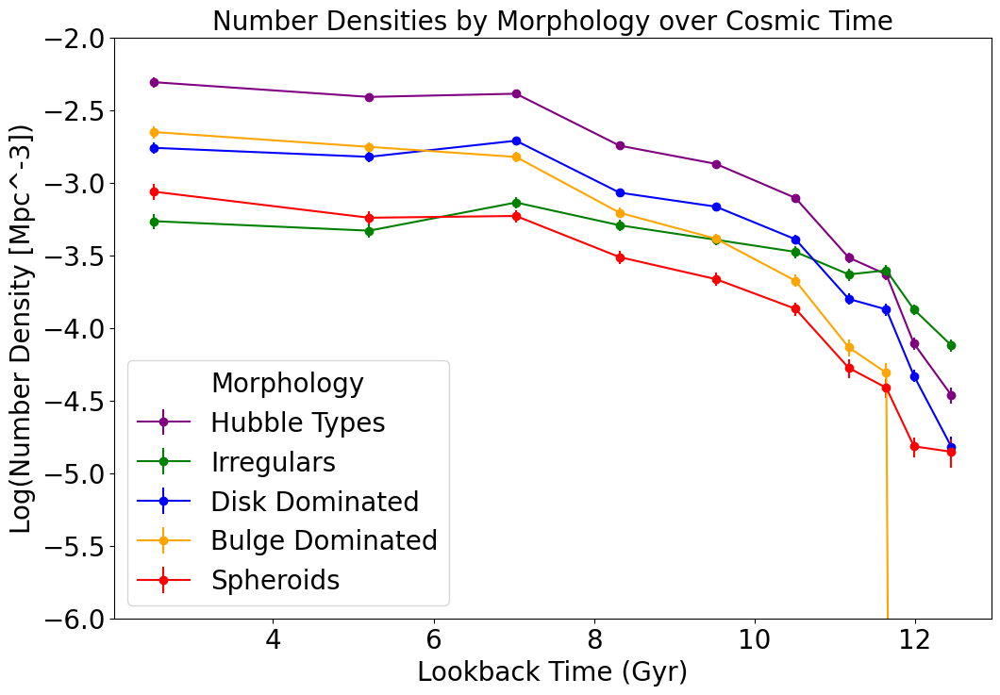

In [248]:
import matplotlib.pyplot as plt
import numpy as np
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results
from astropy import units as u

def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

plt.figure(figsize=(12, 8))



morph_labels = {'reg': 'Hubble Types', 'sph': 'Spheroids', 'irr': 'Irregulars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated', 'all': 'All', 'early': 'Early-Type'}

# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    redshifts = np.array([item[0] for item in data])
    lookback_times = cosmo.lookback_time(redshifts).value  # Convert redshift to lookback time in Gyr
    
    densities = np.array([item[1] for item in data])
    errors = np.array([item[2] for item in data])

    # Calculate log-scale errors
    log_upper_errors, log_lower_errors = log_errors(densities, errors, errors)
    
    # Plotting
    plt.errorbar(lookback_times, np.log10(densities), yerr=[log_lower_errors, log_upper_errors],
                 label=morph_labels.get(morph, morph), fmt='o-', color=colors[morph])

# Plot settings
plt.xlabel('Lookback Time (Gyr)', fontsize=20)
plt.ylabel('Log(Number Density [Mpc^-3])', fontsize=20)
plt.title('Number Densities by Morphology over Cosmic Time', fontsize=20)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.ylim(-6,-2)
plt.legend(fontsize=20, title='Morphology', title_fontsize='20')

plt.show()


In [206]:
smf_fit_params = {
    # ALL morphology
    ('ALL', '0.2-0.5'): {
        'means': [10.86, -0.82, -1.60, 2.22, 0.45],
        'stds': [0.10, 0.24, 0.00, 0.59, 0.15],
        'use_double_schechter': True,
    },
    ('ALL', '0.5-0.8'): {
        'means': [10.86, -0.82, -1.60, 2.22, 0.45],
        'stds': [0.10, 0.24, 0.00, 0.59, 0.15],
        'use_double_schechter': True,
    },
    ('ALL', '0.8-1.1'): {
        'means': [11.03, -1.25, -99.00, 1.33, -99.00],
        'stds': [0.05, 0.05, 0.00, 0.59, 0.00],
        'use_double_schechter': False,
    },
    ('ALL', '1.1-1.5'): {
        'means': [10.97, -1.20, -99.00, 0.94, -99.00],
        'stds': [0.05, 0.06, 0.00, 0.59, 0.00],
        'use_double_schechter': False,
    },
    ('ALL', '1.5-2'): {
        'means': [10.89, -0.88, -99.00, 1.22, -99.00],
        'stds': [0.06, 0.13, 0.00, 0.59, 0.00],
        'use_double_schechter': False,
    },
    ('ALL', '2-2.5'): {
        'means': [11.05, -1.19, -99.00, 0.41, -99.00],
        'stds': [0.16, 0.26, 0.00, 0.59, 0.00],
        'use_double_schechter': False,
    },
    ('ALL', '2.5-3'): {
        'means': [10.90, -0.74, -99.00, 0.34, -99.00],
        'stds': [0.18, 0.58, 0.00, 0.59, 0.00],
        'use_double_schechter': False,
    },
    # SPH morphology
    ('SPH', '0.2-0.5'): {
        'means': [10.59, -0.25, -1.60, 0.75, 0.07],
        'stds': [0.26, 0.45, 0.00, 0.24, 0.03],
        'use_double_schechter': True,
    },
    ('SPH', '0.5-0.8'): {
        'means': [10.89, -0.51, -1.60, 0.91, 0.06],
        'stds': [0.10, 0.21, 0.00, 0.18, 0.02],
        'use_double_schechter': True,
    },
    ('SPH', '0.8-1.1'): {
        'means': [11.01, -1.00, -99.00, 0.48, -99.00],
        'stds': [0.08, 0.07, 0.00, 0.09, 0.00],
        'use_double_schechter': False,
    },
    ('SPH', '1.1-1.5'): {
        'means': [10.80, -0.78, -99.00, 0.46, -99.00],
        'stds': [0.08, 0.11, 0.00, 0.08, 0.00],
        'use_double_schechter': False,
    },
    ('SPH', '1.5-2'): {
        'means': [10.52, 0.24, -99.00, 0.59, -99.00],
        'stds': [0.08, 0.27, 0.00, 0.04, 0.00],
        'use_double_schechter': False,
    },
    ('SPH', '2-2.5'): {
        'means': [10.76, -0.26, -99.00, 0.23, -99.00],
        'stds': [0.17, 0.46, 0.00, 0.05, 0.00],
        'use_double_schechter': False,
    },
    ('SPH', '2.5-3'): {
        'means': [10.45, 0.74, -99.00, 0.09, -99.00],
        'stds': [0.19, 0.93, 0.00, 0.04, 0.00],
        'use_double_schechter': False,
    },
}

smf_fit_params.update({
    ('DISK+SPH', '0.2-0.5'): {
        'means': [10.31, 0.00, -0.78, 0.93, 0.64],
        'stds': [0.10, 0.00, 0.20, 0.77, 0.53],
        'use_double_schechter': True,
    },
    ('DISK+SPH', '0.5-0.8'): {
        'means': [10.63, -0.49, -99.00, 1.27, -99.00],
        'stds': [0.05, 0.07, 0.00, 0.15, 0.00],
        'use_double_schechter': False,
    },
    ('DISK+SPH', '0.8-1.1'): {
        'means': [10.73, -0.47, -99.00, 0.67, -99.00],
        'stds': [0.06, 0.10, 0.00, 0.09, 0.00],
        'use_double_schechter': False,
    },
    ('DISK+SPH', '1.1-1.5'): {
        'means': [10.77, -0.35, -99.00, 0.29, -99.00],
        'stds': [0.08, 0.14, 0.00, 0.04, 0.00],
        'use_double_schechter': False,
    },
    ('DISK+SPH', '1.5-2'): {
        'means': [10.77, 0.12, -99.00, 0.16, -99.00],
        'stds': [0.12, 0.34, 0.00, 0.02, 0.00],
        'use_double_schechter': False,
    },
    ('DISK+SPH', '2-2.5'): {
        'means': [10.73, 0.16, -99.00, 0.04, -99.00],
        'stds': [0.26, 0.91, 0.00, 0.01, 0.00],
        'use_double_schechter': False,
    },
    ('DISK+SPH', '2.5-3'): {
        'means': [99.00, 99.00, -99.00, 99.00, -99.00],
        'stds': [0.00, 0.00, 0.00, 0.00, 0.00],
        'use_double_schechter': False,  # Adjust if needed, -99 usually means not applicable
    }
})


smf_fit_params.update({
    ('DISKS', '0.2-0.5'): {
        'means': [10.25, 0.00, -1.12, 0.09, 1.48],
        'stds': [1.97, 0.00, 0.05, 6.56, 1.03],
        'use_double_schechter': True,
    },
    ('DISKS', '0.5-0.8'): {
        'means': [10.56, -1.15, -99.00, 1.04, -99.00],
        'stds': [0.06, 0.05, 0.00, 0.17, 0.00],
        'use_double_schechter': False,
    },
    ('DISKS', '0.8-1.1'): {
        'means': [10.80, -1.20, -99.00, 0.51, -99.00],
        'stds': [0.08, 0.07, 0.00, 0.11, 0.00],
        'use_double_schechter': False,
    },
    ('DISKS', '1.1-1.5'): {
        'means': [10.98, -1.27, -99.00, 0.15, -99.00],
        'stds': [0.10, 0.09, 0.00, 0.04, 0.00],
        'use_double_schechter': False,
    },
    ('DISKS', '1.5-2'): {
        'means': [10.85, -0.97, -99.00, 0.13, -99.00],
        'stds': [0.16, 0.28, 0.00, 0.06, 0.00],
        'use_double_schechter': False,
    },
    ('DISKS', '2-2.5'): {
        'means': [11.11, -0.97, -99.00, 0.03, -99.00],
        'stds': [0.29, 0.55, 0.00, 0.02, 0.00],
        'use_double_schechter': False,
    },
    ('DISKS', '2.5-3'): {
        'means': [11.42, -1.01, -99.00, 0.01, -99.00],
        'stds': [0.85, 0.80, 0.00, 0.01, 0.00],
        'use_double_schechter': False,
    }
})

smf_fit_params.update({
    ('IRREGULARS', '0.2-0.5'): {
        'means': [9.87, 0.00, -1.60, 0.16, 0.76],
        'stds': [0.43, 0.00, 0.00, 0.70, 0.51],
        'use_double_schechter': True,
    },
    ('IRREGULARS', '0.5-0.8'): {
        'means': [10.45, 0.00, -1.66, 0.04, 0.33],
        'stds': [0.83, 0.00, 0.16, 0.43, 0.60],
        'use_double_schechter': True,
    },
    ('IRREGULARS', '0.8-1.1'): {
        'means': [10.72, -1.62, -99.00, 0.26, -99.00],
        'stds': [0.11, 0.09, 0.00, 0.70, 0.00],
        'use_double_schechter': False,
    },
    ('IRREGULARS', '1.1-1.5'): {
        'means': [10.91, -1.60, -99.00, 0.17, -99.00],
        'stds': [0.13, 0.09, 0.00, 0.70, 0.00],
        'use_double_schechter': False,
    },
    ('IRREGULARS', '1.5-2'): {
        'means': [10.91, -1.39, -99.00, 0.28, -99.00],
        'stds': [0.11, 0.17, 0.00, 0.70, 0.00],
        'use_double_schechter': False,
    },
    ('IRREGULARS', '2-2.5'): {
        'means': [10.86, -1.39, -99.00, 0.23, -99.00],
        'stds': [0.08, 0.00, 0.00, 0.70, 0.00],
        'use_double_schechter': False,
    },
    ('IRREGULARS', '2.5-3'): {
        'means': [11.09, -1.35, -99.00, 0.09, -99.00],
        'stds': [0.32, 0.46, 0.00, 0.70, 0.00],
        'use_double_schechter': False,
    }
})




reg
[0.2, 0.5, 0.8, 1.1, 1.5, 2, 2.5, 3, 3.5, 4.5]
[0.0036326859327181537, 0.0025357435314231685, 0.002594308300005722, 0.00163565631660968, 0.001128184295824217, 0.0005444528493526819, 0.0002528494469441026, 0.00018331981635678066, 5.4783323814542556e-05, 1.7374041388775248e-17]


/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_88332/2544764917.py:79: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "o-" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(np.array(zs)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')


IndexError: tuple index out of range

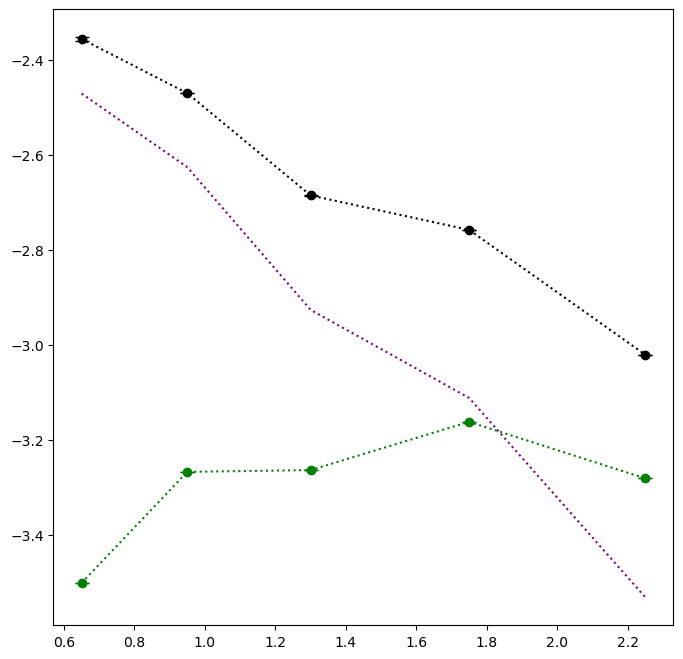

In [266]:
import numpy as np
from scipy.integrate import quad
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D  # Import Line2D
from scipy.stats import median_abs_deviation



# Define the single and double Schechter functions
def single_schechter_function(logM, logM_star, alpha, log_phi_star):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**log_phi_star
    return np.log(10)*phi_star * (M/M_star)**(alpha+1) * np.exp(-M/M_star) 


def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))

# Integrate the Schechter functions
def integrate_schechter(params, use_double, z_range):
    mass_range = np.linspace(10, 12, 400)  # from logM 8 to 12
    if use_double:
        mean_params = [params['means'][0], params['means'][1], params['means'][2],np.log10(params['means'][3]*1e-3),np.log10(params['means'][4]*1e-3)]#params['means'][:5]  # logM*, alpha1, alpha2, phi1*, phi2*
    else:
        mean_params = [params['means'][0], params['means'][1], np.log10(params['means'][3]*1e-3)]  # logM*, alpha1, phi1*
        
    cov_matrix = np.diag(np.array(params['stds'])[:len(mean_params)]**2)
    samples = multivariate_normal.rvs(mean=mean_params, cov=cov_matrix, size=1000)
    
    densities = []
    for sample in samples:
        if use_double:
            density = quad(double_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
            #print(density)
        else:
            density = quad(single_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
        densities.append(density)
    

   
    return np.median(densities), median_abs_deviation(densities, scale='normal')

# Compute number densities for all morphologies
pub_morphologies = ['ALL','SPH', 'DISK+SPH', 'DISKS', 'IRREGULARS']
plot_morphologies = ['ALL','IRREGULARS']
labels=['All','Spheroids','Bulge Dominated','Disk Dominated','Irregulars']
# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'IRREGULARS': 'green',
    'DISKS': 'blue',
    'DISK+SPH': 'orange',
    'ALL': 'black',
    'early': 'orange',
    'SPH':'red'
}
number_densities_hubble = {morph: [] for morph in pub_morphologies}
z_values = []
#print((float(z_range.split('-')[0])+float(z_range.split('-')[1])*0.5))
for (morph, z_range), params in smf_fit_params.items():
    mean_density, std_density = integrate_schechter(params, params['use_double_schechter'], z_range)
    #print(float(z_range.split('-')[1]))
    number_densities_hubble[morph].append(((float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5, mean_density, std_density))  # Using upper z for simplicity
    #if float(z_range.split('-')[1]) not in z_values:
    #    z_values.append(float(z_range.split('-')[1]))

# Plot number densities vs. redshift
plt.figure(figsize=(8, 8))
for morph,label in zip(plot_morphologies,labels):
    zs = [data[0] for data in number_densities_hubble[morph]]
    #print(zs)
    densities = [data[1] for data in number_densities_hubble[morph]]
    errors = [data[2] for data in number_densities_hubble[morph]]
    valid=(np.array(zs)>0.5) &(np.array(zs)<2.5)
    plt.errorbar(np.array(zs)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')

densities = np.array(densities)*0.0
for morph in ['DISKS','SPH','DISK+SPH']:
    dens_type = [data[1] for data in number_densities_hubble[morph]] 
    densities+=dens_type
#print(densities)
plt.plot(np.array(zs)[valid],np.log10(np.array(densities)[valid]),c=colors['reg'],ls=':')



def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

#plt.figure(figsize=(12, 8))

# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'irr': 'green',
    'disk': 'blue',
    'db': 'orange',
    'all': 'black',
    'early': 'orange',
    'sph':'red'
}

morph_labels = {'reg': 'Hubble Types', 'sph': 'Spheroids', 'irr': 'Irregulars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated', 'all': 'All', 'early': 'Early-Type'}

# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    print(morph)
    redshifts = [item[0] for item in data]
    print(redshifts)
    densities = [item[1] for item in data]
    print(densities)
    
    errors = [item[2] for item in data]

    # Calculate log-scale errors
    log_upper_errors = []
    log_lower_errors = []
    for d, e in zip(densities, errors):
        ue, le = log_errors(d, e, e)  # symmetric errors assumed
        log_upper_errors.append(ue)
        log_lower_errors.append(le)
    
    # Asymmetric error format for errorbar()
    errors = [log_lower_errors, log_upper_errors]

    plt.errorbar(redshifts, np.log10(densities), yerr=errors, label=morph_labels.get(morph, morph), fmt='o-', color=colors[morph],lw=3)
    print(np.log10(densities))

custom_lines = [
    Line2D([0], [0], color='black', lw=4, linestyle=':'),
    Line2D([0], [0], color='black', lw=4)
]

legend1=plt.legend(custom_lines, ['HST', 'JWST'], title='Observations', title_fontsize='20', fontsize=20)

plt.legend(title='Morphologies', loc='lower left', fontsize=20, title_fontsize=20)

plt.gca().add_artist(legend1)

# Customize font sizes
plt.xlabel('Redshift', fontsize=20)
plt.ylabel('$\log n$ [Mpc^-3]', fontsize=20)
plt.title('$\log M_*/M_\odot>10$', fontsize=20)
#plt.text(.2,-3.25,'$\log M_*/M_\odot>9$',fontsize=20)
plt.ylim(-5,-2)
plt.xlim(0,5)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)


plt.show()


/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/331590287.py:84: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "o-" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(np.array(lb)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')


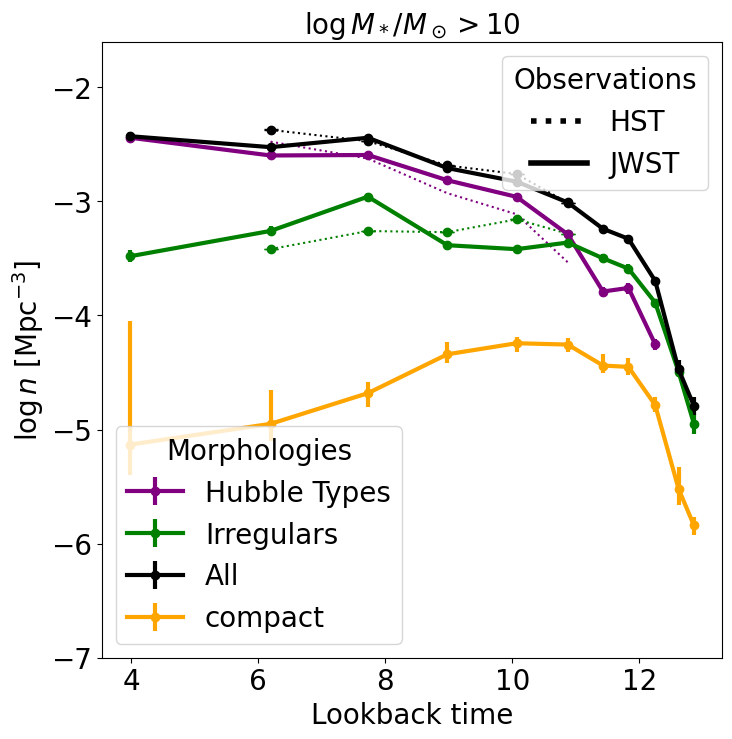

In [267]:
import numpy as np
from scipy.integrate import quad
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D  # Import Line2D
from scipy.stats import median_abs_deviation
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results



# Define the single and double Schechter functions
def single_schechter_function(logM, logM_star, alpha, log_phi_star):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**log_phi_star
    return np.log(10)*phi_star * (M/M_star)**(alpha+1) * np.exp(-M/M_star) 


def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))

# Integrate the Schechter functions
def integrate_schechter(params, use_double, z_range):
    mass_range = np.linspace(10, 12, 400)  # from logM 8 to 12
    if use_double:
        mean_params = [params['means'][0], params['means'][1], params['means'][2],np.log10(params['means'][3]*1e-3),np.log10(params['means'][4]*1e-3)]#params['means'][:5]  # logM*, alpha1, alpha2, phi1*, phi2*
    else:
        mean_params = [params['means'][0], params['means'][1], np.log10(params['means'][3]*1e-3)]  # logM*, alpha1, phi1*
        
    cov_matrix = np.diag(np.array(params['stds'])[:len(mean_params)]**2)
    samples = multivariate_normal.rvs(mean=mean_params, cov=cov_matrix, size=1000)
    
    densities = []
    for sample in samples:
        if use_double:
            density = quad(double_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
            #print(density)
        else:
            density = quad(single_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
        densities.append(density)
    

   
    return np.median(densities), median_abs_deviation(densities, scale='normal')

# Compute number densities for all morphologies
pub_morphologies = ['ALL','SPH', 'DISK+SPH', 'DISKS', 'IRREGULARS']
plot_morphologies = ['ALL','IRREGULARS']
labels=['All','Spheroids','Bulge Dominated','Disk Dominated','Irregulars']
# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'IRREGULARS': 'green',
    'DISKS': 'blue',
    'DISK+SPH': 'orange',
    'ALL': 'black',
    'early': 'orange',
    'SPH':'red'
}
number_densities_hubble = {morph: [] for morph in pub_morphologies}
z_values = []
#print((float(z_range.split('-')[0])+float(z_range.split('-')[1])*0.5))
for (morph, z_range), params in smf_fit_params.items():
    mean_density, std_density = integrate_schechter(params, params['use_double_schechter'], z_range)
    #print(float(z_range.split('-')[1]))
    z_mean = (float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5
    lookback_time = cosmo.lookback_time(z_mean).value  # Get lookback time in Gyr
    number_densities_hubble[morph].append((lookback_time, mean_density, std_density,z_mean))
    #number_densities_hubble[morph].append(((float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5, mean_density, std_density))  # Using upper z for simplicity
    #if float(z_range.split('-')[1]) not in z_values:
    #    z_values.append(float(z_range.split('-')[1]))

# Plot number densities vs. redshift
plt.figure(figsize=(8, 8))
for morph,label in zip(plot_morphologies,labels):
    lb = [data[0] for data in number_densities_hubble[morph]]
    zs = [data[3] for data in number_densities_hubble[morph]]
    #print(zs)
    densities = [data[1] for data in number_densities_hubble[morph]]
    errors = [data[2] for data in number_densities_hubble[morph]]
    valid=(np.array(zs)>0.5) &(np.array(zs)<2.5)
    plt.errorbar(np.array(lb)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')

densities = np.array(densities)*0.0
for morph in ['DISKS','SPH','DISK+SPH']:
    dens_type = [data[1] for data in number_densities_hubble[morph]] 
    densities+=dens_type
#print(densities)
plt.plot(np.array(lb)[valid],np.log10(np.array(densities)[valid]),c=colors['reg'],ls=':')



def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

#plt.figure(figsize=(12, 8))

# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'irr': 'green',
    'disk': 'blue',
    'db': 'orange',
    'all': 'black',
    'early': 'orange',
    'sph':'red',
    'comp':'orange'
    
}

morph_labels = {'reg': 'Hubble Types', 'irr': 'Irregulars','comp':'compact','all':'all'}

morph_labels = {'reg': 'Hubble Types', 'irr': 'Irregulars','comp':'compact','all':'All','sph':'Spheroids','disk':"Disks",'db':"Bulge+Disk"}
number_densities_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/number_densities_with_errors_nocompphys.pkl'

with open(number_densities_path,'rb') as f:
    number_densities = pickle.load(f)

# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    
    redshifts = [item[0] for item in data]
    lookback_time = cosmo.lookback_time(redshifts).value
    densities = [item[1] for item in data]
    ue = [item[2] for item in data]
    le = [item[3] for item in data]

    # Calculate log-scale errors
    log_upper_errors = []
    log_lower_errors = []
    for d, lev,uev in zip(densities, le,ue):
        ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
        log_upper_errors.append(upe)
        log_lower_errors.append(ule)
    
    # Asymmetric error format for errorbar()
    errors = [log_lower_errors, log_upper_errors]
    #errors
    if (morph=='reg') or (morph=='irr') or (morph=='comp') or (morph=='all'): 
        plt.errorbar(lookback_time, np.log10(densities), yerr=errors, label=morph_labels.get(morph, morph), fmt='o-', color=colors[morph],lw=3)
        #plt.scatter(lookback_time, np.log10(densities), label=morph_labels.get(morph, morph), color=colors[morph],lw=3)
custom_lines = [
    Line2D([0], [0], color='black', lw=4, linestyle=':'),
    Line2D([0], [0], color='black', lw=4)
]

legend1=plt.legend(custom_lines, ['HST', 'JWST'], title='Observations', title_fontsize='20', fontsize=20,loc='upper right')

plt.legend(title='Morphologies', loc='lower left', fontsize=20, title_fontsize=20)

plt.gca().add_artist(legend1)

# Customize font sizes
plt.xlabel('Lookback time', fontsize=20)
plt.ylabel('$\log n$ [Mpc$^{-3}$]', fontsize=20)
plt.title('$\log M_*/M_\odot>10$', fontsize=20)
#plt.text(.2,-3.25,'$\log M_*/M_\odot>9$',fontsize=20)
plt.ylim(-7,-1.6)
#plt.xlim(0,5)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

#plt.savefig('/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures/number_densities_hubble_peculiar.png')

plt.show()


reg [0.0036176403365729406, 0.002527912889765842, 0.0025530103654326382, 0.0015331492687120356, 0.0010970354053453633, 0.0005149125966657294, 0.0001622630617186372, 0.00017440021929833818, 5.596402378129268e-05]
irr [0.00033079690310340245, 0.0005514875085696686, 0.001100866749941533, 0.0004132519473534041, 0.00038137746615219304, 0.0004359719441076633, 0.00031710131561955726, 0.0002575600560923235, 0.0001296711415644392, 3.219572379441265e-05, 1.1271125263180238e-05]
all [0.0037282933087875577, 0.002990504957281713, 0.0036152772789909003, 0.0019606135939157915, 0.001490887472866073, 0.000979645427272385, 0.0005753060038801885, 0.0004704337871204555, 0.00020110394786321728, 3.3805859389969675e-05, 1.620599358034258e-05]
comp [7.390094568982948e-06, 1.1219605536584808e-05, 2.085016162919424e-05, 4.571360172134559e-05, 5.7138772198847136e-05, 5.561514011892581e-05, 3.6417181711132076e-05, 3.544260561025306e-05, 1.6389629109157226e-05, 3.0310611405487077e-06, 1.4469637125305873e-06]


/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/2883960881.py:84: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "o-" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(np.array(zs)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')


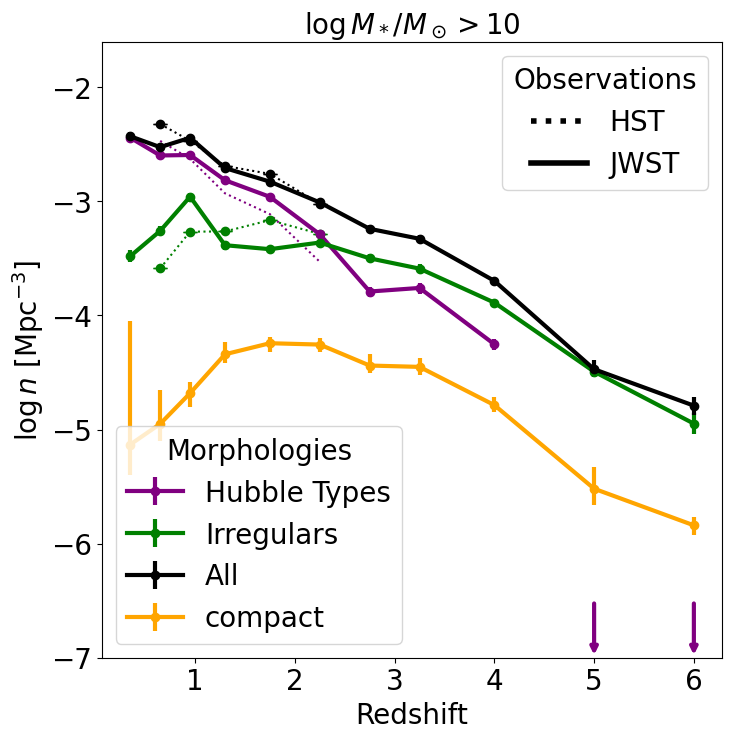

In [322]:
import numpy as np
from scipy.integrate import quad
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D  # Import Line2D
from scipy.stats import median_abs_deviation
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results



# Define the single and double Schechter functions
def single_schechter_function(logM, logM_star, alpha, log_phi_star):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**log_phi_star
    return np.log(10)*phi_star * (M/M_star)**(alpha+1) * np.exp(-M/M_star) 


def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))

# Integrate the Schechter functions
def integrate_schechter(params, use_double, z_range):
    mass_range = np.linspace(10, 12, 400)  # from logM 8 to 12
    if use_double:
        mean_params = [params['means'][0], params['means'][1], params['means'][2],np.log10(params['means'][3]*1e-3),np.log10(params['means'][4]*1e-3)]#params['means'][:5]  # logM*, alpha1, alpha2, phi1*, phi2*
    else:
        mean_params = [params['means'][0], params['means'][1], np.log10(params['means'][3]*1e-3)]  # logM*, alpha1, phi1*
        
    cov_matrix = np.diag(np.array(params['stds'])[:len(mean_params)]**2)
    samples = multivariate_normal.rvs(mean=mean_params, cov=cov_matrix, size=1000)
    
    densities = []
    for sample in samples:
        if use_double:
            density = quad(double_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
            #print(density)
        else:
            density = quad(single_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
        densities.append(density)
    

   
    return np.median(densities), median_abs_deviation(densities, scale='normal')

# Compute number densities for all morphologies
pub_morphologies = ['ALL','SPH', 'DISK+SPH', 'DISKS', 'IRREGULARS']
plot_morphologies = ['ALL','IRREGULARS']
labels=['All','Spheroids','Bulge Dominated','Disk Dominated','Irregulars']
# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'IRREGULARS': 'green',
    'DISKS': 'blue',
    'DISK+SPH': 'orange',
    'ALL': 'black',
    'early': 'orange',
    'SPH':'red'
}
number_densities_hubble = {morph: [] for morph in pub_morphologies}
z_values = []
#print((float(z_range.split('-')[0])+float(z_range.split('-')[1])*0.5))
for (morph, z_range), params in smf_fit_params.items():
    mean_density, std_density = integrate_schechter(params, params['use_double_schechter'], z_range)
    #print(float(z_range.split('-')[1]))
    z_mean = (float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5
    lookback_time = cosmo.lookback_time(z_mean).value  # Get lookback time in Gyr
    number_densities_hubble[morph].append((lookback_time, mean_density, std_density,z_mean))
    #number_densities_hubble[morph].append(((float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5, mean_density, std_density))  # Using upper z for simplicity
    #if float(z_range.split('-')[1]) not in z_values:
    #    z_values.append(float(z_range.split('-')[1]))

# Plot number densities vs. redshift
plt.figure(figsize=(8, 8))
for morph,label in zip(plot_morphologies,labels):
    lb = [data[0] for data in number_densities_hubble[morph]]
    zs = [data[3] for data in number_densities_hubble[morph]]
    #print(zs)
    densities = [data[1] for data in number_densities_hubble[morph]]
    errors = [data[2] for data in number_densities_hubble[morph]]
    valid=(np.array(zs)>0.5) &(np.array(zs)<2.5)
    plt.errorbar(np.array(zs)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')

densities = np.array(densities)*0.0
for morph in ['DISKS','SPH','DISK+SPH']:
    dens_type = [data[1] for data in number_densities_hubble[morph]] 
    densities+=dens_type
#print(densities)
plt.plot(np.array(zs)[valid],np.log10(np.array(densities)[valid]),c=colors['reg'],ls=':')



def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

#plt.figure(figsize=(12, 8))

# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'irr': 'green',
    'disk': 'blue',
    'db': 'orange',
    'all': 'black',
    'early': 'orange',
    'sph':'red',
    'comp':'orange'
    
}

morph_labels = {'reg': 'Hubble Types', 'irr': 'Irregulars','comp':'compact','all':'all'}
morph_labels = {'reg': 'Hubble Types', 'irr': 'Irregulars','comp':'compact','all':'All','sph':'Spheroids','disk':"Disks",'db':"Bulge+Disk"}
number_densities_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/number_densities_with_errors_nocompphys.pkl'

with open(number_densities_path,'rb') as f:
    number_densities = pickle.load(f)

# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    
    redshifts = [item[0] for item in data]
    lookback_time = cosmo.lookback_time(redshifts).value
    densities = [item[1] for item in data]
    ue = [item[2] for item in data]
    le = [item[3] for item in data]

    # Calculate log-scale errors
    log_upper_errors = []
    log_lower_errors = []
    for d, lev,uev in zip(densities, le,ue):
        ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
        log_upper_errors.append(upe)
        log_lower_errors.append(ule)
    
    # Asymmetric error format for errorbar()
    errors = [log_lower_errors, log_upper_errors]
    #errors
    if (morph=='reg') or (morph=='irr') or (morph=='comp') or (morph=='all'): 
        plt.errorbar(redshifts, np.log10(densities), yerr=errors, label=morph_labels.get(morph, morph), fmt='o-', color=colors[morph],lw=3)
        print(morph,densities)
        #plt.scatter(lookback_time, np.log10(densities), label=morph_labels.get(morph, morph), color=colors[morph],lw=3)

plt.annotate(
    '',  # No text
    xy=(np.array([5]), np.array([-6.5]) - 0.5),  # Arrow end point
    xytext=(np.array([5]), np.array([-6.5])),    # Arrow start point
    arrowprops=dict(arrowstyle='-|>', color='purple', lw=3),
)


plt.annotate(
    '',  # No text
    xy=(np.array([6]), np.array([-6.5]) - 0.5),  # Arrow end point
    xytext=(np.array([6]), np.array([-6.5])),    # Arrow start point
    arrowprops=dict(arrowstyle='-|>', color='purple', lw=3),
)

custom_lines = [
    Line2D([0], [0], color='black', lw=4, linestyle=':'),
    Line2D([0], [0], color='black', lw=4)
]

legend1=plt.legend(custom_lines, ['HST', 'JWST'], title='Observations', title_fontsize='20', fontsize=20,loc='upper right')

plt.legend(title='Morphologies', loc='lower left', fontsize=20, title_fontsize=20)

plt.gca().add_artist(legend1)

# Customize font sizes
plt.xlabel('Redshift', fontsize=20)
plt.ylabel('$\log n$ [Mpc$^{-3}$]', fontsize=20)
plt.title('$\log M_*/M_\odot>10$', fontsize=20)
#plt.text(.2,-3.25,'$\log M_*/M_\odot>9$',fontsize=20)
plt.ylim(-7,-1.6)
#plt.xlim(0,5)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

plt.savefig('/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures/number_densities_hubble_peculiar.png')

plt.show()


irr [0.00033079690310340245, 0.0005514875085696686, 0.001100866749941533, 0.0004132519473534041, 0.00038137746615219304, 0.0004359719441076633, 0.00031710131561955726, 0.0002575600560923235, 0.0001296711415644392, 3.219572379441265e-05, 1.1271125263180238e-05]
disk [0.0011812544686973792, 0.0009437393973770947, 0.0009151728147768401, 0.00037159667080488616, 0.0002820703278532947, 0.00016394947254395892, 7.902147915098796e-05, 0.0001021686082144349, 3.862197065927355e-05]
db [0.002005170100837661, 0.001292701321926821, 0.0012338441213560162, 0.0005343892261190945, 0.00034683809248428144, 0.00015197224265203307, 6.062016874914628e-05, 3.423129564495987e-05]
sph [0.0005163973354996396, 0.00027447605372911415, 0.00039874616350252267, 0.0003564232226882128, 0.00023569860803592698, 0.00010721537551655413, 5.930826539814538e-05, 3.6781496463824084e-05, 5.326102790624887e-06]
all [0.0037282933087875577, 0.002990504957281713, 0.0036152772789909003, 0.0019606135939157915, 0.001490887472866073, 0

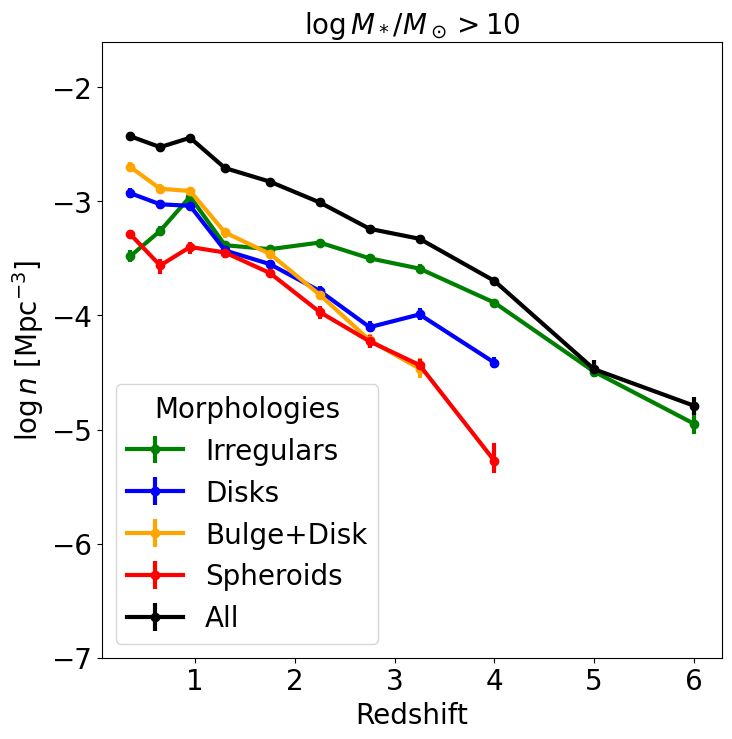

In [321]:
import numpy as np
from scipy.integrate import quad
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D  # Import Line2D
from scipy.stats import median_abs_deviation
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results



# Define the single and double Schechter functions
def single_schechter_function(logM, logM_star, alpha, log_phi_star):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**log_phi_star
    return np.log(10)*phi_star * (M/M_star)**(alpha+1) * np.exp(-M/M_star) 


def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))

# Integrate the Schechter functions
def integrate_schechter(params, use_double, z_range):
    mass_range = np.linspace(10, 12, 400)  # from logM 8 to 12
    if use_double:
        mean_params = [params['means'][0], params['means'][1], params['means'][2],np.log10(params['means'][3]*1e-3),np.log10(params['means'][4]*1e-3)]#params['means'][:5]  # logM*, alpha1, alpha2, phi1*, phi2*
    else:
        mean_params = [params['means'][0], params['means'][1], np.log10(params['means'][3]*1e-3)]  # logM*, alpha1, phi1*
        
    cov_matrix = np.diag(np.array(params['stds'])[:len(mean_params)]**2)
    samples = multivariate_normal.rvs(mean=mean_params, cov=cov_matrix, size=1000)
    
    densities = []
    for sample in samples:
        if use_double:
            density = quad(double_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
            #print(density)
        else:
            density = quad(single_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
        densities.append(density)
    

   
    return np.median(densities), median_abs_deviation(densities, scale='normal')

# Compute number densities for all morphologies
pub_morphologies = ['ALL','SPH', 'DISK+SPH', 'DISKS', 'IRREGULARS']
plot_morphologies = ['ALL','IRREGULARS']
labels=['All','Spheroids','Bulge Dominated','Disk Dominated','Irregulars']
# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'IRREGULARS': 'green',
    'DISKS': 'blue',
    'DISK+SPH': 'orange',
    'ALL': 'black',
    'early': 'orange',
    'SPH':'red'
}
number_densities_hubble = {morph: [] for morph in pub_morphologies}
z_values = []
#print((float(z_range.split('-')[0])+float(z_range.split('-')[1])*0.5))
for (morph, z_range), params in smf_fit_params.items():
    mean_density, std_density = integrate_schechter(params, params['use_double_schechter'], z_range)
    #print(float(z_range.split('-')[1]))
    z_mean = (float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5
    lookback_time = cosmo.lookback_time(z_mean).value  # Get lookback time in Gyr
    number_densities_hubble[morph].append((lookback_time, mean_density, std_density,z_mean))
    #number_densities_hubble[morph].append(((float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5, mean_density, std_density))  # Using upper z for simplicity
    #if float(z_range.split('-')[1]) not in z_values:
    #    z_values.append(float(z_range.split('-')[1]))

# Plot number densities vs. redshift
plt.figure(figsize=(8, 8))
for morph,label in zip(plot_morphologies,labels):
    lb = [data[0] for data in number_densities_hubble[morph]]
    zs = [data[3] for data in number_densities_hubble[morph]]
    #print(zs)
    densities = [data[1] for data in number_densities_hubble[morph]]
    errors = [data[2] for data in number_densities_hubble[morph]]
    valid=(np.array(zs)>0.5) &(np.array(zs)<2.5)
    #plt.errorbar(np.array(zs)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')

densities = np.array(densities)*0.0
for morph in ['DISKS','SPH','DISK+SPH']:
    dens_type = [data[1] for data in number_densities_hubble[morph]] 
    densities+=dens_type
#print(densities)
#plt.plot(np.array(zs)[valid],np.log10(np.array(densities)[valid]),c=colors['reg'],ls=':')



def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

#plt.figure(figsize=(12, 8))

# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'irr': 'green',
    'disk': 'blue',
    'db': 'orange',
    'all': 'black',
    'early': 'orange',
    'sph':'red',
    'comp':'yellow'
    
}

morph_labels = {'reg': 'Hubble Types', 'irr': 'Irregulars','comp':'compact','all':'All','sph':'Spheroids','disk':"Disks",'db':"Bulge+Disk"}
number_densities_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/number_densities_with_errors_nocompphys.pkl'

with open(number_densities_path,'rb') as f:
    number_densities = pickle.load(f)
# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    
    redshifts = [item[0] for item in data]
    lookback_time = cosmo.lookback_time(redshifts).value
    densities = [item[1] for item in data]
    ue = [item[2] for item in data]
    le = [item[3] for item in data]

    # Calculate log-scale errors
    log_upper_errors = []
    log_lower_errors = []
    for d, lev,uev in zip(densities, le,ue):
        ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
        log_upper_errors.append(upe)
        log_lower_errors.append(ule)
    
    # Asymmetric error format for errorbar()
    errors = [log_lower_errors, log_upper_errors]

    if (morph=='db'):
        densities_sph = densities
        errors_sph = errors
    #errors
    if (morph=='disk') or (morph=='sph') or (morph=='all') or (morph=='db') or ((morph=='irr')): 
    #if (morph=='disk') or (morph=='all')  or ((morph=='irr')): 
        #if morph=='sph':
        ##    print(np.array(densities).shape)
        #    densities+=densities_sph
        #    print(np.array(densities_sph).shape)
            
        #    errors = np.sqrt(np.array(errors)**2+np.array(errors_sph)**2)
        plt.errorbar(redshifts, np.log10(densities), yerr=errors, label=morph_labels.get(morph, morph), fmt='o-', color=colors[morph],lw=3)
        print(morph,densities)
        #plt.scatter(lookback_time, np.log10(densities), label=morph_labels.get(morph, morph), color=colors[morph],lw=3)
custom_lines = [
    Line2D([0], [0], color='black', lw=4, linestyle=':'),
    Line2D([0], [0], color='black', lw=4)
]

#legend1=plt.legend(custom_lines, ['HST', 'JWST'], title='Observations', title_fontsize='20', fontsize=20,loc='upper right')

plt.legend(title='Morphologies', loc='lower left', fontsize=20, title_fontsize=20)

#plt.gca().add_artist(legend1)

# Customize font sizes
plt.xlabel('Redshift', fontsize=20)
plt.ylabel('$\log n$ [Mpc$^{-3}$]', fontsize=20)
plt.title('$\log M_*/M_\odot>10$', fontsize=20)
#plt.text(.2,-3.25,'$\log M_*/M_\odot>9$',fontsize=20)
plt.ylim(-7,-1.6)
#plt.xlim(0,5)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

plt.savefig('/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures/number_densities_peculiar_alltypes.png')

plt.show()


db [0.0017800452084463165, 0.001073443452766006, 0.0008513827389835438, 0.0003286672954651966, 0.00017373147778948142, 5.671784915113288e-05, 1.94893843593533e-05, 1.3602829992805587e-05, 1.6025880222306126e-06]
sph [0.00045982159324892206, 0.00029019955454390926, 0.00037268744189817714, 0.0002846544941155852, 0.0001634100029215938, 6.584997637717007e-05, 3.476362907229175e-05, 1.022347048165987e-05, 1.2751698631619323e-06]
all [0.002886009506197977, 0.001719527100760787, 0.0015720317497818792, 0.0007346883421665451, 0.0004272396794969563, 0.00017211778882859067, 8.63770750480322e-05, 6.250217374718822e-05, 1.4950095295376566e-05, 4.647102137717161e-11, 1.8505533123479718e-07]
9


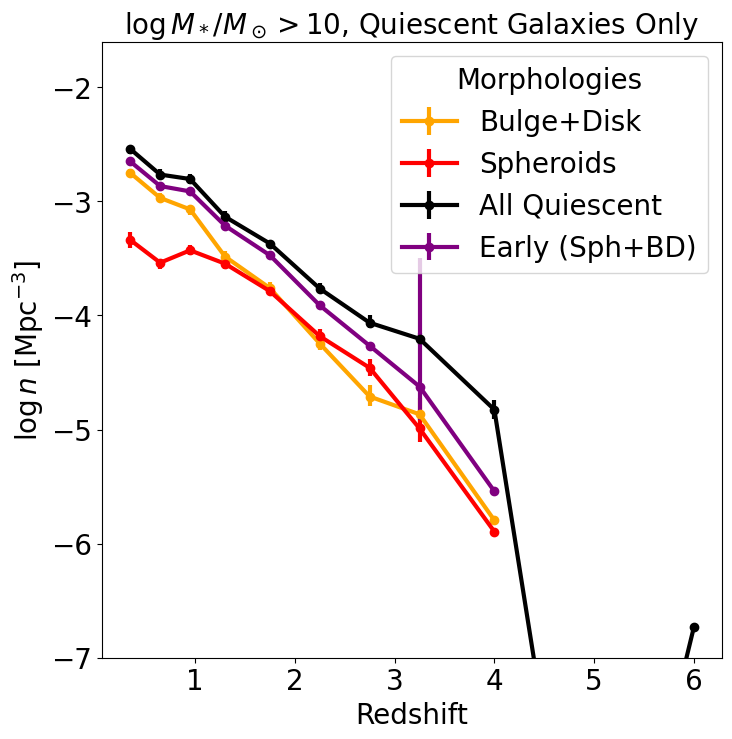

In [319]:
import numpy as np
from scipy.integrate import quad
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D  # Import Line2D
from scipy.stats import median_abs_deviation
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results



# Define the single and double Schechter functions
def single_schechter_function(logM, logM_star, alpha, log_phi_star):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**log_phi_star
    return np.log(10)*phi_star * (M/M_star)**(alpha+1) * np.exp(-M/M_star) 


def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))

# Integrate the Schechter functions
def integrate_schechter(params, use_double, z_range):
    mass_range = np.linspace(10, 12, 400)  # from logM 8 to 12
    if use_double:
        mean_params = [params['means'][0], params['means'][1], params['means'][2],np.log10(params['means'][3]*1e-3),np.log10(params['means'][4]*1e-3)]#params['means'][:5]  # logM*, alpha1, alpha2, phi1*, phi2*
    else:
        mean_params = [params['means'][0], params['means'][1], np.log10(params['means'][3]*1e-3)]  # logM*, alpha1, phi1*
        
    cov_matrix = np.diag(np.array(params['stds'])[:len(mean_params)]**2)
    samples = multivariate_normal.rvs(mean=mean_params, cov=cov_matrix, size=1000)
    
    densities = []
    for sample in samples:
        if use_double:
            density = quad(double_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
            #print(density)
        else:
            density = quad(single_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
        densities.append(density)
    

   
    return np.median(densities), median_abs_deviation(densities, scale='normal')

# Compute number densities for all morphologies
pub_morphologies = ['ALL','SPH', 'DISK+SPH', 'DISKS', 'IRREGULARS']
plot_morphologies = ['ALL','IRREGULARS']
labels=['All','Spheroids','Bulge Dominated','Disk Dominated','Irregulars']
# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'IRREGULARS': 'green',
    'DISKS': 'blue',
    'DISK+SPH': 'orange',
    'ALL': 'black',
    'early': 'orange',
    'SPH':'red'
}
number_densities_hubble = {morph: [] for morph in pub_morphologies}
z_values = []
#print((float(z_range.split('-')[0])+float(z_range.split('-')[1])*0.5))
for (morph, z_range), params in smf_fit_params.items():
    mean_density, std_density = integrate_schechter(params, params['use_double_schechter'], z_range)
    #print(float(z_range.split('-')[1]))
    z_mean = (float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5
    lookback_time = cosmo.lookback_time(z_mean).value  # Get lookback time in Gyr
    number_densities_hubble[morph].append((lookback_time, mean_density, std_density,z_mean))
    #number_densities_hubble[morph].append(((float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5, mean_density, std_density))  # Using upper z for simplicity
    #if float(z_range.split('-')[1]) not in z_values:
    #    z_values.append(float(z_range.split('-')[1]))

# Plot number densities vs. redshift
plt.figure(figsize=(8, 8))
for morph,label in zip(plot_morphologies,labels):
    lb = [data[0] for data in number_densities_hubble[morph]]
    zs = [data[3] for data in number_densities_hubble[morph]]
    #print(zs)
    densities = [data[1] for data in number_densities_hubble[morph]]
    errors = [data[2] for data in number_densities_hubble[morph]]
    valid=(np.array(zs)>0.5) &(np.array(zs)<2.5)
    #plt.errorbar(np.array(zs)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')

densities = np.array(densities)*0.0
for morph in ['DISKS','SPH','DISK+SPH']:
    dens_type = [data[1] for data in number_densities_hubble[morph]] 
    densities+=dens_type
#print(densities)
#plt.plot(np.array(zs)[valid],np.log10(np.array(densities)[valid]),c=colors['reg'],ls=':')



def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

#plt.figure(figsize=(12, 8))

# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'irr': 'green',
    'disk': 'blue',
    'db': 'orange',
    'all': 'black',
    'early': 'orange',
    'sph':'red',
    'comp':'yellow'
    
}

morph_labels = {'reg': 'Hubble Types', 'irr': 'Irregulars','comp':'compact','all':'All Quiescent','sph':'Spheroids','disk':"Disks",'db':"Bulge+Disk"}
number_densities_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/number_densities_with_errors_Q.pkl'

with open(number_densities_path,'rb') as f:
    number_densities = pickle.load(f)
# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    
    redshifts = [item[0] for item in data]
    lookback_time = cosmo.lookback_time(redshifts).value
    densities = [item[1] for item in data]
    ue = [item[2] for item in data]
    le = [item[3] for item in data]

    # Calculate log-scale errors
    log_upper_errors = []
    log_lower_errors = []
    for d, lev,uev in zip(densities, le,ue):
        ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
        log_upper_errors.append(upe)
        log_lower_errors.append(ule)
    
    # Asymmetric error format for errorbar()
    errors = [log_lower_errors, log_upper_errors]
    

    if (morph=='sph'):
        densities_sph = densities[0:10]
        
        errors_sph = [ue[0:10],le[0:10]]


    if (morph=='db'):
        densities_db = densities[0:9]
        errors_db = [ue[0:9],le[0:9]]
    #errors
    if  (morph=='sph') or (morph=='all') or (morph=='db') : 
        #if morph=='sph':
        ##    print(np.array(densities).shape)
        #    densities+=densities_sph
        #    print(np.array(densities_sph).shape)
            
        #    errors = np.sqrt(np.array(errors)**2+np.array(errors_sph)**2)
        plt.errorbar(redshifts, np.log10(densities), yerr=errors, label=morph_labels.get(morph, morph), fmt='o-', color=colors[morph],lw=3)
        print(morph,densities)
        #plt.scatter(lookback_time, np.log10(densities), label=morph_labels.get(morph, morph), color=colors[morph],lw=3)


densities_early = np.array(densities_db)+np.array(densities_sph)

errors_early = np.sqrt(np.array(errors_db)**2+np.array(errors_sph)**2)
log_upper_errors_early = []
log_lower_errors_early = []
for d, lev,uev in zip(densities, errors_early[0],errors_early[1]):
    ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
    log_upper_errors_early.append(upe)
    log_lower_errors_early.append(ule)

errors_early = [log_lower_errors_early, log_upper_errors_early]

print(len(densities_early))
plt.errorbar(redshifts[0:9], np.log10(densities_early), yerr=errors_early, label='Early (Sph+BD)', fmt='o-', color='purple',lw=3)

custom_lines = [
    Line2D([0], [0], color='black', lw=4, linestyle=':'),
    Line2D([0], [0], color='black', lw=4)
]

#legend1=plt.legend(custom_lines, ['HST', 'JWST'], title='Observations', title_fontsize='20', fontsize=20,loc='upper right')

plt.legend(title='Morphologies', loc='upper right', fontsize=20, title_fontsize=20)

#plt.gca().add_artist(legend1)

# Customize font sizes
plt.xlabel('Redshift', fontsize=20)
plt.ylabel('$\log n$ [Mpc$^{-3}$]', fontsize=20)
plt.title('$\log M_*/M_\odot>10$, Quiescent Galaxies Only', fontsize=20)
#plt.text(.2,-3.25,'$\log M_*/M_\odot>9$',fontsize=20)
plt.ylim(-7,-1.6)
#plt.xlim(0,5)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

#plt.savefig('/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures/number_densities_hubble_peculiar.png')

plt.show()


irr [0.0011238340517023021, 0.0010136748686498669, 0.0007885528812008314, 0.000219446527100649, 0.0001214466058803375, 4.623174693479658e-05, 8.498808223755763e-06, 3.6855295661972126e-06, 4.3006696017905286e-06, 4.3800186862013345e-06, 3.05642635478459e-05]
disk [0.0010751008988183963, 0.0003013919365189323, 0.0001589184307171427, 2.6430069916000485e-05, 1.5912343266776125e-05, 4.9081919973214375e-06, 3.0599735663676584e-06, 2.306201129029526e-06, 1.6946712812684675e-06]
db [0.000850505605459678, 0.000252210611579046, 0.0001306065250269318, 2.5821675845026803e-05, 1.3245044359325044e-05, 1.855568758348868e-06, 5.959194555641045e-07, 7.374990813376292e-08, 4.0535523273263886e-07]
sph [0.0004081768888049057, 0.0003818544723105969, 0.00029403204620157756, 7.6632096712008e-05, 3.267049998457178e-05, 9.858304767622976e-06, 2.261016807230046e-06, 3.162632429834312e-07, 1.3704208155202767e-05]
all [0.003671941171634839, 0.002029405949862449, 0.0014452993852139173, 0.0003768550170015971, 0.00

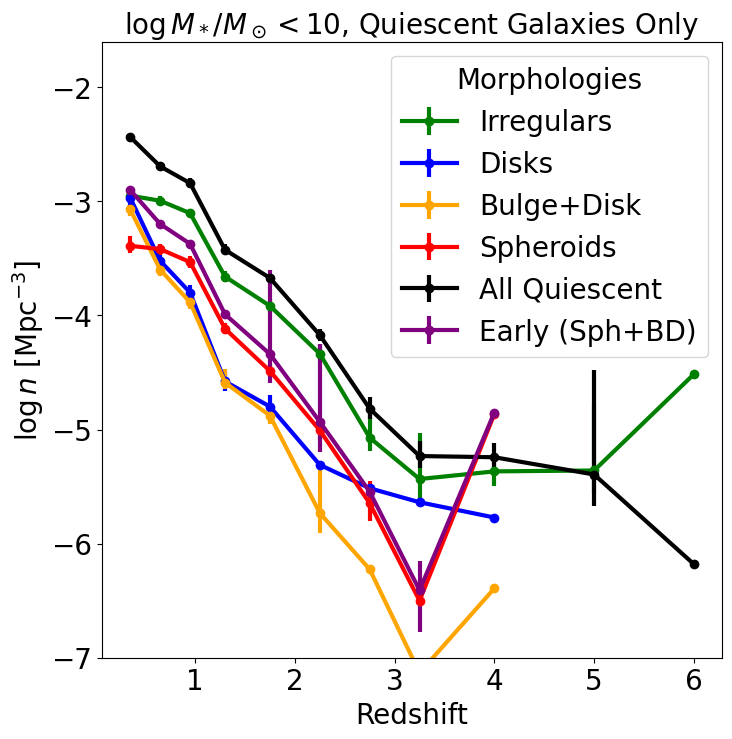

In [105]:
import numpy as np
from scipy.integrate import quad
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D  # Import Line2D
from scipy.stats import median_abs_deviation
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results



# Define the single and double Schechter functions
def single_schechter_function(logM, logM_star, alpha, log_phi_star):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**log_phi_star
    return np.log(10)*phi_star * (M/M_star)**(alpha+1) * np.exp(-M/M_star) 


def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))

# Integrate the Schechter functions
def integrate_schechter(params, use_double, z_range):
    mass_range = np.linspace(10, 12, 400)  # from logM 8 to 12
    if use_double:
        mean_params = [params['means'][0], params['means'][1], params['means'][2],np.log10(params['means'][3]*1e-3),np.log10(params['means'][4]*1e-3)]#params['means'][:5]  # logM*, alpha1, alpha2, phi1*, phi2*
    else:
        mean_params = [params['means'][0], params['means'][1], np.log10(params['means'][3]*1e-3)]  # logM*, alpha1, phi1*
        
    cov_matrix = np.diag(np.array(params['stds'])[:len(mean_params)]**2)
    samples = multivariate_normal.rvs(mean=mean_params, cov=cov_matrix, size=1000)
    
    densities = []
    for sample in samples:
        if use_double:
            density = quad(double_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
            #print(density)
        else:
            density = quad(single_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
        densities.append(density)
    

   
    return np.median(densities), median_abs_deviation(densities, scale='normal')

# Compute number densities for all morphologies
pub_morphologies = ['ALL','SPH', 'DISK+SPH', 'DISKS', 'IRREGULARS']
plot_morphologies = ['ALL','IRREGULARS']
labels=['All','Spheroids','Bulge Dominated','Disk Dominated','Irregulars']
# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'IRREGULARS': 'green',
    'DISKS': 'blue',
    'DISK+SPH': 'orange',
    'ALL': 'black',
    'early': 'orange',
    'SPH':'red'
}
number_densities_hubble = {morph: [] for morph in pub_morphologies}
z_values = []
#print((float(z_range.split('-')[0])+float(z_range.split('-')[1])*0.5))
for (morph, z_range), params in smf_fit_params.items():
    mean_density, std_density = integrate_schechter(params, params['use_double_schechter'], z_range)
    #print(float(z_range.split('-')[1]))
    z_mean = (float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5
    lookback_time = cosmo.lookback_time(z_mean).value  # Get lookback time in Gyr
    number_densities_hubble[morph].append((lookback_time, mean_density, std_density,z_mean))
    #number_densities_hubble[morph].append(((float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5, mean_density, std_density))  # Using upper z for simplicity
    #if float(z_range.split('-')[1]) not in z_values:
    #    z_values.append(float(z_range.split('-')[1]))

# Plot number densities vs. redshift
plt.figure(figsize=(8, 8))
for morph,label in zip(plot_morphologies,labels):
    lb = [data[0] for data in number_densities_hubble[morph]]
    zs = [data[3] for data in number_densities_hubble[morph]]
    #print(zs)
    densities = [data[1] for data in number_densities_hubble[morph]]
    errors = [data[2] for data in number_densities_hubble[morph]]
    valid=(np.array(zs)>0.5) &(np.array(zs)<2.5)
    #plt.errorbar(np.array(zs)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')

densities = np.array(densities)*0.0
for morph in ['DISKS','SPH','DISK+SPH']:
    dens_type = [data[1] for data in number_densities_hubble[morph]] 
    densities+=dens_type
#print(densities)
#plt.plot(np.array(zs)[valid],np.log10(np.array(densities)[valid]),c=colors['reg'],ls=':')



def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

#plt.figure(figsize=(12, 8))

# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'irr': 'green',
    'disk': 'blue',
    'db': 'orange',
    'all': 'black',
    'early': 'orange',
    'sph':'red',
    'comp':'yellow'
    
}

morph_labels = {'reg': 'Hubble Types', 'irr': 'Irregulars','comp':'compact','all':'All Quiescent','sph':'Spheroids','disk':"Disks",'db':"Bulge+Disk"}
number_densities_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/number_densities_with_errors_Q_lowmass.pkl'

with open(number_densities_path,'rb') as f:
    number_densities = pickle.load(f)
# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    
    redshifts = [item[0] for item in data]
    lookback_time = cosmo.lookback_time(redshifts).value
    densities = [item[1] for item in data]
    ue = [item[2] for item in data]
    le = [item[3] for item in data]

    # Calculate log-scale errors
    log_upper_errors = []
    log_lower_errors = []
    for d, lev,uev in zip(densities, le,ue):
        ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
        log_upper_errors.append(upe)
        log_lower_errors.append(ule)
    
    # Asymmetric error format for errorbar()
    errors = [log_lower_errors, log_upper_errors]
    

    if (morph=='sph'):
        densities_sph = densities[0:10]
        
        errors_sph = [ue[0:10],le[0:10]]


    if (morph=='db'):
        densities_db = densities[0:9]
        errors_db = [ue[0:9],le[0:9]]
    #errors
    if  (morph=='sph') or (morph=='all') or (morph=='db')  or (morph=='disk') or (morph=='irr') : 
        #if morph=='sph':
        ##    print(np.array(densities).shape)
        #    densities+=densities_sph
        #    print(np.array(densities_sph).shape)
            
        #    errors = np.sqrt(np.array(errors)**2+np.array(errors_sph)**2)
        plt.errorbar(redshifts, np.log10(densities), yerr=errors, label=morph_labels.get(morph, morph), fmt='o-', color=colors[morph],lw=3)
        print(morph,densities)
        #plt.scatter(lookback_time, np.log10(densities), label=morph_labels.get(morph, morph), color=colors[morph],lw=3)


densities_early = np.array(densities_db)+np.array(densities_sph)

errors_early = np.sqrt(np.array(errors_db)**2+np.array(errors_sph)**2)
log_upper_errors_early = []
log_lower_errors_early = []
for d, lev,uev in zip(densities, errors_early[0],errors_early[1]):
    ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
    log_upper_errors_early.append(upe)
    log_lower_errors_early.append(ule)

errors_early = [log_lower_errors_early, log_upper_errors_early]

print(len(densities_early))
plt.errorbar(redshifts[0:9], np.log10(densities_early), yerr=errors_early, label='Early (Sph+BD)', fmt='o-', color='purple',lw=3)

custom_lines = [
    Line2D([0], [0], color='black', lw=4, linestyle=':'),
    Line2D([0], [0], color='black', lw=4)
]

#legend1=plt.legend(custom_lines, ['HST', 'JWST'], title='Observations', title_fontsize='20', fontsize=20,loc='upper right')

plt.legend(title='Morphologies', loc='upper right', fontsize=20, title_fontsize=20)

#plt.gca().add_artist(legend1)

# Customize font sizes
plt.xlabel('Redshift', fontsize=20)
plt.ylabel('$\log n$ [Mpc$^{-3}$]', fontsize=20)
plt.title('$\log M_*/M_\odot<10$, Quiescent Galaxies Only', fontsize=20)
#plt.text(.2,-3.25,'$\log M_*/M_\odot>9$',fontsize=20)
plt.ylim(-7,-1.6)
#plt.xlim(0,5)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

#plt.savefig('/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures/number_densities_hubble_peculiar.png')

plt.show()


10
[ 0.         -0.05015742 -0.04923702 -0.05015742 -0.05015742 -0.01626546
 -0.14167309 -0.35146698 -0.51259161 -1.        ]
[0.00000000e+00 7.48943868e-05 9.99292575e-05 3.82234075e-05
 3.36777170e-05 9.67153730e-06 5.59514320e-05 1.29414580e-04
 8.79016488e-05 3.22643040e-05]
[       -inf -4.12555073 -4.00030734 -4.4176706  -4.47265736 -5.01450449
 -4.25218879 -3.88801679 -4.05600298 -4.4912777 ]


/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/1095212364.py:230: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "o-" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(redshifts[0:10], np.log10(densities_late), yerr=errors_late, label='Late-Type', fmt='o-', color='black',lw=3,ls='-')
/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/1095212364.py:231: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "o-" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(redshifts[0:10], np.log10(densities_thin_disk), yerr=errors_late, label='Thin Disk', fmt='o-', color='blue',lw=3,ls='-')
/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/1095212364.py:234: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "o-" (-> linestyle='-'). The keyword argumen

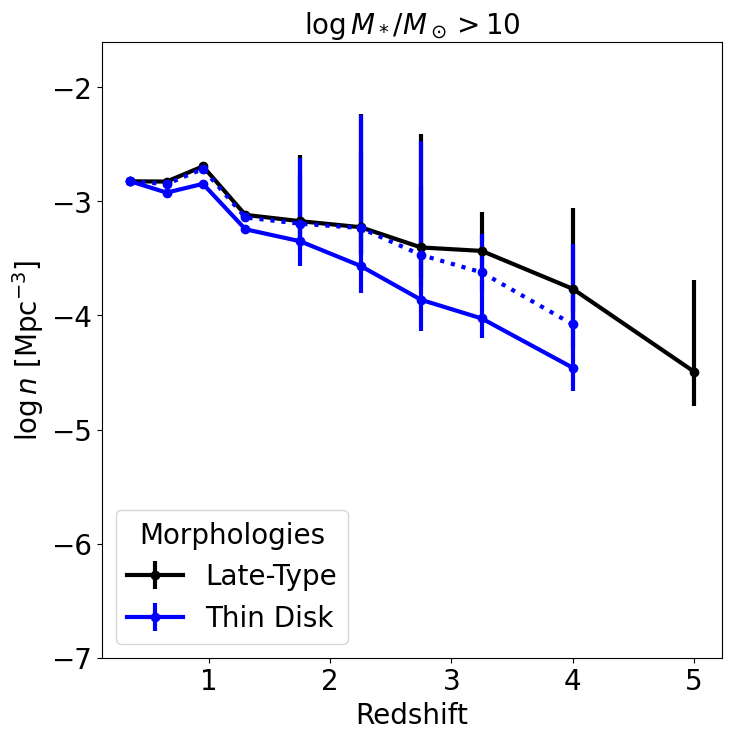

In [117]:
bar_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/zoobot'
number_densities_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/number_densities_with_errors.pkl'

with open(number_densities_path,'rb') as f:
    number_densities = pickle.load(f)



# Save the dictionary as an .npz file
fbar_dict = np.load(os.path.join(bar_path, 'fbar_COSMOS3.1.npz'))

import numpy as np
from scipy.integrate import quad
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D  # Import Line2D
from scipy.stats import median_abs_deviation
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results



# Define the single and double Schechter functions
def single_schechter_function(logM, logM_star, alpha, log_phi_star):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**log_phi_star
    return np.log(10)*phi_star * (M/M_star)**(alpha+1) * np.exp(-M/M_star) 


def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))

# Integrate the Schechter functions
def integrate_schechter(params, use_double, z_range):
    mass_range = np.linspace(10, 12, 400)  # from logM 8 to 12
    if use_double:
        mean_params = [params['means'][0], params['means'][1], params['means'][2],np.log10(params['means'][3]*1e-3),np.log10(params['means'][4]*1e-3)]#params['means'][:5]  # logM*, alpha1, alpha2, phi1*, phi2*
    else:
        mean_params = [params['means'][0], params['means'][1], np.log10(params['means'][3]*1e-3)]  # logM*, alpha1, phi1*
        
    cov_matrix = np.diag(np.array(params['stds'])[:len(mean_params)]**2)
    samples = multivariate_normal.rvs(mean=mean_params, cov=cov_matrix, size=1000)
    
    densities = []
    for sample in samples:
        if use_double:
            density = quad(double_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
            #print(density)
        else:
            density = quad(single_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
        densities.append(density)
    

   
    return np.median(densities), median_abs_deviation(densities, scale='normal')

# Compute number densities for all morphologies
pub_morphologies = ['ALL','SPH', 'DISK+SPH', 'DISKS', 'IRREGULARS']
plot_morphologies = ['ALL','IRREGULARS']
labels=['All','Spheroids','Bulge Dominated','Disk Dominated','Irregulars']
# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'IRREGULARS': 'green',
    'DISKS': 'blue',
    'DISK+SPH': 'orange',
    'ALL': 'black',
    'early': 'orange',
    'SPH':'red'
}
number_densities_hubble = {morph: [] for morph in pub_morphologies}
z_values = []
#print((float(z_range.split('-')[0])+float(z_range.split('-')[1])*0.5))
for (morph, z_range), params in smf_fit_params.items():
    mean_density, std_density = integrate_schechter(params, params['use_double_schechter'], z_range)
    #print(float(z_range.split('-')[1]))
    z_mean = (float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5
    lookback_time = cosmo.lookback_time(z_mean).value  # Get lookback time in Gyr
    number_densities_hubble[morph].append((lookback_time, mean_density, std_density,z_mean))
    #number_densities_hubble[morph].append(((float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5, mean_density, std_density))  # Using upper z for simplicity
    #if float(z_range.split('-')[1]) not in z_values:
    #    z_values.append(float(z_range.split('-')[1]))

# Plot number densities vs. redshift
plt.figure(figsize=(8, 8))
for morph,label in zip(plot_morphologies,labels):
    lb = [data[0] for data in number_densities_hubble[morph]]
    zs = [data[3] for data in number_densities_hubble[morph]]
    #print(zs)
    densities = [data[1] for data in number_densities_hubble[morph]]
    errors = [data[2] for data in number_densities_hubble[morph]]
    valid=(np.array(zs)>0.5) &(np.array(zs)<2.5)
    #plt.errorbar(np.array(zs)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')

densities = np.array(densities)*0.0
for morph in ['DISKS','SPH','DISK+SPH']:
    dens_type = [data[1] for data in number_densities_hubble[morph]] 
    densities+=dens_type
#print(densities)
#plt.plot(np.array(zs)[valid],np.log10(np.array(densities)[valid]),c=colors['reg'],ls=':')



def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

#plt.figure(figsize=(12, 8))

# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'irr': 'green',
    'disk': 'blue',
    'db': 'orange',
    'all': 'black',
    'early': 'orange',
    'sph':'red',
    'comp':'yellow'
    
}

morph_labels = {'reg': 'Hubble Types', 'irr': 'Irregulars','comp':'compact','all':'all'}

# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    
    redshifts = [item[0] for item in data]
    lookback_time = cosmo.lookback_time(redshifts).value
    densities = [item[1] for item in data]
    ue = [item[2] for item in data]
    le = [item[3] for item in data]
    

  
    
    # Asymmetric error format for errorbar()
    #errors = [log_lower_errors, log_upper_errors]
    errors=[ue[0:10],le[0:10]]
    if (morph=='db'):
        densities_db = densities[0:10]
        errors_db = errors

    if (morph=='sph'):
        densities_sph = densities[0:10]
        errors_sph = errors

    if (morph=='disk'):
        densities_disk = densities[0:10]
        errors_disk = errors

    if (morph=='irr'):
        densities_irr = densities[0:10]
        errors_irr = errors
    
    if (morph=='comp'):
        densities_comp = densities[0:10]
        errors_comp = errors

    #errors
    #if (morph=='late') or (morph=='sph') or (morph=='db'): 
        #if morph=='sph':
        ##    print(np.array(densities).shape)
        #    densities+=densities_sph
        #    print(np.array(densities_sph).shape)
            



        #    errors = np.sqrt(np.array(errors)**2+np.array(errors_sph)**2)
  # Calculate log-scale errors

densities_early = np.array(densities_db)+np.array(densities_sph)
densities_late = np.array(densities_disk)+np.array(densities_irr)

errors_early = np.sqrt(np.array(errors_db)**2+np.array(errors_sph)**2)
errors_late = np.sqrt(np.array(errors_disk)**2+np.array(errors_irr)**2)

log_upper_errors_late = []
log_lower_errors_late = []
for d, lev,uev in zip(densities, errors_late[0],errors_late[1]):
    ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
    log_upper_errors_late.append(upe)
    log_lower_errors_late.append(ule)

errors_late = [log_lower_errors_late, log_upper_errors_late]

log_upper_errors_early = []
log_lower_errors_early = []
for d, lev,uev in zip(densities, errors_early[0],errors_early[1]):
    ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
    log_upper_errors_early.append(upe)
    log_lower_errors_early.append(ule)

errors_early = [log_lower_errors_early, log_upper_errors_early]


log_upper_errors_comp = []
log_lower_errors_comp = []
for d, lev,uev in zip(densities, errors_comp[0],errors_comp[1]):
    ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
    log_upper_errors_comp.append(upe)
    log_lower_errors_comp.append(ule)

errors_comp = [log_lower_errors_comp, log_upper_errors_comp]

print(len(densities_db))
#plt.errorbar(redshifts[0:9], np.log10(densities_late), yerr=errors_late, label='Late (Disks+Irr)', fmt='o-', color='blue',lw=3)
#plt.errorbar(redshifts[0:10], np.log10(densities_early), yerr=errors_early, label='Early (Sph+BD)', fmt='o-', color='red',lw=3)
delta = (fbar_dict['fbar_vec_now']-fbar_dict['fbar_vec_now'][0])/fbar_dict['fbar_vec_now'][0]
delta_w = (fbar_dict['fbar_vec']-fbar_dict['fbar_vec'][0])/fbar_dict['fbar_vec'][0]
delta_w[(delta_w>0)]=delta_w[1]
#weights = (fbar_dict['fbar_vec_now'])/(fbar_dict['fbar_vec_now'])[0]
#delta= np.concatenate((np.zeros(2),delta))
print(delta_w)
#print((fbar_dict['fbar_vec_now']))
densities_thin_disk = densities_late*(1+delta[0:10])
densities_pec = densities_late-densities_thin_disk

densities_thin_disk_w = densities_late*(1+delta_w[0:10])
densities_pec_w = densities_late-densities_thin_disk_w

print(densities_pec_w)
print(np.log10(densities_pec_w))

plt.errorbar(redshifts[0:10], np.log10(densities_late), yerr=errors_late, label='Late-Type', fmt='o-', color='black',lw=3,ls='-')
plt.errorbar(redshifts[0:10], np.log10(densities_thin_disk), yerr=errors_late, label='Thin Disk', fmt='o-', color='blue',lw=3,ls='-')
#plt.errorbar(redshifts[0:10], np.log10(densities_pec), yerr=errors_late, label='Thick Disk', fmt='o-', color='green',lw=3,ls='-')

plt.errorbar(redshifts[0:10], np.log10(densities_thin_disk_w), yerr=errors_late,  fmt='o-', color='blue',lw=3,ls=':')
#plt.errorbar(redshifts[0:10], np.log10(densities_pec_w), yerr=errors_late,  fmt='o-', color='green',lw=3,ls=':')


#plt.errorbar(redshifts[0:10], np.log10(densities_comp), yerr=errors_comp, label='Compact', fmt='o-', color='orange',lw=3)
#print(morph,densities)
        #plt.scatter(lookback_time, np.log10(densities), label=morph_labels.get(morph, morph), color=colors[morph],lw=3)
custom_lines = [
    Line2D([0], [0], color='black', lw=4, linestyle=':'),
    Line2D([0], [0], color='black', lw=4)
]

#legend1=plt.legend(custom_lines, ['HST', 'JWST'], title='Observations', title_fontsize='20', fontsize=20,loc='upper right')

plt.legend(title='Morphologies', loc='lower left', fontsize=20, title_fontsize=20)

#plt.gca().add_artist(legend1)

# Customize font sizes
plt.xlabel('Redshift', fontsize=20)
plt.ylabel('$\log n$ [Mpc$^{-3}$]', fontsize=20)
plt.title('$\log M_*/M_\odot>10$', fontsize=20)
#plt.text(.2,-3.25,'$\log M_*/M_\odot>9$',fontsize=20)
plt.ylim(-7,-1.6)
#plt.xlim(0,5)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

#plt.savefig('/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures/number_densities_hubble_peculiar.png')

plt.show()


10
[ 0.         -0.05015742 -0.04923702 -0.05015742 -0.05015742 -0.01626546
 -0.14167309 -0.35146698 -0.51259161 -1.        ]
[0.00000000e+00 7.48943868e-05 9.99292575e-05 3.82234075e-05
 3.36777170e-05 9.67153730e-06 5.59514320e-05 1.29414580e-04
 8.79016488e-05 3.22643040e-05]
[       -inf -4.12555073 -4.00030734 -4.4176706  -4.47265736 -5.01450449
 -4.25218879 -3.88801679 -4.05600298 -4.4912777 ]


/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/3901767614.py:232: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "o-" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(redshifts[0:10], densities_thin_disk/densities_late, yerr=errors_thin_disk/densities_late, fmt='o-', color='blue',lw=3,ls='-')
/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/3901767614.py:235: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "o-" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(redshifts[0:10], densities_thin_disk_w/densities_late, yerr=errors_thin_disk/densities_late,  fmt='o-', color='blue',lw=3,ls=':')


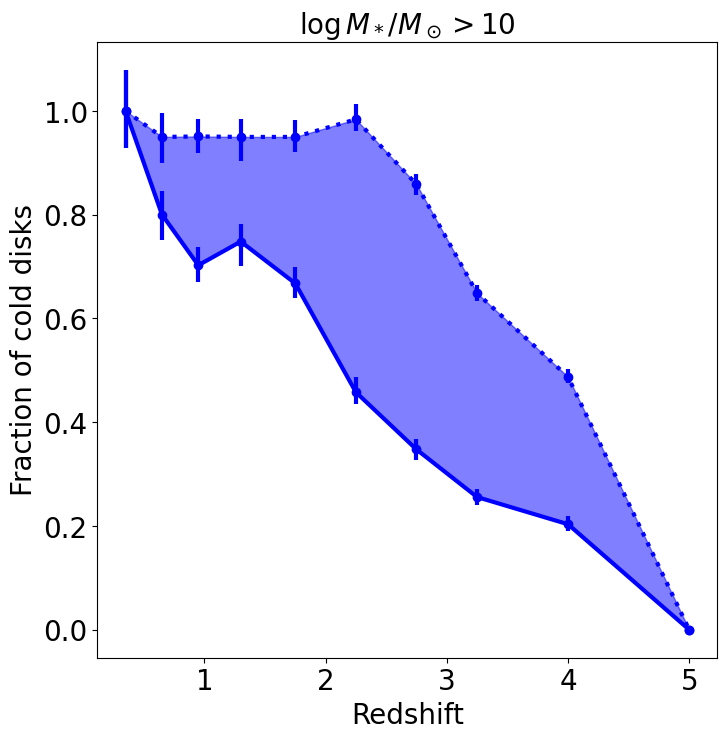

In [124]:
bar_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/zoobot'
number_densities_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/SMF/number_densities_with_errors.pkl'

with open(number_densities_path,'rb') as f:
    number_densities = pickle.load(f)



# Save the dictionary as an .npz file
fbar_dict = np.load(os.path.join(bar_path, 'fbar_COSMOS3.1.npz'))

import numpy as np
from scipy.integrate import quad
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D  # Import Line2D
from scipy.stats import median_abs_deviation
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results



# Define the single and double Schechter functions
def single_schechter_function(logM, logM_star, alpha, log_phi_star):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**log_phi_star
    return np.log(10)*phi_star * (M/M_star)**(alpha+1) * np.exp(-M/M_star) 


def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))

# Integrate the Schechter functions
def integrate_schechter(params, use_double, z_range):
    mass_range = np.linspace(10, 12, 400)  # from logM 8 to 12
    if use_double:
        mean_params = [params['means'][0], params['means'][1], params['means'][2],np.log10(params['means'][3]*1e-3),np.log10(params['means'][4]*1e-3)]#params['means'][:5]  # logM*, alpha1, alpha2, phi1*, phi2*
    else:
        mean_params = [params['means'][0], params['means'][1], np.log10(params['means'][3]*1e-3)]  # logM*, alpha1, phi1*
        
    cov_matrix = np.diag(np.array(params['stds'])[:len(mean_params)]**2)
    samples = multivariate_normal.rvs(mean=mean_params, cov=cov_matrix, size=1000)
    
    densities = []
    for sample in samples:
        if use_double:
            density = quad(double_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
            #print(density)
        else:
            density = quad(single_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
        densities.append(density)
    

   
    return np.median(densities), median_abs_deviation(densities, scale='normal')

# Compute number densities for all morphologies
pub_morphologies = ['ALL','SPH', 'DISK+SPH', 'DISKS', 'IRREGULARS']
plot_morphologies = ['ALL','IRREGULARS']
labels=['All','Spheroids','Bulge Dominated','Disk Dominated','Irregulars']
# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'IRREGULARS': 'green',
    'DISKS': 'blue',
    'DISK+SPH': 'orange',
    'ALL': 'black',
    'early': 'orange',
    'SPH':'red'
}
number_densities_hubble = {morph: [] for morph in pub_morphologies}
z_values = []
#print((float(z_range.split('-')[0])+float(z_range.split('-')[1])*0.5))
for (morph, z_range), params in smf_fit_params.items():
    mean_density, std_density = integrate_schechter(params, params['use_double_schechter'], z_range)
    #print(float(z_range.split('-')[1]))
    z_mean = (float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5
    lookback_time = cosmo.lookback_time(z_mean).value  # Get lookback time in Gyr
    number_densities_hubble[morph].append((lookback_time, mean_density, std_density,z_mean))
    #number_densities_hubble[morph].append(((float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5, mean_density, std_density))  # Using upper z for simplicity
    #if float(z_range.split('-')[1]) not in z_values:
    #    z_values.append(float(z_range.split('-')[1]))

# Plot number densities vs. redshift
plt.figure(figsize=(8, 8))
for morph,label in zip(plot_morphologies,labels):
    lb = [data[0] for data in number_densities_hubble[morph]]
    zs = [data[3] for data in number_densities_hubble[morph]]
    #print(zs)
    densities = [data[1] for data in number_densities_hubble[morph]]
    errors = [data[2] for data in number_densities_hubble[morph]]
    valid=(np.array(zs)>0.5) &(np.array(zs)<2.5)
    #plt.errorbar(np.array(zs)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')

densities = np.array(densities)*0.0
for morph in ['DISKS','SPH','DISK+SPH']:
    dens_type = [data[1] for data in number_densities_hubble[morph]] 
    densities+=dens_type
#print(densities)
#plt.plot(np.array(zs)[valid],np.log10(np.array(densities)[valid]),c=colors['reg'],ls=':')



def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

#plt.figure(figsize=(12, 8))

# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'irr': 'green',
    'disk': 'blue',
    'db': 'orange',
    'all': 'black',
    'early': 'orange',
    'sph':'red',
    'comp':'yellow'
    
}

morph_labels = {'reg': 'Hubble Types', 'irr': 'Irregulars','comp':'compact','all':'all'}

# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    
    redshifts = [item[0] for item in data]
    lookback_time = cosmo.lookback_time(redshifts).value
    densities = [item[1] for item in data]
    ue = [item[2] for item in data]
    le = [item[3] for item in data]
    

  
    
    # Asymmetric error format for errorbar()
    #errors = [log_lower_errors, log_upper_errors]
    errors=[ue[0:10],le[0:10]]
    if (morph=='db'):
        densities_db = densities[0:10]
        errors_db = errors

    if (morph=='sph'):
        densities_sph = densities[0:10]
        errors_sph = errors

    if (morph=='disk'):
        densities_disk = densities[0:10]
        errors_disk = errors

    if (morph=='irr'):
        densities_irr = densities[0:10]
        errors_irr = errors
    
    if (morph=='comp'):
        densities_comp = densities[0:10]
        errors_comp = errors

    #errors
    #if (morph=='late') or (morph=='sph') or (morph=='db'): 
        #if morph=='sph':
        ##    print(np.array(densities).shape)
        #    densities+=densities_sph
        #    print(np.array(densities_sph).shape)
            



        #    errors = np.sqrt(np.array(errors)**2+np.array(errors_sph)**2)
  # Calculate log-scale errors

densities_early = np.array(densities_db)+np.array(densities_sph)
densities_late = np.array(densities_disk)+np.array(densities_irr)

errors_early = np.sqrt(np.array(errors_db)**2+np.array(errors_sph)**2)
errors_late = np.sqrt(np.array(errors_disk)**2+np.array(errors_irr)**2)

log_upper_errors_late = []
log_lower_errors_late = []
for d, lev,uev in zip(densities, errors_late[0],errors_late[1]):
    ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
    log_upper_errors_late.append(upe)
    log_lower_errors_late.append(ule)

#errors_late = [log_lower_errors_late, log_upper_errors_late]

log_upper_errors_early = []
log_lower_errors_early = []
for d, lev,uev in zip(densities, errors_early[0],errors_early[1]):
    ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
    log_upper_errors_early.append(upe)
    log_lower_errors_early.append(ule)

errors_early = [log_lower_errors_early, log_upper_errors_early]


log_upper_errors_comp = []
log_lower_errors_comp = []
for d, lev,uev in zip(densities, errors_comp[0],errors_comp[1]):
    ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
    log_upper_errors_comp.append(upe)
    log_lower_errors_comp.append(ule)

errors_comp = [log_lower_errors_comp, log_upper_errors_comp]

print(len(densities_db))
#plt.errorbar(redshifts[0:9], np.log10(densities_late), yerr=errors_late, label='Late (Disks+Irr)', fmt='o-', color='blue',lw=3)
#plt.errorbar(redshifts[0:10], np.log10(densities_early), yerr=errors_early, label='Early (Sph+BD)', fmt='o-', color='red',lw=3)
delta = (fbar_dict['fbar_vec_now']-fbar_dict['fbar_vec_now'][0])/fbar_dict['fbar_vec_now'][0]
delta_w = (fbar_dict['fbar_vec']-fbar_dict['fbar_vec'][0])/fbar_dict['fbar_vec'][0]
delta_w[(delta_w>0)]=delta_w[1]
#weights = (fbar_dict['fbar_vec_now'])/(fbar_dict['fbar_vec_now'])[0]
#delta= np.concatenate((np.zeros(2),delta))
print(delta_w)
#print((fbar_dict['fbar_vec_now']))
densities_thin_disk = densities_late*(1+delta[0:10])
errors_thin_disk = errors_late*(1+delta[0:10])
densities_pec = densities_late-densities_thin_disk

densities_thin_disk_w = densities_late*(1+delta_w[0:10])
densities_pec_w = densities_late-densities_thin_disk_w

print(densities_pec_w)
print(np.log10(densities_pec_w))

#plt.errorbar(redshifts[0:10], np.log10(densities_late), yerr=errors_late, label='Late-Type', fmt='o-', color='black',lw=3,ls='-')
plt.errorbar(redshifts[0:10], densities_thin_disk/densities_late, yerr=errors_thin_disk/densities_late, fmt='o-', color='blue',lw=3,ls='-')
#plt.errorbar(redshifts[0:10], np.log10(densities_pec), yerr=errors_late, label='Thick Disk', fmt='o-', color='green',lw=3,ls='-')

plt.errorbar(redshifts[0:10], densities_thin_disk_w/densities_late, yerr=errors_thin_disk/densities_late,  fmt='o-', color='blue',lw=3,ls=':')
#plt.errorbar(redshifts[0:10], np.log10(densities_pec_w), yerr=errors_late,  fmt='o-', color='green',lw=3,ls=':')

plt.fill_between(redshifts[0:10], 
                 densities_thin_disk_w/densities_late ,  # Lower bound for fbar_vec_now
                 densities_thin_disk/densities_late,  # Upper bound for fbar_vec
                 color='blue', alpha=0.5) 

#plt.errorbar(redshifts[0:10], np.log10(densities_comp), yerr=errors_comp, label='Compact', fmt='o-', color='orange',lw=3)
#print(morph,densities)
        #plt.scatter(lookback_time, np.log10(densities), label=morph_labels.get(morph, morph), color=colors[morph],lw=3)
custom_lines = [
    Line2D([0], [0], color='black', lw=4, linestyle=':'),
    Line2D([0], [0], color='black', lw=4)
]

#legend1=plt.legend(custom_lines, ['HST', 'JWST'], title='Observations', title_fontsize='20', fontsize=20,loc='upper right')

#plt.legend(title='Morphologies', loc='lower left', fontsize=20, title_fontsize=20)

#plt.gca().add_artist(legend1)

# Customize font sizes
plt.xlabel('Redshift', fontsize=20)
plt.ylabel('Fraction of cold disks', fontsize=20)
plt.title('$\log M_*/M_\odot>10$', fontsize=20)
#plt.text(.2,-3.25,'$\log M_*/M_\odot>9$',fontsize=20)
#plt.ylim(-7,-1.6)
#plt.xlim(0,5)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

plt.savefig('/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures/cold_disks.png')

plt.show()


[0.35, 0.65, 0.9500000000000001, 1.3, 1.75, 2.25, 2.75, 3.25, 4.0, 5.0, 6.0]
[ 3.9872513   6.19530068  7.7272581   8.97792432 10.06707621 10.87299658
 11.42782923 11.82782471 12.2492734  12.61617926 12.85762035]
[0.35, 0.65, 0.9500000000000001, 1.3, 1.75, 2.25, 2.75, 3.25, 4.0, 5.0, 6.0]
[ 3.9872513   6.19530068  7.7272581   8.97792432 10.06707621 10.87299658
 11.42782923 11.82782471 12.2492734  12.61617926 12.85762035]
[0.35, 0.65, 0.9500000000000001, 1.3, 1.75, 2.25, 2.75, 3.25, 4.0, 5.0, 6.0]
[ 3.9872513   6.19530068  7.7272581   8.97792432 10.06707621 10.87299658
 11.42782923 11.82782471 12.2492734  12.61617926 12.85762035]
[0.35, 0.65, 0.9500000000000001, 1.3, 1.75, 2.25, 2.75, 3.25, 4.0, 5.0]
[ 3.9872513   6.19530068  7.7272581   8.97792432 10.06707621 10.87299658
 11.42782923 11.82782471 12.2492734  12.61617926]
[0.35, 0.65, 0.9500000000000001, 1.3, 1.75, 2.25, 2.75, 3.25, 4.0, 5.0, 6.0]
[ 3.9872513   6.19530068  7.7272581   8.97792432 10.06707621 10.87299658
 11.42782923 11.827

/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/1551481445.py:221: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "o-" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(lookback_time[0:10], np.log10(densities_thin_disk), yerr=errors_late, label='Thin Disk', fmt='o-', color='blue',lw=3,ls='-')
/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1206/1551481445.py:222: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "o-" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(lookback_time[0:10], np.log10(densities_pec), yerr=errors_late, label='Thin Disk', fmt='o-', color='green',lw=3,ls='-')


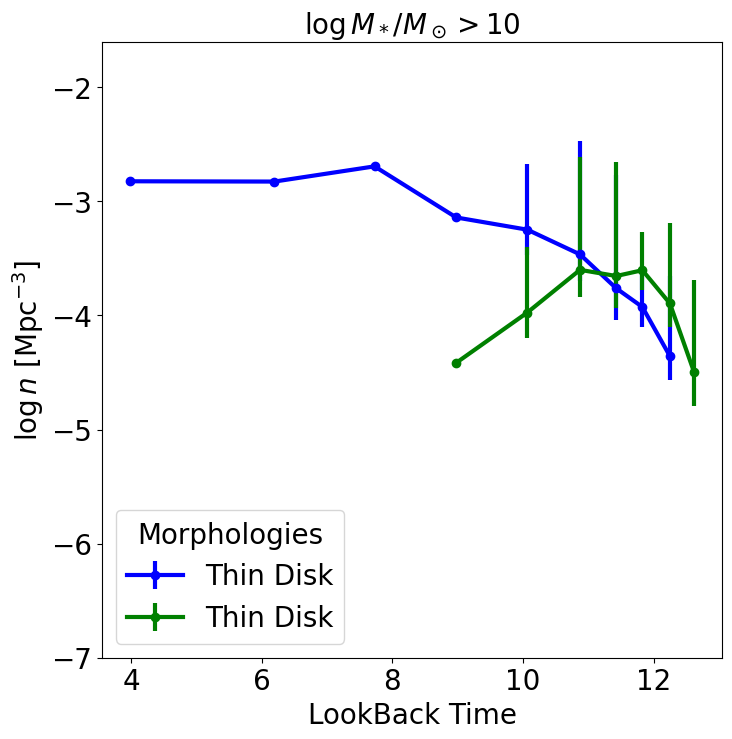

In [96]:
bar_path = '/Users/marchuertascompany/Documents/data/COSMOS-Web/zoobot'




# Save the dictionary as an .npz file
fbar_dict = np.load(os.path.join(bar_path, 'fbar_COSMOS3.1.npz'))

import numpy as np
from scipy.integrate import quad
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D  # Import Line2D
from scipy.stats import median_abs_deviation
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results



# Define the single and double Schechter functions
def single_schechter_function(logM, logM_star, alpha, log_phi_star):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**log_phi_star
    return np.log(10)*phi_star * (M/M_star)**(alpha+1) * np.exp(-M/M_star) 


def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))

# Integrate the Schechter functions
def integrate_schechter(params, use_double, z_range):
    mass_range = np.linspace(10, 12, 400)  # from logM 8 to 12
    if use_double:
        mean_params = [params['means'][0], params['means'][1], params['means'][2],np.log10(params['means'][3]*1e-3),np.log10(params['means'][4]*1e-3)]#params['means'][:5]  # logM*, alpha1, alpha2, phi1*, phi2*
    else:
        mean_params = [params['means'][0], params['means'][1], np.log10(params['means'][3]*1e-3)]  # logM*, alpha1, phi1*
        
    cov_matrix = np.diag(np.array(params['stds'])[:len(mean_params)]**2)
    samples = multivariate_normal.rvs(mean=mean_params, cov=cov_matrix, size=1000)
    
    densities = []
    for sample in samples:
        if use_double:
            density = quad(double_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
            #print(density)
        else:
            density = quad(single_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
        densities.append(density)
    

   
    return np.median(densities), median_abs_deviation(densities, scale='normal')

# Compute number densities for all morphologies
pub_morphologies = ['ALL','SPH', 'DISK+SPH', 'DISKS', 'IRREGULARS']
plot_morphologies = ['ALL','IRREGULARS']
labels=['All','Spheroids','Bulge Dominated','Disk Dominated','Irregulars']
# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'IRREGULARS': 'green',
    'DISKS': 'blue',
    'DISK+SPH': 'orange',
    'ALL': 'black',
    'early': 'orange',
    'SPH':'red'
}
number_densities_hubble = {morph: [] for morph in pub_morphologies}
z_values = []
#print((float(z_range.split('-')[0])+float(z_range.split('-')[1])*0.5))
for (morph, z_range), params in smf_fit_params.items():
    mean_density, std_density = integrate_schechter(params, params['use_double_schechter'], z_range)
    #print(float(z_range.split('-')[1]))
    z_mean = (float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5
    lookback_time = cosmo.lookback_time(z_mean).value  # Get lookback time in Gyr
    number_densities_hubble[morph].append((lookback_time, mean_density, std_density,z_mean))
    #number_densities_hubble[morph].append(((float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5, mean_density, std_density))  # Using upper z for simplicity
    #if float(z_range.split('-')[1]) not in z_values:
    #    z_values.append(float(z_range.split('-')[1]))

# Plot number densities vs. redshift
plt.figure(figsize=(8, 8))
for morph,label in zip(plot_morphologies,labels):
    lb = [data[0] for data in number_densities_hubble[morph]]
    zs = [data[3] for data in number_densities_hubble[morph]]
    #print(zs)
    densities = [data[1] for data in number_densities_hubble[morph]]
    errors = [data[2] for data in number_densities_hubble[morph]]
    valid=(np.array(zs)>0.5) &(np.array(zs)<2.5)
    #plt.errorbar(np.array(zs)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')

densities = np.array(densities)*0.0
for morph in ['DISKS','SPH','DISK+SPH']:
    dens_type = [data[1] for data in number_densities_hubble[morph]] 
    densities+=dens_type
#print(densities)
#plt.plot(np.array(zs)[valid],np.log10(np.array(densities)[valid]),c=colors['reg'],ls=':')



def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

#plt.figure(figsize=(12, 8))

# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'irr': 'green',
    'disk': 'blue',
    'db': 'orange',
    'all': 'black',
    'early': 'orange',
    'sph':'red',
    'comp':'yellow'
    
}

morph_labels = {'reg': 'Hubble Types', 'irr': 'Irregulars','comp':'compact','all':'all'}

# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    
    redshifts = [item[0] for item in data]
    lookback_time = cosmo.lookback_time(redshifts).value
    densities = [item[1] for item in data]
    ue = [item[2] for item in data]
    le = [item[3] for item in data]

    print(redshifts)
    print(lookback_time)
    

  
    
    # Asymmetric error format for errorbar()
    #errors = [log_lower_errors, log_upper_errors]
    errors=[ue[0:10],le[0:10]]
    if (morph=='db'):
        densities_db = densities[0:10]
        errors_db = errors

    if (morph=='sph'):
        densities_sph = densities[0:10]
        errors_sph = errors

    if (morph=='disk'):
        densities_disk = densities[0:10]
        errors_disk = errors

    if (morph=='irr'):
        densities_irr = densities[0:10]
        errors_irr = errors
    
    if (morph=='comp'):
        densities_comp = densities[0:10]
        errors_comp = errors

    #errors
    #if (morph=='late') or (morph=='sph') or (morph=='db'): 
        #if morph=='sph':
        ##    print(np.array(densities).shape)
        #    densities+=densities_sph
        #    print(np.array(densities_sph).shape)
            



        #    errors = np.sqrt(np.array(errors)**2+np.array(errors_sph)**2)
  # Calculate log-scale errors

densities_early = np.array(densities_db)+np.array(densities_sph)
densities_late = np.array(densities_disk)+np.array(densities_irr)

errors_early = np.sqrt(np.array(errors_db)**2+np.array(errors_sph)**2)
errors_late = np.sqrt(np.array(errors_disk)**2+np.array(errors_irr)**2)

log_upper_errors_late = []
log_lower_errors_late = []
for d, lev,uev in zip(densities, errors_late[0],errors_late[1]):
    ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
    log_upper_errors_late.append(upe)
    log_lower_errors_late.append(ule)

errors_late = [log_lower_errors_late, log_upper_errors_late]

log_upper_errors_early = []
log_lower_errors_early = []
for d, lev,uev in zip(densities, errors_early[0],errors_early[1]):
    ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
    log_upper_errors_early.append(upe)
    log_lower_errors_early.append(ule)

errors_early = [log_lower_errors_early, log_upper_errors_early]


log_upper_errors_comp = []
log_lower_errors_comp = []
for d, lev,uev in zip(densities, errors_comp[0],errors_comp[1]):
    ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
    log_upper_errors_comp.append(upe)
    log_lower_errors_comp.append(ule)

errors_comp = [log_lower_errors_comp, log_upper_errors_comp]

print(len(densities_db))
#plt.errorbar(redshifts[0:9], np.log10(densities_late), yerr=errors_late, label='Late (Disks+Irr)', fmt='o-', color='blue',lw=3)
#plt.errorbar(redshifts[0:10], np.log10(densities_early), yerr=errors_early, label='Early (Sph+BD)', fmt='o-', color='red',lw=3)
delta = (fbar_dict['fbar_vec_now']-fbar_dict['fbar_vec_now'][0])/fbar_dict['fbar_vec_now'][0]
#weights = (fbar_dict['fbar_vec_now'])/(fbar_dict['fbar_vec_now'])[0]
delta= np.concatenate((np.zeros(2),delta))
print(delta)
#print((fbar_dict['fbar_vec_now']))
densities_thin_disk = densities_late*(1+delta[0:10])
densities_pec = densities_late-densities_thin_disk
plt.errorbar(lookback_time[0:10], np.log10(densities_thin_disk), yerr=errors_late, label='Thin Disk', fmt='o-', color='blue',lw=3,ls='-')
plt.errorbar(lookback_time[0:10], np.log10(densities_pec), yerr=errors_late, label='Thin Disk', fmt='o-', color='green',lw=3,ls='-')
#plt.errorbar(redshifts[0:10], np.log10(densities_comp), yerr=errors_comp, label='Compact', fmt='o-', color='orange',lw=3)
#print(morph,densities)
        #plt.scatter(lookback_time, np.log10(densities), label=morph_labels.get(morph, morph), color=colors[morph],lw=3)
custom_lines = [
    Line2D([0], [0], color='black', lw=4, linestyle=':'),
    Line2D([0], [0], color='black', lw=4)
]

#legend1=plt.legend(custom_lines, ['HST', 'JWST'], title='Observations', title_fontsize='20', fontsize=20,loc='upper right')

plt.legend(title='Morphologies', loc='lower left', fontsize=20, title_fontsize=20)

#plt.gca().add_artist(legend1)

# Customize font sizes
plt.xlabel('LookBack Time', fontsize=20)
plt.ylabel('$\log n$ [Mpc$^{-3}$]', fontsize=20)
plt.title('$\log M_*/M_\odot>10$', fontsize=20)
#plt.text(.2,-3.25,'$\log M_*/M_\odot>9$',fontsize=20)
plt.ylim(-7,-1.6)
#plt.xlim(0,5)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

#plt.savefig('/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures/number_densities_hubble_peculiar.png')

plt.show()


In [51]:
print(len(errors_late[0]))
print(errors_late)

8
[[1.13182434e-08 8.62303297e-09 8.86583776e-09 2.23713283e-09
  8.33463352e-10 8.91663712e-10 5.04756556e-10 4.41750751e-10]
 [1.42063410e-08 7.16783380e-09 9.94597308e-09 1.23015632e-09
  1.02418082e-09 1.39770815e-09 5.13783980e-10 5.24146551e-10]]


/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_88332/642715151.py:84: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "o-" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(np.array(zs)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')


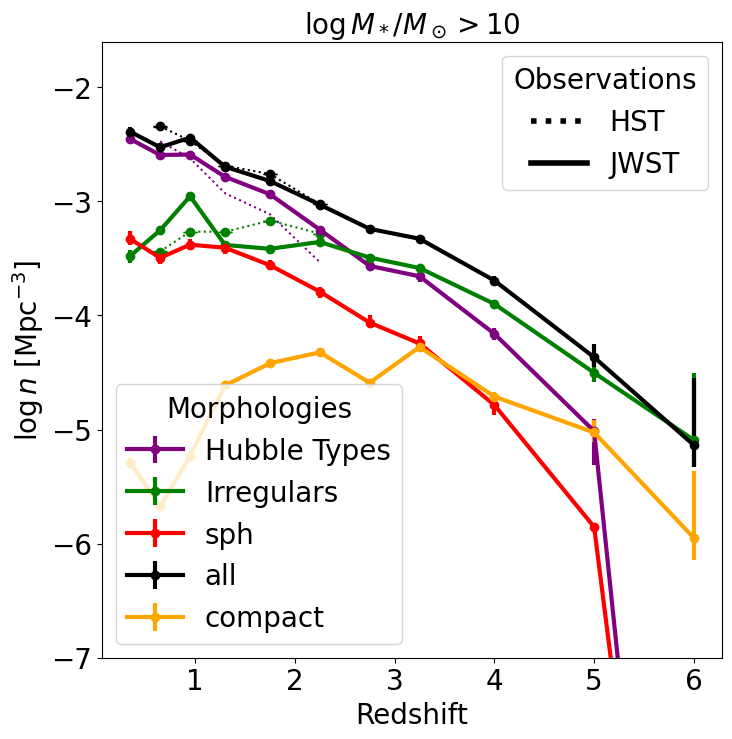

In [480]:
import numpy as np
from scipy.integrate import quad
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D  # Import Line2D
from scipy.stats import median_abs_deviation
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results



# Define the single and double Schechter functions
def single_schechter_function(logM, logM_star, alpha, log_phi_star):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**log_phi_star
    return np.log(10)*phi_star * (M/M_star)**(alpha+1) * np.exp(-M/M_star) 


def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))

# Integrate the Schechter functions
def integrate_schechter(params, use_double, z_range):
    mass_range = np.linspace(10, 12, 400)  # from logM 8 to 12
    if use_double:
        mean_params = [params['means'][0], params['means'][1], params['means'][2],np.log10(params['means'][3]*1e-3),np.log10(params['means'][4]*1e-3)]#params['means'][:5]  # logM*, alpha1, alpha2, phi1*, phi2*
    else:
        mean_params = [params['means'][0], params['means'][1], np.log10(params['means'][3]*1e-3)]  # logM*, alpha1, phi1*
        
    cov_matrix = np.diag(np.array(params['stds'])[:len(mean_params)]**2)
    samples = multivariate_normal.rvs(mean=mean_params, cov=cov_matrix, size=1000)
    
    densities = []
    for sample in samples:
        if use_double:
            density = quad(double_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
            #print(density)
        else:
            density = quad(single_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
        densities.append(density)
    

   
    return np.median(densities), median_abs_deviation(densities, scale='normal')

# Compute number densities for all morphologies
pub_morphologies = ['ALL','SPH', 'DISK+SPH', 'DISKS', 'IRREGULARS']
plot_morphologies = ['ALL','IRREGULARS']
labels=['All','Spheroids','Bulge Dominated','Disk Dominated','Irregulars']
# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'IRREGULARS': 'green',
    'DISKS': 'blue',
    'DISK+SPH': 'orange',
    'ALL': 'black',
    'early': 'orange',
    'SPH':'red'
}
number_densities_hubble = {morph: [] for morph in pub_morphologies}
z_values = []
#print((float(z_range.split('-')[0])+float(z_range.split('-')[1])*0.5))
for (morph, z_range), params in smf_fit_params.items():
    mean_density, std_density = integrate_schechter(params, params['use_double_schechter'], z_range)
    #print(float(z_range.split('-')[1]))
    z_mean = (float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5
    lookback_time = cosmo.lookback_time(z_mean).value  # Get lookback time in Gyr
    number_densities_hubble[morph].append((lookback_time, mean_density, std_density,z_mean))
    #number_densities_hubble[morph].append(((float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5, mean_density, std_density))  # Using upper z for simplicity
    #if float(z_range.split('-')[1]) not in z_values:
    #    z_values.append(float(z_range.split('-')[1]))

# Plot number densities vs. redshift
plt.figure(figsize=(8, 8))
for morph,label in zip(plot_morphologies,labels):
    lb = [data[0] for data in number_densities_hubble[morph]]
    zs = [data[3] for data in number_densities_hubble[morph]]
    #print(zs)
    densities = [data[1] for data in number_densities_hubble[morph]]
    errors = [data[2] for data in number_densities_hubble[morph]]
    valid=(np.array(zs)>0.5) &(np.array(zs)<2.5)
    plt.errorbar(np.array(zs)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')

densities = np.array(densities)*0.0
for morph in ['DISKS','SPH','DISK+SPH']:
    dens_type = [data[1] for data in number_densities_hubble[morph]] 
    densities+=dens_type
#print(densities)
plt.plot(np.array(zs)[valid],np.log10(np.array(densities)[valid]),c=colors['reg'],ls=':')



def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

#plt.figure(figsize=(12, 8))

# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'irr': 'green',
    'disk': 'blue',
    'db': 'orange',
    'all': 'black',
    'early': 'orange',
    'sph':'red',
    'comp':'orange'
    
}

morph_labels = {'reg': 'Hubble Types', 'irr': 'Irregulars','comp':'compact','all':'all','sph':'sph'}

# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    
    redshifts = [item[0] for item in data]
    lookback_time = cosmo.lookback_time(redshifts).value
    densities = [item[1] for item in data]
    ue = [item[2] for item in data]
    le = [item[3] for item in data]

    # Calculate log-scale errors
    log_upper_errors = []
    log_lower_errors = []
    for d, lev,uev in zip(densities, le,ue):
        ule, upe = log_errors(d, lev, uev)  # symmetric errors assumed
        log_upper_errors.append(upe)
        log_lower_errors.append(ule)
    
    # Asymmetric error format for errorbar()
    errors = [log_lower_errors, log_upper_errors]
    #errors
    if (morph=='reg') or (morph=='irr') or (morph=='comp') or (morph=='all') or (morph=='sph'): 
        plt.errorbar(redshifts, np.log10(densities), yerr=errors, label=morph_labels.get(morph, morph), fmt='o-', color=colors[morph],lw=3)
        #plt.scatter(lookback_time, np.log10(densities), label=morph_labels.get(morph, morph), color=colors[morph],lw=3)
custom_lines = [
    Line2D([0], [0], color='black', lw=4, linestyle=':'),
    Line2D([0], [0], color='black', lw=4)
]

legend1=plt.legend(custom_lines, ['HST', 'JWST'], title='Observations', title_fontsize='20', fontsize=20,loc='upper right')

plt.legend(title='Morphologies', loc='lower left', fontsize=20, title_fontsize=20)

plt.gca().add_artist(legend1)

# Customize font sizes
plt.xlabel('Redshift', fontsize=20)
plt.ylabel('$\log n$ [Mpc$^{-3}$]', fontsize=20)
plt.title('$\log M_*/M_\odot>10$', fontsize=20)
#plt.text(.2,-3.25,'$\log M_*/M_\odot>9$',fontsize=20)
plt.ylim(-7,-1.6)
#plt.xlim(0,5)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)

#plt.savefig('/Users/marchuertascompany/Dropbox/Apps/Overleaf/morpho_SMF_COSMOSWeb/figures/number_densities_hubble_peculiar.png')

plt.show()


reg
irr
all


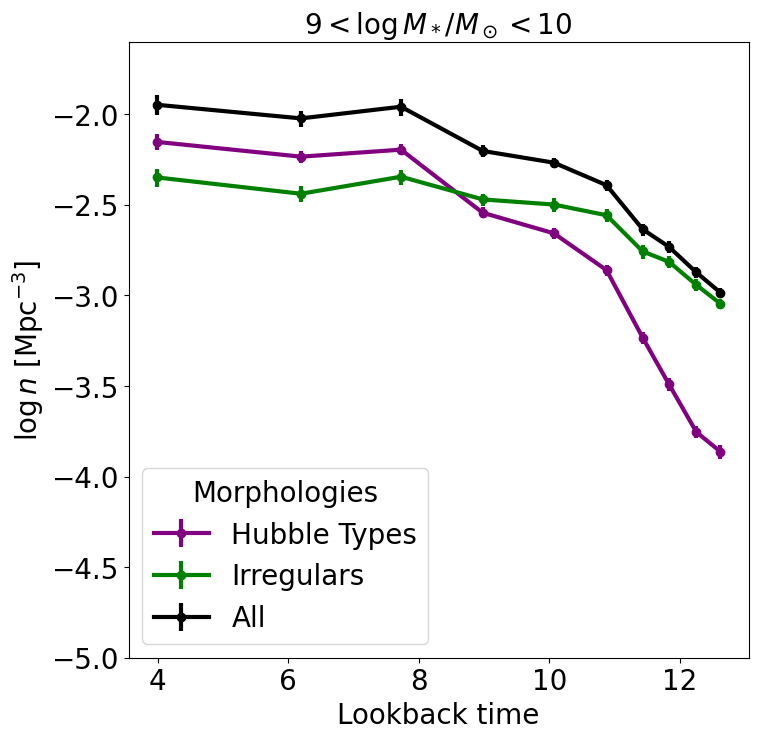

In [32]:
import numpy as np
from scipy.integrate import quad
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D  # Import Line2D
from scipy.stats import median_abs_deviation
from astropy.cosmology import Planck18 as cosmo  # Using Planck 2018 results



# Define the single and double Schechter functions
def single_schechter_function(logM, logM_star, alpha, log_phi_star):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**log_phi_star
    return np.log(10)*phi_star * (M/M_star)**(alpha+1) * np.exp(-M/M_star) 


def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))

# Integrate the Schechter functions
def integrate_schechter(params, use_double, z_range):
    mass_range = np.linspace(9, 10, 400)  # from logM 8 to 12
    if use_double:
        mean_params = [params['means'][0], params['means'][1], params['means'][2],np.log10(params['means'][3]*1e-3),np.log10(params['means'][4]*1e-3)]#params['means'][:5]  # logM*, alpha1, alpha2, phi1*, phi2*
    else:
        mean_params = [params['means'][0], params['means'][1], np.log10(params['means'][3]*1e-3)]  # logM*, alpha1, phi1*
        
    cov_matrix = np.diag(np.array(params['stds'])[:len(mean_params)]**2)
    samples = multivariate_normal.rvs(mean=mean_params, cov=cov_matrix, size=1000)
    
    densities = []
    for sample in samples:
        if use_double:
            density = quad(double_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
            #print(density)
        else:
            density = quad(single_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
        densities.append(density)
    

   
    return np.median(densities), median_abs_deviation(densities, scale='normal')

# Compute number densities for all morphologies
pub_morphologies = ['ALL','SPH', 'DISK+SPH', 'DISKS', 'IRREGULARS']
plot_morphologies = ['ALL','IRREGULARS']
labels=['All','Spheroids','Bulge Dominated','Disk Dominated','Irregulars']
# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'IRREGULARS': 'green',
    'DISKS': 'blue',
    'DISK+SPH': 'orange',
    'ALL': 'black',
    'early': 'orange',
    'SPH':'red'
}
number_densities_hubble = {morph: [] for morph in pub_morphologies}
z_values = []


#print((float(z_range.split('-')[0])+float(z_range.split('-')[1])*0.5))
for (morph, z_range), params in smf_fit_params.items():
    mean_density, std_density = integrate_schechter(params, params['use_double_schechter'], z_range)
    #print(float(z_range.split('-')[1]))
    z_mean = (float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5
    lookback_time = cosmo.lookback_time(z_mean).value  # Get lookback time in Gyr
    number_densities_hubble[morph].append((lookback_time, mean_density, std_density,z_mean))
    #number_densities_hubble[morph].append(((float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5, mean_density, std_density))  # Using upper z for simplicity
    #if float(z_range.split('-')[1]) not in z_values:
    #    z_values.append(float(z_range.split('-')[1]))

# Plot number densities vs. redshift
plt.figure(figsize=(8, 8))
for morph,label in zip(plot_morphologies,labels):
    lb = [data[0] for data in number_densities_hubble[morph]]
    zs = [data[3] for data in number_densities_hubble[morph]]
    #print(zs)
    densities = [data[1] for data in number_densities_hubble[morph]]
    errors = [data[2] for data in number_densities_hubble[morph]]
    valid=(np.array(zs)>0.5) &(np.array(zs)<2.5)
    #plt.errorbar(np.array(lb)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')

densities = np.array(densities)*0.0
for morph in ['DISKS','SPH','DISK+SPH']:
    dens_type = [data[1] for data in number_densities_hubble[morph]] 
    densities+=dens_type
#print(densities)
#plt.plot(np.array(lb)[valid],np.log10(np.array(densities)[valid]),c=colors['reg'],ls=':')



def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

#plt.figure(figsize=(12, 8))

# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'irr': 'green',
    'disk': 'blue',
    'db': 'orange',
    'all': 'black',
    'early': 'orange',
    'sph':'red'
}

morph_labels = {'reg': 'Hubble Types', 'sph': 'Spheroids', 'irr': 'Irregulars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated', 'all': 'All', 'early': 'Early-Type'}

# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    print(morph)
    redshifts = [item[0] for item in data]
    lookback_time = cosmo.lookback_time(redshifts).value
    densities = [item[1] for item in data]
    errors = [item[2] for item in data]

    # Calculate log-scale errors
    log_upper_errors = []
    log_lower_errors = []
    for d, e in zip(densities, errors):
        ue, le = log_errors(d, e, e)  # symmetric errors assumed
        log_upper_errors.append(ue)
        log_lower_errors.append(le)
    
    # Asymmetric error format for errorbar()
    errors = [log_lower_errors, log_upper_errors]

    plt.errorbar(lookback_time, np.log10(densities), yerr=errors, label=morph_labels.get(morph, morph), fmt='o-', color=colors[morph],lw=3)

custom_lines = [
    Line2D([0], [0], color='black', lw=4, linestyle=':'),
    Line2D([0], [0], color='black', lw=4)
]

#legend1=plt.legend(custom_lines, ['HST', 'JWST'], title='Observations', title_fontsize='20', fontsize=20,loc='upper right')

plt.legend(title='Morphologies', loc='lower left', fontsize=20, title_fontsize=20)

#plt.gca().add_artist(legend1)

# Customize font sizes
plt.xlabel('Lookback time', fontsize=20)
plt.ylabel('$\log n$ [Mpc$^{-3}$]', fontsize=20)
plt.title('$9<\log M_*/M_\odot<10$', fontsize=20)
#plt.text(.2,-3.25,'$\log M_*/M_\odot>9$',fontsize=20)
plt.ylim(-5,-1.6)
#plt.xlim(0,5)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)


plt.show()


reg
irr
all


/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1071/587296954.py:82: UserWarning: linestyle is redundantly defined by the 'linestyle' keyword argument and the fmt string "o-" (-> linestyle='-'). The keyword argument will take precedence.
  plt.errorbar(np.array(lb)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')


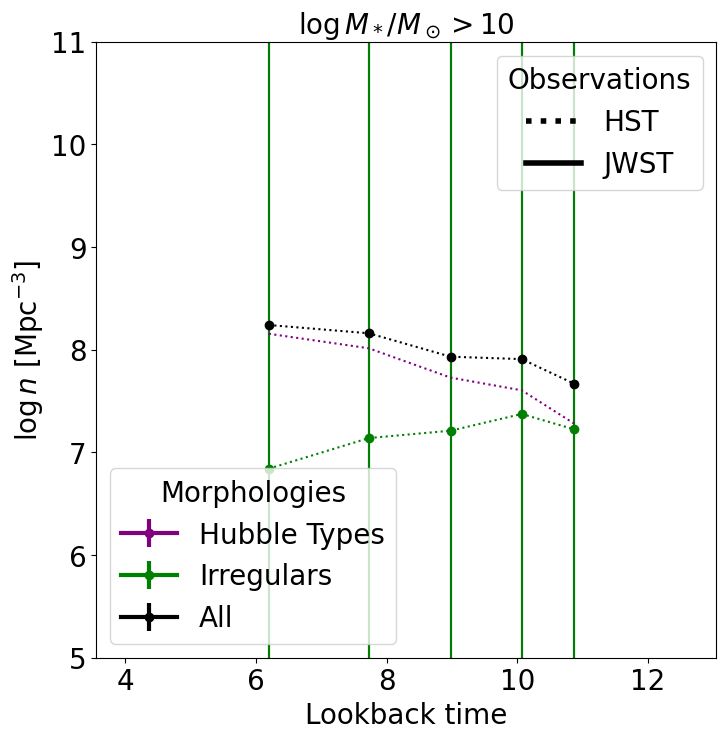

In [341]:
import numpy as np
from scipy.integrate import quad
from scipy.stats import multivariate_normal
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D  # Import Line2D



# Define the single and double Schechter functions
def single_schechter_function(logM, logM_star, alpha, log_phi_star):
    M = 10**logM
    M_star = 10**logM_star
    phi_star = 10**log_phi_star
    return M*np.log(10)*phi_star * (M/M_star)**(alpha+1) * np.exp(-M/M_star) 


def double_schechter_function(logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    
    return 10**logM*np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))

# Integrate the Schechter functions
def integrate_schechter(params, use_double, z_range):
    mass_range = np.linspace(10, 12, 400)  # from logM 8 to 12
    if use_double:
        mean_params = [params['means'][0], params['means'][1], params['means'][2],np.log10(params['means'][3]*1e-3),np.log10(params['means'][4]*1e-3)]#params['means'][:5]  # logM*, alpha1, alpha2, phi1*, phi2*
    else:
        mean_params = [params['means'][0], params['means'][1], np.log10(params['means'][3]*1e-3)]  # logM*, alpha1, phi1*
        
    cov_matrix = np.diag(np.array(params['stds'])[:len(mean_params)]**2)
    samples = multivariate_normal.rvs(mean=mean_params, cov=cov_matrix, size=1000)
    
    densities = []
    for sample in samples:
        if use_double:
            density = quad(double_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
            #print(density)
        else:
            density = quad(single_schechter_function, mass_range[0], mass_range[-1], args=tuple(sample))[0]
        densities.append(density)
    

   
    return np.median(densities), median_abs_deviation(densities, scale='normal')

# Compute number densities for all morphologies
pub_morphologies = ['ALL','SPH', 'DISK+SPH', 'DISKS', 'IRREGULARS']
plot_morphologies = ['ALL','IRREGULARS']
labels=['All','Spheroids','Bulge Dominated','Disk Dominated','Irregulars']
# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'IRREGULARS': 'green',
    'DISKS': 'blue',
    'DISK+SPH': 'orange',
    'ALL': 'black',
    'early': 'orange',
    'SPH':'red'
}
number_densities_hubble = {morph: [] for morph in pub_morphologies}
z_values = []
#print((float(z_range.split('-')[0])+float(z_range.split('-')[1])*0.5))
for (morph, z_range), params in smf_fit_params.items():
    mean_density, std_density = integrate_schechter(params, params['use_double_schechter'], z_range)
    #print(float(z_range.split('-')[1]))
    z_mean = (float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5
    lookback_time = cosmo.lookback_time(z_mean).value  # Get lookback time in Gyr
    number_densities_hubble[morph].append((lookback_time, mean_density, std_density,z_mean))
    #number_densities_hubble[morph].append(((float(z_range.split('-')[0])+float(z_range.split('-')[1]))*0.5, mean_density, std_density))  # Using upper z for simplicity
    #if float(z_range.split('-')[1]) not in z_values:
    #    z_values.append(float(z_range.split('-')[1]))

# Plot number densities vs. redshift
plt.figure(figsize=(8, 8))
for morph,label in zip(plot_morphologies,labels):
    lb = [data[0] for data in number_densities_hubble[morph]]
    zs = [data[3] for data in number_densities_hubble[morph]]
    #print(zs)
    densities = [data[1] for data in number_densities_hubble[morph]]
    errors = [data[2] for data in number_densities_hubble[morph]]
    valid=(np.array(zs)>0.5) &(np.array(zs)<2.5)
    plt.errorbar(np.array(lb)[valid], np.log10(np.array(densities)[valid]), yerr=np.array(errors)[valid], fmt='o-', capsize=5,c=colors[morph],ls=':')

densities = np.array(densities)*0.0
for morph in ['DISKS','SPH','DISK+SPH']:
    dens_type = [data[1] for data in number_densities_hubble[morph]] 
    densities+=dens_type
#print(densities)
plt.plot(np.array(lb)[valid],np.log10(np.array(densities)[valid]),c=colors['reg'],ls=':')



def log_errors(V, delta_up, delta_down):
    """ Calculate log-scale errors given the value and its linear scale uncertainties. """
    upper_log_error = np.log10(V + delta_up) - np.log10(V)
    lower_log_error = np.log10(V) - np.log10(V - delta_down)
    return upper_log_error, lower_log_error

#plt.figure(figsize=(12, 8))

# Define a color map for the morphological types
colors = {
    'reg': 'purple',
    'irr': 'green',
    'disk': 'blue',
    'db': 'orange',
    'all': 'black',
    'early': 'orange',
    'sph':'red'
}

morph_labels = {'reg': 'Hubble Types', 'sph': 'Spheroids', 'irr': 'Irregulars', 'disk': 'Disk Dominated', 'db': 'Bulge Dominated', 'all': 'All', 'early': 'Early-Type'}

# Plot number densities with log-scaled error bars
for morph, data in number_densities.items():
    print(morph)
    redshifts = [item[0] for item in data]
    lookback_time = cosmo.lookback_time(redshifts).value
    densities = [item[1] for item in data]
    errors = [item[2] for item in data]

    # Calculate log-scale errors
    log_upper_errors = []
    log_lower_errors = []
    for d, e in zip(densities, errors):
        ue, le = log_errors(d, e, e)  # symmetric errors assumed
        log_upper_errors.append(ue)
        log_lower_errors.append(le)
    
    # Asymmetric error format for errorbar()
    errors = [log_lower_errors, log_upper_errors]

    plt.errorbar(lookback_time, np.log10(densities), yerr=errors, label=morph_labels.get(morph, morph), fmt='o-', color=colors[morph],lw=3)

custom_lines = [
    Line2D([0], [0], color='black', lw=4, linestyle=':'),
    Line2D([0], [0], color='black', lw=4)
]

legend1=plt.legend(custom_lines, ['HST', 'JWST'], title='Observations', title_fontsize='20', fontsize=20,loc='upper right')

plt.legend(title='Morphologies', loc='lower left', fontsize=20, title_fontsize=20)

plt.gca().add_artist(legend1)

# Customize font sizes
plt.xlabel('Lookback time', fontsize=20)
plt.ylabel('$\log n$ [Mpc$^{-3}$]', fontsize=20)
plt.title('$\log M_*/M_\odot>10$', fontsize=20)
#plt.text(.2,-3.25,'$\log M_*/M_\odot>9$',fontsize=20)
plt.ylim(5,11)
#plt.xlim(0,5)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)


plt.show()


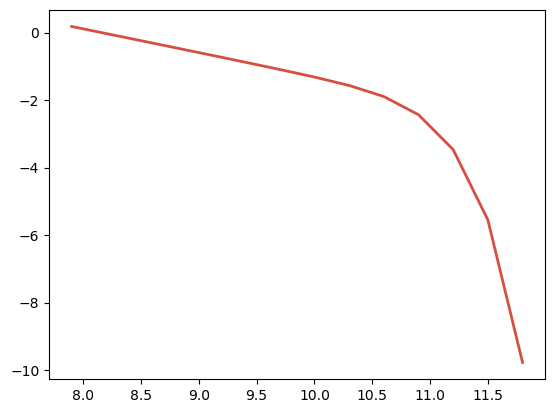

In [122]:
params = fit_results[(0.8, 'all')]['params_50']
logM_star_mcmc, alpha1_mcmc, alpha2_mcmc, logphi1_mcmc, logphi2_mcmc = params

fitted_line = np.log10(double_schechter_function(LogMassbin, logM_star_mcmc, alpha1_mcmc, alpha2_mcmc, logphi1_mcmc, logphi2_mcmc))
plt.plot(LogMassbin, fitted_line, color=color, lw=2)

/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_1071/3046453583.py:10: RuntimeWarning: invalid value encountered in log10
  lower_errors = logPhi - np.log10(Phi - dPhi)


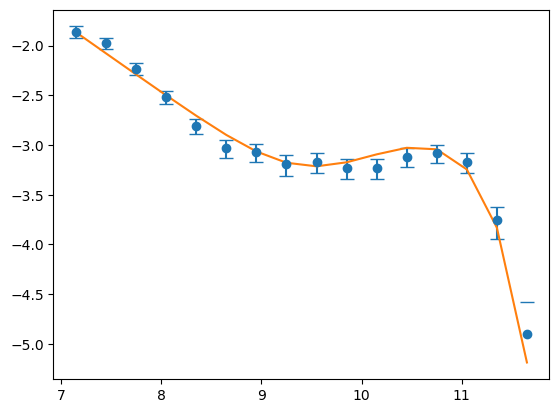

In [75]:
def double_schechter_function(logM_bins,logM, logM_star,alpha1,alpha2,logphi1,logphi2):
    M_over_M_star = logM - logM_star
    #phi_ratio = 10**logphi2/10**logphi1
    
    return np.log(10)*np.exp(-10**M_over_M_star)*10**M_over_M_star*(10**logphi1*10**(M_over_M_star*alpha1)+10**logphi2*10**(M_over_M_star*alpha2))

# Converting Phi and dPhi to logarithmic scale for plotting
logPhi = np.log10(Phi)
upper_errors = np.log10(Phi + dPhi) - logPhi
lower_errors = logPhi - np.log10(Phi - dPhi)

# Prepare error array for plotting in matplotlib
errors = [lower_errors, upper_errors]

# Plotting
plt.errorbar(logM, logPhi, yerr=errors, fmt='o', capsize=5, label='SMF with error bars')
#obs=(np.log10(Phi))
model=(np.log10(double_schechter_function(logM_bins,logM,10.796443457767282,-1.7103098819577514,-0.36435501444501806,-4.8182812509322135,-2.9929564483883233)))
plt.plot(logM,model)
#plt.plot(logM,obs)


In [25]:
print(np.log10(10**-3.2/10**-2.77))

-0.43000000000000016


In [143]:
print(phi_star_mcmc, logM_star_mcmc, alpha_mcmc)

0.0007633636505080229 10.769812444551347 -0.13090933277302325


In [132]:
names = [name for name in ceers_phys_ap.colnames if len(ceers_phys_ap[name].shape) <= 1]
ceers_phys=ceers_phys_ap[names].to_pandas()

#ceers_phys.set_index('ID')

names = [name for name in ceers_photm_ap.colnames if len(ceers_photm_ap[name].shape) <= 1]
ceers_photm=ceers_photm_ap[names].to_pandas()
fullnames = [ 'nircam_'+str(field)+'_'+str(idn) for (field,idn) in zip(ceers_photm.FIELD, ceers_photm.CATID)]
ceers_photm['fullname']=fullnames
#ceers_photm.set_index('ID')

names = [name for name in jades_phys_ap.colnames if len(jades_phys_ap[name].shape) <= 1]
jades_phys=jades_phys_ap[names].to_pandas()
#jades_phys.set_index('source')

names = [name for name in cosmos_phys_ap.colnames if len(cosmos_phys_ap[name].shape) <= 1]
cosmos_phys=cosmos_phys_ap[names].to_pandas()





NameError: name 'ceers_phys_ap' is not defined

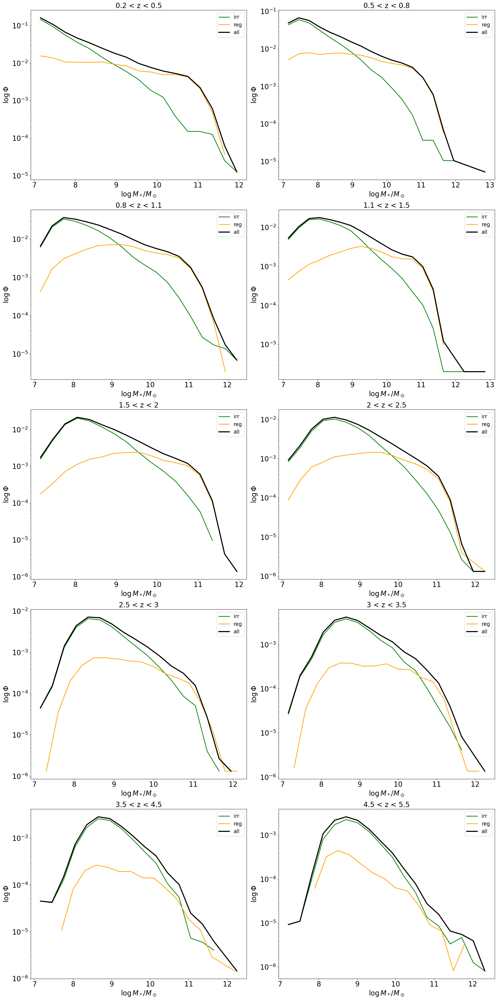

In [100]:
morph_class=['irr','reg','all']

import matplotlib.pyplot as plt
import numpy as np

# Set up a large figure to accommodate subplots
plt.figure(figsize=(20, 40))  # Adjust size to your needs

# Loop over the redshift bins
for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
    # Create subplot for each redshift bin
    ax = plt.subplot(5, 2, i + 1)  # 5 rows, 2 columns

    # Plot data for each morphological class
    morph_colors = {'reg': 'orange', 'disk': 'blue', 'irr': 'green', 'db': 'orange', 'early': 'purple', 'all': 'black'}
    for cl in morph_class:
        # Get the data
        LogMassbin = smf_morph[(zlow, cl, 'LogMassbin')]
        Fi = smf_morph[(zlow, cl, 'Fi')]
        
        # Plot log of stellar mass function, ensuring data is positive before taking log
        Fi_pos = Fi[Fi > 0]  # Filter out non-positive values
        LogMassbin_pos = LogMassbin[Fi > 0]  # Corresponding mass bins
        ax.plot(LogMassbin_pos, Fi_pos, color=morph_colors[cl], label=cl, lw=2 if cl != 'all' else 3)

    # Set titles and labels with the specified font size
    ax.set_title(f'{zlow} < z < {zup}', fontsize=20)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=20)
    ax.set_ylabel('$\log \Phi$', fontsize=20)
    
    # Set the y-axis to log scale
    ax.set_yscale('log')
    # Set tick label font size
    ax.tick_params(axis='both', which='major', labelsize=20)
    # Set legend
    ax.legend(fontsize=15)

# Adjust layout to avoid overlap
plt.tight_layout()

# Show the plot
plt.show()


KeyError: 'reg'

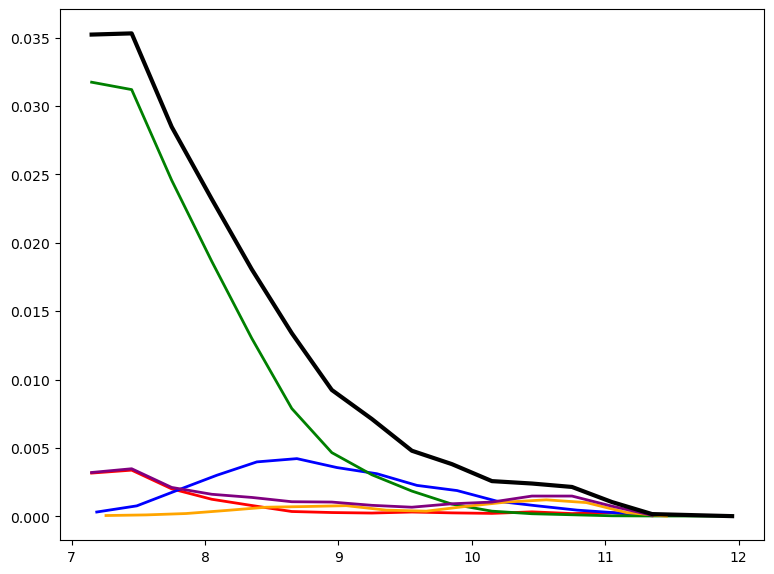

In [69]:
import matplotlib.pyplot as plt
import numpy as np

# Set up a large figure to accommodate subplots
plt.figure(figsize=(20, 40))  # Adjust size to your needs

# Loop over the redshift bins
for i, (zlow, zup) in enumerate(zip(zbins[:-1], zbins[1:])):
    # Create subplot for each redshift bin
    ax = plt.subplot(5, 2, i + 1)  # 5 rows, 2 columns

    # Plot data for each morphological class
    morph_colors = {'sph': 'red', 'disk': 'blue', 'irr': 'green', 'db': 'orange', 'early': 'purple', 'all': 'black'}
    for cl in morph_class:
        # Get the data
        LogMassbin = smf_morph[(zlow, cl, 'LogMassbin')]
        Fi = smf_morph[(zlow, cl, 'Fi')]
        
        # Plot log of stellar mass function, ensuring data is positive before taking log
        Fi_pos = Fi[Fi > 0]  # Filter out non-positive values
        LogMassbin_pos = LogMassbin[Fi > 0]  # Corresponding mass bins
        ax.plot(LogMassbin_pos, Fi_pos, color=morph_colors[cl], label=cl, lw=2 if cl != 'all' else 3)

    # Set titles and labels with the specified font size
    ax.set_title(f'{zlow} < z < {zup}', fontsize=20)
    ax.set_xlabel('$\log M_*/M_\odot$', fontsize=20)
    ax.set_ylabel('$\log \Phi$', fontsize=20)
    
    # Set the y-axis to log scale
    ax.set_yscale('log')
    # Set tick label font size
    ax.tick_params(axis='both', which='major', labelsize=20)
    # Set legend
    ax.legend(fontsize=15)

# Adjust layout to avoid overlap
plt.tight_layout()

# Show the plot
plt.show()


In [ ]:
plt.plot(smf_morph[(0.2,'sph','LogMassbin')],np.log10(smf_morph[(0.2,'sph','Fi')]),color='red')
plt.plot(smf_morph[(0.2,'disk','LogMassbin')],np.log10(smf_morph[(0.2,'disk','Fi')]),color='blue')
plt.plot(smf_morph[(0.2,'irr','LogMassbin')],np.log10(smf_morph[(0.2,'irr','Fi')]),color='green')
plt.plot(smf_morph[(0.2,'db','LogMassbin')],np.log10(smf_morph[(0.2,'db','Fi')]),color='orange')
plt.plot(smf_morph[(0.2,'all','LogMassbin')],np.log10(smf_morph[(0.2,'all','Fi')]),color='black',lw=3)
plt.plot(smf_morph[(0.2,'early','LogMassbin')],np.log10(smf_morph[(0.2,'early','Fi')]),color='purple',lw=2)

/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_47571/1793928493.py:3: RuntimeWarning: divide by zero encountered in log10
  plt.plot(smf_morph[(1.1,'irr','LogMassbin')],np.log10(smf_morph[(1.1,'irr','Fi')]),color='green')
/var/folders/3b/tyyj2qy12lxcqm59_rgl14bh0000gn/T/ipykernel_47571/1793928493.py:6: RuntimeWarning: divide by zero encountered in log10
  plt.plot(smf_morph[(1.1,'all','LogMassbin')],np.log10(smf_morph[(1.1,'all','Fi')]),color='black',lw=3)


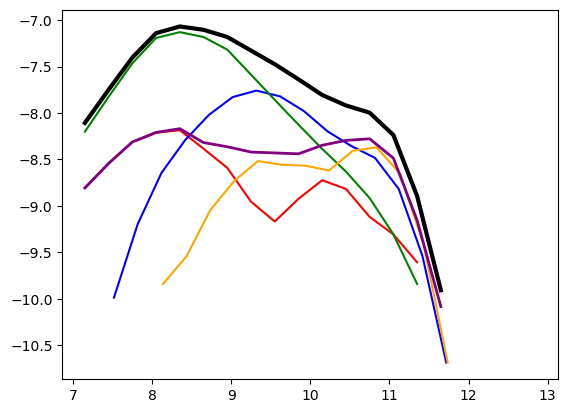

In [61]:
plt.plot(smf_morph[(1.1,'sph','LogMassbin')],np.log10(smf_morph[(1.1,'sph','Fi')]),color='red')
plt.plot(smf_morph[(1.1,'disk','LogMassbin')],np.log10(smf_morph[(1.1,'disk','Fi')]),color='blue')
plt.plot(smf_morph[(1.1,'irr','LogMassbin')],np.log10(smf_morph[(1.1,'irr','Fi')]),color='green')
plt.plot(smf_morph[(1.1,'db','LogMassbin')],np.log10(smf_morph[(1.1,'db','Fi')]),color='orange')
plt.plot(smf_morph[(1.1,'early','LogMassbin')],np.log10(smf_morph[(1.1,'early','Fi')]),color='purple',lw=2)
plt.plot(smf_morph[(1.1,'all','LogMassbin')],np.log10(smf_morph[(1.1,'all','Fi')]),color='black',lw=3)

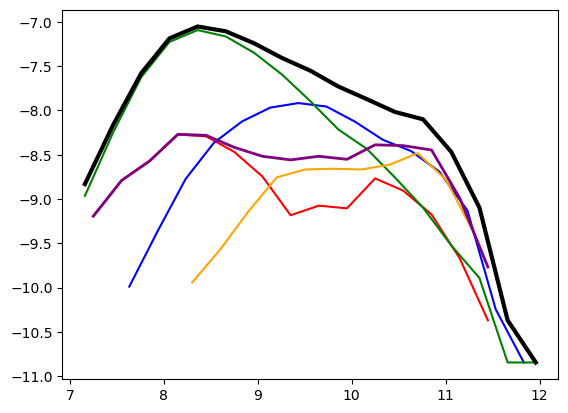

In [62]:
plt.plot(smf_morph[(1.5,'sph','LogMassbin')],np.log10(smf_morph[(1.5,'sph','Fi')]),color='red')
plt.plot(smf_morph[(1.5,'disk','LogMassbin')],np.log10(smf_morph[(1.5,'disk','Fi')]),color='blue')
plt.plot(smf_morph[(1.5,'irr','LogMassbin')],np.log10(smf_morph[(1.5,'irr','Fi')]),color='green')
plt.plot(smf_morph[(1.5,'db','LogMassbin')],np.log10(smf_morph[(1.5,'db','Fi')]),color='orange')
plt.plot(smf_morph[(1.5,'early','LogMassbin')],np.log10(smf_morph[(1.5,'early','Fi')]),color='purple',lw=2)
plt.plot(smf_morph[(1.5,'all','LogMassbin')],np.log10(smf_morph[(1.5,'all','Fi')]),color='black',lw=3)

In [ ]:
plt.plot(smf_morph[(5,'sph','LogMassbin')],np.log10(smf_morph[(5,'sph','Fi')]),color='red')
plt.plot(smf_morph[(5,'disk','LogMassbin')],np.log10(smf_morph[(5,'disk','Fi')]),color='blue')
plt.plot(smf_morph[(5,'irr','LogMassbin')],np.log10(smf_morph[(5,'irr','Fi')]),color='green')
plt.plot(smf_morph[(5,'db','LogMassbin')],np.log10(smf_morph[(2,'db','Fi')]),color='orange')

In [33]:
print(smf_morph[('db','LogMassbin')])
print(smf_morph[('sph','LogMassbin')])

[ 7.25772  7.55772  7.85772  8.15772  8.45772  8.75772  9.05772  9.35772
  9.65772  9.95772 10.25772 10.55772 10.85772 11.15772 11.45772 11.75772
 12.05772]
[ 7.15001  7.45001  7.75001  8.05001  8.35001  8.65001  8.95001  9.25001
  9.55001  9.85001 10.15001 10.45001 10.75001 11.05001 11.35001 11.65001
 11.95001]
